Bank EDA Project 8/7/2025

In [ ]:
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 
import pandas as pd 
# import filter warning library ,,after pop up msgs delete
import warnings 
warnings.filterwarnings('ignore')
# import logging 
'''step 2: load the csv file in database and create log '''

import logging
logging.basicConfig(level = logging.INFO ,
                   filename= 'model.log',
                   filemode = 'w',
                   format= '%(asctime)s - %(levelname)s - %(message)s',
                    force= True )



In [3]:
# step 2 load dataset with pandas 
df = pd.read_csv('bank-full.csv',sep =';')
df 
df.sample(frac = 1)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
14645,60,retired,married,secondary,no,597,no,no,cellular,15,jul,981,1,-1,0,unknown,yes
33668,35,blue-collar,married,secondary,no,407,yes,no,cellular,20,apr,12,6,-1,0,unknown,no
14668,35,entrepreneur,married,secondary,no,313,yes,no,cellular,15,jul,479,1,-1,0,unknown,no
41229,27,student,single,tertiary,no,5741,no,no,cellular,21,aug,72,1,88,1,failure,no
36191,41,services,married,unknown,no,88,yes,no,cellular,11,may,105,1,336,2,failure,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42217,32,technician,single,tertiary,no,6746,no,no,cellular,11,nov,199,1,-1,0,unknown,yes
6756,28,blue-collar,single,secondary,no,6307,yes,no,unknown,28,may,615,1,-1,0,unknown,no
22304,31,technician,single,tertiary,no,50,no,no,cellular,21,aug,794,1,-1,0,unknown,no
36350,42,blue-collar,married,secondary,no,3068,yes,yes,cellular,11,may,429,2,-1,0,unknown,no


In [ ]:
# step 3 : checking information 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  y          45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


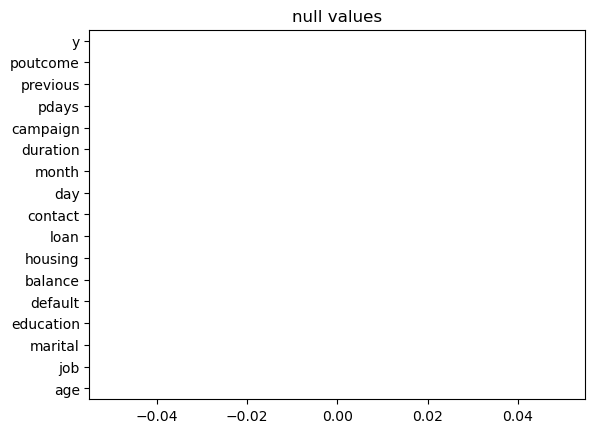

In [ ]:
#step 4 : checking null values 
df.isnull().sum().plot(kind='barh')
plt.title('null values')
plt.show() # not any null values present in this dataset not to use any simple imputer


In [8]:
#step 5 : segregate categorical to numerical data
categorical_col = df.select_dtypes(include= 'object')
numerical_col = df.select_dtypes(exclude= 'object')
categorical_col
numerical_col

,age,balance,day,duration,campaign,pdays,previous
0,58,2143,5,261,1,-1,0
1,44,29,5,151,1,-1,0
2,33,2,5,76,1,-1,0
3,47,1506,5,92,1,-1,0
4,33,1,5,198,1,-1,0
...,...,...,...,...,...,...,...
45206,51,825,17,977,3,-1,0
45207,71,1729,17,456,2,-1,0
45208,72,5715,17,1127,5,184,3
45209,57,668,17,508,4,-1,0


In [17]:
#step 6 : EDA : Exploratory Data Analysis : Univariate analysis
''' for showinng the all columns and rows in larger data '''
pd.set_option('display.max_rows',None)
pd.set_option('display.max_column',None)

from collections import OrderedDict
stats = []

for i in df.columns: 
    numerical_stats = OrderedDict({
        'feature':i,
        'Count':df[i].count(),
        'Mean' : df[i].mean(),
        'Median' :df[i].median(),
        'Minimum': df[i].min(),
        'Maximum' : df[i].max(),
        'Range' : df[i].max()- df[i].min(),
        'Q1' : df[i].quantile(0.25),
        'Q3':df[i].quantile(0.75),
        'IQR' : df[i].quantile(0.75)-df[i].quantile(0.25),
        'Standard Deviation' : df[i].std(),
        'Skewness' : df[i].skew(),
        'Kurtosis' : df[i].kurt()



    })
    stats.append(numerical_stats)
    report = pd.DataFrame(stats)
report


TypeError: Could not convert string 'managementtechnicianentrepreneurblue-collarunknownmanagementmanagemententrepreneurretiredtechnicianadmin.admin.techniciantechnicianservicesretiredadmin.blue-collarretiredservicesblue-collarmanagementblue-collarservicesretiredadmin.managemententrepreneurmanagementtechniciantechnicianmanagementadmin.blue-collarmanagementtechnicianblue-collartechnicianadmin.admin.servicesmanagementblue-collarretiredretiredadmin.self-employedtechniciantechnicianmanagementblue-collarmanagementmanagementadmin.technicianentrepreneurmanagementblue-collarblue-collarservicesadmin.technicianblue-collarservicesblue-collarmanagementretiredmanagementtechnicianblue-collarblue-collarservicesmanagementblue-collartechniciantechnicianblue-collarservicesservicesservicesadmin.servicestechnicianadmin.self-employedblue-collaradmin.technicianmanagementretiredmanagementtechnicianadmin.blue-collarentrepreneurmanagementblue-collarretiredtechnicianmanagementblue-collarblue-collarblue-collarblue-collartechnicianblue-collartechnicianadmin.retiredmanagementservicestechnicianself-employedblue-collarretiredblue-collaradmin.managementmanagementtechniciantechnicianblue-collaradmin.servicestechniciantechnicianadmin.servicesblue-collarservicesmanagementadmin.technicianadmin.unemployedblue-collartechnicianservicesblue-collarblue-collarhousemaidself-employedunemployedblue-collarblue-collarservicesblue-collarunemployedservicesblue-collarblue-collarstudentmanagementmanagementtechnicianservicesblue-collarretiredblue-collarblue-collarservicestechnicianservicesblue-collartechnicianadmin.managementtechnicianadmin.blue-collarblue-collarservicesentrepreneurretiredadmin.admin.unemployedtechnicianservicesmanagementservicestechnicianservicestechnicianadmin.retiredservicesmanagementblue-collarmanagementretiredmanagementmanagementadmin.blue-collarblue-collarservicestechnicianmanagementblue-collaradmin.self-employedblue-collarstudentservicesservicesmanagementmanagementservicesretiredblue-collarretiredhousemaidservicesblue-collartechnicianunknownunemployedhousemaidmanagementunemployedblue-collarentrepreneurretiredtechnicianblue-collarmanagementmanagementblue-collarservicesblue-collarservicesentrepreneurblue-collarblue-collarblue-collaradmin.blue-collaradmin.blue-collartechnicianentrepreneuradmin.technicianmanagementmanagementblue-collarmanagementblue-collarservicesadmin.blue-collarservicestechnicianmanagementblue-collarentrepreneurtechnicianservicesblue-collarblue-collarmanagementtechnicianmanagemententrepreneurstudentmanagementadmin.blue-collarblue-collarmanagementblue-collartechnicianentrepreneuradmin.retiredservicesservicesservicesself-employedblue-collaradmin.technicianblue-collarblue-collaradmin.admin.technicianblue-collarself-employedmanagementtechnicianstudentmanagementtechniciantechnicianblue-collarstudentblue-collartechnicianblue-collaradmin.retiredservicesservicestechnicianmanagementblue-collarblue-collarmanagementadmin.technicianservicesservicesadmin.admin.blue-collartechnicianretiredblue-collarblue-collarblue-collarmanagementtechnicianadmin.managementblue-collartechniciantechnicianblue-collarblue-collarblue-collarblue-collarmanagementmanagementblue-collaradmin.technicianadmin.servicesblue-collarmanagementblue-collarblue-collarmanagementservicestechnicianblue-collarservicesmanagementmanagementblue-collaradmin.blue-collarunknownadmin.blue-collarentrepreneurblue-collaradmin.managementservicesservicesadmin.admin.technicianadmin.managementadmin.studentservicesadmin.blue-collaradmin.blue-collarblue-collaradmin.blue-collarmanagementblue-collarblue-collarservicesmanagementadmin.blue-collarservicestechnicianunemployedmanagementblue-collarretiredtechniciantechnicianadmin.blue-collartechnicianadmin.admin.blue-collarblue-collarhousemaidtechnicianself-employedservicestechnicianmanagementretiredblue-collartechnicianblue-collarservicesblue-collaradmin.admin.entrepreneuradmin.technicianunemployedblue-collartechnicianmanagementmanagementadmin.blue-collartechnicianmanagementservicesblue-collartechnicianblue-collaradmin.managementblue-collarblue-collarblue-collaradmin.blue-collarmanagementtechnicianadmin.servicestechnicianblue-collarself-employedtechnicianadmin.technicianself-employedservicesblue-collartechnicianservicesmanagementmanagementblue-collarblue-collaradmin.technicianblue-collarblue-collarblue-collarblue-collarblue-collarunemployedservicesretiredadmin.blue-collarblue-collarself-employedserviceshousemaidblue-collarblue-collaradmin.blue-collarmanagementmanagementadmin.managementblue-collartechniciantechnicianblue-collarservicesmanagementblue-collarmanagementtechnicianblue-collartechnicianblue-collarblue-collarunemployedblue-collaradmin.blue-collarblue-collarblue-collartechnicianadmin.technicianmanagementblue-collarblue-collarblue-collarretiredblue-collarretiredadmin.retiredadmin.unemployedblue-collarmanagemententrepreneuradmin.blue-collartechnicianblue-collarmanagementmanagementadmin.managementretiredblue-collarmanagementmanagementmanagementadmin.blue-collarhousemaidservicesmanagementadmin.blue-collarblue-collarblue-collarblue-collarblue-collarblue-collarservicestechnicianadmin.unemployedadmin.blue-collarblue-collarself-employedservicesservicesadmin.studentself-employedblue-collaradmin.servicesadmin.blue-collartechnicianblue-collaradmin.entrepreneurtechnicianservicesblue-collarmanagementunemployedblue-collarservicestechnicianblue-collarblue-collartechnicianservicesretiredentrepreneurtechnicianblue-collarservicesblue-collartechnicianservicesmanagementtechnicianblue-collarblue-collarservicestechnicianblue-collartechniciantechnicianadmin.retiredservicesservicesservicesblue-collartechnicianself-employedblue-collarblue-collarservicesblue-collarblue-collarblue-collartechnicianblue-collarself-employedservicestechnicianmanagementservicesblue-collartechnicianmanagementblue-collarblue-collarblue-collartechniciantechniciantechniciantechnicianretiredtechnicianmanagementunemployedtechnicianadmin.technicianadmin.admin.blue-collarservicesentrepreneurservicesblue-collarunemployedservicesadmin.managementblue-collarblue-collartechnicianunemployedentrepreneurtechnicianstudentmanagementtechnicianstudentadmin.self-employedadmin.technicianblue-collarservicesblue-collaradmin.managementadmin.servicesadmin.blue-collarentrepreneurblue-collaradmin.technicianself-employedservicesblue-collarblue-collarself-employedblue-collarmanagementmanagementblue-collartechnicianmanagementadmin.servicesservicesadmin.admin.managementservicesmanagementadmin.managementblue-collarstudentblue-collartechnicianservicestechnicianentrepreneuradmin.blue-collartechnicianmanagementservicesblue-collaradmin.servicesadmin.blue-collartechniciantechniciantechnicianblue-collaradmin.blue-collarentrepreneurretiredadmin.admin.retiredblue-collarblue-collaradmin.technicianmanagementblue-collaradmin.blue-collarretiredservicesadmin.managementblue-collarblue-collarentrepreneurblue-collarmanagementservicesblue-collarblue-collartechnicianretiredmanagementblue-collarmanagementblue-collarblue-collarblue-collarblue-collarself-employedentrepreneurblue-collarmanagementadmin.blue-collarmanagementunemployedadmin.housemaidadmin.housemaidservicestechnicianblue-collarblue-collartechnicianself-employedtechnicianblue-collaradmin.technicianstudentblue-collarservicesblue-collartechnicianadmin.technicianservicesblue-collarmanagementblue-collaradmin.admin.blue-collarservicestechniciantechnicianmanagementtechnicianmanagementstudentretiredblue-collarblue-collarretiredblue-collarself-employedmanagementservicesmanagementblue-collarretiredtechnicianblue-collarservicesblue-collaradmin.blue-collarservicesservicesretiredtechnicianblue-collarself-employedblue-collartechnicianservicesblue-collarblue-collarmanagementtechniciantechnicianservicesservicesblue-collarblue-collarservicesservicesservicesblue-collarretiredmanagementmanagementblue-collarblue-collarmanagementtechniciantechnicianservicesentrepreneurblue-collaradmin.blue-collarblue-collartechnicianblue-collarservicesblue-collarmanagementservicesblue-collaradmin.servicestechnicianmanagementblue-collarblue-collaradmin.blue-collarservicesblue-collarservicesretiredadmin.servicesmanagementblue-collartechnicianblue-collarblue-collarmanagementself-employedservicesadmin.blue-collarblue-collarmanagementblue-collarunknownblue-collartechnicianadmin.servicesblue-collarhousemaidblue-collarmanagementunemployedmanagementblue-collarmanagementmanagementstudentservicesservicesblue-collarentrepreneurblue-collarblue-collaradmin.admin.blue-collaradmin.admin.servicesadmin.managementmanagementservicesblue-collarretiredself-employedblue-collaradmin.managementadmin.self-employedadmin.servicesblue-collarblue-collarunemployedadmin.technicianself-employedservicesblue-collarmanagementservicesblue-collarblue-collaradmin.retiredblue-collarblue-collarblue-collarblue-collarblue-collarblue-collaradmin.managementservicesblue-collarblue-collarservicesblue-collarservicesadmin.servicesentrepreneurmanagementtechnicianmanagementtechnicianblue-collarmanagementadmin.technicianblue-collarretiredservicesblue-collartechnicianretiredmanagementservicesblue-collaradmin.servicesservicesblue-collarservicesmanagementtechnicianblue-collarretiredunemployedadmin.retiredmanagementunemployedadmin.blue-collartechnicianentrepreneuradmin.blue-collarunemployedadmin.entrepreneurtechnicianadmin.unemployedmanagementblue-collarblue-collarblue-collarblue-collaradmin.blue-collarservicestechnicianadmin.technicianblue-collarservicesblue-collarservicesblue-collarblue-collarblue-collarservicesblue-collartechnicianadmin.managementservicesblue-collarblue-collaradmin.entrepreneurblue-collarentrepreneurtechnicianadmin.technicianblue-collarblue-collartechnicianmanagementblue-collarblue-collarmanagementservicestechnicianblue-collarblue-collarblue-collarblue-collarblue-collartechnicianservicesblue-collaradmin.blue-collarblue-collaradmin.blue-collarmanagementtechnicianmanagementtechniciantechnicianblue-collarstudentblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarservicesblue-collartechniciantechnicianblue-collarservicesmanagemententrepreneurservicesblue-collarmanagementmanagementadmin.unknownblue-collarblue-collarserviceshousemaidblue-collarmanagementtechnicianself-employedtechnicianblue-collarblue-collarblue-collaradmin.blue-collarblue-collartechnicianblue-collarblue-collarmanagementmanagementblue-collaradmin.entrepreneurhousemaidadmin.blue-collarservicesblue-collarblue-collarblue-collartechnicianservicesadmin.technicianblue-collarblue-collarservicesadmin.technicianservicesblue-collarblue-collarretiredblue-collarblue-collarblue-collartechnicianretiredblue-collarblue-collartechnicianmanagementservicestechnicianblue-collarblue-collarservicesadmin.admin.blue-collarblue-collarblue-collarmanagementblue-collartechnicianblue-collarmanagementblue-collarservicesentrepreneurtechnicianservicesservicesadmin.technicianadmin.blue-collartechnicianadmin.managementtechnicianadmin.unemployedtechnicianblue-collarretiredadmin.blue-collarblue-collarself-employedadmin.servicesmanagementtechnicianadmin.managementblue-collarblue-collarblue-collartechnicianblue-collartechnicianblue-collarblue-collarblue-collarmanagementtechnicianservicesblue-collaradmin.blue-collarentrepreneurself-employedmanagementretiredblue-collarmanagementblue-collarentrepreneurblue-collarmanagementmanagementadmin.technicianmanagementhousemaidblue-collarblue-collarentrepreneurunemployedadmin.blue-collartechniciantechnicianhousemaidmanagementblue-collarblue-collarblue-collarblue-collarmanagementmanagementblue-collaradmin.blue-collarblue-collaradmin.servicesadmin.admin.blue-collarmanagementstudentretiredadmin.unemployedtechniciantechnicianadmin.technicianblue-collarself-employedblue-collarentrepreneurtechnicianservicestechnicianblue-collarblue-collarblue-collarservicesmanagementblue-collartechnicianservicesblue-collarmanagementblue-collarretiredblue-collarmanagementadmin.servicesservicesself-employedadmin.blue-collarretiredtechnicianservicesmanagementtechnicianblue-collartechnicianadmin.blue-collarmanagementblue-collarblue-collarmanagementadmin.self-employedmanagemententrepreneurtechnicianblue-collarmanagementblue-collarblue-collarmanagementblue-collartechnicianmanagementblue-collarservicesstudenttechnicianblue-collaradmin.unknownentrepreneurtechnicianservicesblue-collarservicestechniciantechnicianmanagementtechnicianunemployedmanagementmanagementtechnicianserviceshousemaidblue-collarmanagementblue-collartechnicianmanagementtechnicianmanagementadmin.blue-collarblue-collarblue-collarblue-collarservicesblue-collarentrepreneurmanagementservicesblue-collartechnicianservicesadmin.blue-collartechniciantechnicianblue-collaradmin.technicianmanagementtechnicianblue-collarstudentblue-collaradmin.servicesadmin.servicestechnicianadmin.servicestechnicianservicesblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarentrepreneurservicesblue-collarblue-collarblue-collarservicesservicesadmin.technicianunemployedservicesblue-collarself-employedblue-collarservicesadmin.servicesmanagementblue-collarstudenttechnicianblue-collaradmin.admin.retiredmanagementadmin.managementmanagementadmin.housemaidadmin.managementretiredblue-collarmanagementservicesblue-collarblue-collarblue-collarservicesservicesblue-collarblue-collarmanagementmanagementstudentblue-collarmanagementblue-collarservicesadmin.blue-collartechnicianblue-collarservicesservicesblue-collartechniciantechnicianblue-collarmanagementblue-collarmanagementblue-collartechnicianmanagementblue-collarblue-collarmanagementblue-collarmanagementtechnicianmanagementblue-collarentrepreneurblue-collarblue-collaradmin.blue-collarservicesblue-collarblue-collarunemployedblue-collarself-employedtechnicianblue-collaradmin.blue-collarself-employedentrepreneurmanagementmanagementservicesservicesentrepreneurblue-collarblue-collarservicesblue-collarblue-collarservicesblue-collarblue-collarmanagementadmin.blue-collarretiredblue-collarblue-collarblue-collarblue-collarblue-collarservicesblue-collarmanagementblue-collartechnicianblue-collarblue-collarmanagementtechnicianadmin.servicestechnicianblue-collarblue-collarmanagementunemployedtechniciantechnicianblue-collarblue-collarblue-collarservicesblue-collarblue-collarblue-collarblue-collaradmin.managementblue-collarblue-collarservicestechnicianentrepreneurself-employedtechnicianmanagementblue-collarmanagementtechnicianblue-collarblue-collarmanagementstudentunemployedservicesmanagementblue-collaradmin.blue-collarmanagementblue-collarunemployedunemployedblue-collarblue-collarblue-collarblue-collaradmin.blue-collarunemployedtechnicianservicesmanagementblue-collartechniciantechnicianblue-collartechnicianhousemaidmanagementblue-collarmanagementretiredblue-collaradmin.unemployedblue-collarblue-collarblue-collarblue-collarservicesblue-collarblue-collartechniciantechnicianself-employedmanagementservicesservicesmanagementblue-collarmanagementtechnicianself-employedservicesmanagementunemployedblue-collarblue-collarblue-collarmanagementmanagementmanagementblue-collarblue-collarblue-collarblue-collaradmin.admin.blue-collartechnicianblue-collarblue-collarblue-collarmanagementadmin.managementmanagementunemployedtechnicianmanagementtechnicianblue-collarblue-collartechnicianmanagementblue-collarblue-collarblue-collarmanagementservicesblue-collaradmin.blue-collarmanagementblue-collarservicesservicesadmin.managementmanagementservicesblue-collarblue-collaradmin.blue-collarmanagementadmin.techniciantechniciantechnicianself-employedtechnicianblue-collarmanagementblue-collarblue-collarservicesadmin.technicianblue-collarentrepreneurtechnicianblue-collarservicesblue-collaradmin.blue-collarblue-collaradmin.admin.admin.blue-collarmanagementblue-collarblue-collarblue-collarblue-collartechniciantechniciantechnicianblue-collarblue-collarblue-collartechniciantechnicianblue-collarmanagementblue-collarhousemaidblue-collarblue-collarunemployedserviceshousemaidblue-collaradmin.technicianunemployedblue-collarblue-collarservicestechnicianmanagementblue-collarblue-collarblue-collartechnicianservicesblue-collartechniciantechnicianblue-collarmanagementhousemaidtechnicianblue-collaradmin.managementadmin.blue-collarblue-collarblue-collarservicesblue-collarblue-collarblue-collaradmin.managementtechnicianservicesmanagementblue-collarretiredservicesservicesblue-collarblue-collarself-employedblue-collarblue-collarmanagemententrepreneurservicesunemployedretiredblue-collarmanagementadmin.studentblue-collarservicesadmin.admin.managementblue-collartechnicianadmin.blue-collarblue-collarself-employedmanagementblue-collaradmin.servicesblue-collarservicesblue-collartechniciantechnicianblue-collarblue-collaradmin.blue-collarblue-collarmanagementadmin.managementblue-collaradmin.self-employedtechnicianunemployedtechnicianblue-collarservicesunemployedtechnicianstudenttechnicianadmin.blue-collartechnicianblue-collaradmin.technicianmanagementblue-collarblue-collarservicesblue-collarservicesserviceshousemaidunemployedservicesadmin.managementtechnicianadmin.blue-collarblue-collarmanagementmanagementblue-collarblue-collarblue-collarblue-collarmanagemententrepreneuradmin.blue-collarmanagementblue-collarblue-collarblue-collartechnicianservicesadmin.unemployedservicesblue-collarservicesblue-collarservicesretiredadmin.blue-collarmanagementmanagementtechnicianblue-collarservicesstudententrepreneurmanagementblue-collarmanagementservicesblue-collarblue-collarblue-collarmanagementblue-collarblue-collarstudentself-employedblue-collarmanagementblue-collarblue-collarmanagementmanagementblue-collarblue-collarservicestechnicianstudentblue-collarblue-collartechnicianmanagementadmin.blue-collarunemployedretiredservicesservicestechniciantechnicianmanagementblue-collarblue-collarblue-collarblue-collartechnicianblue-collarblue-collarblue-collaradmin.blue-collartechnicianblue-collartechnicianblue-collartechnicianblue-collarblue-collarblue-collartechnicianservicesmanagementblue-collarblue-collarblue-collarblue-collarblue-collarmanagementblue-collarblue-collartechnicianservicesservicesadmin.blue-collarblue-collaradmin.unemployedblue-collartechnicianblue-collarentrepreneurmanagementblue-collartechnicianservicestechnicianself-employedblue-collarserviceshousemaidmanagementtechnicianentrepreneurself-employedblue-collarmanagemententrepreneurtechnicianentrepreneuradmin.blue-collarblue-collaradmin.technicianadmin.blue-collarblue-collarmanagementservicesservicesblue-collarblue-collartechnicianadmin.admin.blue-collarservicesblue-collarmanagemententrepreneurmanagementblue-collartechnicianstudentblue-collarservicesmanagementblue-collarmanagementmanagementblue-collartechnicianstudentadmin.servicesadmin.admin.blue-collarmanagementadmin.blue-collaradmin.blue-collarblue-collaradmin.blue-collarmanagementblue-collaradmin.unemployedblue-collarblue-collaradmin.servicesblue-collartechnicianblue-collarblue-collaradmin.blue-collaradmin.blue-collarblue-collarmanagementblue-collarblue-collarblue-collarself-employedblue-collarmanagementmanagementmanagementblue-collarblue-collaradmin.servicesmanagementblue-collarservicesself-employedmanagementunemployedentrepreneuradmin.technicianblue-collarblue-collaradmin.self-employedadmin.managementblue-collarmanagementadmin.managemententrepreneurservicesself-employedservicesadmin.blue-collarblue-collarblue-collarservicesadmin.blue-collarmanagementmanagementunemployedmanagementtechnicianblue-collarmanagementmanagementservicesblue-collarblue-collartechnicianblue-collarblue-collarblue-collaradmin.technicianservicesmanagementservicesmanagementblue-collarblue-collartechniciantechnicianmanagementblue-collartechnicianself-employedblue-collarunknownadmin.managementblue-collarmanagementmanagementadmin.blue-collarunemployedblue-collarblue-collarmanagementblue-collarunemployedstudentadmin.blue-collarblue-collarservicesretiredadmin.unemployedblue-collarservicesblue-collartechnicianblue-collartechniciantechnicianretiredmanagementblue-collartechnicianadmin.servicestechnicianblue-collaradmin.managementblue-collarself-employedmanagementservicesunemployedblue-collarservicesmanagementblue-collarservicestechnicianmanagementmanagementservicesblue-collarblue-collarblue-collarservicestechnicianblue-collarblue-collarmanagementblue-collarmanagementmanagementtechnicianblue-collaradmin.blue-collaradmin.blue-collarblue-collarblue-collarstudentretiredblue-collarentrepreneurblue-collarself-employedtechnicianservicesservicesentrepreneurblue-collaradmin.self-employedtechniciantechnicianblue-collarblue-collaradmin.technicianadmin.admin.blue-collarservicesentrepreneuradmin.retiredtechnicianadmin.technicianadmin.technicianblue-collaradmin.retiredservicestechnicianblue-collarentrepreneurservicesblue-collarmanagementblue-collarblue-collaradmin.blue-collarservicesblue-collarblue-collarblue-collarblue-collaradmin.admin.entrepreneurblue-collarblue-collarblue-collarmanagementservicesblue-collarblue-collarblue-collaradmin.blue-collarmanagementtechniciantechnicianadmin.servicesservicesservicesblue-collarservicestechnicianretiredtechnicianblue-collartechnicianblue-collarservicesblue-collarunemployedadmin.entrepreneurblue-collartechniciantechnicianmanagementadmin.admin.blue-collaradmin.admin.blue-collarservicesadmin.servicesblue-collarblue-collarblue-collarunemployedblue-collarmanagementblue-collarblue-collartechniciantechnicianblue-collarmanagementadmin.studentservicesblue-collaradmin.admin.blue-collarblue-collarmanagementstudentmanagementtechnicianblue-collarblue-collarmanagementadmin.housemaidentrepreneurblue-collartechnicianadmin.blue-collarmanagementself-employedmanagementtechnicianmanagementservicesblue-collarblue-collarmanagementadmin.blue-collarstudentadmin.entrepreneurblue-collarentrepreneurself-employedmanagementmanagementmanagementtechnicianadmin.blue-collarblue-collarservicesblue-collarmanagementblue-collarmanagementblue-collarblue-collarunemployedadmin.entrepreneurblue-collarblue-collaradmin.managementservicestechnicianservicesblue-collarblue-collarblue-collarentrepreneurblue-collarblue-collarblue-collaradmin.admin.managementadmin.technicianblue-collartechnicianblue-collarblue-collaradmin.blue-collarblue-collarentrepreneurblue-collartechnicianself-employedblue-collarunemployedblue-collarservicesblue-collarhousemaidadmin.blue-collaradmin.managementblue-collartechnicianadmin.servicesadmin.blue-collarblue-collartechnicianblue-collarblue-collartechniciantechnicianadmin.admin.servicesblue-collarblue-collarservicesblue-collarentrepreneurblue-collartechnicianblue-collarservicestechnicianmanagementadmin.blue-collartechnicianblue-collarblue-collarmanagemententrepreneuradmin.technicianservicesservicestechnicianblue-collarblue-collartechnicianstudentblue-collarunemployedservicesmanagementtechnicianadmin.blue-collaradmin.blue-collartechnicianservicesmanagementadmin.managementservicesmanagementservicesblue-collartechnicianblue-collarblue-collarunemployedblue-collarservicesretiredblue-collarblue-collaradmin.blue-collaradmin.technicianservicesblue-collarretiredblue-collarblue-collaradmin.blue-collaradmin.blue-collarblue-collarblue-collarmanagementretiredservicesservicesadmin.servicesadmin.managementblue-collarblue-collartechnicianblue-collartechnicianmanagementtechnicianself-employedmanagementblue-collarblue-collarblue-collaradmin.blue-collarblue-collarservicesblue-collaradmin.blue-collartechniciantechnicianretiredblue-collarunemployedself-employedblue-collartechniciantechnicianunemployedtechnicianmanagementself-employedblue-collarblue-collarservicesretiredretiredmanagementblue-collarmanagementservicesblue-collarretiredblue-collarblue-collarblue-collarblue-collartechnicianadmin.servicesretiredmanagementservicesblue-collarself-employedtechniciantechnicianretiredblue-collaradmin.entrepreneurblue-collartechniciantechniciantechnicianmanagementservicesservicesmanagementblue-collarmanagementmanagemententrepreneurmanagementretiredtechnicianblue-collaradmin.managementservicesentrepreneuradmin.entrepreneurmanagementservicesblue-collarblue-collarblue-collarunemployedadmin.retiredtechnicianadmin.blue-collarservicesblue-collarblue-collarservicesblue-collarentrepreneurtechnicianmanagementblue-collaradmin.retiredmanagementmanagementservicesentrepreneurblue-collarself-employedmanagementmanagementblue-collarretiredadmin.servicesmanagementself-employedblue-collarblue-collarretiredtechnicianadmin.blue-collarretiredtechnicianadmin.servicestechnicianblue-collarentrepreneurretiredblue-collaradmin.admin.blue-collarmanagementadmin.admin.technicianblue-collartechnicianadmin.unemployedentrepreneurblue-collarmanagementhousemaidblue-collarself-employedblue-collarmanagementadmin.blue-collaradmin.admin.retiredtechnicianblue-collartechnicianadmin.technicianadmin.technicianmanagementservicesblue-collarblue-collarblue-collarblue-collarmanagementblue-collartechnicianmanagementblue-collarservicesmanagementblue-collaradmin.servicesblue-collaradmin.technicianblue-collartechnicianservicestechnicianblue-collarblue-collarblue-collarretiredadmin.servicesblue-collarmanagementservicestechnicianadmin.managementmanagementblue-collarblue-collarentrepreneurmanagementservicesservicesblue-collarblue-collarservicesadmin.blue-collartechnicianmanagementtechnicianblue-collarmanagementblue-collaradmin.blue-collarblue-collarblue-collarservicesretiredretiredblue-collarblue-collarblue-collaradmin.techniciantechnicianblue-collarmanagementmanagementretiredblue-collarblue-collarblue-collarentrepreneurmanagementblue-collaradmin.blue-collarblue-collartechnicianblue-collartechnicianblue-collarblue-collartechnicianblue-collarblue-collartechnicianentrepreneurblue-collarhousemaidblue-collarblue-collarself-employedtechnicianretiredmanagementretiredservicesmanagementmanagementretiredadmin.self-employedtechnicianretiredretiredservicesmanagementblue-collarblue-collarblue-collarhousemaidblue-collarblue-collaradmin.blue-collarservicesblue-collarservicesblue-collaradmin.admin.blue-collarblue-collarblue-collarentrepreneuradmin.blue-collarblue-collarblue-collarretiredtechnicianblue-collarmanagementblue-collartechnicianmanagementmanagementblue-collarservicestechnicianblue-collarblue-collarunknownblue-collarunemployedtechnicianblue-collartechnicianservicesblue-collaradmin.blue-collartechnicianblue-collaradmin.entrepreneurblue-collarmanagementadmin.admin.blue-collarservicesadmin.blue-collarretiredblue-collarentrepreneuradmin.managementretiredtechnicianblue-collartechnicianblue-collarblue-collaradmin.blue-collaradmin.blue-collarblue-collartechnicianentrepreneurblue-collartechnicianblue-collarblue-collarhousemaidblue-collarblue-collartechniciantechnicianblue-collarblue-collaradmin.servicesblue-collarself-employedmanagementtechnicianadmin.managementtechnicianmanagementmanagementmanagementtechnicianadmin.blue-collarblue-collartechnicianblue-collarblue-collarentrepreneurtechnicianblue-collartechnicianstudentblue-collarblue-collartechniciantechnicianblue-collartechniciantechnicianblue-collarretiredservicesmanagementmanagementmanagementblue-collarmanagementadmin.blue-collaradmin.managementtechnicianblue-collarmanagementadmin.blue-collaradmin.admin.servicesmanagementadmin.managementunemployedtechnicianentrepreneurmanagementservicesretiredtechnicianretiredservicesadmin.blue-collartechnicianadmin.unknowntechnicianmanagementtechnicianretiredretiredhousemaidunknownblue-collarunemployedmanagementblue-collarblue-collarmanagementblue-collartechnicianadmin.blue-collarblue-collarblue-collarself-employedunemployedmanagementmanagementblue-collarblue-collarblue-collaradmin.entrepreneurblue-collarservicesblue-collarblue-collarblue-collarblue-collartechnicianblue-collarblue-collarblue-collarblue-collartechnicianadmin.blue-collaradmin.blue-collarblue-collarblue-collarretiredtechnicianmanagementblue-collarmanagementblue-collaradmin.managementmanagementblue-collarblue-collarmanagementadmin.blue-collarretiredblue-collarretiredentrepreneuradmin.blue-collarself-employedmanagementtechnicianblue-collarunemployedblue-collaradmin.technicianadmin.blue-collarunemployedblue-collarblue-collartechnicianblue-collarblue-collaradmin.technicianservicesblue-collarblue-collarretiredblue-collarblue-collaradmin.servicestechnicianblue-collarblue-collarblue-collarmanagementtechnicianservicestechnicianentrepreneurblue-collarretiredmanagementself-employedtechnicianblue-collarmanagementservicesretiredblue-collarmanagementblue-collartechniciantechnicianself-employedblue-collarmanagementretiredblue-collarblue-collaradmin.blue-collarservicesmanagementtechnicianentrepreneurblue-collarentrepreneurentrepreneurblue-collarblue-collarentrepreneurmanagementblue-collarmanagementblue-collartechnicianself-employedadmin.technicianentrepreneurblue-collarentrepreneurservicesadmin.technicianblue-collarretiredunemployedretiredmanagementblue-collaradmin.blue-collarblue-collarmanagementblue-collarservicesblue-collarservicesblue-collarblue-collarservicesmanagementblue-collarmanagementblue-collarblue-collarservicesservicestechnicianservicesservicesadmin.unemployedblue-collarblue-collarblue-collarblue-collarservicesblue-collartechnicianadmin.studentadmin.entrepreneurmanagementblue-collarblue-collaradmin.admin.blue-collartechnicianservicesadmin.admin.technicianself-employedservicestechnicianblue-collarunemployedmanagementservicestechnicianblue-collarhousemaidservicesblue-collaradmin.blue-collarblue-collarmanagementservicesmanagementblue-collartechniciantechnicianhousemaidretiredadmin.admin.blue-collarmanagementservicesadmin.technicianblue-collaradmin.blue-collarretiredmanagementself-employedmanagementtechnicianadmin.blue-collarservicesblue-collarstudentservicesservicestechniciantechnicianblue-collaradmin.technicianblue-collarblue-collarblue-collarentrepreneurunemployedunemployedadmin.housemaidblue-collarblue-collarblue-collarblue-collarblue-collarblue-collaradmin.technicianblue-collaradmin.blue-collarentrepreneurunemployedblue-collaradmin.blue-collarblue-collartechnicianadmin.technicianblue-collarblue-collarblue-collarblue-collartechnicianblue-collarblue-collartechnicianadmin.managementadmin.retiredblue-collarblue-collarblue-collaradmin.techniciantechnicianblue-collaradmin.servicestechnicianblue-collarblue-collarblue-collarmanagementtechnicianblue-collarretiredself-employedadmin.blue-collartechniciantechnicianblue-collarblue-collarblue-collarblue-collarblue-collarmanagementmanagementtechnicianstudentservicesadmin.self-employedtechniciantechnicianmanagemententrepreneurblue-collarmanagementadmin.managementservicesblue-collarblue-collarretiredtechnicianblue-collarservicesadmin.managementservicesmanagemententrepreneurservicesmanagementunemployedblue-collarmanagementhousemaidblue-collarblue-collaradmin.admin.admin.managementtechnicianadmin.managementadmin.managementtechnicianhousemaidservicesadmin.servicesservicesentrepreneurretiredtechnicianretiredmanagementservicesblue-collarblue-collarretiredtechnicianadmin.admin.retiredunemployedretiredservicesblue-collaradmin.self-employedtechnicianmanagementservicesmanagementtechnicianservicesservicesservicesmanagementtechnicianentrepreneurblue-collarblue-collarself-employedretiredentrepreneurblue-collarblue-collarblue-collarblue-collarretiredblue-collarentrepreneurmanagementblue-collarblue-collaradmin.blue-collaradmin.managemententrepreneurblue-collarblue-collarblue-collarblue-collarblue-collartechniciantechnicianblue-collarblue-collarblue-collarblue-collaradmin.servicesblue-collarservicesadmin.blue-collarblue-collarhousemaidblue-collarunemployedblue-collarentrepreneurretiredblue-collarmanagementservicesservicesblue-collarblue-collarblue-collarblue-collarretiredadmin.blue-collarblue-collarentrepreneurblue-collarentrepreneurentrepreneurentrepreneurblue-collarblue-collarblue-collarservicesmanagementblue-collarentrepreneuradmin.managementtechniciantechnicianmanagementretiredtechniciantechnicianblue-collaradmin.retiredblue-collarentrepreneurself-employedblue-collaradmin.retiredblue-collartechnicianunknownadmin.servicesentrepreneurblue-collarmanagementservicesentrepreneurblue-collarmanagementservicesretiredblue-collarentrepreneurblue-collarblue-collaradmin.blue-collarretiredretiredblue-collarblue-collartechnicianblue-collarservicesblue-collarblue-collarservicesmanagementadmin.blue-collarblue-collarblue-collarblue-collarblue-collarservicesmanagementadmin.technicianretiredmanagementblue-collarentrepreneurhousemaidstudentadmin.admin.servicesmanagementmanagementmanagementtechnicianservicesblue-collaradmin.retiredblue-collarretiredblue-collaradmin.admin.servicesblue-collartechniciantechnicianmanagementblue-collartechnicianblue-collarblue-collarmanagementservicesblue-collarblue-collarservicesblue-collartechnicianservicestechnicianmanagementblue-collaradmin.managementself-employedblue-collarretiredmanagementblue-collarblue-collaradmin.servicesadmin.unemployedmanagementservicesmanagementblue-collarentrepreneurblue-collarmanagementservicesservicesblue-collartechnicianmanagementblue-collarblue-collarblue-collarmanagementtechniciantechniciantechnicianservicesmanagementunemployedservicesself-employedblue-collarservicestechnicianadmin.blue-collarhousemaidblue-collarself-employedmanagementstudentadmin.servicesadmin.technicianservicesadmin.blue-collartechniciantechnicianblue-collarunemployedmanagementmanagementstudentunemployedentrepreneuradmin.technicianretiredmanagemententrepreneurblue-collarmanagementtechnicianmanagementtechnicianservicesadmin.blue-collaradmin.blue-collarmanagementmanagemententrepreneurblue-collarmanagementtechnicianblue-collarmanagementservicesadmin.blue-collartechnicianmanagementblue-collarblue-collarservicesmanagementblue-collarmanagementmanagementadmin.managementtechnicianserviceshousemaidmanagementblue-collarretiredmanagementmanagementblue-collarunknownservicesblue-collartechnicianblue-collarretiredblue-collarhousemaidservicesblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarservicesblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collaradmin.servicesself-employedmanagementtechniciantechnicianblue-collarhousemaidservicesblue-collartechnicianmanagementmanagementblue-collarblue-collartechnicianadmin.blue-collarblue-collarblue-collarretiredblue-collaradmin.blue-collarblue-collarmanagementmanagementblue-collaradmin.blue-collarblue-collarservicesservicesservicestechnicianblue-collartechnicianblue-collartechnicianblue-collarservicesblue-collarmanagementmanagementblue-collarblue-collarblue-collarmanagementblue-collarblue-collarmanagementmanagementblue-collarretiredtechnicianadmin.technicianadmin.entrepreneurtechniciantechnicianblue-collarservicesmanagementblue-collaradmin.unemployedtechnicianblue-collarblue-collartechnicianservicesblue-collaradmin.self-employedadmin.technicianretiredmanagementadmin.managementmanagementservicesadmin.blue-collarretiredblue-collarblue-collarmanagementservicestechnicianblue-collartechniciantechniciantechniciantechnicianblue-collarmanagementblue-collartechnicianretiredservicesadmin.blue-collarentrepreneurblue-collarblue-collarself-employedmanagementself-employedblue-collarmanagementblue-collarblue-collarblue-collaradmin.managementretiredadmin.technicianblue-collaradmin.blue-collaradmin.technicianblue-collarmanagementtechnicianmanagementblue-collarblue-collarblue-collaradmin.blue-collartechnicianhousemaidretiredtechnicianservicesservicesadmin.managementblue-collartechnicianself-employedmanagementservicestechniciantechnicianstudentadmin.managementmanagementmanagementadmin.technicianself-employedmanagementservicesservicesserviceshousemaidblue-collarmanagementadmin.admin.blue-collaradmin.servicesmanagementself-employedtechnicianblue-collaradmin.servicesblue-collarblue-collarunemployedtechnicianadmin.admin.admin.servicesadmin.managementtechnicianblue-collarhousemaidservicesmanagementmanagementadmin.blue-collarunemployedtechnicianblue-collarblue-collarmanagementservicesmanagementblue-collaradmin.entrepreneurtechnicianadmin.blue-collarservicesentrepreneurmanagementmanagementservicesblue-collarblue-collarself-employedadmin.servicesservicesadmin.servicesservicesretiredentrepreneurservicesblue-collarblue-collarblue-collartechnicianadmin.retiredadmin.blue-collarblue-collaradmin.blue-collarmanagementservicesblue-collarservicesblue-collartechnicianmanagementadmin.blue-collarmanagementmanagementtechnicianblue-collarblue-collarblue-collartechnicianblue-collaradmin.technicianadmin.blue-collarretiredblue-collarblue-collarblue-collaradmin.blue-collarblue-collartechnicianblue-collarblue-collaradmin.technicianblue-collarself-employedself-employedblue-collaradmin.blue-collaradmin.admin.self-employedblue-collaradmin.blue-collaradmin.blue-collarservicesblue-collarunemployedentrepreneurretiredblue-collarservicesservicesmanagementblue-collarblue-collarblue-collartechnicianblue-collartechniciantechniciantechnicianmanagementblue-collartechniciantechnicianblue-collarhousemaidblue-collartechniciantechnicianblue-collarservicesservicesblue-collarblue-collarblue-collarmanagementblue-collarhousemaidtechnicianmanagementmanagementblue-collarservicesmanagementtechniciantechnicianunemployedblue-collarblue-collarservicesadmin.admin.managementmanagementadmin.blue-collarblue-collartechnicianentrepreneurtechnicianadmin.blue-collarentrepreneurblue-collaradmin.technicianunemployedtechnicianself-employedmanagementmanagementblue-collarblue-collarentrepreneurretiredblue-collarservicesmanagementmanagementblue-collarblue-collarservicesmanagementtechnicianadmin.techniciantechnicianretiredtechnicianservicesmanagementretiredadmin.self-employedtechnicianblue-collarservicesmanagementmanagementservicesadmin.servicesblue-collartechnicianmanagementservicestechnicianmanagementtechnicianhousemaidmanagementservicesentrepreneuradmin.technicianadmin.technicianblue-collarunemployedblue-collarblue-collarblue-collarservicestechniciantechnicianblue-collartechnicianservicestechnicianblue-collaradmin.blue-collarblue-collaradmin.managementblue-collarblue-collarretiredblue-collarmanagementadmin.admin.techniciantechnicianblue-collaradmin.managementblue-collarservicesblue-collarblue-collarblue-collaradmin.blue-collarmanagementblue-collarblue-collartechnicianself-employedtechnicianblue-collarblue-collarservicesadmin.blue-collarmanagementmanagementmanagementservicesunknownblue-collarblue-collarblue-collartechnicianblue-collarblue-collarblue-collarblue-collartechnicianblue-collarblue-collarblue-collarentrepreneurtechnicianadmin.servicesblue-collartechnicianservicesmanagementblue-collarblue-collarunknownservicesblue-collarmanagementservicesadmin.technicianblue-collarblue-collarmanagementservicesservicesself-employedself-employedblue-collarblue-collarunemployedmanagementblue-collartechnicianadmin.admin.retiredtechnicianblue-collarblue-collarservicesblue-collarblue-collarservicesself-employedmanagementmanagementmanagementmanagementblue-collarself-employedblue-collarretiredmanagementblue-collaradmin.blue-collarblue-collaradmin.servicesmanagemententrepreneurblue-collarblue-collarmanagementblue-collartechnicianmanagementmanagementservicesblue-collarblue-collarblue-collarblue-collarretiredunemployedservicesservicesblue-collarmanagementservicestechnicianblue-collarmanagementtechnicianadmin.blue-collaradmin.servicesblue-collarentrepreneuradmin.technicianservicesservicesservicesadmin.servicesservicesadmin.blue-collaradmin.technicianblue-collarblue-collartechniciantechnicianadmin.admin.admin.servicesmanagementservicesmanagementtechnicianservicesblue-collarmanagementblue-collarmanagementblue-collarmanagementtechnicianservicesservicesblue-collarblue-collarunemployedadmin.managementservicesblue-collarblue-collarblue-collartechnicianadmin.blue-collartechniciantechnicianstudentunemployedblue-collarblue-collarmanagementtechnicianservicesblue-collartechnicianservicestechnicianblue-collarblue-collarentrepreneurblue-collarblue-collaradmin.housemaidadmin.studentblue-collartechnicianblue-collarblue-collarblue-collarservicesblue-collarblue-collarblue-collaradmin.technicianentrepreneurblue-collarblue-collarblue-collarservicestechnicianblue-collarentrepreneurservicesblue-collaradmin.blue-collarservicestechnicianblue-collarmanagementmanagementblue-collarmanagementtechniciantechnicianadmin.entrepreneurblue-collarservicesmanagementblue-collarentrepreneurblue-collarservicestechnicianmanagementretiredblue-collarblue-collartechnicianblue-collartechnicianblue-collarstudentadmin.blue-collarblue-collarblue-collarblue-collarblue-collarmanagementretiredmanagemententrepreneurblue-collarmanagemententrepreneurtechnicianmanagementunemployedtechniciantechnicianmanagementblue-collarblue-collarblue-collartechnicianblue-collarself-employedtechnicianadmin.blue-collarservicesadmin.self-employedtechnicianservicesservicesblue-collarblue-collarblue-collarself-employedblue-collarblue-collarservicesblue-collarmanagementmanagementblue-collaradmin.managementadmin.blue-collarblue-collarblue-collaradmin.blue-collarmanagementblue-collarblue-collartechniciantechnicianblue-collarblue-collarblue-collarmanagementmanagementmanagementstudentservicesadmin.servicesblue-collarblue-collarmanagementblue-collarservicesblue-collarblue-collarblue-collaradmin.blue-collaradmin.blue-collarmanagementtechnicianblue-collarmanagementblue-collaradmin.blue-collarblue-collartechniciantechnicianblue-collarblue-collarmanagementtechnicianstudentmanagementblue-collarservicesblue-collarentrepreneuradmin.retiredmanagementmanagemententrepreneurservicesservicesmanagementblue-collarmanagementblue-collarblue-collarmanagementblue-collartechnicianmanagementblue-collaradmin.blue-collartechnicianmanagementblue-collartechnicianblue-collarblue-collartechnicianmanagementtechnicianmanagementblue-collarblue-collarblue-collarblue-collarretiredadmin.blue-collartechnicianblue-collartechnicianmanagementtechnicianservicesadmin.self-employedmanagementblue-collarmanagementblue-collarblue-collaradmin.blue-collarblue-collarservicesadmin.managementtechnicianblue-collarblue-collarmanagementblue-collarservicestechnicianblue-collarblue-collarservicesblue-collaradmin.technicianblue-collarmanagementmanagementretiredservicestechnicianmanagementself-employedself-employedservicesblue-collarstudentmanagementtechnicianmanagementmanagementmanagementadmin.servicesadmin.managementtechnicianservicesmanagementmanagementadmin.technicianblue-collarmanagementmanagementblue-collaradmin.blue-collarmanagementmanagementblue-collarentrepreneurblue-collarmanagementunemployedblue-collarmanagementmanagementblue-collarblue-collarblue-collarblue-collarmanagementservicesmanagementservicesservicestechnicianblue-collartechnicianservicesadmin.studenthousemaidblue-collarself-employedunemployedmanagementtechnicianservicesblue-collarself-employedadmin.admin.managementstudentblue-collarblue-collarblue-collarmanagementblue-collarservicesservicesunemployedblue-collarblue-collarservicesadmin.blue-collarservicesservicesblue-collarblue-collarself-employedtechnicianmanagementservicesservicestechnicianhousemaidmanagementretiredtechniciantechnicianadmin.admin.techniciantechnicianblue-collarblue-collartechnicianservicesretiredhousemaidservicesentrepreneurblue-collartechnicianadmin.technicianadmin.housemaidtechnicianadmin.blue-collaradmin.technicianadmin.technicianadmin.blue-collarblue-collarblue-collarservicesservicesmanagementmanagementblue-collarblue-collarblue-collartechnicianentrepreneurservicesmanagementtechnicianself-employedmanagementadmin.entrepreneurblue-collarblue-collarblue-collarservicesservicesblue-collartechniciantechniciantechnicianblue-collarmanagementblue-collaradmin.servicesadmin.blue-collarservicesblue-collarblue-collarblue-collarmanagementservicesadmin.blue-collarblue-collarmanagementself-employedhousemaidblue-collarstudenttechnicianservicesadmin.technicianblue-collarblue-collaradmin.managementadmin.blue-collarmanagementblue-collarmanagementadmin.managemententrepreneurservicesblue-collarblue-collarmanagementretiredadmin.housemaidmanagementblue-collarservicesblue-collarservicesadmin.technicianmanagementservicesblue-collarserviceshousemaidservicesblue-collartechnicianservicesblue-collarmanagemententrepreneurunemployedhousemaidblue-collaradmin.blue-collarservicesself-employedadmin.blue-collarblue-collarblue-collarmanagemententrepreneurhousemaidblue-collarblue-collarservicesblue-collarentrepreneurtechnicianblue-collarservicesentrepreneurmanagementunemployedblue-collarblue-collarblue-collarblue-collartechnicianmanagementblue-collaradmin.managementservicesstudententrepreneurmanagementservicesadmin.managementmanagementblue-collarblue-collarblue-collaradmin.admin.blue-collarblue-collarblue-collarmanagementadmin.technicianservicesservicesblue-collarservicesblue-collartechnicianmanagementblue-collarblue-collarblue-collarblue-collarservicesservicesblue-collartechnicianhousemaidmanagementblue-collartechnicianadmin.techniciantechnicianmanagementservicesblue-collarself-employedtechnicianunemployedmanagementadmin.technicianmanagementblue-collarservicesblue-collarentrepreneurmanagementtechnicianblue-collartechnicianself-employedtechnicianservicesservicesservicesblue-collarmanagementblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarmanagementadmin.retiredmanagementblue-collarmanagementadmin.servicesblue-collarblue-collarblue-collartechnicianblue-collarblue-collarblue-collarservicesblue-collarunemployedblue-collarmanagementmanagementservicesservicesblue-collartechnicianblue-collarservicestechnicianblue-collarblue-collarblue-collarblue-collaradmin.techniciantechnicianservicesblue-collartechnicianblue-collarblue-collarstudentunemployedservicesblue-collaradmin.blue-collarmanagemententrepreneurtechnicianunemployedblue-collarblue-collarblue-collartechnicianunknownblue-collarservicesblue-collaradmin.managementblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarservicesblue-collarblue-collarblue-collarblue-collarservicesmanagementtechnicianblue-collarblue-collarmanagementadmin.technicianblue-collarblue-collarblue-collarretiredtechnicianservicesmanagementadmin.managementadmin.servicesblue-collarblue-collarmanagementmanagementblue-collarunemployedmanagementblue-collarservicesmanagementservicestechniciantechnicianservicesblue-collarservicesadmin.admin.managementblue-collarblue-collarentrepreneuradmin.managementtechnicianadmin.technicianblue-collarmanagementtechnicianstudentblue-collarblue-collarmanagementblue-collarmanagementtechnicianmanagementtechnicianblue-collartechnicianblue-collarblue-collarblue-collarservicesentrepreneurservicestechniciantechniciantechnicianmanagementblue-collartechnicianblue-collartechnicianadmin.blue-collaradmin.technicianself-employedservicesservicesservicesmanagementmanagementself-employedservicesblue-collarentrepreneurtechnicianmanagementblue-collarmanagementtechniciantechnicianadmin.managementtechnicianblue-collarself-employedmanagementservicesadmin.blue-collarservicesentrepreneurblue-collarblue-collarunemployedservicesblue-collarblue-collarmanagementmanagementblue-collarblue-collarentrepreneurtechnicianblue-collartechnicianblue-collarblue-collartechnicianblue-collartechnicianretiredblue-collarmanagementtechnicianblue-collarblue-collarblue-collaradmin.servicestechnicianadmin.blue-collartechniciantechnicianblue-collartechnicianservicestechniciantechnicianmanagementblue-collartechnicianservicesentrepreneurretiredtechnicianblue-collarblue-collarmanagementservicesblue-collarblue-collarblue-collarmanagementmanagementblue-collartechnicianservicesadmin.blue-collaradmin.blue-collarblue-collarunemployedtechnicianblue-collartechnicianservicestechniciantechnicianmanagementadmin.retiredmanagementblue-collarblue-collaradmin.blue-collarservicesadmin.managementtechniciantechnicianblue-collarblue-collarmanagementblue-collarentrepreneurtechnicianmanagementservicesblue-collartechnicianblue-collarblue-collartechnicianentrepreneuradmin.technicianmanagementself-employedtechnicianmanagementservicesmanagementmanagementblue-collarblue-collarblue-collarblue-collarblue-collarself-employedtechnicianblue-collaradmin.technicianmanagementblue-collarmanagementtechnicianself-employedmanagementadmin.managementstudentmanagementblue-collarmanagementtechnicianmanagementservicesmanagementmanagementmanagementtechnicianself-employedblue-collarblue-collarself-employedmanagementunemployedservicesservicestechniciantechnicianself-employedtechnicianhousemaidmanagementservicesadmin.managementblue-collartechniciantechnicianblue-collarmanagementmanagementmanagementtechnicianblue-collarblue-collarblue-collarretiredservicestechnicianblue-collarservicesblue-collarblue-collarmanagementservicestechnicianblue-collarservicesservicesmanagementservicesmanagementblue-collarentrepreneurservicesunemployedblue-collartechnicianblue-collartechnicianblue-collarblue-collarmanagementservicesadmin.blue-collarmanagementtechnicianentrepreneurblue-collarblue-collarblue-collarblue-collarmanagementblue-collartechnicianadmin.blue-collarmanagementself-employedadmin.retiredblue-collarservicesblue-collarentrepreneurblue-collarservicesmanagementself-employedadmin.managementmanagementmanagementblue-collarservicesadmin.blue-collarblue-collarblue-collarblue-collarunemployedblue-collarblue-collarblue-collarblue-collaradmin.blue-collartechnicianblue-collarmanagementservicesblue-collarblue-collarblue-collarblue-collarblue-collarblue-collartechnicianblue-collarblue-collarself-employedservicesadmin.techniciantechnicianmanagementmanagementtechnicianblue-collarservicestechnicianmanagementtechnicianblue-collarmanagementblue-collaradmin.technicianblue-collarservicesentrepreneurblue-collaradmin.servicesblue-collartechnicianadmin.blue-collarservicesmanagementadmin.admin.admin.blue-collarblue-collartechnicianblue-collarmanagementretiredblue-collarblue-collarblue-collarblue-collarblue-collarmanagementservicestechnicianblue-collarmanagementtechnicianblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collartechnicianblue-collarhousemaidblue-collarblue-collarblue-collarblue-collarmanagementadmin.entrepreneurblue-collarservicesservicesmanagementblue-collarmanagementunemployedblue-collarblue-collarblue-collarmanagementmanagementblue-collarmanagementmanagemententrepreneurblue-collarblue-collarservicesblue-collartechnicianmanagementmanagementadmin.self-employedblue-collarservicesmanagementblue-collarservicesblue-collarmanagementservicesadmin.techniciantechniciantechniciantechnicianblue-collarblue-collarblue-collaradmin.self-employedmanagementtechniciantechnicianself-employedentrepreneurtechnicianblue-collartechnicianblue-collarblue-collarmanagementmanagementblue-collartechnicianblue-collartechnicianblue-collarblue-collarblue-collartechnicianblue-collarself-employedself-employedblue-collarblue-collartechnicianentrepreneurservicestechnicianblue-collarblue-collartechnicianblue-collartechnicianblue-collarblue-collarblue-collarself-employedblue-collartechnicianmanagementblue-collarservicesblue-collartechnicianservicesblue-collarblue-collarservicesmanagementservicesservicesservicesblue-collarservicestechnicianblue-collarblue-collarmanagementadmin.self-employedadmin.admin.managementblue-collaradmin.managementtechnicianmanagementservicesstudentblue-collarself-employedblue-collarmanagementself-employedmanagementadmin.managementmanagementtechnicianblue-collartechnicianadmin.managementtechnicianmanagementtechnicianentrepreneurservicestechnicianstudentblue-collaradmin.technicianblue-collarblue-collartechnicianentrepreneurblue-collaradmin.technicianmanagementblue-collarretiredblue-collaradmin.managementblue-collarmanagementblue-collarhousemaidblue-collarmanagementtechnicianblue-collarservicesblue-collarself-employedmanagementblue-collarblue-collaradmin.managementtechnicianblue-collartechniciantechnicianmanagementhousemaidadmin.blue-collarblue-collarmanagementtechnicianretiredself-employedblue-collarblue-collarblue-collarstudentmanagementtechnicianadmin.managementblue-collarblue-collaradmin.technicianblue-collarblue-collarservicesservicestechniciantechnicianblue-collartechnicianmanagementblue-collaradmin.blue-collarservicestechnicianadmin.admin.admin.unemployedservicesservicesmanagementtechniciantechnicianmanagementtechnicianservicesblue-collarmanagementblue-collarservicesblue-collaradmin.technicianblue-collarblue-collartechniciantechnicianblue-collarservicestechnicianblue-collarmanagementmanagementmanagementblue-collarmanagementservicesservicesadmin.blue-collartechniciantechnicianunemployedtechnicianblue-collarmanagementadmin.unemployedmanagementadmin.unemployedself-employedadmin.servicesadmin.servicesservicesadmin.blue-collaradmin.servicesblue-collarblue-collarblue-collarmanagementservicesservicesmanagementblue-collarmanagementblue-collarblue-collarblue-collarblue-collaradmin.technicianadmin.blue-collarmanagementmanagementservicesblue-collaradmin.entrepreneurmanagementtechnicianadmin.technicianentrepreneuradmin.admin.admin.servicesservicesadmin.blue-collarentrepreneurblue-collaradmin.servicestechnicianmanagementadmin.blue-collartechnicianblue-collarblue-collarself-employedmanagementblue-collarblue-collarmanagementblue-collarblue-collartechniciantechnicianblue-collarself-employedblue-collarservicesblue-collarblue-collartechnicianadmin.admin.blue-collarblue-collarself-employedblue-collarentrepreneurtechnicianblue-collartechnicianblue-collarblue-collarservicesmanagementblue-collarblue-collartechnicianretiredblue-collarblue-collarblue-collarmanagementblue-collarservicesblue-collaradmin.managementblue-collarmanagementmanagementmanagementtechnicianservicesself-employedblue-collarblue-collarblue-collarmanagementblue-collartechnicianmanagementtechnicianadmin.admin.blue-collarmanagementtechnicianblue-collartechnicianstudentadmin.blue-collarblue-collarblue-collarservicesadmin.admin.managementadmin.admin.managementadmin.admin.blue-collartechnicianself-employedblue-collarblue-collarblue-collaradmin.blue-collarservicesself-employedservicesentrepreneurblue-collarblue-collarblue-collarmanagementmanagementblue-collarblue-collarblue-collaradmin.admin.blue-collarmanagementblue-collarblue-collarservicesblue-collarblue-collarentrepreneurblue-collarretiredblue-collarblue-collarunemployedtechnicianblue-collarblue-collarblue-collarentrepreneurtechnicianblue-collarblue-collarblue-collartechnicianself-employedadmin.managementblue-collarmanagementadmin.technicianmanagementservicesadmin.blue-collarblue-collaradmin.blue-collaradmin.managementblue-collaradmin.blue-collaradmin.studentservicesblue-collaradmin.retiredtechnicianmanagementmanagementtechnicianservicesblue-collaradmin.technicianservicesadmin.retiredtechnicianblue-collarservicesadmin.blue-collartechniciantechnicianunemployedservicesblue-collarblue-collarblue-collarretiredtechniciantechniciantechnicianservicestechnicianblue-collarblue-collarentrepreneurservicesretiredservicesadmin.blue-collartechnicianadmin.admin.blue-collarblue-collaradmin.blue-collaradmin.technicianblue-collarunknownadmin.blue-collaradmin.servicestechnicianblue-collarservicesadmin.blue-collarblue-collarself-employedblue-collartechniciantechnicianstudentservicestechniciantechnicianblue-collartechnicianmanagementadmin.blue-collarblue-collartechnicianadmin.admin.managementmanagementtechnicianunemployedadmin.servicesblue-collarservicestechnicianadmin.servicesunemployedblue-collarmanagementservicesadmin.admin.technicianblue-collarblue-collarservicesservicestechnicianservicesservicestechniciantechnicianmanagementtechnicianblue-collaradmin.blue-collartechnicianmanagementretiredadmin.unemployedblue-collartechnicianblue-collarunemployedblue-collarretiredadmin.retiredtechnicianservicesmanagementadmin.blue-collartechnicianretiredblue-collaradmin.servicesmanagementmanagementtechnicianmanagementmanagementservicesblue-collarblue-collarblue-collaradmin.unemployedblue-collarunemployedmanagementtechnicianmanagementtechnicianblue-collarservicestechnicianblue-collarblue-collarself-employedblue-collartechniciantechnicianblue-collartechnicianblue-collarmanagementtechnicianservicestechniciantechnicianblue-collarservicestechnicianblue-collarblue-collarunemployedmanagementretiredblue-collarservicesadmin.managementretiredservicesblue-collarblue-collarblue-collartechnicianadmin.servicesserviceshousemaidblue-collarservicesadmin.technicianblue-collarblue-collarblue-collarmanagementretiredtechniciantechnicianblue-collarblue-collarblue-collartechnicianself-employedblue-collarunemployedmanagementunemployedmanagementblue-collarblue-collarblue-collartechnicianadmin.servicestechniciantechnicianblue-collarblue-collarmanagementtechnicianservicesmanagementblue-collartechnicianmanagementblue-collartechnicianblue-collarunemployedmanagementadmin.managementblue-collartechnicianunemployedblue-collarretiredblue-collartechnicianentrepreneurblue-collarblue-collarmanagementtechnicianmanagementblue-collarmanagementblue-collarservicesentrepreneuradmin.blue-collaradmin.technicianservicesmanagementblue-collaradmin.blue-collartechnicianblue-collaradmin.servicestechnicianmanagementmanagementblue-collarunemployedtechnicianblue-collarservicestechnicianblue-collartechniciantechnicianservicestechnicianmanagemententrepreneurretiredtechnicianmanagementstudentblue-collarmanagementblue-collarservicestechnicianadmin.technicianservicesblue-collartechnicianmanagementadmin.unknownblue-collartechnicianadmin.technicianunemployedservicestechnicianadmin.technicianblue-collarblue-collarunemployedblue-collarmanagementservicestechnicianblue-collaradmin.technicianmanagementtechnicianblue-collartechnicianblue-collarblue-collarblue-collarblue-collaradmin.blue-collarblue-collarmanagementadmin.managementservicesblue-collarmanagementadmin.admin.managementmanagementtechnicianblue-collarblue-collarmanagementblue-collarmanagementtechniciantechnicianblue-collarmanagementblue-collaradmin.blue-collartechniciantechnicianunemployedtechnicianblue-collartechnicianmanagementself-employedtechnicianmanagementservicesretiredservicesblue-collarblue-collartechnicianservicesmanagementblue-collartechnicianblue-collarblue-collarblue-collarservicesself-employedmanagemententrepreneurtechnicianservicesunemployedblue-collartechnicianblue-collartechnicianblue-collarblue-collarblue-collarblue-collaradmin.servicesmanagementblue-collarblue-collarblue-collarblue-collarretiredunemployedtechniciantechnicianblue-collarblue-collarmanagementblue-collaradmin.servicesblue-collarblue-collarretiredblue-collarblue-collarmanagementblue-collarstudentblue-collarblue-collaradmin.servicesmanagementmanagementblue-collarservicesmanagementmanagementservicesservicesblue-collartechniciantechnicianblue-collarblue-collartechnicianblue-collarblue-collarmanagementmanagemententrepreneurblue-collartechnicianblue-collarentrepreneurblue-collarblue-collartechnicianservicesmanagementtechnicianunemployedmanagementblue-collartechnicianmanagementadmin.admin.blue-collaradmin.admin.blue-collarblue-collarmanagementadmin.managemententrepreneurmanagementblue-collarservicesadmin.blue-collartechniciantechnicianretiredblue-collarservicesadmin.managementmanagementself-employedblue-collartechnicianblue-collarblue-collarblue-collarservicesservicesblue-collartechnicianadmin.blue-collartechnicianblue-collartechnicianadmin.blue-collarblue-collaradmin.servicesentrepreneurmanagementblue-collartechniciantechnicianmanagementtechniciantechnicianservicesblue-collarblue-collarblue-collarblue-collarhousemaidblue-collartechniciantechnicianadmin.technicianadmin.admin.managementblue-collarservicesentrepreneurunknownmanagementtechnicianblue-collarblue-collaradmin.blue-collartechnicianadmin.admin.servicesblue-collaradmin.managementblue-collarmanagementblue-collartechnicianadmin.blue-collaradmin.managementblue-collarblue-collaradmin.admin.admin.technicianretiredblue-collarservicesblue-collaradmin.retiredadmin.admin.blue-collarservicesentrepreneuradmin.studentblue-collartechnicianmanagementtechnicianblue-collarblue-collarblue-collarmanagementunemployedmanagementtechnicianmanagementservicesadmin.entrepreneuradmin.managementmanagementtechnicianblue-collarblue-collarblue-collarblue-collarservicesself-employedservicesservicesservicesentrepreneurmanagementretiredblue-collarmanagementmanagementblue-collarblue-collarmanagementstudentmanagementblue-collartechnicianmanagementblue-collarservicesblue-collartechnicianadmin.blue-collaradmin.blue-collarservicestechnicianself-employedblue-collartechnicianhousemaidservicestechnicianblue-collaradmin.blue-collaradmin.admin.technicianadmin.blue-collaradmin.servicestechnicianservicesblue-collartechnicianblue-collarservicesblue-collaradmin.managementtechniciantechnicianblue-collaradmin.managementblue-collaradmin.blue-collaradmin.servicesblue-collaradmin.admin.studentadmin.blue-collarself-employedblue-collarmanagementmanagementservicesunemployedblue-collaradmin.technicianblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarself-employedunemployedmanagementservicesmanagementblue-collartechniciantechniciantechnicianentrepreneurentrepreneurblue-collarmanagementadmin.admin.managementmanagementblue-collaradmin.managementtechnicianmanagementmanagementservicesadmin.admin.managementtechnicianadmin.technicianmanagementadmin.technicianblue-collarretiredentrepreneurservicesentrepreneurmanagementservicesadmin.admin.servicesblue-collarblue-collarmanagementservicesself-employedtechniciantechnicianadmin.admin.managementblue-collarblue-collarunemployedtechnicianblue-collarblue-collarunemployedmanagementadmin.managementretiredadmin.entrepreneurblue-collarblue-collarblue-collarblue-collarblue-collarblue-collartechniciantechnicianservicesmanagementserviceshousemaidblue-collarblue-collarblue-collarblue-collaradmin.blue-collarservicesmanagementblue-collartechniciantechnicianmanagementmanagementmanagementtechnicianmanagementservicesentrepreneurtechnicianblue-collarservicesservicestechnicianadmin.servicesservicesblue-collarblue-collarservicesblue-collarmanagementtechnicianblue-collartechnicianmanagementtechnicianadmin.blue-collartechnicianmanagementadmin.managementmanagementblue-collarmanagementtechnicianadmin.technicianmanagementtechnicianblue-collarblue-collarblue-collarblue-collaradmin.managementmanagementblue-collarservicesservicesadmin.servicesadmin.techniciantechniciantechnicianunemployedtechnicianblue-collarblue-collarblue-collarblue-collarblue-collarmanagementservicesmanagementtechniciantechnicianblue-collarunemployedblue-collarblue-collarblue-collarservicesblue-collarentrepreneurservicesmanagementadmin.entrepreneurblue-collartechnicianmanagementtechnicianblue-collarservicesblue-collaradmin.managementblue-collartechnicianblue-collaradmin.servicesblue-collartechnicianservicestechnicianmanagementmanagementmanagemententrepreneurentrepreneurtechnicianstudentmanagementmanagementservicesstudentadmin.housemaidblue-collarmanagementtechnicianblue-collartechnicianmanagementmanagementblue-collartechnicianself-employedtechniciantechnicianblue-collarunemployedtechnicianadmin.blue-collarblue-collartechnicianservicesblue-collarmanagementmanagementblue-collaradmin.blue-collartechnicianadmin.technicianmanagementtechnicianmanagementblue-collarservicesblue-collarmanagementblue-collarblue-collarblue-collarmanagementtechnicianblue-collarblue-collarblue-collarmanagementblue-collarservicesunknownadmin.managementtechnicianblue-collarblue-collarblue-collarmanagementadmin.entrepreneurblue-collartechnicianblue-collaradmin.admin.admin.technicianmanagementmanagementmanagementblue-collarunemployedblue-collartechnicianadmin.blue-collarmanagementadmin.admin.blue-collartechnicianblue-collarservicesblue-collarblue-collaradmin.managementblue-collaradmin.managementmanagementservicesblue-collaradmin.admin.self-employedtechnicianblue-collarmanagementtechnicianblue-collartechnicianservicestechnicianadmin.blue-collaradmin.servicesmanagementtechnicianservicesmanagementtechnicianentrepreneurmanagementadmin.servicesservicesmanagementstudentretiredmanagementblue-collartechnicianblue-collarmanagementtechnicianservicesmanagementmanagementtechnicianblue-collartechniciantechniciantechniciantechniciantechniciantechnicianblue-collarblue-collarhousemaidservicesentrepreneurblue-collaradmin.managementmanagementmanagementservicesblue-collarservicesservicesservicesblue-collaradmin.servicestechnicianservicesadmin.admin.technicianblue-collartechnicianblue-collarblue-collarself-employedservicesblue-collartechnicianadmin.blue-collarservicesadmin.technicianservicesservicesblue-collarblue-collaradmin.admin.blue-collartechnicianblue-collartechnicianmanagementblue-collarblue-collaradmin.blue-collaradmin.blue-collartechnicianblue-collarmanagementadmin.admin.blue-collarblue-collarmanagementadmin.blue-collartechnicianself-employedblue-collarblue-collartechnicianblue-collarblue-collartechnicianservicesservicesblue-collarblue-collarblue-collarretiredadmin.managementtechnicianblue-collarservicesblue-collarblue-collarblue-collartechnicianblue-collarservicestechnicianblue-collarservicesblue-collarblue-collarblue-collarblue-collarself-employedunemployedblue-collarblue-collarstudentservicesblue-collaradmin.blue-collaradmin.self-employedentrepreneurblue-collartechniciantechnicianblue-collarmanagementadmin.managementservicesservicesblue-collarblue-collarmanagementtechniciantechniciantechniciantechnicianmanagementtechnicianblue-collarmanagementmanagementservicesblue-collartechnicianadmin.blue-collarstudentadmin.technicianblue-collarservicesmanagementservicesadmin.admin.servicestechnicianmanagemententrepreneurtechnicianblue-collartechniciantechnicianblue-collarmanagementblue-collaradmin.blue-collarservicesblue-collartechnicianblue-collarmanagementblue-collarmanagementtechnicianadmin.blue-collarservicesentrepreneurservicesblue-collarblue-collarmanagementblue-collarservicestechniciantechniciantechnicianblue-collartechnicianmanagementservicesadmin.admin.retiredunemployedadmin.technicianadmin.managementblue-collarservicesadmin.blue-collarstudentadmin.servicesblue-collarself-employedblue-collarmanagementretiredunemployedadmin.blue-collarblue-collarmanagementadmin.blue-collartechnicianretiredblue-collarblue-collarunemployedblue-collarservicesblue-collarmanagementmanagementblue-collartechniciantechniciantechniciantechnicianmanagementadmin.managementtechnicianmanagementservicesmanagementtechniciantechnicianblue-collarentrepreneurblue-collarmanagementblue-collarmanagementblue-collarself-employedadmin.servicesservicesblue-collaradmin.managementtechnicianretiredservicesblue-collartechnicianadmin.blue-collaradmin.servicesmanagementmanagementadmin.admin.managementadmin.managementmanagementmanagementblue-collaradmin.servicesself-employedservicestechnicianretiredtechnicianmanagementstudentadmin.admin.entrepreneurblue-collarblue-collarmanagementadmin.blue-collarblue-collarblue-collarentrepreneurmanagementadmin.servicesmanagementblue-collaradmin.retiredstudentstudenttechniciantechnicianadmin.admin.technicianself-employedservicesadmin.blue-collarmanagementblue-collarmanagementadmin.blue-collarservicesmanagementmanagementretiredtechnicianblue-collarmanagementblue-collarblue-collarblue-collartechnicianblue-collarblue-collarunknowntechnicianblue-collarblue-collarblue-collarservicesblue-collarservicesmanagementmanagementtechnicianservicestechnicianservicestechnicianservicesblue-collarmanagementservicesblue-collarservicesblue-collarblue-collarblue-collaradmin.managementtechniciantechniciantechnicianmanagementadmin.blue-collarmanagementblue-collarblue-collartechnicianblue-collartechnicianadmin.servicestechniciantechniciantechnicianadmin.admin.managementblue-collartechnicianadmin.self-employedadmin.admin.technicianblue-collarblue-collaradmin.blue-collarblue-collaradmin.managementadmin.self-employedblue-collarblue-collarblue-collarservicesblue-collaradmin.blue-collarblue-collarstudentblue-collarblue-collarblue-collarunemployedtechnicianblue-collarservicesservicesservicesblue-collarblue-collarentrepreneurblue-collartechnicianblue-collartechnicianself-employedtechniciantechnicianmanagementadmin.admin.blue-collarself-employedtechnicianblue-collarblue-collartechniciantechnicianadmin.blue-collarblue-collarmanagementblue-collartechnicianservicesservicestechnicianmanagementtechnicianblue-collarblue-collartechnicianblue-collaradmin.servicesblue-collaradmin.blue-collarblue-collarmanagementtechnicianblue-collarblue-collarretiredtechnicianmanagementstudentservicestechnicianservicesmanagementmanagementblue-collartechniciantechnicianblue-collarblue-collarservicesblue-collaradmin.techniciantechnicianservicesblue-collartechniciantechnicianretiredentrepreneurmanagementblue-collarmanagementblue-collarblue-collarservicesblue-collaradmin.blue-collartechniciantechnicianmanagementblue-collartechnicianmanagementblue-collarunemployedadmin.servicesmanagementadmin.entrepreneuradmin.admin.technicianblue-collarretiredservicesmanagementblue-collarentrepreneurstudentservicestechnicianmanagementblue-collartechnicianmanagementadmin.blue-collarretiredblue-collartechnicianself-employedself-employedblue-collarmanagementtechnicianblue-collarblue-collartechnicianblue-collaradmin.blue-collaradmin.blue-collarself-employedtechnicianadmin.blue-collartechnicianadmin.blue-collarblue-collarservicesunknowntechnicianservicesmanagementself-employedservicestechnicianblue-collarservicesself-employedunemployedservicesmanagementtechniciantechniciantechniciantechnicianblue-collarblue-collartechnicianblue-collarunemployedservicesmanagementmanagementmanagementservicesblue-collartechniciantechnicianblue-collartechnicianadmin.techniciantechniciantechnicianblue-collarblue-collarservicestechnicianmanagementservicestechnicianretiredmanagementmanagementunemployedblue-collartechnicianmanagementtechnicianservicesadmin.blue-collarmanagementblue-collarself-employedblue-collarblue-collarself-employedblue-collarblue-collartechniciantechniciantechnicianblue-collartechnicianadmin.blue-collarblue-collarblue-collartechnicianunemployedblue-collartechnicianservicesservicesadmin.technicianservicesservicesservicestechnicianentrepreneurtechnicianmanagementself-employedtechnicianblue-collarservicestechnicianservicesservicesadmin.blue-collarblue-collarblue-collarblue-collarservicesblue-collartechnicianservicesmanagementtechniciantechnicianadmin.managementself-employedtechnicianadmin.blue-collarservicesblue-collarblue-collarblue-collarservicesadmin.blue-collarmanagementblue-collarblue-collarservicestechniciantechnicianblue-collarmanagementadmin.blue-collartechnicianadmin.blue-collaradmin.blue-collaradmin.blue-collaradmin.admin.managementmanagementservicesmanagementblue-collarmanagementblue-collarmanagementblue-collarservicesadmin.managementunemployedmanagementmanagementblue-collarmanagementmanagementadmin.blue-collarentrepreneurtechnicianadmin.studentblue-collartechnicianblue-collarmanagementtechniciantechnicianadmin.blue-collaradmin.servicesservicesmanagementblue-collarblue-collarmanagementblue-collarmanagementmanagementtechnicianmanagementtechnicianadmin.technicianblue-collarstudentunknownadmin.technicianblue-collarmanagementtechnicianmanagemententrepreneuradmin.blue-collarmanagementblue-collarblue-collartechnicianmanagementtechnicianblue-collarmanagementadmin.studentblue-collarentrepreneurblue-collarmanagementblue-collarmanagementmanagementhousemaidtechnicianserviceshousemaidblue-collartechnicianservicesmanagementtechnicianblue-collarmanagementblue-collartechnicianblue-collarblue-collarblue-collaradmin.managementretiredmanagementblue-collartechnicianretiredblue-collaradmin.blue-collarservicesblue-collarmanagementblue-collaradmin.studentadmin.blue-collarblue-collarblue-collartechnicianmanagementmanagementtechnicianmanagementblue-collarmanagementmanagementmanagementadmin.admin.blue-collarblue-collarblue-collarunemployedtechnicianadmin.technicianadmin.technicianhousemaidblue-collarservicesblue-collarmanagementblue-collarretiredblue-collarunemployedblue-collarmanagementblue-collarblue-collarservicesblue-collartechnicianadmin.blue-collarblue-collarblue-collarmanagementblue-collartechnicianblue-collarblue-collarmanagementblue-collarservicestechnicianblue-collarblue-collarblue-collarblue-collarservicesblue-collarmanagementblue-collaradmin.technicianblue-collarservicestechnicianblue-collarself-employedblue-collarblue-collarblue-collarblue-collarservicesservicesmanagementservicesblue-collarblue-collarblue-collarmanagementblue-collarblue-collarmanagementblue-collarblue-collarentrepreneurblue-collarmanagementservicesstudentservicestechniciantechnicianblue-collarblue-collarblue-collarblue-collaradmin.studentblue-collarservicesentrepreneurblue-collarmanagementmanagementservicesblue-collarself-employedtechnicianblue-collarblue-collarblue-collartechnicianmanagementself-employedhousemaidmanagementmanagementtechnicianservicesentrepreneurentrepreneurblue-collarunemployedblue-collartechnicianstudentblue-collarservicestechnicianadmin.servicesmanagementmanagementadmin.blue-collarmanagementmanagementtechnicianblue-collarretiredservicesblue-collarmanagementblue-collarentrepreneurblue-collarself-employedblue-collarentrepreneuradmin.blue-collarblue-collarblue-collarservicesself-employedblue-collartechnicianblue-collarblue-collartechnicianmanagementtechnicianmanagementtechnicianmanagementmanagementmanagementblue-collarblue-collarunemployedservicesmanagementservicesservicesblue-collaradmin.blue-collarblue-collartechnicianblue-collartechnicianretiredadmin.managementblue-collartechnicianhousemaidadmin.managementblue-collaradmin.technicianmanagementmanagementmanagementmanagementblue-collarmanagementservicesblue-collarmanagementservicesadmin.admin.retiredmanagementmanagementblue-collarmanagementadmin.technicianadmin.managementservicesblue-collaradmin.managementtechniciantechnicianmanagementmanagementblue-collarblue-collarservicesblue-collarretiredmanagementservicesmanagementblue-collartechnicianmanagementadmin.admin.technicianblue-collaradmin.blue-collarretiredservicesmanagementunemployedmanagementservicestechniciantechnicianhousemaidmanagementmanagementadmin.blue-collartechnicianunemployedblue-collarmanagementblue-collarmanagementtechnicianmanagementmanagementblue-collaradmin.servicesretiredtechnicianmanagementunemployedadmin.self-employedblue-collarself-employedtechnicianblue-collarblue-collartechnicianentrepreneurblue-collartechniciantechnicianadmin.servicesmanagementblue-collarmanagementblue-collarblue-collaradmin.techniciantechnicianadmin.entrepreneurblue-collarblue-collarblue-collaradmin.blue-collartechnicianadmin.servicestechnicianadmin.technicianadmin.blue-collarservicestechniciantechnicianadmin.managementmanagementtechnicianmanagementself-employedblue-collartechnicianblue-collaradmin.serviceshousemaidtechnicianblue-collartechniciantechniciantechnicianblue-collarmanagementblue-collarmanagementblue-collarmanagementblue-collarservicesblue-collaradmin.managementservicesunemployedself-employedunemployedblue-collarblue-collaradmin.managementmanagementmanagementmanagementadmin.managementadmin.studentblue-collaradmin.blue-collartechnicianhousemaidself-employedtechnicianservicestechnicianmanagementtechnicianmanagementadmin.managementblue-collarservicestechnicianmanagementtechnicianmanagementself-employedmanagementmanagementblue-collartechniciantechnicianservicesmanagementtechniciantechnicianblue-collarretiredmanagementservicesblue-collartechnicianmanagementtechnicianadmin.technicianunemployedmanagementservicesadmin.techniciantechnicianentrepreneurmanagementblue-collarmanagementblue-collarblue-collartechnicianblue-collartechniciantechnicianblue-collartechnicianentrepreneurmanagementblue-collartechniciantechnicianblue-collaradmin.managementservicesblue-collarblue-collarblue-collarmanagementblue-collarservicesservicesmanagementblue-collarblue-collartechniciantechnicianentrepreneurmanagementblue-collarblue-collaradmin.blue-collartechniciantechnicianmanagementtechnicianmanagementtechnicianblue-collarself-employedadmin.managementtechniciantechnicianservicesadmin.housemaidadmin.retiredblue-collaradmin.managemententrepreneurblue-collarblue-collaradmin.technicianmanagementblue-collartechnicianblue-collarblue-collarblue-collartechnicianblue-collarblue-collartechnicianservicesblue-collarservicesblue-collarblue-collarservicesblue-collartechnicianself-employedmanagementblue-collarunemployedadmin.admin.blue-collarmanagementmanagementtechniciantechnicianunemployedblue-collarblue-collarblue-collarself-employedblue-collarmanagementblue-collarblue-collarblue-collarentrepreneuradmin.technicianmanagementservicestechnicianblue-collarmanagementblue-collaradmin.blue-collarblue-collarmanagementblue-collarblue-collarmanagementhousemaidblue-collarmanagementblue-collarmanagementblue-collarmanagementadmin.technicianblue-collarblue-collarblue-collarblue-collaradmin.blue-collarself-employedtechnicianmanagementservicesmanagementblue-collarretiredblue-collartechniciantechnicianadmin.entrepreneurmanagementadmin.servicesservicesmanagementblue-collarmanagementadmin.servicestechnicianblue-collartechnicianblue-collarmanagementblue-collartechnicianmanagementadmin.technicianmanagementblue-collartechnicianadmin.managementblue-collarentrepreneurtechnicianentrepreneurblue-collarmanagementblue-collaradmin.blue-collarmanagementmanagementself-employedblue-collartechnicianmanagemententrepreneurblue-collartechnicianmanagementblue-collarblue-collarmanagementblue-collaradmin.servicesblue-collarretiredmanagementblue-collarblue-collarblue-collarmanagementblue-collarself-employedtechnicianadmin.servicesservicesadmin.blue-collartechnicianservicesentrepreneurservicesmanagementservicesserviceshousemaidadmin.blue-collarretiredtechnicianadmin.entrepreneurtechnicianblue-collarservicesunemployedretiredblue-collarblue-collarblue-collarblue-collartechnicianadmin.managementmanagementblue-collarblue-collarmanagementtechnicianblue-collarservicesmanagementtechnicianblue-collarself-employedblue-collarmanagemententrepreneurblue-collartechnicianblue-collarblue-collarunemployedmanagementmanagementblue-collarmanagementtechnicianblue-collarservicesentrepreneuradmin.blue-collarblue-collarmanagementmanagementblue-collarblue-collaradmin.technicianblue-collarservicesblue-collarblue-collarblue-collarself-employedtechnicianmanagementtechnicianblue-collarservicesmanagementblue-collarservicesblue-collarself-employedmanagementblue-collartechniciantechnicianself-employedblue-collaradmin.techniciantechnicianretiredmanagementservicesblue-collarretiredadmin.blue-collartechnicianretiredblue-collarservicestechnicianblue-collaradmin.self-employedblue-collarservicesself-employedadmin.managementblue-collarmanagementblue-collaradmin.blue-collarstudententrepreneurhousemaidadmin.blue-collartechnicianadmin.managementadmin.technicianmanagementadmin.technicianservicestechnicianmanagementblue-collarblue-collarblue-collarmanagementblue-collarservicesblue-collarblue-collarblue-collarmanagementtechnicianblue-collarunemployedtechniciantechnicianservicesservicesblue-collarblue-collartechniciantechnicianblue-collaradmin.managementmanagementblue-collarblue-collartechnicianblue-collarblue-collarmanagementtechnicianblue-collaradmin.blue-collarretiredmanagementblue-collarservicesentrepreneurmanagementtechnicianretiredadmin.technicianblue-collarblue-collaradmin.admin.technicianmanagementblue-collarblue-collartechniciantechnicianentrepreneuradmin.technicianblue-collaradmin.technicianmanagementservicesservicestechnicianblue-collarself-employedservicestechnicianblue-collarservicesself-employedblue-collarmanagementblue-collarblue-collarblue-collaradmin.admin.managementservicesblue-collarservicesmanagementservicesblue-collarblue-collartechnicianmanagementblue-collarblue-collartechnicianunemployedretiredadmin.technicianmanagementblue-collarmanagementself-employedtechnicianblue-collarblue-collarmanagementblue-collaradmin.blue-collarblue-collarservicesblue-collartechnicianhousemaidblue-collartechnicianblue-collarblue-collartechnicianblue-collarservicesblue-collarservicestechnicianblue-collartechnicianblue-collarentrepreneurhousemaidblue-collarblue-collartechnicianmanagementblue-collaradmin.blue-collarunemployedtechnicianservicesblue-collaradmin.managementblue-collaradmin.entrepreneuradmin.blue-collarretiredadmin.managementadmin.admin.managementblue-collarmanagementblue-collarblue-collaradmin.blue-collarunemployedblue-collartechnicianblue-collarblue-collaradmin.technicianblue-collarstudentblue-collarblue-collarblue-collarentrepreneurblue-collarmanagementservicesblue-collarmanagementmanagementblue-collarmanagementadmin.unemployedblue-collartechnicianblue-collarblue-collarmanagementservicesmanagementservicestechnicianadmin.managementtechnicianblue-collarservicesentrepreneuradmin.servicesadmin.technicianadmin.managementblue-collarblue-collarblue-collaradmin.managementservicesblue-collarservicestechnicianblue-collartechnicianadmin.admin.managementtechnicianblue-collarservicestechnicianadmin.managementservicestechnicianmanagementadmin.technicianblue-collarblue-collarunemployedtechniciantechnicianunemployedservicesblue-collarmanagementtechnicianadmin.admin.managementadmin.blue-collarblue-collartechnicianblue-collarblue-collarunemployedadmin.servicesadmin.blue-collartechniciantechnicianservicestechnicianmanagementblue-collarhousemaidblue-collarservicestechnicianmanagementblue-collarunemployedblue-collarself-employedtechnicianmanagementadmin.technicianmanagementadmin.blue-collartechnicianservicesblue-collarretiredblue-collarmanagementmanagementblue-collarself-employedself-employedservicesblue-collarentrepreneuradmin.blue-collarentrepreneurmanagementblue-collarretiredentrepreneurmanagementretiredblue-collartechnicianservicesblue-collarentrepreneurblue-collarblue-collarservicesself-employedblue-collarmanagementblue-collarblue-collarblue-collarblue-collarservicestechnicianblue-collarservicesretiredunemployedblue-collarservicesmanagementmanagementblue-collartechnicianservicesadmin.managementblue-collarblue-collarblue-collaradmin.managementmanagementmanagementadmin.servicesblue-collarmanagementblue-collartechnicianmanagementblue-collarmanagementmanagementservicesmanagementservicesadmin.blue-collaradmin.techniciantechnicianadmin.admin.servicesadmin.blue-collarmanagementadmin.self-employedblue-collartechnicianservicesadmin.servicesblue-collaradmin.managementblue-collarblue-collarentrepreneurmanagementmanagementblue-collarblue-collartechnicianmanagementservicesblue-collarmanagementblue-collarself-employedservicesentrepreneurblue-collarentrepreneurmanagemententrepreneurblue-collaradmin.servicestechnicianblue-collarhousemaidservicesblue-collarblue-collartechnicianservicesservicesservicesservicesblue-collarmanagementblue-collartechnicianmanagemententrepreneurtechnicianblue-collarentrepreneurblue-collarblue-collarservicesblue-collarblue-collartechnicianmanagementblue-collarservicesmanagementadmin.managementservicesblue-collarblue-collarblue-collarservicestechnicianadmin.blue-collarblue-collarmanagementunemployedblue-collarblue-collarmanagementadmin.managementservicesmanagementmanagementself-employedblue-collarblue-collaradmin.managementservicesblue-collarblue-collaradmin.technicianmanagementblue-collarblue-collarmanagementadmin.admin.blue-collarmanagementblue-collartechnicianblue-collarmanagementmanagementblue-collaradmin.retiredblue-collaradmin.servicesblue-collaradmin.blue-collarservicestechnicianmanagementadmin.technicianblue-collartechnicianadmin.servicesblue-collarservicesretiredunemployedmanagementadmin.admin.admin.blue-collarblue-collartechnicianmanagementservicesblue-collartechnicianblue-collaradmin.retiredmanagementadmin.blue-collarblue-collarmanagementadmin.technicianblue-collarblue-collartechnicianmanagementadmin.entrepreneurmanagementunknownblue-collarblue-collarservicesblue-collarservicesself-employedservicestechnicianmanagementmanagementadmin.blue-collarservicesmanagementblue-collarblue-collaradmin.blue-collarstudenttechnicianblue-collarmanagementtechnicianblue-collarblue-collartechniciantechnicianadmin.unemployedblue-collaradmin.blue-collartechnicianadmin.managementmanagementtechnicianadmin.servicestechnicianadmin.technicianblue-collarservicesmanagementmanagementblue-collaradmin.managementtechniciantechnicianservicesservicesservicesadmin.technicianblue-collarblue-collarblue-collartechnicianmanagementblue-collaradmin.blue-collartechnicianmanagementblue-collaradmin.technicianservicesadmin.blue-collarservicesblue-collarservicesadmin.blue-collarretiredtechnicianstudentservicesservicesretiredservicesadmin.managementblue-collarservicesadmin.managementadmin.managementadmin.managementadmin.blue-collaradmin.servicesmanagementtechnicianblue-collarservicesblue-collarblue-collartechnicianblue-collarservicesblue-collarblue-collarblue-collarentrepreneurmanagementblue-collarblue-collarstudentblue-collarblue-collarservicesadmin.blue-collarblue-collarmanagementadmin.admin.blue-collarblue-collarblue-collarblue-collartechniciantechnicianservicesblue-collarblue-collarblue-collarself-employedadmin.studentmanagementtechnicianunemployedservicesmanagementblue-collarmanagementadmin.managementtechnicianservicesblue-collarblue-collarhousemaidservicesadmin.admin.unknownentrepreneurservicestechnicianself-employedtechnicianblue-collarblue-collarentrepreneurblue-collarservicesunknowntechnicianadmin.managementtechnicianblue-collarservicestechnicianservicesmanagementblue-collarblue-collarservicesself-employedblue-collarmanagementunemployedtechnicianmanagementhousemaidadmin.managementblue-collarblue-collarblue-collarblue-collarservicesblue-collarservicesblue-collartechnicianstudentblue-collarmanagementblue-collarblue-collarblue-collarservicesmanagementservicesblue-collaradmin.blue-collaradmin.blue-collarblue-collarunemployedentrepreneurservicesadmin.admin.blue-collarblue-collarunemployedblue-collarblue-collarmanagementunemployedblue-collarblue-collarblue-collarblue-collarmanagementblue-collartechnicianmanagementservicesblue-collarblue-collarblue-collaradmin.blue-collarservicesservicesadmin.technicianadmin.admin.blue-collarblue-collarservicesblue-collaradmin.blue-collarblue-collarservicesblue-collarstudentservicesmanagementblue-collarblue-collarblue-collarblue-collarblue-collaradmin.blue-collarblue-collarmanagementblue-collaradmin.blue-collarservicesblue-collarblue-collarblue-collarservicesmanagementservicesentrepreneurunemployedblue-collarblue-collartechnicianblue-collarmanagementblue-collarservicesmanagementadmin.blue-collarmanagementself-employedadmin.managementtechnicianunknownself-employedhousemaidmanagementadmin.retiredmanagementtechnicianadmin.retiredblue-collarunemployedblue-collarservicestechnicianblue-collarblue-collaradmin.unemployedentrepreneurblue-collarhousemaidmanagemententrepreneuradmin.blue-collarmanagementblue-collarmanagementself-employedadmin.retiredtechnicianmanagementtechnicianadmin.technicianunknownentrepreneurblue-collarmanagementmanagementtechnicianunknownblue-collarunknownblue-collarblue-collarservicesadmin.managementtechnicianmanagementadmin.housemaidentrepreneurblue-collarblue-collarblue-collarmanagementretiredretiredblue-collarservicestechnicianblue-collarblue-collarservicesself-employedhousemaidtechnicianservicesservicesblue-collartechnicianretiredmanagementadmin.retiredentrepreneurretiredunemployedhousemaidhousemaidentrepreneurmanagementblue-collarservicesretiredservicesmanagementblue-collaradmin.unknownretiredservicesblue-collarself-employedblue-collarblue-collartechnicianservicesblue-collarmanagementmanagementblue-collarentrepreneurmanagementtechnicianblue-collarblue-collarretiredservicesunemployedmanagementadmin.housemaidentrepreneurretiredmanagementblue-collarhousemaidadmin.blue-collaradmin.blue-collarservicesretiredunknowntechnicianunemployedtechnicianhousemaidmanagementhousemaidretiredblue-collarblue-collarblue-collarblue-collarunemployedmanagementmanagementblue-collarunknownhousemaidentrepreneurservicesretiredmanagementunemployedtechnicianentrepreneurservicesservicesadmin.managementblue-collarservicesblue-collarblue-collarblue-collarmanagementblue-collaradmin.housemaidblue-collarblue-collarserviceshousemaidunemployedmanagementhousemaidadmin.blue-collarmanagementadmin.admin.blue-collarhousemaidhousemaidblue-collarblue-collarself-employedmanagemententrepreneurtechnicianadmin.blue-collarentrepreneurservicesmanagementblue-collarunemployedhousemaidblue-collartechnicianself-employedblue-collarblue-collarservicesunknowntechnicianservicesservicesblue-collarblue-collarservicesblue-collarblue-collartechnicianservicesadmin.admin.managementservicesunknownadmin.admin.technicianadmin.retiredservicestechnicianblue-collarentrepreneurhousemaidentrepreneurself-employedservicesadmin.managementmanagementhousemaidmanagementmanagementunemployedretiredretiredself-employedself-employedadmin.managementservicesadmin.technicianblue-collarretiredblue-collarmanagementunknownmanagementadmin.blue-collartechnicianservicesmanagementmanagementblue-collarretiredself-employedtechnicianadmin.self-employedservicesunemployedmanagementblue-collarblue-collarunemployedunknownblue-collartechnicianblue-collarblue-collartechniciantechnicianblue-collarblue-collarblue-collaradmin.servicesentrepreneurmanagementmanagementunemployedadmin.technicianmanagementblue-collaradmin.technicianadmin.technicianmanagementadmin.self-employedentrepreneurservicesmanagementblue-collarblue-collarblue-collarhousemaidblue-collartechnicianunemployedself-employedservicesretiredmanagementtechnicianblue-collarmanagementblue-collarmanagementadmin.studentadmin.technicianservicesmanagementtechnicianadmin.blue-collarentrepreneurblue-collarblue-collaradmin.studentblue-collarmanagementtechnicianmanagementtechnicianblue-collarself-employedadmin.blue-collarblue-collaradmin.managementblue-collarblue-collarblue-collarblue-collarblue-collarself-employedmanagementunemployedself-employedblue-collaradmin.serviceshousemaidtechnicianmanagementmanagementtechnicianunknownentrepreneurblue-collarblue-collarservicesmanagementservicesservicesmanagementblue-collarservicesmanagementblue-collarhousemaidunknownservicesself-employedhousemaidblue-collarmanagementretiredblue-collarentrepreneurservicesblue-collarentrepreneurmanagementblue-collarblue-collarservicesmanagementmanagementtechnicianadmin.managementtechnicianblue-collarself-employedblue-collarmanagementblue-collarmanagementself-employedblue-collarmanagementmanagementunknownadmin.blue-collarunknownblue-collarunknowntechnicianmanagementhousemaidblue-collartechnicianadmin.admin.blue-collarmanagementmanagementadmin.blue-collarunknownblue-collarblue-collarblue-collartechnicianblue-collarhousemaidadmin.admin.technicianentrepreneurblue-collarunknowntechnicianservicestechnicianmanagementadmin.unknownservicesmanagemententrepreneurretiredself-employedtechnicianentrepreneurself-employedtechnicianself-employedhousemaidhousemaidunemployedblue-collarretiredblue-collarblue-collartechnicianhousemaidmanagementservicestechnicianblue-collarblue-collarself-employedmanagementhousemaidadmin.blue-collarself-employedself-employedself-employedblue-collarself-employedmanagementtechnicianblue-collarmanagementadmin.admin.admin.unemployedblue-collarentrepreneurtechnicianmanagementself-employedadmin.blue-collarunknownadmin.blue-collarservicesmanagementmanagementmanagementself-employedentrepreneurtechnicianself-employedservicesblue-collarunemployedblue-collarself-employedentrepreneurtechnicianself-employedtechnicianblue-collarretiredservicesblue-collarhousemaidservicesself-employedmanagementhousemaidself-employedservicesadmin.housemaidblue-collarservicesmanagementservicesservicesretiredblue-collaradmin.managementservicestechniciantechnicianhousemaidentrepreneurhousemaidblue-collaradmin.technicianservicesserviceshousemaidhousemaidhousemaidhousemaidmanagementself-employedblue-collarblue-collarmanagementblue-collaradmin.blue-collartechnicianhousemaidblue-collarblue-collarretiredmanagementblue-collarunemployedretiredtechnicianself-employedservicesentrepreneurblue-collarhousemaidentrepreneurblue-collarhousemaidentrepreneurmanagementself-employedblue-collartechnicianadmin.managementself-employedtechnicianhousemaidblue-collarblue-collarstudentmanagementmanagementretiredretiredservicesservicesself-employedblue-collarmanagementblue-collarretiredhousemaidmanagementhousemaidblue-collartechnicianentrepreneurhousemaidentrepreneurtechnicianretiredtechnicianblue-collarself-employedblue-collarmanagementmanagementblue-collarstudentadmin.admin.retiredblue-collarhousemaidblue-collarblue-collartechnicianentrepreneuradmin.technicianblue-collarretiredmanagementadmin.managementunknownself-employedentrepreneurhousemaidtechnicianserviceshousemaidservicesunknownblue-collaradmin.managementservicesblue-collarblue-collarretiredmanagementtechnicianblue-collaradmin.self-employedmanagementself-employedblue-collarmanagementservicestechnicianretiredblue-collarmanagementblue-collarretiredhousemaidblue-collartechnicianadmin.blue-collarretiredhousemaidadmin.technicianservicesretiredunknowntechnicianblue-collaradmin.managementunknownmanagementblue-collartechnicianunemployedservicesblue-collaradmin.blue-collartechnicianblue-collarentrepreneurblue-collarblue-collarservicesblue-collarblue-collarblue-collarself-employedmanagementtechnicianhousemaidunknownblue-collarblue-collartechnicianself-employedself-employedunknownentrepreneurhousemaidmanagementservicesself-employedadmin.retiredblue-collartechnicianadmin.managementretiredadmin.blue-collarblue-collarself-employedservicesblue-collaradmin.admin.entrepreneurblue-collarentrepreneurhousemaidblue-collarservicesservicestechnicianblue-collarblue-collartechnicianmanagementself-employedunknownblue-collartechnicianstudentmanagementblue-collartechnicianmanagementservicesadmin.admin.technicianretiredadmin.unemployedtechnicianblue-collartechnicianunemployedretiredservicestechnicianmanagementhousemaidservicesservicesunknownblue-collarblue-collarretiredentrepreneurtechnicianblue-collarblue-collarhousemaidhousemaidmanagementmanagementhousemaidunemployedtechnicianadmin.managementhousemaidadmin.managementself-employedhousemaidmanagementhousemaidretiredmanagementblue-collarself-employedretiredserviceshousemaidservicesservicesblue-collaradmin.blue-collarblue-collarmanagementserviceshousemaidadmin.managementmanagementtechnicianmanagementblue-collarblue-collarhousemaidtechnicianadmin.entrepreneurtechnicianmanagementmanagementretiredmanagementblue-collarmanagementblue-collarhousemaidhousemaidhousemaidretiredunemployedmanagementhousemaidservicesmanagementblue-collarhousemaidtechnicianunemployedblue-collarmanagementblue-collartechnicianself-employedblue-collarretiredretiredblue-collarservicesmanagementmanagementtechnicianmanagementblue-collarmanagementself-employedmanagementblue-collarhousemaidmanagementtechnicianretiredmanagementretiredblue-collarservicestechniciantechniciantechnicianblue-collarself-employedretiredtechnicianentrepreneurhousemaidtechnicianblue-collaradmin.technicianmanagementtechnicianblue-collarblue-collarhousemaidblue-collaradmin.housemaidtechnicianservicesmanagementblue-collarservicesentrepreneurtechnicianhousemaidblue-collarmanagementtechnicianmanagementmanagementmanagementblue-collarblue-collartechnicianblue-collaradmin.housemaidmanagementblue-collarhousemaidmanagementservicesmanagemententrepreneurmanagemententrepreneurblue-collarhousemaidadmin.admin.housemaidadmin.technicianblue-collarmanagementadmin.retiredblue-collarunknownadmin.housemaidhousemaidadmin.technicianblue-collarhousemaidretiredhousemaidadmin.blue-collarmanagementunemployedservicesunemployedadmin.blue-collarservicesmanagementblue-collartechniciantechnicianretiredhousemaidmanagementmanagementhousemaidservicesmanagementmanagementservicesadmin.unemployedservicesadmin.entrepreneurunemployedservicesretiredblue-collarblue-collarserviceshousemaidentrepreneurmanagementservicestechnicianhousemaidmanagementmanagementtechnicianservicesmanagementadmin.managementblue-collaradmin.blue-collaradmin.technicianblue-collarmanagementadmin.technicianadmin.managementblue-collarmanagementtechnicianblue-collarblue-collarblue-collarmanagementblue-collarself-employedservicesentrepreneurblue-collarhousemaidhousemaidservicesblue-collarunemployedblue-collarhousemaidadmin.blue-collarservicestechnicianadmin.entrepreneurblue-collarmanagementblue-collarmanagementblue-collartechnicianblue-collarself-employedtechnicianhousemaidentrepreneurblue-collarservicestechnicianadmin.blue-collarservicesadmin.managementretiredadmin.servicesunemployedblue-collarmanagementhousemaidblue-collarstudentretiredtechnicianservicesretiredmanagementadmin.managementblue-collarblue-collarhousemaidentrepreneurblue-collarhousemaidhousemaidblue-collarself-employedblue-collarservicesmanagementmanagementblue-collarblue-collarservicesmanagementblue-collarretiredadmin.blue-collaradmin.blue-collarretiredself-employedtechniciantechnicianself-employedentrepreneurservicesblue-collarmanagementadmin.admin.managementadmin.blue-collarblue-collarservicesentrepreneurblue-collarmanagementadmin.retiredmanagementmanagementretiredtechnicianretiredmanagementtechnicianblue-collarblue-collarretiredserviceshousemaidself-employedtechnicianentrepreneurtechnicianblue-collarmanagementadmin.blue-collartechnicianblue-collarmanagementblue-collarblue-collarentrepreneurblue-collarself-employedmanagementretiredhousemaidretiredhousemaidretiredmanagementblue-collartechnicianblue-collarhousemaidadmin.blue-collarmanagementmanagementblue-collarretiredadmin.self-employedadmin.self-employedself-employedblue-collarservicesself-employedhousemaidblue-collarhousemaidmanagementservicesadmin.managementhousemaidself-employedmanagementblue-collartechnicianblue-collarblue-collarretiredhousemaidhousemaidretiredservicestechnicianblue-collarentrepreneurself-employedadmin.managementblue-collarservicesservicesunknownretiredadmin.housemaidservicesblue-collarunknownhousemaidblue-collartechnicianunknownmanagementhousemaidblue-collarblue-collaradmin.unemployedblue-collarblue-collarmanagementservicesmanagementunknownblue-collarblue-collarblue-collartechniciantechnicianblue-collarstudentblue-collarhousemaidblue-collarretiredblue-collartechnicianself-employedadmin.blue-collarhousemaidadmin.technicianblue-collarhousemaidadmin.servicesunemployedservicesmanagementretiredmanagemententrepreneurmanagementmanagementself-employedadmin.technicianservicesmanagementmanagementblue-collarunknownhousemaidhousemaidtechnicianmanagementretiredretiredentrepreneurservicesretiredunemployedentrepreneurretiredunknownmanagementadmin.blue-collarunknownmanagementservicesblue-collartechnicianserviceshousemaidmanagementretiredentrepreneurself-employedservicesadmin.blue-collartechnicianadmin.self-employedadmin.blue-collarservicesadmin.blue-collarunemployedadmin.housemaidtechnicianblue-collarmanagementadmin.blue-collarservicesblue-collarblue-collarblue-collaradmin.blue-collarmanagementtechnicianadmin.retiredmanagementblue-collartechnicianblue-collarblue-collartechnicianmanagementblue-collarblue-collarunemployedblue-collarmanagementblue-collartechnicianmanagementself-employedmanagementservicesunknownblue-collarmanagementblue-collarservicestechnicianadmin.servicesblue-collarretiredentrepreneurservicesmanagementblue-collarblue-collarblue-collaradmin.admin.managementservicesmanagementadmin.blue-collarretiredretiredblue-collarunemployedadmin.housemaidservicesblue-collarunemployedservicestechnicianentrepreneurmanagementmanagementblue-collarservicesmanagementservicestechnicianhousemaidtechnicianunemployedadmin.servicesself-employedblue-collarhousemaidblue-collarservicesself-employedmanagementhousemaidblue-collarhousemaidentrepreneurretiredblue-collaradmin.unknownentrepreneurentrepreneurtechnicianblue-collaradmin.studentblue-collarblue-collarhousemaidblue-collarhousemaidretiredblue-collarblue-collarmanagementunemployedretiredunknownblue-collartechnicianservicesblue-collarretiredblue-collartechnicianservicesentrepreneurblue-collarentrepreneurmanagementblue-collarself-employedblue-collarhousemaidtechnicianmanagementhousemaidservicesservicesservicesblue-collartechnicianblue-collaradmin.blue-collarblue-collarmanagementblue-collarblue-collarmanagementunknownstudentmanagementmanagementhousemaidhousemaidblue-collaradmin.servicesmanagementtechnicianadmin.blue-collarblue-collarretiredmanagementhousemaidunemployedretiredblue-collaradmin.managementblue-collarblue-collarserviceshousemaidmanagementadmin.unemployedhousemaidmanagementtechnicianentrepreneurretiredmanagementservicestechnicianhousemaidblue-collarunemployedmanagementmanagemententrepreneurhousemaidblue-collarmanagementservicesmanagementmanagementmanagemententrepreneurunemployedhousemaidretiredtechnicianservicestechnicianmanagementservicesblue-collarblue-collarretiredblue-collarblue-collarmanagementservicesunemployedblue-collartechnicianblue-collarblue-collarmanagementtechnicianblue-collarblue-collarretiredtechniciantechnicianhousemaidblue-collarblue-collarservicesentrepreneurblue-collartechnicianblue-collarmanagementhousemaidtechnicianadmin.blue-collartechnicianretiredhousemaidhousemaidservicesblue-collarmanagementservicesblue-collarserviceshousemaidblue-collarunemployedservicesblue-collarblue-collarservicesself-employedretiredtechnicianmanagementservicesblue-collarblue-collarblue-collarblue-collarblue-collartechniciantechnicianblue-collarunemployedmanagementblue-collarservicesmanagementtechniciantechnicianadmin.technicianblue-collarmanagementretiredmanagementmanagementservicesentrepreneurself-employedservicesblue-collarmanagementmanagementtechnicianservicesmanagementmanagementmanagementblue-collarentrepreneurmanagementtechnicianadmin.managementservicesblue-collarblue-collarblue-collarservicesblue-collaradmin.unemployedservicesblue-collarblue-collaradmin.managementblue-collarretiredblue-collartechnicianretiredblue-collarservicesretiredhousemaidmanagementservicestechnicianblue-collarblue-collarservicesblue-collarblue-collarblue-collarblue-collarhousemaidretiredblue-collartechnicianretiredblue-collarmanagementblue-collarblue-collarself-employedtechnicianblue-collarblue-collarunemployedunemployedblue-collartechniciantechnicianmanagementmanagementblue-collarretiredhousemaidblue-collarservicesentrepreneurmanagementservicesservicesblue-collarentrepreneurmanagementadmin.self-employedadmin.managementmanagementtechniciantechnicianmanagementretiredservicesmanagementmanagementtechnicianhousemaidtechnicianhousemaidtechnicianblue-collartechnicianblue-collarservicestechnicianentrepreneuradmin.unknownadmin.admin.self-employedblue-collaradmin.admin.servicesentrepreneurblue-collarblue-collarservicesadmin.blue-collarblue-collarhousemaidblue-collarservicesretiredblue-collarservicesretiredmanagementserviceshousemaidadmin.admin.blue-collartechnicianblue-collartechnicianblue-collarblue-collarservicesmanagementadmin.entrepreneuradmin.blue-collarblue-collarblue-collarentrepreneurentrepreneurmanagementadmin.admin.blue-collarblue-collartechnicianadmin.blue-collartechnicianmanagemententrepreneurservicesblue-collarhousemaidself-employedmanagementblue-collartechnicianservicesblue-collarblue-collarmanagementmanagementadmin.blue-collarhousemaidadmin.managementtechnicianservicesadmin.blue-collarhousemaidadmin.managementblue-collarblue-collartechniciantechnicianretiredmanagementblue-collarentrepreneurmanagemententrepreneurretiredhousemaidhousemaidentrepreneurmanagementself-employedtechnicianunemployedblue-collarentrepreneurhousemaidblue-collarblue-collartechnicianmanagementunknownadmin.managementtechnicianmanagementadmin.managementmanagemententrepreneurtechnicianadmin.managementmanagementtechnicianself-employedmanagementmanagementself-employedservicesblue-collarblue-collarself-employedmanagementblue-collarblue-collarmanagementhousemaidblue-collarblue-collarself-employedtechnicianmanagementservicesentrepreneurmanagementblue-collarhousemaidblue-collarretiredservicestechnicianadmin.retiredretiredblue-collarretiredtechniciantechnicianhousemaidservicestechnicianmanagementblue-collartechnicianmanagementadmin.technicianretiredblue-collarmanagementblue-collarblue-collarentrepreneurtechnicianunemployedadmin.servicesmanagementadmin.blue-collarmanagementmanagementretiredadmin.retiredblue-collarentrepreneurblue-collarretiredadmin.entrepreneurserviceshousemaidself-employedblue-collarretiredmanagementmanagementself-employedmanagementretiredhousemaidmanagementhousemaidblue-collarblue-collarblue-collarblue-collarunknowntechniciantechnicianretiredservicesretiredhousemaidhousemaidmanagementhousemaidblue-collarblue-collarblue-collarservicesentrepreneurblue-collarself-employedmanagementblue-collarhousemaidadmin.retiredtechnicianhousemaidretiredself-employedservicestechnicianblue-collarblue-collarhousemaidunknownblue-collartechniciantechniciantechnicianblue-collarmanagementblue-collarblue-collarmanagementblue-collaradmin.admin.blue-collarmanagementmanagemententrepreneurblue-collarblue-collarretiredblue-collarblue-collarunknownblue-collarservicesentrepreneurblue-collarblue-collarblue-collarblue-collarmanagementblue-collarhousemaidblue-collarmanagementtechniciantechnicianhousemaidadmin.housemaidmanagementblue-collarself-employedblue-collartechnicianblue-collarmanagementblue-collarblue-collaradmin.housemaidblue-collarmanagementhousemaidservicesblue-collarhousemaidmanagementself-employedblue-collarself-employedmanagementself-employedunemployedblue-collarblue-collarretiredblue-collarservicesself-employedself-employedadmin.retiredservicesmanagementblue-collarentrepreneurmanagementblue-collarhousemaidmanagementtechnicianmanagementhousemaidretiredhousemaidentrepreneurunemployedblue-collartechnicianblue-collarretiredstudentblue-collarblue-collarentrepreneurservicesentrepreneurservicesentrepreneurservicesstudentservicesmanagementtechnicianblue-collarmanagementmanagementservicesblue-collarentrepreneurself-employedself-employedadmin.admin.managementhousemaidservicesmanagementblue-collarblue-collartechnicianmanagementblue-collarself-employedentrepreneurservicesunemployedblue-collaradmin.technicianblue-collarhousemaidhousemaidadmin.technicianservicesretiredunknownservicestechnicianself-employedretiredservicesunemployedtechnicianblue-collarself-employedblue-collarservicestechnicianadmin.servicesmanagementhousemaidmanagemententrepreneuradmin.admin.blue-collarservicesservicesretiredmanagementtechnicianblue-collarmanagementmanagemententrepreneurhousemaidblue-collarentrepreneurhousemaidblue-collartechnicianblue-collarblue-collartechniciantechnicianhousemaidservicestechnicianservicesblue-collarblue-collarblue-collarservicesmanagementblue-collarservicesmanagementself-employedmanagementmanagementhousemaidunknownblue-collarblue-collarblue-collaradmin.managementtechnicianmanagementadmin.blue-collartechnicianservicesmanagementservicesretiredentrepreneurblue-collartechnicianretiredservicesblue-collarblue-collarretiredmanagementblue-collartechnicianhousemaidblue-collartechnicianadmin.servicesmanagementadmin.unknownadmin.blue-collarblue-collarself-employedretiredentrepreneurblue-collarblue-collarhousemaidblue-collarservicesblue-collarmanagementmanagementservicesunknownhousemaidhousemaidadmin.retiredretiredblue-collarservicesself-employedblue-collarblue-collarunemployedmanagementadmin.blue-collarmanagementservicesblue-collarentrepreneurunknownmanagementunemployedtechnicianblue-collaradmin.servicesadmin.servicesblue-collarblue-collarblue-collarblue-collarmanagementadmin.managementadmin.blue-collaradmin.managementtechnicianblue-collarblue-collarentrepreneurunknownserviceshousemaidadmin.retiredhousemaidmanagementmanagemententrepreneurretiredhousemaidblue-collarhousemaidblue-collaradmin.blue-collartechnicianmanagementmanagementmanagementstudentunknownblue-collartechnicianretiredblue-collartechnicianentrepreneurtechnicianmanagementhousemaidmanagementmanagementmanagementretiredtechnicianblue-collarblue-collarblue-collartechnicianself-employedhousemaidretiredretiredretiredmanagementtechnicianservicesservicesself-employedretiredstudentmanagementretiredunknownservicesblue-collarservicesblue-collarblue-collarmanagementhousemaidservicesmanagementadmin.managementretiredmanagementhousemaidblue-collarservicesretiredmanagementretiredhousemaidblue-collaradmin.self-employedservicesentrepreneurmanagementblue-collaradmin.managementblue-collarentrepreneuradmin.blue-collarblue-collarself-employedunemployedmanagementblue-collarretiredblue-collaradmin.servicesentrepreneurtechniciantechnicianadmin.managementservicesservicesunknownhousemaidblue-collartechnicianretiredhousemaidtechnicianmanagementtechnicianadmin.managementunknownadmin.managementstudentblue-collarservicestechnicianretiredretiredblue-collarentrepreneurblue-collartechniciantechniciantechnicianhousemaidservicesservicesblue-collarblue-collarentrepreneurtechnicianblue-collarservicesadmin.blue-collarblue-collaradmin.blue-collartechnicianblue-collarmanagementblue-collarretiredretiredmanagementservicesentrepreneurself-employedmanagementblue-collarunemployedretiredblue-collarhousemaidservicestechnicianadmin.housemaidblue-collarmanagementblue-collarservicesunknownblue-collarblue-collarhousemaidblue-collartechniciantechnicianretiredblue-collarhousemaidentrepreneurservicesunknownmanagementmanagementblue-collarhousemaidservicesservicesadmin.blue-collarblue-collarservicesblue-collaradmin.housemaidadmin.blue-collarblue-collarblue-collaradmin.blue-collarentrepreneurunknownblue-collarblue-collarblue-collaradmin.technicianblue-collarservicesadmin.servicestechnicianmanagementmanagementhousemaidblue-collarblue-collarunemployedadmin.self-employedservicesunemployedtechnicianblue-collarretiredmanagemententrepreneurretiredtechnicianretiredentrepreneuradmin.technicianentrepreneurretiredmanagementblue-collarblue-collarblue-collarretiredtechnicianself-employedservicestechnicianmanagementblue-collarunemployedretiredadmin.technicianentrepreneurentrepreneurself-employedentrepreneurservicesblue-collarself-employedmanagementtechnicianblue-collarmanagementmanagementself-employedunemployedservicesadmin.blue-collarretiredblue-collarretiredmanagementblue-collarservicesservicestechniciantechnicianservicesadmin.blue-collarmanagementadmin.blue-collaradmin.retiredblue-collarmanagementunemployedentrepreneuradmin.unemployedblue-collarblue-collarblue-collarunemployedblue-collarblue-collaradmin.blue-collarunemployedself-employedmanagementadmin.blue-collarunemployedservicesblue-collaradmin.retiredadmin.blue-collarmanagementmanagementadmin.self-employedretiredblue-collarretiredblue-collarretiredblue-collaradmin.blue-collarunemployedtechnicianblue-collarblue-collarservicesblue-collarunemployedhousemaidadmin.retiredblue-collarentrepreneurtechnicianunemployedentrepreneurblue-collarentrepreneurblue-collarunemployedhousemaidservicestechnicianmanagementservicesblue-collarself-employedtechnicianblue-collarblue-collaradmin.managementtechniciantechniciantechnicianhousemaidentrepreneurentrepreneurmanagementadmin.servicesadmin.admin.technicianmanagementunemployedblue-collarservicesunknownblue-collarblue-collarentrepreneurretiredblue-collarretiredtechniciantechnicianblue-collarunknownmanagementretiredadmin.housemaidentrepreneuradmin.unknownblue-collaradmin.retiredhousemaidblue-collarretiredadmin.managementtechnicianadmin.technicianblue-collarunknowntechnicianblue-collarmanagementblue-collarhousemaidhousemaidservicesadmin.self-employedservicesadmin.admin.blue-collarunemployedhousemaidblue-collarretiredblue-collarservicesmanagementblue-collartechnicianservicesunknownself-employedservicestechnicianblue-collarstudentself-employedmanagementblue-collarblue-collarblue-collarretiredtechnicianretiredservicesentrepreneurmanagementservicestechnicianadmin.entrepreneurblue-collarmanagementblue-collartechnicianadmin.managemententrepreneurtechnicianblue-collarblue-collarunemployedadmin.admin.admin.housemaidunknownentrepreneurself-employedblue-collarblue-collartechnicianblue-collarhousemaidadmin.blue-collaradmin.technicianmanagementunemployedunknownblue-collartechnicianblue-collarblue-collarblue-collartechnicianhousemaidretiredmanagemententrepreneurblue-collarentrepreneurhousemaidtechnicianadmin.blue-collarblue-collarentrepreneurblue-collarentrepreneurtechnicianunemployedretiredunemployedstudentunemployedtechnicianmanagementtechnicianmanagementblue-collarretiredblue-collarhousemaidadmin.managementblue-collarblue-collarunknownadmin.blue-collarunemployedblue-collarhousemaidretiredblue-collarblue-collarblue-collartechniciantechnicianmanagementmanagementadmin.retiredmanagementservicesentrepreneurmanagemententrepreneurself-employedmanagementblue-collartechnicianself-employedself-employedentrepreneurblue-collarhousemaidblue-collarhousemaidmanagementblue-collartechnicianblue-collarunemployedblue-collarentrepreneurentrepreneurblue-collarretiredtechniciantechniciantechnicianretiredunemployedtechnicianblue-collarmanagementtechnicianself-employedblue-collartechniciantechnicianhousemaidmanagementtechnicianunemployedservicesblue-collarunemployedhousemaidretiredblue-collarblue-collarblue-collartechnicianhousemaidblue-collarentrepreneurserviceshousemaidretiredtechnicianunemployedblue-collarentrepreneurtechnicianmanagementmanagementunknownmanagementmanagementadmin.blue-collarunknownservicesmanagementself-employedmanagementself-employedtechnicianself-employedservicesadmin.servicesunemployedadmin.self-employedblue-collarretiredblue-collarunemployedtechnicianservicesservicesblue-collartechnicianself-employedself-employedmanagementunemployedadmin.admin.managementblue-collarservicesblue-collaradmin.entrepreneurblue-collarmanagementretiredblue-collarblue-collarblue-collarservicesservicesmanagementblue-collarblue-collarretiredservicesretiredmanagementmanagementmanagementtechnicianself-employedself-employedblue-collartechnicianmanagementblue-collarhousemaidunknownadmin.managementtechnicianblue-collarblue-collarmanagementtechnicianself-employedtechnicianservicesmanagementretiredmanagementblue-collarhousemaidblue-collarblue-collarretiredadmin.studentblue-collarservicesadmin.retiredtechnicianblue-collarunknownadmin.technicianhousemaidadmin.technicianunemployedmanagemententrepreneurentrepreneurself-employedadmin.self-employedblue-collarservicesblue-collarhousemaidmanagementblue-collarblue-collarblue-collarmanagementtechnicianmanagementservicesself-employedblue-collarblue-collarblue-collarblue-collarmanagementstudenthousemaidhousemaidmanagementblue-collaradmin.technicianadmin.unknownunemployedblue-collarself-employedblue-collarblue-collarblue-collarmanagementadmin.managementblue-collarblue-collarblue-collarservicesblue-collartechnicianblue-collarretiredself-employedhousemaidself-employedblue-collarblue-collaradmin.retiredblue-collarmanagementunemployedblue-collarblue-collarunemployedmanagementtechnicianmanagementself-employedservicestechnicianservicestechnicianblue-collaradmin.technicianhousemaidtechnicianblue-collarmanagementmanagementblue-collarservicestechnicianblue-collarmanagementtechnicianservicesmanagementblue-collarservicesmanagementblue-collarservicesunemployedtechnicianentrepreneurtechniciantechniciantechnicianblue-collartechnicianmanagementunemployedblue-collarblue-collarmanagementblue-collarblue-collarservicesretiredtechnicianadmin.managementadmin.admin.retiredblue-collarhousemaidblue-collarmanagementblue-collarentrepreneurself-employedmanagementself-employedblue-collarblue-collaradmin.unknowntechnicianmanagementhousemaidservicesadmin.housemaidadmin.blue-collarservicesentrepreneurentrepreneurservicesmanagementblue-collarservicesadmin.managementmanagementmanagementblue-collarblue-collartechnicianblue-collarblue-collarblue-collarservicesentrepreneurretiredtechnicianmanagementmanagementtechnicianadmin.serviceshousemaidmanagementservicesblue-collaradmin.servicesentrepreneuradmin.entrepreneurblue-collarmanagementblue-collartechnicianadmin.unknownadmin.servicesentrepreneurblue-collartechnicianadmin.managementadmin.technicianadmin.managementservicesmanagementblue-collaradmin.retiredhousemaidblue-collartechnicianblue-collarmanagementmanagementblue-collarblue-collarretiredservicestechnicianself-employedblue-collarblue-collaradmin.technicianmanagementmanagementtechniciantechniciantechnicianretiredentrepreneurhousemaidadmin.retiredmanagementblue-collarblue-collaradmin.self-employedretiredadmin.managementblue-collarretiredblue-collarblue-collarmanagementadmin.servicesblue-collarstudentadmin.blue-collarentrepreneurunknownblue-collarretiredmanagementadmin.techniciantechniciantechnicianmanagementtechnicianmanagementadmin.servicesmanagementunknownstudenttechniciantechnicianhousemaidblue-collarmanagementservicesmanagementmanagementself-employedmanagementretiredunknownblue-collarentrepreneurself-employedservicesblue-collarblue-collarblue-collarblue-collaradmin.admin.servicesmanagementblue-collaradmin.blue-collarblue-collarmanagementblue-collarmanagementservicestechnicianblue-collarmanagementmanagementservicesservicestechnicianmanagementadmin.blue-collarblue-collarmanagementblue-collartechnicianunknownservicesself-employedmanagementadmin.managementmanagementblue-collaradmin.managementmanagementtechnicianservicesunemployedmanagementblue-collarblue-collarblue-collartechnicianserviceshousemaidblue-collartechnicianblue-collarblue-collaradmin.blue-collarmanagementtechniciantechnicianblue-collartechnicianmanagementblue-collarstudentmanagementblue-collarmanagementblue-collartechnicianunknownstudentblue-collaradmin.technicianmanagementservicesadmin.servicesblue-collarunemployedblue-collaradmin.techniciantechnicianentrepreneurunknownblue-collartechnicianretiredblue-collarstudentblue-collarmanagementmanagementadmin.blue-collarmanagementblue-collartechniciantechnicianunknownblue-collarblue-collarretiredself-employedadmin.blue-collartechniciantechnicianhousemaidblue-collarservicesunemployedblue-collarblue-collarunemployedservicesretiredservicesmanagementretiredadmin.managementblue-collarblue-collarservicesself-employedunknownself-employedunemployedblue-collarblue-collaradmin.blue-collartechnicianblue-collarblue-collarunemployedblue-collartechnicianretiredmanagementmanagementservicesmanagementmanagementtechnicianself-employedblue-collarmanagementmanagementhousemaidblue-collarmanagementmanagementblue-collaradmin.housemaidblue-collartechnicianhousemaidblue-collaradmin.blue-collarentrepreneurblue-collartechnicianhousemaidtechnicianblue-collarservicesmanagementblue-collartechnicianretiredretiredservicesadmin.technicianself-employedservicesservicestechnicianblue-collartechnicianhousemaidblue-collarunemployedblue-collarmanagementblue-collarservicesadmin.blue-collarmanagementblue-collarself-employedtechnicianunemployedadmin.blue-collaradmin.blue-collaradmin.retiredtechnicianservicesself-employedblue-collarblue-collartechnicianservicesmanagementtechnicianblue-collarblue-collaradmin.servicesservicestechnicianblue-collaradmin.blue-collarblue-collaradmin.servicesblue-collartechnicianhousemaidadmin.blue-collarmanagementblue-collaradmin.entrepreneurself-employedself-employedblue-collarblue-collarblue-collaradmin.admin.servicesservicestechnicianservicesservicesblue-collartechnicianretiredblue-collarhousemaidretiredblue-collarblue-collarmanagementhousemaidmanagementretiredservicesblue-collarblue-collarblue-collartechnicianretiredmanagementblue-collartechniciantechnicianservicesentrepreneurblue-collaradmin.retiredblue-collartechnicianadmin.servicesretiredblue-collarblue-collarblue-collaradmin.servicesblue-collaradmin.techniciantechnicianmanagementmanagementtechnicianservicesentrepreneurmanagemententrepreneurservicesblue-collarmanagementadmin.servicesblue-collarblue-collartechnicianadmin.blue-collarself-employedtechnicianblue-collarservicesentrepreneurblue-collarblue-collarblue-collarself-employedadmin.admin.blue-collarmanagementtechnicianadmin.blue-collarretiredtechnicianadmin.servicesretiredservicesblue-collaradmin.blue-collarblue-collartechniciantechnicianblue-collaradmin.servicesservicesadmin.technicianhousemaidblue-collarserviceshousemaidadmin.blue-collartechnicianretiredservicestechniciantechnicianserviceshousemaidmanagementadmin.blue-collartechnicianmanagementadmin.unemployedtechnicianentrepreneurmanagementadmin.self-employedtechnicianadmin.servicestechniciantechnicianmanagementtechniciantechnicianservicestechniciantechnicianretiredtechniciantechnicianmanagementstudentadmin.blue-collaradmin.technicianadmin.self-employedtechnicianservicestechnicianself-employedservicesretiredservicesservicesadmin.managementtechniciantechnicianservicesblue-collarentrepreneurtechniciantechnicianadmin.technicianblue-collarservicesservicesblue-collarunemployedretiredmanagementblue-collaradmin.managementblue-collarservicesblue-collarservicesretiredblue-collarblue-collarblue-collarblue-collarretiredservicesunemployedtechnicianhousemaidadmin.technicianservicesmanagementmanagementadmin.technicianservicesservicestechnicianservicesservicesservicesblue-collartechnicianretiredblue-collarservicesretiredblue-collarservicestechnicianblue-collarblue-collartechnicianblue-collarself-employedmanagementtechnicianservicesadmin.blue-collarretiredentrepreneurtechnicianadmin.blue-collaradmin.blue-collarentrepreneurblue-collartechniciantechnicianmanagemententrepreneurtechniciantechnicianblue-collaradmin.blue-collarservicestechniciantechnicianretiredblue-collartechnicianadmin.admin.managementmanagementservicesadmin.technicianmanagementblue-collartechnicianadmin.managementblue-collaradmin.blue-collarmanagementadmin.blue-collarserviceshousemaidtechnicianadmin.housemaidmanagementmanagementretiredtechnicianblue-collarservicesservicesunemployedadmin.blue-collarblue-collarmanagementservicesadmin.blue-collarretiredadmin.admin.servicestechnicianblue-collarmanagementblue-collarself-employedservicestechnicianblue-collarblue-collarblue-collarblue-collarretiredmanagementblue-collarblue-collartechniciantechnicianblue-collarblue-collarblue-collarblue-collarblue-collartechnicianblue-collartechnicianblue-collarservicesadmin.technicianunemployedtechnicianservicesservicesmanagementservicesadmin.admin.entrepreneurservicesblue-collarblue-collartechnicianmanagementblue-collarentrepreneurmanagementmanagemententrepreneurservicesadmin.technicianblue-collarblue-collarmanagementmanagementhousemaidserviceshousemaidretiredmanagementblue-collarunemployedmanagementmanagementblue-collarmanagementservicesblue-collarunknownmanagementblue-collartechnicianself-employedtechnicianmanagementservicestechnicianunemployedservicesadmin.managementblue-collarblue-collarservicesself-employedblue-collarentrepreneuradmin.technicianadmin.managementadmin.blue-collarblue-collarself-employedblue-collarblue-collarunemployedmanagementmanagementtechnicianadmin.unknownmanagementblue-collarunknownadmin.technicianentrepreneurblue-collartechnicianservicesservicesself-employedmanagementmanagementservicesself-employedunknownunemployedtechnicianretiredservicestechnicianmanagementmanagementmanagementservicesadmin.blue-collarblue-collartechnicianadmin.technicianretiredretiredservicesservicesmanagementadmin.blue-collarservicesblue-collarblue-collarblue-collarmanagementblue-collarhousemaidtechnicianmanagementself-employedadmin.blue-collarmanagementblue-collarservicesservicesblue-collarblue-collartechnicianblue-collarhousemaidservicesblue-collartechnicianmanagementmanagementhousemaidadmin.techniciantechniciantechnicianadmin.retiredadmin.blue-collartechnicianblue-collarmanagementadmin.admin.servicesservicesadmin.servicestechnicianblue-collarhousemaidblue-collarmanagementadmin.admin.blue-collarblue-collarblue-collarmanagementunknownblue-collarblue-collartechnicianmanagementtechniciantechnicianblue-collarblue-collarblue-collarservicesblue-collarblue-collarhousemaidhousemaidtechnicianblue-collaradmin.blue-collarblue-collarhousemaidblue-collarblue-collarentrepreneurmanagementblue-collarmanagementblue-collarhousemaidmanagementtechniciantechnicianblue-collartechniciantechnicianservicesblue-collaradmin.admin.managementmanagementtechnicianhousemaidservicesretiredtechnicianmanagementblue-collaradmin.managementblue-collaradmin.servicesservicesunemployedservicesblue-collarblue-collaradmin.blue-collarmanagementretiredblue-collarmanagementadmin.technicianservicestechnicianblue-collartechnicianadmin.admin.servicestechnicianunemployedadmin.blue-collarserviceshousemaidblue-collarentrepreneurblue-collarblue-collartechnicianblue-collarblue-collartechnicianmanagementblue-collarservicesblue-collarblue-collarmanagementadmin.managementmanagementblue-collaradmin.blue-collaradmin.managementunemployedblue-collartechnicianservicesblue-collarblue-collartechnicianself-employedmanagemententrepreneurtechnicianserviceshousemaidtechnicianblue-collarblue-collaradmin.managementservicesadmin.blue-collarself-employedtechnicianentrepreneurentrepreneurblue-collarblue-collarmanagementadmin.blue-collarmanagementblue-collarblue-collarmanagementblue-collarself-employedself-employedmanagementblue-collartechnicianblue-collarblue-collarmanagementblue-collarblue-collarentrepreneurblue-collarhousemaidself-employedblue-collarblue-collarservicesentrepreneurtechnicianretiredblue-collarblue-collartechnicianunknownservicesentrepreneurmanagementtechnicianblue-collarserviceshousemaidadmin.servicesblue-collarstudententrepreneurblue-collarunknowntechnicianblue-collarmanagementblue-collarblue-collarblue-collarmanagementtechnicianblue-collaradmin.managementadmin.technicianadmin.entrepreneurmanagemententrepreneuradmin.admin.technicianservicesretiredunemployedmanagementmanagementblue-collarmanagementblue-collarentrepreneurblue-collarmanagementtechnicianblue-collartechnicianmanagementmanagementtechnicianmanagementretiredblue-collarself-employedadmin.managementadmin.managementservicesblue-collarmanagementtechniciantechnicianself-employedentrepreneurentrepreneurblue-collarmanagementself-employedblue-collaradmin.admin.admin.technicianmanagementretiredretiredretiredblue-collarblue-collarhousemaidtechnicianservicesmanagementmanagementblue-collarblue-collarunemployedadmin.servicesmanagemententrepreneurhousemaidtechnicianservicesentrepreneurblue-collaradmin.admin.blue-collarmanagementblue-collarself-employedadmin.retiredtechnicianadmin.servicesretiredblue-collarblue-collarservicestechnicianservicestechnicianretiredmanagementservicesadmin.technicianunemployedtechnicianmanagementadmin.admin.servicesblue-collarmanagementtechnicianmanagemententrepreneurservicesstudentself-employedmanagementtechnicianmanagementhousemaidadmin.retiredservicesunemployedmanagementblue-collartechnicianadmin.blue-collaradmin.managementmanagementtechnicianblue-collarentrepreneurservicesentrepreneurblue-collarself-employedadmin.technicianblue-collarblue-collarblue-collarblue-collaradmin.blue-collarblue-collaradmin.self-employedmanagementtechniciantechnicianblue-collarentrepreneurservicesmanagementmanagementadmin.blue-collarself-employedretiredmanagementretiredentrepreneurretiredservicesadmin.servicesservicesblue-collarretiredhousemaidadmin.techniciantechnicianhousemaidblue-collarunemployedtechnicianservicesblue-collarservicesblue-collartechnicianblue-collaradmin.admin.servicesself-employedunemployedretiredservicesmanagementservicesblue-collarhousemaidtechnicianservicestechnicianservicesadmin.managementblue-collarmanagementadmin.housemaidblue-collarblue-collarservicesblue-collarmanagementservicestechnicianblue-collarunemployedadmin.technicianmanagementadmin.blue-collartechnicianmanagementservicesunemployedblue-collaradmin.self-employedblue-collarblue-collartechnicianretiredblue-collarmanagementadmin.managementblue-collaradmin.entrepreneurmanagementtechniciantechnicianblue-collarblue-collarservicesadmin.managementblue-collarmanagementtechnicianadmin.admin.blue-collarblue-collarblue-collarhousemaidservicesblue-collarblue-collarmanagementself-employedadmin.technicianblue-collarblue-collarblue-collartechnicianservicesblue-collaradmin.technicianretiredtechnicianmanagementmanagementadmin.managementblue-collaradmin.blue-collartechnicianadmin.techniciantechnicianmanagementblue-collartechnicianmanagementblue-collarblue-collarblue-collaradmin.housemaidmanagementretiredmanagementtechnicianblue-collarblue-collarservicesadmin.blue-collaradmin.managementblue-collarmanagementblue-collaradmin.blue-collarserviceshousemaidself-employedservicesblue-collarentrepreneurservicesblue-collarblue-collartechnicianself-employedadmin.technicianblue-collaradmin.blue-collarhousemaidretiredadmin.servicesblue-collarmanagementblue-collartechnicianmanagementtechnicianadmin.technicianmanagementmanagementadmin.blue-collarblue-collarblue-collarblue-collarservicesservicesadmin.retiredself-employedmanagementmanagementservicesblue-collarmanagementretiredblue-collaradmin.blue-collarservicestechnicianmanagementservicesservicestechniciantechniciantechniciantechniciantechnicianblue-collarmanagementunknownadmin.admin.blue-collarmanagementunemployedadmin.servicesself-employedmanagementblue-collarblue-collaradmin.managementhousemaidmanagementblue-collarentrepreneurretiredentrepreneurtechnicianmanagementadmin.managementself-employedtechnicianblue-collarblue-collarhousemaidmanagementmanagementblue-collartechnicianself-employedservicesself-employedtechnicianadmin.servicesblue-collarhousemaidblue-collarself-employedadmin.managementservicesmanagementtechnicianmanagementblue-collartechnicianunemployedtechnicianmanagementservicestechnicianblue-collarservicesmanagementtechnicianservicesretiredadmin.managementblue-collarself-employedmanagemententrepreneurblue-collarblue-collarretiredadmin.blue-collarmanagementadmin.technicianblue-collarentrepreneurhousemaidmanagementblue-collarblue-collarhousemaidservicesblue-collaradmin.managementadmin.servicestechniciantechnicianserviceshousemaidadmin.managementmanagementadmin.self-employedblue-collarblue-collartechnicianself-employedmanagementmanagementretiredtechniciantechnicianstudentadmin.managementself-employedmanagementservicestechniciantechnicianmanagementmanagementserviceshousemaidhousemaidadmin.retiredtechnicianmanagementadmin.entrepreneurmanagementretiredretiredblue-collarentrepreneurtechniciantechnicianmanagemententrepreneurmanagementtechnicianblue-collarretiredself-employedhousemaidentrepreneurblue-collarmanagementself-employedtechnicianhousemaidadmin.blue-collartechnicianadmin.servicesmanagementservicesblue-collarmanagementblue-collartechniciantechnicianblue-collarservicesmanagementadmin.admin.blue-collarblue-collarblue-collarservicesmanagementretiredself-employedblue-collarservicesadmin.blue-collarblue-collarentrepreneurblue-collarunemployedblue-collaradmin.technicianmanagementself-employedblue-collarmanagementserviceshousemaidtechnicianmanagementadmin.servicesadmin.admin.servicesmanagementblue-collaradmin.self-employedself-employedservicesservicesblue-collarself-employedtechnicianblue-collaradmin.blue-collartechnicianretiredblue-collarmanagementblue-collarblue-collarmanagementblue-collarblue-collarservicesblue-collarmanagementblue-collarserviceshousemaidtechnicianentrepreneurblue-collarmanagementservicesblue-collaradmin.servicesblue-collarblue-collartechnicianunemployedtechniciantechnicianblue-collarblue-collartechnicianblue-collaradmin.housemaidmanagemententrepreneurself-employedblue-collartechniciantechnicianadmin.unemployedmanagementtechnicianblue-collarhousemaidblue-collarblue-collarblue-collarblue-collaradmin.managementmanagementblue-collarmanagementhousemaidretiredmanagementblue-collaradmin.managementblue-collaradmin.servicesretiredhousemaidtechnicianblue-collarunknownservicesmanagementblue-collaradmin.blue-collarblue-collarentrepreneurblue-collarblue-collartechnicianentrepreneurhousemaidadmin.managementmanagementservicesblue-collaradmin.blue-collarblue-collarmanagementblue-collarunemployedblue-collarmanagementself-employedmanagementadmin.housemaidself-employedtechnicianadmin.blue-collarblue-collarservicesblue-collarblue-collarblue-collartechnicianadmin.entrepreneuradmin.servicesmanagementservicesblue-collarmanagementmanagementadmin.admin.blue-collarentrepreneurmanagementblue-collarmanagementmanagementtechnicianretiredservicesmanagemententrepreneurself-employedtechnicianblue-collarblue-collarblue-collarservicesservicesservicesblue-collaradmin.blue-collarretiredentrepreneurtechnicianadmin.blue-collarblue-collartechnicianadmin.managementmanagemententrepreneurtechnicianadmin.blue-collaradmin.managementhousemaidblue-collarhousemaidblue-collarservicesblue-collarblue-collarhousemaidmanagementservicesadmin.admin.managementblue-collarretiredadmin.technicianmanagementtechnicianretiredservicesmanagementself-employedmanagementtechnicianadmin.blue-collarmanagementtechnicianblue-collarservicesmanagementblue-collarservicesadmin.admin.managementblue-collarblue-collarentrepreneurblue-collarmanagementservicesentrepreneurtechnicianadmin.blue-collarself-employedservicesadmin.blue-collarblue-collaradmin.blue-collartechnicianblue-collaradmin.blue-collarservicesservicesmanagementself-employedblue-collarretiredmanagementblue-collarretiredtechnicianblue-collarservicesretiredretiredadmin.managementtechnicianblue-collarblue-collarblue-collaradmin.unknownblue-collarblue-collarblue-collarmanagementmanagementmanagementadmin.blue-collaradmin.servicesservicesadmin.technicianmanagementretiredblue-collarservicesadmin.admin.blue-collarmanagemententrepreneurblue-collarentrepreneuradmin.blue-collarblue-collaradmin.entrepreneurmanagementadmin.blue-collarmanagementadmin.blue-collarblue-collarself-employedadmin.technicianhousemaidadmin.servicesservicesmanagementmanagementblue-collartechnicianretiredblue-collarhousemaidblue-collarretiredself-employedtechnicianservicesself-employedadmin.admin.managementunemployedunemployedhousemaidtechnicianadmin.retiredmanagementretiredretiredtechnicianretiredblue-collartechnicianservicesblue-collarblue-collaradmin.entrepreneurblue-collarblue-collarmanagementadmin.blue-collaradmin.housemaidmanagementblue-collaradmin.servicesblue-collarblue-collarservicesservicesblue-collaradmin.technicianmanagementadmin.managementmanagementblue-collartechniciantechnicianblue-collarmanagementmanagementadmin.blue-collarretiredblue-collarhousemaidtechnicianunemployedtechnicianservicesservicesentrepreneurblue-collaradmin.blue-collarservicesblue-collartechnicianblue-collartechniciantechniciantechniciantechnicianadmin.blue-collarblue-collarservicesservicesblue-collarblue-collarself-employedretiredblue-collarblue-collarstudentblue-collartechnicianservicesmanagementadmin.blue-collartechnicianhousemaidblue-collarunemployedservicesmanagementservicesblue-collarblue-collartechnicianservicesblue-collarstudentblue-collartechnicianmanagementmanagementmanagementblue-collarblue-collarmanagementblue-collarblue-collarunknownstudententrepreneurtechnicianentrepreneurentrepreneurmanagementblue-collartechnicianadmin.servicesblue-collarhousemaidadmin.technicianadmin.self-employedmanagementblue-collarmanagementmanagementadmin.technicianmanagementmanagementblue-collarblue-collarmanagementself-employedself-employedtechnicianhousemaidmanagementservicesmanagementadmin.technicianblue-collaradmin.techniciantechniciantechnicianblue-collarmanagementblue-collarservicesmanagementtechnicianadmin.technicianmanagementtechnicianblue-collaradmin.techniciantechnicianservicesmanagementadmin.entrepreneurhousemaidentrepreneurblue-collarservicesmanagementtechniciantechnicianmanagementmanagementservicesservicesadmin.admin.technicianmanagementblue-collartechnicianhousemaidmanagementtechniciantechnicianself-employedblue-collarhousemaidmanagementhousemaidmanagementservicesentrepreneurtechniciantechnicianretiredadmin.entrepreneuradmin.technicianretiredblue-collaradmin.servicesself-employedtechnicianunemployedblue-collarblue-collaradmin.admin.self-employedadmin.admin.blue-collaradmin.entrepreneuradmin.servicesentrepreneurhousemaidtechniciantechnicianadmin.admin.servicesblue-collaradmin.managementtechniciantechnicianretiredmanagementhousemaidtechnicianserviceshousemaidentrepreneurservicesmanagementadmin.admin.self-employedblue-collarmanagementtechnicianserviceshousemaidmanagementretiredmanagementblue-collarentrepreneurmanagementblue-collarmanagementblue-collarmanagementservicesadmin.managementblue-collarmanagemententrepreneurretiredmanagementtechnicianadmin.retiredentrepreneuradmin.servicesmanagementhousemaidhousemaidadmin.retiredmanagementtechnicianblue-collarblue-collartechnicianadmin.technicianretiredserviceshousemaidself-employedblue-collarservicesblue-collartechnicianservicestechnicianservicesmanagementblue-collarentrepreneurtechnicianblue-collarservicesmanagementadmin.admin.technicianservicesadmin.blue-collarentrepreneurblue-collarhousemaidservicesmanagementmanagementservicesservicesmanagementtechnicianblue-collaradmin.managementadmin.admin.blue-collarblue-collarblue-collartechnicianmanagementmanagementtechnicianadmin.servicesblue-collartechnicianmanagementadmin.admin.blue-collartechnicianblue-collarservicesmanagementservicesblue-collarmanagementblue-collarservicesblue-collartechnicianadmin.technicianmanagementtechnicianservicesblue-collarblue-collarservicesretiredentrepreneuradmin.admin.managemententrepreneurtechnicianservicestechnicianadmin.self-employedblue-collartechnicianblue-collarretiredadmin.servicesblue-collartechnicianblue-collartechnicianblue-collarmanagementblue-collarmanagementtechnicianmanagementblue-collarmanagementblue-collarblue-collartechnicianself-employedservicesblue-collarretiredhousemaidmanagementmanagementtechnicianentrepreneurmanagementblue-collarservicesblue-collarhousemaidentrepreneurblue-collarself-employedservicesmanagementtechnicianretiredservicesblue-collarservicesadmin.managementblue-collartechnicianmanagementmanagementmanagementmanagementblue-collarentrepreneurhousemaidentrepreneurmanagementtechnicianblue-collarretiredmanagementblue-collarmanagementretiredblue-collarmanagementservicestechnicianmanagementtechnicianblue-collarentrepreneurmanagementmanagementadmin.blue-collarhousemaidtechnicianblue-collartechnicianblue-collaradmin.blue-collarretiredtechnicianservicestechnicianentrepreneurblue-collaradmin.admin.servicesservicestechnicianblue-collarentrepreneurmanagementservicesserviceshousemaidblue-collarmanagementmanagementblue-collarservicesblue-collarmanagementself-employedmanagementtechnicianblue-collarself-employedblue-collartechnicianblue-collartechnicianmanagementtechnicianadmin.technicianmanagementmanagementmanagementadmin.retiredhousemaidservicesunemployedblue-collaradmin.technicianself-employedtechnicianmanagemententrepreneurblue-collartechnicianservicesadmin.technicianmanagementservicesblue-collartechniciantechniciantechnicianretiredtechnicianservicesretiredretiredservicestechnicianadmin.admin.techniciantechnicianblue-collaradmin.technicianhousemaidservicesmanagementservicesmanagementmanagementtechnicianadmin.housemaidblue-collarblue-collartechnicianadmin.technicianblue-collaradmin.admin.technicianmanagementblue-collartechnicianservicesmanagementblue-collarentrepreneuradmin.managementtechnicianretiredtechniciantechnicianblue-collartechniciantechniciantechnicianadmin.housemaidmanagementadmin.technicianblue-collarblue-collarblue-collarentrepreneurmanagementadmin.servicesblue-collarblue-collaradmin.housemaidblue-collarservicesblue-collartechniciantechnicianblue-collarself-employedadmin.technicianblue-collarservicesadmin.admin.housemaidtechnicianadmin.blue-collarentrepreneurtechnicianblue-collarblue-collarmanagementservicesmanagementtechnicianblue-collaradmin.blue-collarblue-collarblue-collaradmin.managementtechnicianmanagementblue-collarserviceshousemaidentrepreneurentrepreneurmanagementmanagementhousemaidblue-collartechnicianadmin.technicianentrepreneurretiredunemployedblue-collartechnicianretiredservicesmanagementservicesblue-collarservicesretiredmanagementadmin.servicesblue-collarentrepreneurentrepreneurentrepreneurblue-collarmanagementhousemaidtechnicianblue-collarhousemaidretiredtechnicianblue-collaradmin.retiredmanagemententrepreneurself-employedmanagementadmin.blue-collarservicesservicesadmin.housemaidblue-collarblue-collarservicesmanagemententrepreneurmanagementmanagementtechnicianmanagementservicesretiredretiredhousemaidentrepreneurservicesadmin.managementadmin.unemployedtechnicianmanagementself-employedmanagementblue-collarblue-collarentrepreneurmanagementblue-collaradmin.managementretiredtechnicianmanagementunemployedblue-collartechnicianblue-collarretiredmanagementblue-collarserviceshousemaidmanagementadmin.techniciantechnicianblue-collarmanagementblue-collartechnicianservicesself-employedblue-collarblue-collarhousemaidservicesmanagementblue-collarblue-collaradmin.managementself-employedretiredmanagementblue-collarmanagementstudenttechniciantechnicianblue-collaradmin.managementblue-collarself-employedservicestechnicianunemployedservicesservicesretiredblue-collarblue-collarmanagemententrepreneurunemployedhousemaidmanagementstudentservicesadmin.blue-collarmanagemententrepreneurmanagementadmin.technicianmanagementtechnicianmanagementunemployedhousemaidmanagemententrepreneurretiredmanagementservicesentrepreneurblue-collarblue-collarmanagementtechnicianentrepreneuradmin.blue-collarretiredtechnicianblue-collartechnicianmanagementblue-collarblue-collarservicesmanagementadmin.blue-collarretiredblue-collartechnicianblue-collarblue-collarmanagementblue-collarservicesadmin.admin.admin.retiredblue-collarservicesadmin.techniciantechnicianentrepreneurblue-collaradmin.admin.admin.self-employedblue-collarmanagementtechnicianmanagementblue-collartechnicianretiredentrepreneurblue-collarmanagemententrepreneurtechnicianstudentmanagementblue-collarmanagementmanagementservicesretiredentrepreneurhousemaidadmin.technicianservicesblue-collartechniciantechnicianmanagementstudententrepreneurblue-collarmanagementblue-collarmanagementadmin.technicianblue-collarentrepreneurservicesblue-collarservicesmanagementservicesadmin.managementtechnicianmanagementmanagementblue-collartechnicianserviceshousemaidtechnicianblue-collarmanagementtechnicianservicesservicesmanagementmanagementservicesservicesunemployedservicesentrepreneurblue-collarhousemaidblue-collarmanagementblue-collarblue-collarretiredretiredservicesblue-collarblue-collarentrepreneurentrepreneurentrepreneurservicestechnicianmanagementtechnicianblue-collartechnicianadmin.blue-collarmanagementblue-collartechnicianmanagementself-employedmanagementmanagementblue-collartechnicianadmin.blue-collarmanagementblue-collarblue-collarmanagementmanagementmanagementtechnicianservicestechnicianself-employedmanagementservicesmanagementblue-collarself-employedblue-collarblue-collarblue-collaradmin.technicianblue-collaradmin.entrepreneurself-employedmanagementservicesentrepreneurblue-collarentrepreneurtechnicianmanagementservicesmanagementblue-collartechnicianservicesblue-collartechnicianservicesmanagementhousemaidunemployedretiredadmin.managementtechnicianblue-collarblue-collartechnicianservicesservicesmanagementservicestechnicianself-employedtechniciantechniciantechnicianmanagementblue-collarmanagementservicesmanagementblue-collarretiredadmin.admin.blue-collarblue-collarmanagementblue-collarblue-collarmanagementmanagementblue-collarretiredblue-collaradmin.admin.admin.managementmanagementhousemaidblue-collarmanagementmanagementblue-collartechnicianentrepreneuradmin.blue-collartechnicianhousemaidblue-collarservicesservicesadmin.blue-collarservicesadmin.managementtechnicianretiredretiredadmin.unemployedtechnicianhousemaidadmin.managementmanagementhousemaidblue-collaradmin.blue-collarmanagementmanagementmanagementblue-collarmanagementblue-collarmanagementblue-collaradmin.managemententrepreneurservicesadmin.housemaidhousemaidtechnicianentrepreneurmanagementadmin.admin.technicianmanagementself-employedtechnicianadmin.technicianadmin.technicianblue-collartechnicianblue-collarstudentservicesstudentmanagementadmin.entrepreneurblue-collaradmin.self-employedservicesmanagementblue-collarself-employedentrepreneurblue-collarmanagementadmin.technicianadmin.admin.retiredservicesmanagementadmin.admin.blue-collarblue-collartechnicianmanagementservicesretiredtechnicianunemployedmanagementretiredblue-collarservicesblue-collarself-employedblue-collarmanagementmanagementtechnicianmanagementservicestechnicianblue-collarblue-collarmanagementblue-collaradmin.managementservicesadmin.blue-collartechnicianmanagemententrepreneurentrepreneurblue-collartechnicianentrepreneurservicestechnicianadmin.blue-collarblue-collarservicesmanagementmanagementservicesretiredmanagementadmin.self-employedservicesretiredentrepreneurblue-collartechnicianunemployedadmin.entrepreneurhousemaidhousemaidadmin.blue-collarhousemaidadmin.servicesservicesmanagementblue-collartechnicianmanagementadmin.servicesadmin.managementtechnicianblue-collarblue-collarmanagementmanagementadmin.blue-collarblue-collaradmin.managementmanagementhousemaidmanagementtechnicianmanagementadmin.managementadmin.entrepreneurmanagementblue-collarmanagementserviceshousemaidself-employedservicesservicesblue-collaradmin.self-employedunemployedblue-collarstudentmanagementmanagementblue-collarmanagementtechnicianblue-collarmanagementtechnicianmanagementservicesmanagementservicesblue-collaradmin.admin.technicianretiredadmin.blue-collarmanagementtechnicianblue-collarmanagementmanagementservicesservicestechnicianservicesmanagementblue-collarmanagementadmin.techniciantechniciantechnicianmanagementmanagementblue-collarservicestechnicianmanagementtechniciantechnicianmanagementmanagementmanagementtechnicianblue-collarmanagementservicesblue-collarservicestechnicianadmin.managementblue-collarmanagementadmin.managementservicesmanagementblue-collarblue-collarblue-collarmanagementmanagementmanagementtechnicianretiredblue-collarservicestechnicianservicesservicesservicesmanagementunemployedadmin.technicianblue-collarservicesservicesmanagementadmin.managementself-employedmanagementmanagementmanagementblue-collaradmin.technicianblue-collarblue-collarblue-collarblue-collartechnicianmanagementtechnicianunemployedservicesself-employedtechnicianself-employedhousemaidblue-collarmanagemententrepreneurmanagemententrepreneurretiredblue-collaradmin.managementblue-collarself-employedtechnicianblue-collarmanagementmanagementservicesblue-collarhousemaidtechnicianmanagementself-employedblue-collaradmin.servicestechnicianblue-collarhousemaidmanagementstudentmanagementself-employedunemployedblue-collaradmin.managementtechnicianblue-collarmanagementmanagementadmin.self-employedmanagementservicesservicesretiredtechnicianmanagementtechnicianmanagementmanagementtechnicianblue-collarmanagementblue-collaradmin.servicesservicesstudentblue-collartechnicianhousemaidadmin.unemployedhousemaidretiredblue-collarmanagementservicesblue-collartechnicianservicesmanagementadmin.housemaidhousemaidtechnicianmanagementblue-collarblue-collarblue-collaradmin.admin.servicestechnicianmanagementmanagementblue-collarservicesblue-collarmanagemententrepreneurentrepreneurtechnicianmanagementhousemaidadmin.technicianself-employedretiredmanagementblue-collaradmin.technicianmanagementadmin.managementtechnicianadmin.managementblue-collartechnicianentrepreneurhousemaidtechniciantechnicianself-employedmanagementservicesunemployedmanagementblue-collarmanagementservicesservicesservicesservicestechnicianservicesservicesmanagementmanagementblue-collarblue-collarmanagementtechnicianmanagementstudentblue-collarblue-collaradmin.servicesmanagementblue-collarblue-collartechnicianmanagementadmin.blue-collarblue-collartechnicianmanagementservicesadmin.blue-collaradmin.technicianservicestechnicianservicesretiredblue-collarmanagemententrepreneurservicesentrepreneurtechnicianmanagementservicesself-employedmanagemententrepreneurblue-collarentrepreneurmanagementtechnicianmanagementtechnicianblue-collarblue-collarblue-collaradmin.technicianmanagementadmin.managementmanagementadmin.managementservicesadmin.managementadmin.managementtechnicianself-employedadmin.retiredblue-collarself-employedadmin.admin.managementtechnicianblue-collarmanagementmanagementservicesunemployedservicestechniciantechnicianhousemaidadmin.managementmanagementhousemaidblue-collarmanagementadmin.managementadmin.admin.housemaidmanagementtechnicianself-employedtechnicianmanagementservicesself-employedmanagementtechnicianadmin.blue-collartechnicianhousemaidadmin.managementmanagementblue-collarblue-collarmanagementadmin.admin.technicianmanagementblue-collarmanagementadmin.managementmanagementmanagementblue-collarretiredservicesadmin.entrepreneurmanagementmanagementtechniciantechnicianmanagementblue-collaradmin.blue-collarretiredservicesentrepreneurmanagementtechnicianself-employedservicesservicesblue-collarservicesservicesentrepreneurunemployedadmin.managementmanagementretiredmanagementservicesmanagementblue-collaradmin.entrepreneurretiredtechnicianmanagementmanagementblue-collarmanagementservicesservicesblue-collartechnicianblue-collarservicesmanagementmanagementblue-collarserviceshousemaidtechnicianmanagementblue-collaradmin.managementunemployedadmin.admin.managementtechnicianblue-collarmanagementadmin.managementtechnicianmanagementmanagementadmin.managementadmin.technicianadmin.blue-collarblue-collaradmin.blue-collarentrepreneurblue-collarblue-collarmanagementblue-collartechnicianadmin.blue-collarblue-collartechnicianunemployedretiredtechnicianblue-collarmanagemententrepreneurblue-collarservicesmanagementmanagementtechnicianentrepreneurmanagementblue-collarhousemaidadmin.retiredtechnicianmanagementtechnicianmanagementmanagementadmin.self-employedtechniciantechnicianretiredentrepreneurblue-collaradmin.blue-collarservicesblue-collaradmin.entrepreneurmanagementservicesblue-collarunknownentrepreneurblue-collarblue-collarmanagementhousemaidtechniciantechnicianadmin.entrepreneurmanagementadmin.unemployedservicestechnicianservicesretiredentrepreneurmanagementadmin.blue-collarservicesblue-collarservicesadmin.entrepreneurblue-collarblue-collaradmin.technicianadmin.servicesmanagementservicesadmin.techniciantechniciantechnicianblue-collarblue-collarblue-collarhousemaidtechnicianadmin.technicianblue-collartechnicianmanagementadmin.managementmanagementadmin.blue-collarmanagementblue-collarunemployedtechnicianmanagementblue-collartechnicianunemployedblue-collarhousemaidmanagementtechnicianblue-collarservicesmanagementblue-collarmanagementunemployedmanagementtechnicianadmin.entrepreneurtechniciantechnicianservicesmanagementunemployedunemployedmanagementadmin.admin.technicianretiredhousemaidadmin.blue-collarself-employedretiredhousemaidmanagementblue-collarself-employedmanagementadmin.blue-collarmanagementhousemaidself-employedservicestechnicianblue-collartechnicianadmin.managementstudentmanagementadmin.technicianadmin.blue-collarmanagementmanagementmanagementblue-collarself-employedtechnicianblue-collarretiredtechnicianmanagementblue-collarmanagementmanagementtechnicianself-employedunemployedservicestechnicianadmin.technicianmanagementadmin.servicestechnicianhousemaidmanagementmanagementadmin.self-employedblue-collarself-employedblue-collarmanagementblue-collartechniciantechnicianservicesadmin.managementservicesmanagementblue-collartechnicianunemployedmanagementmanagementtechnicianservicesblue-collarretiredadmin.managementmanagementblue-collarentrepreneurmanagementservicesretiredblue-collaradmin.admin.unemployedtechnicianself-employedblue-collarmanagementtechnicianblue-collarservicestechnicianblue-collarservicesmanagementmanagementmanagementblue-collarblue-collarblue-collarhousemaidblue-collartechnicianunemployedadmin.managementservicesblue-collarhousemaidmanagementretiredblue-collarhousemaidretiredblue-collarentrepreneurblue-collarstudentretiredmanagemententrepreneurself-employedservicestechnicianmanagementadmin.admin.blue-collarmanagementstudentblue-collartechnicianservicesadmin.technicianmanagementunemployedentrepreneurmanagementmanagementblue-collarhousemaidmanagementadmin.technicianadmin.managementtechnicianmanagementtechnicianhousemaidmanagementhousemaidblue-collarmanagementservicesmanagementmanagementadmin.servicesretiredtechnicianentrepreneurmanagementblue-collarblue-collarservicesservicesretiredtechniciantechnicianmanagementmanagementtechnicianmanagementblue-collarblue-collarblue-collarhousemaidblue-collartechnicianadmin.managementadmin.housemaidmanagementblue-collarservicesretiredservicesadmin.blue-collarblue-collarservicesservicesmanagementmanagementservicestechnicianmanagementservicesretiredblue-collartechnicianadmin.managementblue-collaradmin.blue-collaradmin.technicianmanagementadmin.managementblue-collartechniciantechniciantechniciantechnicianmanagementhousemaidservicesadmin.housemaidtechniciantechnicianservicesblue-collarentrepreneurblue-collarblue-collarservicesadmin.servicesblue-collarservicestechnicianblue-collaradmin.admin.technicianmanagementblue-collarmanagementunemployedmanagementadmin.servicesservicesmanagementblue-collarhousemaidadmin.admin.technicianentrepreneurblue-collartechnicianhousemaidmanagementretiredmanagementtechnicianblue-collarblue-collaradmin.blue-collaradmin.housemaidretiredblue-collarretiredadmin.managementadmin.blue-collaradmin.admin.technicianentrepreneurtechnicianmanagementmanagementmanagementtechnicianhousemaidblue-collarservicesentrepreneurtechnicianadmin.servicestechniciantechnicianadmin.servicesblue-collartechnicianmanagementhousemaidservicesmanagementservicesmanagementmanagementtechniciantechnicianadmin.entrepreneurmanagementmanagementself-employedtechnicianretiredadmin.technicianentrepreneurmanagementmanagementhousemaidblue-collartechniciantechnicianmanagementhousemaidadmin.blue-collarservicesmanagementblue-collarblue-collaradmin.admin.servicesself-employedentrepreneurself-employedstudentadmin.entrepreneurunemployedmanagementhousemaidmanagementadmin.entrepreneurtechnicianmanagementtechniciantechnicianservicesadmin.blue-collarself-employedunemployedmanagementhousemaidblue-collartechnicianblue-collarmanagementhousemaidblue-collarentrepreneuradmin.managementmanagementadmin.technicianadmin.blue-collarblue-collarmanagementtechniciantechnicianmanagementmanagementtechnicianmanagementmanagementmanagementadmin.blue-collarmanagementmanagemententrepreneurtechniciantechnicianblue-collarservicesadmin.housemaidblue-collarmanagementtechnicianservicesblue-collarmanagementtechnicianmanagementadmin.blue-collarmanagementtechnicianblue-collarself-employedmanagementservicesmanagementadmin.technicianblue-collarblue-collarmanagemententrepreneurservicesservicesmanagementadmin.studenthousemaidtechnicianservicesservicesservicesservicesmanagementmanagementblue-collartechnicianservicesself-employedmanagementblue-collarretiredblue-collarservicesentrepreneuradmin.blue-collaradmin.managementmanagementtechnicianadmin.self-employedadmin.serviceshousemaidmanagementblue-collarmanagemententrepreneurmanagementtechniciantechnicianblue-collarblue-collarretiredblue-collarmanagementblue-collaradmin.unknownserviceshousemaidservicestechnicianhousemaidblue-collarblue-collartechniciantechnicianunemployedadmin.admin.managementmanagementblue-collarblue-collarservicesmanagementtechnicianmanagementadmin.managementmanagementtechnicianadmin.housemaidmanagementtechnicianadmin.servicesblue-collarentrepreneurtechnicianmanagementblue-collarblue-collarblue-collaradmin.technicianadmin.managementblue-collarblue-collarblue-collarservicesmanagementadmin.admin.servicesmanagementadmin.blue-collarblue-collarblue-collarretiredblue-collarblue-collartechnicianadmin.blue-collaradmin.admin.managementblue-collartechnicianservicesservicesblue-collartechnicianblue-collaradmin.blue-collarservicesmanagementhousemaidself-employedmanagementadmin.managementblue-collarservicesservicestechniciantechnicianhousemaidtechniciantechnicianmanagementmanagementtechniciantechnicianservicesadmin.admin.housemaidblue-collarblue-collartechnicianmanagementretiredblue-collarmanagementmanagementtechnicianservicesservicestechnicianadmin.unemployedblue-collarservicesmanagementservicesservicesblue-collarmanagementservicesadmin.managementtechnicianmanagemententrepreneurtechnicianretiredtechnicianadmin.blue-collarmanagementtechnicianmanagementself-employedmanagemententrepreneurmanagementmanagementtechnicianadmin.managementblue-collarserviceshousemaidmanagementretiredtechnicianadmin.managementself-employedtechnicianservicesblue-collaradmin.admin.blue-collarblue-collarblue-collarmanagementself-employedblue-collarmanagemententrepreneurmanagementblue-collarblue-collarmanagementblue-collarmanagementtechnicianblue-collarblue-collarretiredhousemaidblue-collarretiredretiredadmin.managementtechniciantechnicianself-employedblue-collarblue-collarblue-collartechniciantechnicianmanagementblue-collartechniciantechniciantechnicianadmin.housemaidself-employedtechnicianblue-collarentrepreneurtechnicianblue-collarmanagementblue-collarmanagementhousemaidmanagementblue-collaradmin.techniciantechnicianretiredadmin.blue-collarblue-collarmanagementservicesblue-collartechnicianhousemaidadmin.admin.housemaidmanagementstudentadmin.servicesself-employedservicestechnicianservicesblue-collartechniciantechnicianblue-collarmanagementself-employedblue-collarentrepreneuradmin.blue-collarretiredmanagementservicesmanagementhousemaidblue-collarblue-collarmanagementhousemaidblue-collaradmin.technicianservicesunemployedadmin.blue-collarmanagementmanagementblue-collaradmin.managementmanagementadmin.servicesmanagementmanagemententrepreneurservicesservicesentrepreneurmanagementhousemaidservicesself-employedservicesunemployedservicesmanagementself-employedretiredadmin.managementadmin.managementblue-collarblue-collarmanagementtechnicianmanagementmanagementretiredentrepreneurblue-collarmanagementblue-collarblue-collarself-employedmanagementadmin.technicianmanagementtechnicianblue-collarhousemaidservicesself-employedtechnicianmanagementadmin.technicianadmin.technicianservicesblue-collarservicesadmin.self-employedtechnicianblue-collartechnicianservicesentrepreneurmanagementservicesretiredserviceshousemaidmanagementhousemaidblue-collartechnicianself-employedmanagementadmin.technicianmanagementadmin.managementmanagementadmin.retiredmanagementadmin.managementhousemaidstudenttechnicianstudentadmin.managementservicestechnicianservicesadmin.managementblue-collarmanagementadmin.retiredblue-collarmanagementtechnicianentrepreneuradmin.admin.servicesblue-collartechnicianblue-collarblue-collarentrepreneurretiredadmin.managementself-employedtechniciantechnicianblue-collarentrepreneurretiredmanagementblue-collarblue-collarblue-collarretiredservicesblue-collarservicesservicestechnicianservicesblue-collartechnicianadmin.self-employedadmin.admin.servicesentrepreneurblue-collarself-employedadmin.blue-collarblue-collarself-employedhousemaidtechnicianmanagementtechnicianmanagementblue-collaradmin.managementblue-collaradmin.managementtechnicianservicestechnicianblue-collarservicestechniciantechnicianself-employedmanagementtechnicianmanagementmanagementmanagementadmin.blue-collarhousemaidtechnicianadmin.managementblue-collaradmin.servicestechnicianretiredentrepreneurmanagementservicestechniciantechnicianmanagementtechniciantechniciantechnicianblue-collarself-employedadmin.retiredservicesmanagementmanagementtechnicianmanagementtechnicianentrepreneurunemployedself-employedadmin.managementtechnicianservicesretiredtechnicianentrepreneurmanagementblue-collarentrepreneuradmin.entrepreneurmanagementadmin.servicestechniciantechnicianentrepreneurretiredservicesblue-collarblue-collarservicesmanagementservicesservicestechnicianmanagementblue-collarentrepreneurentrepreneuradmin.managementservicesentrepreneurblue-collarmanagementhousemaidtechnicianhousemaidmanagemententrepreneurtechniciantechnicianblue-collaradmin.managementblue-collartechnicianretiredentrepreneurunemployedhousemaidmanagementadmin.self-employedservicesblue-collarmanagementservicesmanagementmanagementadmin.managementmanagementself-employedtechnicianblue-collartechniciantechnicianblue-collarblue-collarblue-collarblue-collaradmin.blue-collartechnicianblue-collartechnicianentrepreneurtechnicianadmin.managementunemployedmanagementmanagementblue-collarblue-collaradmin.blue-collarblue-collarentrepreneurservicestechnicianservicesblue-collartechniciantechnicianblue-collarblue-collarmanagementblue-collarblue-collarmanagementtechnicianmanagementtechnicianunemployedmanagementtechnicianmanagementself-employedadmin.technicianservicestechniciantechnicianblue-collarblue-collarblue-collarhousemaidblue-collarmanagementblue-collarmanagementmanagementtechnicianadmin.blue-collarmanagementtechnicianunemployedself-employedmanagementblue-collaradmin.technicianstudentmanagemententrepreneurretiredadmin.managementservicesretiredservicestechnicianmanagementmanagementservicesadmin.technicianblue-collarentrepreneurhousemaidmanagementmanagementservicesblue-collarblue-collarmanagemententrepreneurblue-collarblue-collartechnicianblue-collaradmin.admin.technicianmanagementtechnicianblue-collarblue-collarblue-collarservicesblue-collarblue-collarentrepreneurservicesblue-collarmanagementblue-collartechnicianhousemaidentrepreneurtechnicianmanagementblue-collartechnicianmanagementadmin.admin.servicesmanagementmanagementtechnicianretiredtechnicianadmin.technicianadmin.housemaidmanagemententrepreneurentrepreneurmanagementhousemaidmanagementhousemaidmanagementadmin.self-employedtechnicianblue-collarblue-collarservicesblue-collartechnicianblue-collartechnicianadmin.self-employedmanagementservicesservicesmanagementtechnicianblue-collarhousemaidmanagementadmin.technicianblue-collarentrepreneurentrepreneurmanagemententrepreneurmanagementblue-collarservicesblue-collarentrepreneurservicesadmin.blue-collarservicesservicesadmin.technicianmanagementtechnicianmanagemententrepreneuradmin.servicesunemployedhousemaidblue-collarmanagementtechnicianblue-collarmanagementmanagementretiredunknownmanagementblue-collartechnicianretiredmanagementmanagementblue-collarhousemaidblue-collarmanagementself-employedentrepreneurtechnicianservicesmanagementmanagementservicesentrepreneurservicestechnicianservicesservicesmanagementmanagementtechnicianservicestechnicianservicesentrepreneurblue-collartechnicianentrepreneurtechnicianblue-collarblue-collarmanagementmanagementtechnicianservicesservicestechnicianblue-collarservicesadmin.managementtechnicianblue-collarservicesservicesblue-collaradmin.self-employedblue-collaradmin.technicianentrepreneurentrepreneurhousemaidtechniciantechnicianservicesmanagementtechnicianunemployedblue-collartechnicianblue-collarblue-collarmanagementblue-collarmanagementself-employedmanagementadmin.managementmanagementblue-collaradmin.blue-collarmanagementtechnicianadmin.blue-collaradmin.managementstudentmanagementtechnicianretiredmanagementmanagementtechnicianmanagemententrepreneurblue-collarmanagementservicesblue-collarservicesmanagementblue-collaradmin.blue-collarblue-collarblue-collaradmin.admin.blue-collarretiredtechnicianentrepreneurservicesblue-collarretiredblue-collarself-employedserviceshousemaidblue-collarhousemaidretiredretiredtechnicianself-employedblue-collarmanagementblue-collarmanagementmanagementserviceshousemaidtechnicianblue-collarmanagementself-employedtechnicianblue-collarservicesentrepreneurmanagementservicesmanagementservicesadmin.housemaidadmin.admin.admin.technicianmanagementmanagementtechniciantechnicianhousemaidhousemaidretiredmanagementmanagementblue-collarblue-collartechnicianhousemaidmanagementhousemaidmanagementservicesservicesunemployedblue-collarblue-collarservicesblue-collaradmin.managementmanagementmanagementtechnicianserviceshousemaidunemployedservicesmanagementtechniciantechnicianservicestechniciantechnicianentrepreneurblue-collarentrepreneurblue-collarhousemaidservicesmanagementmanagementblue-collarretiredtechnicianretiredself-employedmanagementtechnicianmanagementmanagemententrepreneuradmin.servicesadmin.managementhousemaidblue-collartechnicianservicesadmin.technicianmanagementblue-collarservicesadmin.admin.techniciantechnicianself-employedblue-collartechnicianentrepreneurtechnicianblue-collarblue-collarhousemaidservicesblue-collaradmin.managementhousemaidmanagementmanagementblue-collarblue-collarblue-collarblue-collarservicesblue-collarmanagementservicestechnicianadmin.admin.managementadmin.blue-collarblue-collarretiredblue-collarservicesadmin.servicesblue-collarmanagementblue-collarself-employedservicesadmin.blue-collarhousemaidtechnicianretiredentrepreneurentrepreneurblue-collartechnicianmanagementadmin.managemententrepreneurblue-collarmanagementadmin.techniciantechnicianblue-collarblue-collartechnicianmanagementblue-collarretiredadmin.managementservicesservicesentrepreneurmanagementblue-collartechnicianservicesblue-collarentrepreneurservicesblue-collarentrepreneurretiredtechniciantechniciantechnicianmanagementblue-collartechnicianentrepreneurmanagementmanagementtechnicianmanagementmanagementmanagementservicesadmin.managementblue-collartechnicianretiredblue-collaradmin.servicesblue-collarservicesmanagementservicesmanagementblue-collarservicesmanagementtechnicianservicesentrepreneurmanagementadmin.servicesservicestechnicianmanagementmanagementmanagementservicesstudentretiredtechnicianentrepreneurservicesadmin.managementself-employedmanagementtechnicianblue-collaradmin.techniciantechnicianmanagementadmin.servicesmanagementmanagementmanagementservicesentrepreneurblue-collarserviceshousemaidmanagementself-employedblue-collarmanagementtechnicianadmin.admin.technicianservicesmanagementblue-collarservicesserviceshousemaidtechnicianretiredservicesservicestechniciantechnicianblue-collarblue-collarblue-collarhousemaidservicesblue-collarhousemaidmanagementadmin.managementblue-collarself-employedadmin.self-employedblue-collarblue-collartechniciantechnicianadmin.blue-collarservicestechniciantechnicianservicesadmin.admin.blue-collartechnicianmanagementmanagemententrepreneurretiredadmin.retiredadmin.self-employedservicesblue-collarhousemaidhousemaidentrepreneurservicesadmin.housemaidservicesservicestechnicianhousemaidservicesblue-collarhousemaidblue-collartechnicianmanagementblue-collarmanagementadmin.technicianservicesblue-collarblue-collarservicesblue-collarservicesservicesblue-collartechniciantechnicianmanagementblue-collartechnicianblue-collaradmin.housemaidblue-collarblue-collarself-employedadmin.serviceshousemaidmanagementblue-collarservicestechniciantechnicianmanagementhousemaidmanagementtechnicianentrepreneurtechnicianmanagementblue-collarblue-collartechnicianservicesmanagementtechniciantechnicianmanagementadmin.technicianblue-collarhousemaidservicesmanagementservicesmanagementblue-collartechnicianadmin.entrepreneuradmin.self-employedunemployedhousemaidadmin.self-employedstudentblue-collarmanagementblue-collarself-employedtechnicianretiredentrepreneurmanagementadmin.blue-collartechnicianmanagementtechnicianblue-collarmanagementblue-collarservicestechnicianentrepreneurblue-collarhousemaidretiredhousemaidhousemaidmanagementmanagementservicesmanagementmanagementself-employedservicesunemployedadmin.technicianentrepreneurmanagementtechnicianblue-collartechnicianservicestechnicianadmin.servicesadmin.blue-collarservicesblue-collaradmin.technicianblue-collaradmin.managementmanagementblue-collarblue-collarblue-collarmanagementadmin.admin.managementhousemaidtechnicianmanagementtechnicianunemployedadmin.technicianservicesservicesretiredunemployedservicesblue-collarservicesblue-collarmanagementblue-collarservicestechnicianmanagementservicesmanagementblue-collarentrepreneurblue-collarmanagementtechnicianadmin.blue-collaradmin.unemployedentrepreneuradmin.admin.technicianmanagementadmin.housemaidmanagementblue-collarhousemaidmanagementservicesself-employedservicesblue-collarretiredmanagementblue-collarblue-collarmanagementadmin.blue-collarmanagementadmin.admin.blue-collaradmin.technicianadmin.blue-collarservicesblue-collarmanagementtechnicianservicesblue-collarmanagementadmin.blue-collaradmin.entrepreneurentrepreneurtechniciantechnicianblue-collarblue-collarblue-collaradmin.unemployedblue-collarmanagementtechnicianadmin.managementself-employedblue-collartechnicianentrepreneurretiredservicesblue-collartechnicianmanagementservicesblue-collarmanagementtechnicianadmin.retiredservicesadmin.servicestechnicianblue-collarretiredunemployedretiredservicesservicesadmin.technicianservicestechnicianblue-collarmanagementtechnicianretiredmanagementservicesmanagementadmin.managementunemployedtechnicianmanagementblue-collarmanagementservicesunemployedmanagementblue-collarentrepreneurentrepreneurtechnicianblue-collarmanagementtechnicianblue-collartechnicianmanagementhousemaidmanagementmanagementtechnicianservicesself-employedadmin.technicianservicesentrepreneuradmin.blue-collaradmin.blue-collarblue-collarblue-collarretiredmanagementservicesservicesadmin.blue-collarmanagementmanagementtechnicianadmin.managementunemployedblue-collarblue-collarmanagementmanagementtechnicianentrepreneurtechnicianservicestechnicianservicesadmin.blue-collarmanagementadmin.managementmanagementunemployedself-employedadmin.technicianself-employedmanagementblue-collarmanagementunemployedtechnicianentrepreneurretiredservicesentrepreneurunemployedblue-collarblue-collaradmin.unknownunemployedadmin.entrepreneurservicesretiredadmin.unemployedtechniciantechnicianmanagementadmin.servicesmanagementtechnicianmanagementblue-collarservicestechnicianhousemaidtechnicianblue-collarunemployedblue-collartechnicianblue-collaradmin.blue-collarentrepreneurtechnicianblue-collarservicesself-employedadmin.servicestechniciantechnicianblue-collarself-employedtechniciantechnicianunemployedadmin.blue-collaradmin.managementtechnicianservicesblue-collarentrepreneurmanagementmanagementretiredhousemaidhousemaidadmin.admin.technicianretiredservicesservicesmanagementadmin.unemployedunemployedentrepreneurblue-collarblue-collarmanagementadmin.managementserviceshousemaidunemployedmanagementblue-collarself-employedblue-collarservicesmanagementadmin.servicesunknownadmin.managementadmin.blue-collarretiredservicestechnicianretiredunemployedmanagementadmin.servicesretiredmanagementblue-collarentrepreneurmanagementadmin.blue-collaradmin.blue-collarservicesadmin.self-employedunemployedblue-collartechnicianmanagementblue-collarblue-collarmanagementtechnicianadmin.managementunknownmanagementhousemaidmanagementtechnicianblue-collarmanagementmanagementblue-collartechnicianadmin.unemployedtechnicianunemployedunemployedtechnicianservicesservicesmanagementretiredblue-collarblue-collartechnicianadmin.technicianself-employedhousemaidunknowntechnicianadmin.technicianadmin.retiredblue-collartechniciantechnicianself-employedhousemaidadmin.housemaidmanagementblue-collartechnicianmanagementmanagementtechnicianentrepreneurhousemaidblue-collarretiredblue-collartechnicianservicesmanagementblue-collaradmin.managementblue-collarself-employedhousemaidservicestechnicianhousemaidadmin.blue-collaradmin.blue-collarmanagementmanagementmanagementtechnicianmanagemententrepreneurhousemaidtechniciantechnicianretiredserviceshousemaidservicesadmin.servicesadmin.entrepreneurself-employedservicestechnicianhousemaidadmin.blue-collartechnicianmanagementservicesmanagementblue-collarentrepreneurself-employedself-employedservicesretiredservicestechnicianmanagementmanagementservicesunemployedunknownservicestechnicianservicesunemployedmanagementservicesblue-collarblue-collarmanagementservicestechnicianblue-collartechnicianadmin.blue-collartechnicianservicesservicesretiredblue-collarretiredretiredadmin.technicianadmin.technicianmanagementhousemaidentrepreneurtechnicianunemployedmanagementmanagementblue-collarblue-collaradmin.admin.managementservicesmanagementadmin.blue-collarretiredmanagementretiredretiredblue-collaradmin.managementretiredmanagementblue-collarblue-collarself-employedblue-collarblue-collarentrepreneurservicesadmin.technicianadmin.managementadmin.housemaidtechnicianunemployedblue-collarservicesblue-collarself-employedtechnicianblue-collartechnicianblue-collarunemployedblue-collarunknownadmin.servicesentrepreneurmanagementself-employedmanagementtechniciantechniciantechnicianhousemaidblue-collarretiredblue-collaradmin.housemaidtechniciantechnicianblue-collarunemployedmanagementblue-collaradmin.managementhousemaidentrepreneurunemployedtechnicianmanagementservicesblue-collarblue-collarself-employedadmin.techniciantechnicianblue-collarunemployedservicesretiredadmin.housemaidblue-collartechnicianentrepreneurretiredblue-collarmanagementblue-collartechnicianself-employedtechnicianservicesblue-collarblue-collarmanagementblue-collarmanagementblue-collarblue-collartechnicianservicesservicesmanagementmanagementmanagementtechnicianservicesentrepreneurservicesblue-collarretiredunemployedmanagementadmin.servicesunemployedmanagementretiredunemployedunemployedtechnicianblue-collarentrepreneuradmin.managementunemployedadmin.blue-collarhousemaidadmin.admin.managementmanagementblue-collartechnicianmanagementblue-collarunemployedmanagementself-employedservicesservicesmanagementretiredtechnicianself-employedhousemaidblue-collartechnicianretiredblue-collarretiredblue-collarunemployedentrepreneurblue-collarmanagementmanagementtechnicianservicestechnicianadmin.retiredhousemaidmanagementunemployedadmin.blue-collarself-employedservicestechnicianunemployedmanagementmanagemententrepreneurtechnicianself-employedblue-collartechnicianblue-collaradmin.blue-collaradmin.unemployedblue-collarentrepreneurretiredentrepreneurself-employedhousemaidentrepreneurretiredblue-collaradmin.managementhousemaidunknownservicestechnicianservicesblue-collaradmin.blue-collarblue-collarblue-collartechnicianmanagementtechnicianmanagementmanagementtechnicianblue-collarservicestechnicianadmin.studentunemployedadmin.servicesadmin.blue-collarmanagementservicesmanagementhousemaidadmin.entrepreneurmanagementadmin.unknowntechnicianhousemaidblue-collarmanagementunemployedmanagementretiredmanagementretiredmanagementblue-collarentrepreneurself-employedmanagementadmin.servicesmanagementtechnicianmanagementblue-collarblue-collarunemployedmanagementretiredtechnicianservicesretiredmanagementmanagementservicestechnicianblue-collarself-employedadmin.housemaidhousemaidservicesmanagementself-employedservicesblue-collarblue-collarmanagementunemployedunemployedservicesservicesself-employedretiredtechnicianunemployedblue-collarentrepreneurmanagementadmin.retiredblue-collarservicesmanagemententrepreneurhousemaidtechnicianadmin.blue-collaradmin.self-employedblue-collarmanagementmanagementadmin.blue-collarservicesmanagementmanagementtechnicianunemployedtechnicianadmin.blue-collaradmin.housemaidmanagementhousemaidmanagementtechnicianhousemaidtechnicianadmin.managementself-employedservicesblue-collartechnicianservicesmanagementadmin.servicesservicestechnicianmanagementmanagementadmin.housemaidadmin.blue-collarmanagementhousemaidmanagementtechnicianmanagementblue-collaradmin.blue-collarmanagementblue-collarunemployedblue-collarself-employedservicesservicesself-employedmanagementretiredmanagementadmin.techniciantechnicianunemployedblue-collarservicesunemployedservicesblue-collarservicesadmin.admin.blue-collartechnicianadmin.managementservicesadmin.admin.managementmanagementmanagemententrepreneurblue-collarservicestechnicianmanagementmanagementmanagementmanagementunemployedmanagementadmin.managementmanagementservicesblue-collarretiredmanagementtechniciantechnicianadmin.blue-collarblue-collarservicesadmin.technicianself-employedblue-collarretiredretiredadmin.technicianadmin.entrepreneurmanagementblue-collarentrepreneurmanagementself-employedtechnicianmanagementadmin.admin.managementtechnicianblue-collarmanagementblue-collaradmin.housemaidmanagementretiredblue-collarunemployedmanagementadmin.servicesblue-collarblue-collarentrepreneurservicesblue-collartechniciantechnicianmanagementblue-collartechnicianadmin.technicianmanagementtechnicianblue-collaradmin.entrepreneurblue-collarblue-collarentrepreneurtechniciantechnicianblue-collarservicestechnicianmanagementself-employedhousemaidentrepreneurblue-collarservicesblue-collarself-employedentrepreneurretiredblue-collartechniciantechniciantechnicianretiredblue-collarblue-collarmanagementself-employedmanagemententrepreneurunemployedmanagementmanagementhousemaidblue-collarblue-collarmanagementself-employedadmin.servicesblue-collarmanagementself-employedretiredmanagementmanagementservicesblue-collaradmin.techniciantechnicianunemployedentrepreneurtechnicianadmin.housemaidservicestechnicianblue-collaradmin.blue-collartechnicianadmin.technicianblue-collaradmin.blue-collarservicesblue-collarblue-collarblue-collarretiredretiredblue-collarblue-collarunemployedadmin.servicesblue-collarentrepreneurservicesblue-collarmanagementmanagementblue-collartechnicianadmin.blue-collarblue-collartechnicianserviceshousemaidadmin.managementblue-collarservicesmanagementtechnicianblue-collarservicesservicestechnicianmanagementservicesblue-collarmanagementhousemaidblue-collarmanagementhousemaidtechnicianservicesadmin.unemployedself-employedretiredservicesblue-collarunemployedretiredmanagementblue-collaradmin.retiredself-employedmanagementmanagementretiredhousemaidadmin.technicianmanagementblue-collarblue-collarmanagementtechnicianblue-collarmanagementservicesblue-collarmanagementunemployedmanagementservicesmanagementblue-collarmanagementtechnicianblue-collaradmin.managementmanagementretiredmanagementservicesblue-collarself-employedservicesblue-collarblue-collarservicesblue-collartechnicianmanagementmanagementunemployedblue-collarmanagementtechnicianmanagementadmin.admin.managementmanagementmanagementmanagementmanagementhousemaidadmin.servicesblue-collartechnicianretiredmanagementblue-collartechnicianmanagementself-employedunknownmanagementmanagementmanagementblue-collarservicesmanagemententrepreneurentrepreneurmanagementblue-collarmanagementmanagementblue-collartechnicianblue-collartechniciantechnicianentrepreneurmanagemententrepreneurhousemaidadmin.servicesblue-collarhousemaidmanagementtechnicianretiredservicesblue-collarblue-collarblue-collarmanagementservicesunemployedservicesmanagementservicesservicesblue-collarservicesblue-collarself-employedmanagemententrepreneurservicestechnicianblue-collarretiredtechnicianadmin.blue-collarunemployedtechnicianmanagementunemployedmanagementmanagementretiredmanagementservicesservicesblue-collaradmin.managementblue-collartechnicianblue-collarblue-collaradmin.admin.housemaidtechnicianunknownmanagementmanagementblue-collartechnicianentrepreneurtechnicianmanagementtechnicianmanagementadmin.admin.blue-collartechnicianadmin.managementmanagementblue-collarself-employedmanagementblue-collaradmin.servicesmanagementblue-collarself-employedblue-collarentrepreneurmanagementblue-collartechnicianentrepreneurmanagementretiredblue-collarservicesmanagementblue-collaradmin.blue-collarself-employedblue-collarmanagementmanagementservicesunemployedblue-collarblue-collarservicesmanagementmanagementunemployedservicesadmin.technicianblue-collartechnicianself-employedmanagementmanagementblue-collarservicestechniciantechnicianadmin.servicesservicesblue-collarblue-collarmanagementmanagemententrepreneurtechnicianservicesmanagementblue-collarmanagementservicesmanagementtechnicianmanagementself-employedadmin.servicesmanagementmanagementmanagementblue-collarblue-collarblue-collartechnicianmanagementtechnicianadmin.admin.blue-collarmanagementtechnicianself-employedblue-collartechnicianblue-collarself-employedself-employedservicestechnicianmanagementadmin.blue-collartechnicianself-employedhousemaidservicestechnicianunemployedtechnicianself-employedblue-collarblue-collarself-employedblue-collartechnicianretiredblue-collarblue-collarblue-collarmanagementblue-collarmanagementadmin.servicestechnicianretiredblue-collaradmin.admin.technicianadmin.servicesblue-collarunemployedblue-collarmanagementadmin.servicesblue-collarmanagementtechnicianblue-collarmanagementservicesblue-collarservicesservicesretiredretiredmanagementservicesadmin.technicianblue-collarblue-collaradmin.blue-collarserviceshousemaidmanagemententrepreneuradmin.blue-collarblue-collartechnicianmanagementtechnicianservicesmanagementmanagementblue-collaradmin.managemententrepreneurretiredunemployedunemployedtechniciantechnicianadmin.unemployedblue-collarblue-collaradmin.retiredblue-collarself-employedadmin.technicianblue-collarunemployedmanagementblue-collarblue-collarblue-collarservicesblue-collarmanagementmanagementmanagementblue-collarblue-collaradmin.studentadmin.technicianstudentblue-collarunemployedhousemaidunemployedservicesadmin.admin.unemployedadmin.retiredblue-collarservicesadmin.admin.unemployedunemployedadmin.technicianservicesmanagementmanagementmanagementtechnicianmanagementmanagementmanagementself-employedhousemaidmanagementmanagementmanagementtechnicianmanagementtechniciantechnicianadmin.technicianunknownmanagementtechnicianmanagementtechnicianunknownadmin.technicianretiredtechnicianmanagementtechnicianblue-collarmanagementtechnicianadmin.managementself-employedmanagementtechniciantechnicianblue-collarmanagementblue-collarblue-collartechniciantechnicianblue-collarmanagementtechnicianblue-collarmanagementblue-collarblue-collarserviceshousemaidmanagementmanagementtechnicianunknownhousemaidmanagementblue-collarself-employedmanagementmanagementunknownself-employedretiredblue-collarmanagementmanagementmanagementunemployedmanagementtechniciantechniciantechnicianmanagementblue-collaradmin.servicesunemployedservicesblue-collarhousemaidretiredunemployedmanagementblue-collarretiredhousemaidtechniciantechnicianmanagementretiredunemployedblue-collartechnicianmanagementmanagementretiredtechniciantechniciantechniciantechniciantechnicianblue-collaradmin.unknownmanagementblue-collarunemployedblue-collarblue-collarmanagementtechnicianadmin.admin.unknownunknownmanagementself-employedmanagementadmin.managementtechnicianblue-collarmanagementblue-collarmanagementmanagementmanagementservicestechnicianmanagementtechnicianblue-collarservicesblue-collarmanagementmanagementtechniciantechnicianblue-collarservicesmanagementadmin.technicianservicesentrepreneurretiredtechnicianadmin.entrepreneurmanagementtechnicianretiredtechnicianself-employedtechnicianadmin.managementblue-collartechniciantechnicianunknownservicestechniciantechnicianadmin.self-employedmanagementself-employedtechnicianmanagementmanagementadmin.technicianmanagementretiredblue-collartechnicianmanagementtechniciantechniciantechnicianmanagementblue-collarmanagementretiredmanagementmanagementmanagementblue-collarblue-collarretiredretiredretiredblue-collarmanagementtechnicianhousemaidservicestechniciantechniciantechnicianblue-collartechnicianblue-collarservicestechniciantechnicianhousemaidretiredtechnicianadmin.technicianmanagementtechnicianmanagementunknownmanagementtechnicianmanagementmanagementretiredtechnicianretiredtechnicianadmin.admin.blue-collarmanagementblue-collarmanagementmanagementmanagementunknowntechnicianmanagementunknownretiredtechnicianadmin.unknownmanagementtechniciantechnicianmanagementmanagementmanagementtechniciantechnicianblue-collarretiredmanagementmanagementretiredhousemaidmanagementblue-collarmanagementmanagementmanagementmanagementblue-collartechnicianmanagementmanagementadmin.blue-collaradmin.managementmanagementadmin.admin.managementretiredretiredadmin.technicianmanagementtechniciantechnicianservicestechnicianadmin.technicianservicesmanagementtechnicianmanagementblue-collaradmin.technicianhousemaidmanagementblue-collarservicesretiredadmin.managementhousemaidservicesmanagementself-employedmanagementblue-collartechniciantechnicianretiredtechnicianmanagementadmin.entrepreneuradmin.admin.managementmanagementtechniciantechniciantechnicianretiredblue-collarself-employedtechnicianblue-collarretiredservicesblue-collartechnicianservicestechnicianmanagementadmin.managementtechniciantechnicianmanagementmanagementmanagementtechnicianservicestechniciantechnicianmanagementtechnicianmanagementtechnicianmanagementmanagementtechniciantechniciantechnicianservicesservicestechnicianmanagementmanagementretiredservicestechnicianadmin.managementself-employedmanagementmanagementretiredtechnicianretiredadmin.managementmanagementmanagementtechnicianself-employedretiredtechnicianservicestechnicianretiredmanagementmanagementunknownblue-collarservicestechnicianadmin.techniciantechnicianadmin.retiredself-employedtechnicianmanagementmanagementadmin.servicesself-employedmanagementmanagementtechnicianmanagementtechnicianblue-collarself-employedmanagementretiredmanagementtechnicianblue-collarhousemaidmanagementmanagementblue-collarmanagementmanagementhousemaidservicesmanagementmanagementmanagementblue-collarservicesmanagementmanagementmanagementblue-collarretiredmanagementtechnicianservicestechnicianhousemaidblue-collarmanagementmanagementmanagementmanagementtechniciantechnicianhousemaidmanagementmanagementself-employedself-employedblue-collartechnicianhousemaidblue-collarunknownmanagementtechnicianmanagementtechnicianretiredmanagementtechniciantechnicianmanagementblue-collarhousemaidtechnicianmanagementblue-collarblue-collarmanagementtechniciantechnicianblue-collartechnicianmanagementmanagementblue-collarmanagementtechnicianhousemaidservicesmanagementretiredmanagementmanagementmanagementretiredretiredtechnicianretiredtechnicianserviceshousemaidmanagementmanagementblue-collarservicestechnicianmanagementadmin.self-employedmanagementunknownmanagementtechniciantechniciantechniciantechnicianhousemaidmanagementadmin.techniciantechniciantechniciantechnicianmanagementmanagementretiredmanagementtechnicianservicesmanagementtechnicianmanagementtechniciantechnicianmanagementretiredtechnicianblue-collarunemployedmanagementmanagementservicestechnicianblue-collarmanagementblue-collarretiredretiredmanagementtechnicianmanagementtechnicianself-employedblue-collarself-employedself-employedmanagementblue-collarretiredmanagementtechnicianentrepreneurtechnicianblue-collarmanagementmanagementtechnicianadmin.managementmanagementtechnicianblue-collarblue-collarself-employedmanagementtechnicianmanagementretiredself-employedblue-collaradmin.technicianmanagementtechniciantechniciantechnicianmanagementtechniciantechniciantechnicianhousemaidunknownstudenttechnicianblue-collarretiredentrepreneurtechnicianmanagementmanagementtechnicianmanagementtechnicianmanagementadmin.technicianadmin.housemaidblue-collartechnicianhousemaidmanagementtechnicianmanagementmanagementservicesmanagementtechnicianmanagementservicesblue-collartechnicianblue-collartechniciantechniciantechnicianmanagementmanagementservicesadmin.blue-collarmanagementtechnicianblue-collarretiredtechniciantechnicianservicestechnicianmanagementmanagementadmin.blue-collartechnicianblue-collarhousemaidadmin.admin.managementmanagementtechnicianmanagemententrepreneurtechnicianmanagementmanagementblue-collarentrepreneurstudenttechnicianmanagementtechnicianmanagementtechnicianhousemaidtechniciantechniciantechniciantechniciantechnicianmanagementtechnicianself-employedtechniciantechnicianadmin.housemaidtechnicianunemployedadmin.blue-collartechniciantechnicianmanagementtechnicianblue-collarmanagementtechnicianmanagementtechnicianentrepreneurtechniciantechnicianself-employedmanagementmanagementtechniciantechniciantechnicianadmin.admin.retiredtechnicianmanagementtechnicianmanagementtechnicianretiredtechnicianblue-collartechnicianmanagementhousemaidtechnicianblue-collartechnicianservicesblue-collarmanagementmanagementadmin.technicianblue-collarmanagementblue-collartechnicianadmin.managementadmin.managementmanagementretiredtechniciantechnicianmanagementadmin.technicianmanagementmanagementtechnicianmanagementmanagementretiredmanagementmanagementself-employedtechnicianmanagementtechniciantechnicianmanagementmanagementmanagementself-employedhousemaidmanagementretiredunknowntechniciantechnicianservicestechnicianmanagementmanagementblue-collarmanagementhousemaidtechniciantechnicianself-employedtechniciantechnicianhousemaidhousemaidtechnicianblue-collartechniciantechnicianself-employedblue-collartechniciantechnicianhousemaidmanagementtechniciantechnicianmanagementblue-collarentrepreneurmanagementmanagementhousemaidblue-collarblue-collarmanagementblue-collaradmin.managemententrepreneurmanagementtechnicianblue-collartechniciantechnicianblue-collarblue-collarself-employedretiredmanagementmanagementblue-collarmanagementtechnicianblue-collarself-employedentrepreneurmanagementservicesservicesmanagementmanagementtechniciantechnicianblue-collartechnicianblue-collartechnicianadmin.managementtechnicianmanagementadmin.managementservicesmanagementtechnicianmanagementself-employedadmin.retiredmanagementhousemaidtechnicianretiredretiredtechniciantechnicianmanagementmanagementtechnicianmanagementmanagementtechnicianretiredblue-collartechnicianmanagementblue-collarmanagementself-employedretiredserviceshousemaidmanagementmanagementmanagementmanagementmanagementtechniciantechnicianmanagementtechnicianblue-collarmanagementmanagementmanagementtechnicianretiredtechniciantechnicianservicesmanagementblue-collarmanagementtechniciantechnicianmanagementservicestechnicianservicesmanagementmanagementtechnicianretiredmanagementmanagementadmin.managementretiredservicestechniciantechnicianblue-collartechnicianservicesblue-collartechniciantechniciantechnicianmanagementmanagementtechniciantechnicianservicesmanagementblue-collartechnicianhousemaidblue-collartechnicianblue-collarretiredmanagementmanagementmanagementtechniciantechniciantechnicianmanagementservicesadmin.unemployedadmin.blue-collartechniciantechnicianself-employedmanagementmanagementtechnicianentrepreneurmanagementservicestechnicianmanagementtechnicianunknownblue-collarmanagementhousemaidtechnicianmanagementmanagementmanagementunemployedmanagementblue-collartechnicianblue-collartechnicianretiredtechnicianmanagementblue-collarblue-collarmanagementtechniciantechnicianservicesservicesmanagementmanagementblue-collarmanagementblue-collartechniciantechnicianhousemaidmanagementunemployedblue-collarentrepreneurunemployedmanagementtechniciantechnicianblue-collarretiredtechniciantechnicianmanagementblue-collartechniciantechnicianentrepreneurmanagementtechnicianmanagementmanagementmanagementmanagementtechnicianentrepreneurtechniciantechnicianmanagementadmin.managementtechnicianservicesservicestechnicianmanagementmanagementtechnicianmanagementunknownmanagementmanagementmanagementself-employedmanagementblue-collarmanagementself-employedblue-collarself-employedmanagementhousemaidmanagementtechnicianmanagementmanagementtechnicianmanagementmanagementmanagemententrepreneurtechnicianmanagementtechnicianmanagementmanagementunemployedtechnicianblue-collartechniciantechnicianmanagementblue-collarblue-collaradmin.self-employedmanagementmanagementunknowntechniciantechnicianmanagementmanagemententrepreneurretiredunemployedentrepreneurtechniciantechniciantechniciantechniciantechniciantechniciantechnicianservicesmanagementmanagementtechnicianself-employedself-employedmanagementtechniciantechnicianmanagementmanagementmanagementretiredtechnicianservicestechniciantechnicianmanagementtechnicianmanagementmanagementtechnicianblue-collarmanagementtechnicianadmin.blue-collarmanagementmanagementblue-collaradmin.blue-collarmanagementmanagementmanagementtechniciantechnicianmanagementmanagementtechnicianblue-collarmanagementmanagementmanagementretiredmanagementtechniciantechnicianadmin.managementadmin.technicianmanagemententrepreneuradmin.unemployedmanagementtechnicianmanagementblue-collartechnicianmanagementtechnicianhousemaidtechnicianmanagementself-employedtechnicianblue-collartechniciantechnicianretiredtechnicianadmin.technicianmanagementmanagementmanagementtechniciantechnicianmanagementmanagementblue-collarmanagementservicestechnicianblue-collarservicestechnicianservicestechniciantechnicianmanagementservicesmanagementself-employedtechnicianmanagementtechniciantechniciantechnicianmanagementmanagementblue-collarmanagementhousemaidtechnicianadmin.housemaidtechnicianadmin.managementmanagemententrepreneurmanagementhousemaidmanagementtechniciantechnicianmanagementtechniciantechnicianmanagementblue-collarmanagementblue-collarhousemaidtechnicianunemployedservicesmanagementmanagementmanagementtechniciantechnicianmanagementservicesentrepreneurtechnicianretiredmanagementmanagementtechniciantechniciantechniciantechniciantechnicianhousemaidself-employedmanagementmanagementmanagementmanagementmanagementmanagementmanagementmanagementmanagementtechnicianserviceshousemaidblue-collartechnicianblue-collarhousemaidblue-collaradmin.managementmanagementtechnicianretiredtechniciantechnicianmanagementmanagementblue-collartechnicianmanagementhousemaidmanagementhousemaidunknownhousemaidtechnicianhousemaidblue-collarmanagementblue-collartechnicianadmin.blue-collarhousemaidtechnicianblue-collarhousemaidtechnicianmanagementmanagementmanagementblue-collarmanagementblue-collartechnicianservicesmanagementtechniciantechnicianmanagementhousemaidtechnicianmanagementtechniciantechnicianentrepreneurtechnicianmanagementmanagementmanagementblue-collarself-employedtechnicianhousemaidmanagementmanagementtechniciantechnicianmanagementmanagementadmin.technicianmanagementtechnicianmanagementmanagementblue-collarunknownmanagementblue-collarmanagementmanagementmanagementtechnicianhousemaidtechniciantechnicianmanagementmanagementretiredtechniciantechnicianentrepreneurstudentretiredmanagementtechnicianservicestechnicianmanagementhousemaidtechniciantechniciantechnicianblue-collarblue-collarmanagementmanagementretiredtechnicianmanagementtechniciantechniciantechniciantechnicianadmin.managementblue-collarmanagementtechniciantechnicianblue-collarmanagementmanagementmanagementmanagementunknownmanagementmanagementretiredtechniciantechnicianmanagementretiredmanagementtechnicianblue-collartechnicianhousemaidtechniciantechnicianself-employedmanagementmanagementservicesblue-collarmanagementtechnicianmanagementtechniciantechnicianmanagementtechniciantechnicianblue-collarmanagementtechniciantechnicianself-employedretiredmanagementtechnicianservicesmanagementblue-collarunknowntechniciantechnicianmanagementtechnicianmanagementhousemaidretiredunknownblue-collartechnicianmanagementtechnicianmanagementtechnicianmanagementmanagementadmin.technicianmanagementhousemaidhousemaidtechniciantechniciantechnicianself-employedmanagementretiredmanagementadmin.technicianblue-collartechnicianblue-collarhousemaidtechnicianblue-collarmanagementunemployedmanagementretiredblue-collarmanagementtechnicianhousemaidadmin.managementtechnicianhousemaidmanagementblue-collartechnicianmanagementmanagementtechnicianentrepreneurtechnicianblue-collartechnicianhousemaidmanagementretiredtechnicianmanagementmanagementmanagementtechnicianmanagementservicesservicesretiredmanagementservicesmanagementmanagementservicestechniciantechniciantechnicianmanagementmanagementmanagementblue-collarmanagementtechnicianself-employedtechnicianblue-collarmanagementhousemaidtechniciantechnicianmanagementtechnicianmanagementmanagementmanagementself-employedmanagementmanagementretiredtechniciantechnicianmanagementmanagementtechnicianservicestechnicianmanagementmanagementtechnicianmanagementtechnicianadmin.technicianblue-collarmanagementself-employedtechnicianmanagementtechnicianblue-collartechniciantechnicianretiredmanagementtechniciantechnicianadmin.housemaidmanagementtechnicianmanagementtechniciantechnicianmanagementunemployedtechnicianmanagementmanagementself-employedservicesmanagementmanagementtechnicianservicestechnicianretiredtechnicianblue-collarmanagementself-employedblue-collarmanagementtechniciantechnicianunknownmanagementtechnicianmanagementmanagementretiredservicestechniciantechnicianretiredblue-collartechnicianself-employedservicesblue-collarmanagementretiredmanagementtechniciantechnicianblue-collarretiredmanagementtechnicianmanagementmanagementmanagementunknowntechnicianmanagementblue-collartechnicianunknowntechnicianmanagementmanagementblue-collartechnicianadmin.managementhousemaidtechniciantechnicianunemployedmanagementmanagementretiredretiredretiredtechniciantechnicianmanagementblue-collaradmin.managementtechnicianretiredself-employedblue-collartechnicianmanagementmanagementmanagementmanagementmanagementmanagementself-employedmanagementtechnicianmanagementmanagementmanagemententrepreneurtechnicianblue-collaradmin.housemaidhousemaidmanagementmanagementmanagementmanagementmanagementhousemaidmanagementmanagementtechnicianunemployedretiredretiredmanagementmanagementmanagementtechnicianmanagementhousemaidblue-collarmanagementmanagementtechnicianunknownmanagementmanagementtechnicianmanagementtechnicianblue-collarmanagementmanagementtechnicianmanagementretiredservicesretiredmanagementtechnicianblue-collartechnicianmanagementmanagementmanagementmanagementtechnicianmanagementmanagementtechniciantechniciantechnicianunemployedmanagementmanagementmanagementmanagementmanagementunemployedblue-collaradmin.managementmanagementadmin.managementtechnicianadmin.techniciantechnicianmanagementself-employedmanagementmanagementmanagementtechniciantechniciantechnicianunemployedmanagementmanagementmanagementretiredtechniciantechniciantechnicianmanagementmanagementmanagementblue-collarhousemaidmanagementmanagementblue-collarmanagementhousemaidmanagementself-employedmanagementmanagementmanagementmanagementtechnicianmanagementblue-collarmanagementself-employedmanagementtechnicianblue-collartechnicianmanagementmanagementunemployedmanagementtechnicianmanagementhousemaidhousemaidmanagementtechniciantechnicianretiredtechnicianmanagementtechniciantechniciantechnicianself-employedtechnicianmanagementhousemaidmanagementadmin.techniciantechnicianmanagementmanagementadmin.self-employedtechnicianblue-collartechnicianself-employedtechnicianmanagementmanagementself-employedmanagementmanagementmanagementadmin.technicianmanagementtechnicianmanagementretiredblue-collarmanagementblue-collarblue-collarblue-collarmanagementmanagementblue-collarretiredmanagementmanagementadmin.managementmanagementretiredretiredtechnicianblue-collarmanagementtechnicianservicesblue-collarmanagementunemployedmanagementblue-collarmanagementself-employedmanagementmanagementblue-collartechnicianmanagementmanagementmanagementmanagementservicesmanagementmanagementmanagementtechniciantechnicianmanagementmanagementtechnicianadmin.blue-collarmanagementmanagementtechniciantechnicianmanagementretiredadmin.managementblue-collarblue-collarmanagementmanagementretiredmanagementtechniciantechnicianmanagementtechnicianmanagementmanagementservicesadmin.techniciantechnicianmanagementadmin.technicianmanagementblue-collarunemployedadmin.managementmanagementtechnicianservicestechnicianmanagementblue-collarmanagementretiredmanagementadmin.managementtechnicianmanagementmanagementunemployedservicesmanagementmanagementblue-collarblue-collarmanagementtechniciantechnicianself-employedretiredmanagemententrepreneurhousemaidtechnicianhousemaidhousemaidhousemaidtechniciantechnicianmanagementblue-collarmanagementself-employedmanagementtechnicianhousemaidtechnicianhousemaidblue-collartechnicianservicesmanagementtechnicianmanagementblue-collartechnicianadmin.blue-collarhousemaidhousemaidmanagementretiredmanagementadmin.technicianadmin.entrepreneurtechnicianhousemaidmanagementadmin.techniciantechnicianmanagementmanagementmanagementretiredhousemaidtechniciantechnicianblue-collarmanagementmanagementmanagementmanagementblue-collartechniciantechnicianadmin.unemployedtechnicianretiredblue-collarservicestechnicianmanagementmanagementadmin.blue-collarmanagementretiredtechniciantechnicianblue-collarhousemaidmanagementmanagementmanagementmanagementself-employedmanagementblue-collartechniciantechniciantechniciantechniciantechniciantechniciantechniciantechnicianmanagementadmin.blue-collartechniciantechniciantechnicianblue-collarmanagementmanagementmanagementunknowntechnicianretiredtechnicianmanagementtechnicianmanagementtechniciantechnicianblue-collartechnicianself-employedmanagementservicesretiredblue-collaradmin.techniciantechniciantechniciantechnicianretiredtechniciantechnicianmanagementmanagementtechnicianblue-collartechniciantechniciantechnicianmanagementtechnicianmanagementtechnicianblue-collartechnicianmanagementtechniciantechniciantechnicianadmin.managementblue-collarservicesmanagementmanagementtechnicianunemployedservicesmanagementblue-collarblue-collarretiredmanagementtechniciantechniciantechnicianmanagementmanagementtechnicianmanagementtechniciantechnicianmanagementmanagementmanagementtechnicianmanagementmanagementmanagementmanagementhousemaidmanagementservicesmanagementblue-collarretiredtechnicianmanagementblue-collarhousemaidadmin.technicianmanagementmanagementtechnicianentrepreneurtechnicianblue-collarmanagementtechnicianmanagementmanagementtechnicianmanagementtechnicianmanagementtechnicianretiredtechniciantechnicianmanagementmanagementtechniciantechnicianhousemaidtechnicianservicesmanagementmanagementmanagementtechnicianservicesmanagementmanagementtechnicianmanagementtechniciantechniciantechnicianmanagementmanagementblue-collarblue-collarservicesmanagementmanagementmanagementadmin.admin.techniciantechnicianblue-collartechnicianmanagementmanagementmanagementmanagementblue-collarhousemaidtechnicianmanagementretiredblue-collaradmin.techniciantechnicianmanagementmanagementmanagementmanagementhousemaidhousemaidmanagementtechnicianservicestechniciantechnicianmanagementtechnicianadmin.managementhousemaidtechnicianmanagementadmin.techniciantechniciantechnicianblue-collartechniciantechnicianblue-collarunemployedtechnicianretiredtechniciantechnicianmanagementmanagementtechnicianunknowntechnicianmanagementmanagementadmin.housemaidtechniciantechniciantechnicianmanagementmanagementtechnicianservicesself-employedmanagementmanagementmanagementservicesentrepreneurmanagementtechnicianmanagementretiredtechnicianmanagementtechnicianretiredtechniciantechniciantechnicianretiredtechnicianmanagementmanagementmanagementtechniciantechniciantechniciantechnicianentrepreneurmanagementtechnicianretiredservicesmanagementtechnicianmanagementmanagementblue-collarservicesservicesmanagementmanagementmanagementmanagementblue-collarblue-collarblue-collartechnicianhousemaidmanagementmanagementtechniciantechnicianmanagementmanagementmanagementretiredmanagementmanagementmanagementmanagementtechniciantechnicianentrepreneurtechnicianmanagementtechnicianmanagementhousemaidmanagementserviceshousemaidadmin.technicianblue-collarmanagementmanagementblue-collarretiredblue-collarmanagementservicesmanagementmanagementtechnicianmanagementblue-collarhousemaidtechnicianblue-collarself-employedservicestechniciantechnicianblue-collartechnicianhousemaidtechnicianservicesblue-collarretiredadmin.managementmanagementtechnicianblue-collarretiredtechnicianmanagementmanagementmanagementtechnicianhousemaidmanagementmanagementtechnicianblue-collarmanagementblue-collartechnicianself-employedservicesmanagementmanagementtechnicianmanagementmanagementhousemaidmanagementmanagemententrepreneurhousemaidmanagementblue-collarblue-collarblue-collartechnicianmanagementhousemaidmanagementtechnicianself-employedservicesretiredtechniciantechniciantechnicianretiredblue-collarmanagementhousemaidmanagementservicesblue-collartechnicianunknownmanagementtechnicianmanagementadmin.technicianmanagementblue-collarmanagementself-employedself-employedtechniciantechnicianmanagementtechniciantechnicianmanagementservicestechnicianself-employedretiredmanagementmanagementmanagementtechnicianblue-collarservicesmanagementmanagementmanagementself-employedmanagementtechniciantechniciantechnicianserviceshousemaidhousemaidmanagementretiredhousemaidblue-collarhousemaidtechnicianblue-collartechnicianretiredmanagementservicesmanagementtechniciantechnicianmanagementblue-collarmanagementunemployedblue-collartechnicianmanagementblue-collarmanagementtechnicianentrepreneuradmin.managementblue-collarblue-collartechniciantechnicianmanagementmanagementmanagementretiredtechnicianmanagementself-employedmanagementtechnicianblue-collartechnicianmanagementself-employedhousemaidblue-collarretiredretiredself-employedblue-collarhousemaidhousemaidblue-collarmanagementhousemaidblue-collarmanagementmanagementmanagementservicesmanagementblue-collarself-employedmanagementblue-collarretiredblue-collarmanagementblue-collarmanagementblue-collartechnicianblue-collarblue-collartechnicianblue-collarmanagementservicesmanagementblue-collartechnicianservicesretiredtechnicianmanagementservicesblue-collarmanagementblue-collarservicesadmin.servicesblue-collarmanagementhousemaidadmin.servicesmanagementself-employedunemployedunemployedmanagementself-employedmanagementmanagementblue-collarself-employedservicesmanagementblue-collarmanagementmanagementadmin.managementblue-collarmanagementmanagementmanagementmanagementtechnicianmanagementadmin.housemaidtechnicianhousemaidmanagementblue-collarmanagementmanagemententrepreneurretiredblue-collartechnicianhousemaidtechnicianmanagementtechnicianadmin.techniciantechniciantechniciantechnicianmanagementtechnicianself-employedtechnicianblue-collarblue-collarmanagementmanagementblue-collartechnicianmanagementmanagementblue-collarhousemaidmanagementmanagementretiredtechnicianmanagementmanagementmanagementservicestechnicianself-employedtechnicianmanagementhousemaidtechnicianmanagementmanagementservicesmanagementadmin.managementblue-collartechniciantechniciantechnicianmanagementtechnicianmanagementtechnicianretiredmanagementtechnicianmanagementhousemaidmanagementtechnicianmanagementmanagementmanagementmanagementmanagementmanagementmanagementmanagementtechniciantechnicianblue-collartechnicianblue-collartechnicianmanagementblue-collarhousemaidblue-collarself-employedservicesmanagementtechnicianmanagementtechnicianmanagementmanagementblue-collarblue-collarblue-collarmanagementtechniciantechniciantechnicianentrepreneurtechnicianmanagementtechnicianhousemaidmanagementservicesblue-collarblue-collarmanagementtechnicianblue-collarretiredmanagementtechnicianself-employedmanagementmanagementmanagementtechniciantechnicianblue-collartechniciantechniciantechnicianblue-collarself-employedhousemaidtechniciantechniciantechnicianservicestechniciantechnicianmanagementmanagementtechnicianself-employedtechniciantechnicianmanagementtechniciantechniciantechnicianmanagementmanagementblue-collartechnicianmanagementadmin.servicesservicestechnicianblue-collarservicesmanagementtechniciantechniciantechniciantechnicianhousemaidunemployedadmin.technicianmanagementtechnicianunknownmanagementmanagementself-employedmanagementunknownblue-collartechnicianmanagementadmin.servicesblue-collartechniciantechnicianretiredmanagementtechnicianretiredtechnicianmanagementtechnicianmanagementretiredmanagementmanagementmanagementretiredmanagementmanagementtechnicianblue-collarmanagementblue-collarmanagementblue-collarmanagementmanagementtechnicianself-employedtechniciantechnicianunknownself-employedblue-collaradmin.managementtechnicianretiredtechniciantechnicianentrepreneurretiredtechniciantechniciantechnicianmanagementtechniciantechnicianretiredunknownmanagementadmin.managementtechniciantechnicianmanagementtechnicianmanagementhousemaidmanagementtechnicianretiredtechnicianretiredadmin.managementmanagemententrepreneurblue-collarretiredmanagementblue-collartechnicianretiredmanagementtechniciantechnicianadmin.admin.techniciantechnicianmanagementtechnicianhousemaidtechniciantechnicianmanagementtechnicianretiredself-employedadmin.managementmanagementmanagementtechnicianmanagementmanagementtechnicianmanagementmanagementmanagementtechnicianunemployedtechnicianmanagementmanagementmanagementself-employedentrepreneurmanagementtechnicianadmin.managementmanagementmanagementtechniciantechniciantechnicianadmin.managementtechnicianhousemaidtechnicianhousemaidmanagementself-employedmanagementtechnicianmanagementmanagementtechniciantechniciantechnicianservicesmanagementretiredtechnicianmanagementtechnicianentrepreneurtechnicianadmin.admin.managementblue-collartechnicianmanagementtechnicianmanagementtechniciantechnicianadmin.technicianmanagementself-employedmanagementadmin.managementmanagementtechniciantechnicianmanagementmanagementtechniciantechniciantechniciantechnicianunknownblue-collarhousemaidtechnicianmanagementtechnicianblue-collartechniciantechniciantechniciantechnicianblue-collarmanagementmanagementmanagementtechniciantechniciantechnicianadmin.blue-collartechnicianmanagementretiredretiredblue-collartechnicianadmin.managementmanagementmanagementadmin.technicianretiredretiredself-employedtechnicianretiredtechniciantechnicianmanagementadmin.managementtechnicianmanagementtechnicianmanagementtechnicianmanagementtechnicianmanagementtechnicianmanagementtechnicianmanagementtechniciantechniciantechnicianblue-collartechnicianself-employedmanagementtechnicianmanagementretiredtechnicianmanagementtechnicianmanagementtechniciantechniciantechniciantechnicianmanagementmanagementblue-collarblue-collarservicesmanagementtechnicianmanagementblue-collarretiredhousemaidself-employedtechnicianblue-collarretiredtechniciantechnicianmanagementhousemaidtechnicianunknowntechnicianmanagementmanagementtechnicianblue-collarmanagementself-employedadmin.technicianservicesservicesmanagementmanagementtechniciantechniciantechniciantechnicianunemployedtechnicianmanagementtechniciantechnicianmanagementmanagementblue-collarmanagementtechnicianunemployedadmin.admin.technicianhousemaidtechnicianmanagementtechnicianself-employedblue-collarblue-collarblue-collarself-employedmanagementtechniciantechnicianblue-collartechnicianmanagementretiredmanagementtechnicianblue-collaradmin.technicianmanagementmanagementself-employedmanagementtechniciantechnicianretiredmanagementtechnicianblue-collartechniciantechnicianmanagementmanagementtechnicianservicesunemployedtechnicianblue-collarblue-collarservicestechniciantechnicianmanagementtechniciantechnicianmanagementtechniciantechniciantechnicianmanagementmanagementtechnicianadmin.managementtechnicianmanagementmanagementtechniciantechniciantechnicianmanagementhousemaidblue-collarhousemaidself-employedtechniciantechnicianmanagementtechnicianmanagementretiredtechnicianmanagementmanagementtechnicianmanagementmanagementtechnicianmanagementadmin.admin.unknownservicestechnicianblue-collartechnicianmanagementtechniciantechniciantechnicianmanagementtechniciantechnicianadmin.technicianmanagementmanagementself-employedunemployedentrepreneurservicestechnicianblue-collarmanagementmanagementtechnicianadmin.managementtechnicianmanagementservicesmanagementtechniciantechniciantechnicianmanagementtechniciantechnicianmanagementtechnicianentrepreneurservicesretiredmanagementblue-collaradmin.techniciantechniciantechniciantechnicianmanagementhousemaidblue-collartechnicianmanagementtechniciantechnicianservicesmanagementtechniciantechnicianmanagementblue-collartechnicianblue-collarmanagementmanagementmanagementtechnicianmanagementhousemaidmanagementmanagementtechniciantechniciantechniciantechnicianblue-collartechnicianself-employedservicesadmin.technicianservicesadmin.techniciantechniciantechnicianblue-collarmanagementtechnicianadmin.managementmanagementmanagementmanagementhousemaidmanagementhousemaidservicesmanagementtechniciantechniciantechnicianmanagementmanagementtechniciantechniciantechnicianblue-collartechniciantechnicianentrepreneurretiredblue-collartechnicianhousemaidblue-collartechnicianmanagementtechnicianadmin.servicesadmin.admin.managementmanagementtechniciantechnicianservicesmanagementmanagementmanagementmanagementtechnicianmanagementtechniciantechnicianservicesmanagementblue-collartechniciantechniciantechnicianmanagementmanagementtechnicianhousemaidmanagementservicestechnicianadmin.technicianmanagementhousemaidblue-collarunknownhousemaidmanagementmanagementmanagemententrepreneurmanagementtechnicianmanagementretiredblue-collartechnicianmanagementhousemaidtechnicianself-employedmanagementmanagementtechnicianmanagementmanagementmanagementadmin.techniciantechniciantechnicianblue-collarmanagementmanagementtechniciantechnicianmanagementmanagementstudenttechnicianblue-collartechnicianblue-collarentrepreneurmanagementmanagementtechnicianmanagementtechnicianmanagementmanagementmanagementmanagementmanagementmanagementhousemaidtechniciantechnicianhousemaidtechnicianmanagementtechnicianmanagementretiredmanagementtechnicianmanagementblue-collarhousemaidtechnicianmanagementmanagementtechniciantechnicianmanagementmanagementmanagementtechniciantechnicianmanagementtechnicianmanagementtechnicianmanagementtechnicianmanagementtechnicianself-employedunknownblue-collarblue-collarretiredtechnicianmanagementtechniciantechniciantechniciantechnicianmanagementblue-collarmanagementmanagementmanagementtechnicianmanagementmanagementtechnicianmanagementtechniciantechniciantechniciantechnicianblue-collartechniciantechniciantechniciantechniciantechnicianservicesblue-collarhousemaidmanagementblue-collarblue-collarservicestechnicianblue-collarhousemaidmanagementmanagementmanagementblue-collartechniciantechnicianblue-collartechniciantechniciantechniciantechnicianmanagementtechnicianmanagementtechniciantechniciantechniciantechnicianhousemaidmanagementmanagementunemployedmanagementhousemaidtechniciantechnicianmanagementretiredadmin.technicianmanagementmanagementtechnicianblue-collartechnicianmanagementtechniciantechniciantechnicianmanagementself-employedtechnicianmanagementtechniciantechniciantechnicianmanagementmanagementtechnicianblue-collarmanagementmanagementself-employedtechnicianblue-collarblue-collarmanagementadmin.technicianmanagementtechnicianmanagementblue-collartechnicianmanagementtechniciantechnicianself-employedtechniciantechnicianmanagementmanagementtechnicianblue-collarservicestechnicianhousemaidservicesservicesservicesadmin.unknownretiredtechnicianmanagementtechnicianmanagementtechnicianmanagementmanagementadmin.technicianmanagementmanagementblue-collarmanagementadmin.managementmanagementmanagementtechniciantechnicianmanagementmanagementmanagementtechnicianmanagementtechnicianmanagementmanagementmanagementmanagementmanagementself-employedmanagementtechniciantechnicianblue-collartechniciantechniciantechnicianmanagementservicesmanagementtechnicianretiredhousemaidtechniciantechnicianmanagementtechnicianmanagementmanagementmanagementmanagementblue-collarmanagementself-employedtechnicianmanagementself-employedhousemaidunknownblue-collarmanagementtechniciantechnicianhousemaidtechnicianmanagementself-employedtechnicianmanagementmanagementtechnicianmanagementtechniciantechnicianmanagementtechnicianmanagementhousemaidtechnicianblue-collarblue-collarmanagementtechnicianmanagementblue-collarblue-collarmanagementblue-collarmanagementtechnicianretiredtechnicianmanagementretiredtechniciantechnicianmanagementmanagementtechnicianblue-collarservicesmanagementmanagementtechniciantechnicianadmin.techniciantechnicianmanagementunemployedtechniciantechniciantechnicianmanagementtechnicianservicesmanagementtechniciantechniciantechnicianself-employedtechnicianmanagementblue-collarmanagementmanagementtechnicianself-employedmanagementmanagementself-employedtechniciantechniciantechnicianhousemaidtechniciantechnicianmanagementtechnicianmanagementblue-collartechnicianblue-collartechnicianmanagementretiredblue-collarretiredtechniciantechnicianmanagementmanagementtechnicianmanagementmanagementtechnicianblue-collaradmin.admin.managementblue-collartechnicianblue-collarself-employedretiredself-employedmanagementblue-collarmanagementmanagementtechniciantechniciantechnicianmanagementmanagementtechnicianmanagementmanagementtechnicianmanagementadmin.managementmanagementmanagementtechnicianmanagementmanagementblue-collartechnicianmanagementtechniciantechnicianblue-collartechnicianservicesmanagementtechnicianmanagementblue-collarself-employedtechnicianself-employedtechniciantechnicianmanagementmanagementblue-collarmanagementblue-collarmanagementhousemaidself-employedblue-collartechniciantechniciantechnicianhousemaidmanagementblue-collartechniciantechnicianhousemaidtechnicianmanagementtechnicianblue-collarself-employedblue-collarhousemaidtechnicianmanagementmanagementtechnicianhousemaidtechnicianmanagementadmin.managementservicesmanagementserviceshousemaidtechnicianservicesentrepreneurretiredmanagementmanagementtechnicianmanagementtechnicianmanagementhousemaidblue-collarmanagementmanagementblue-collarmanagementmanagemententrepreneurtechnicianretiredmanagementmanagementtechnicianmanagementhousemaidmanagementmanagementtechnicianmanagementmanagementmanagementblue-collaradmin.admin.self-employedunknownunemployedtechnicianmanagementmanagementblue-collarmanagementtechnicianhousemaidmanagementmanagementtechnicianunemployedtechnicianself-employedmanagementmanagementmanagementmanagementmanagementtechniciantechniciantechniciantechnicianmanagementhousemaidunknownretiredmanagementtechnicianretiredtechnicianmanagementmanagementadmin.managemententrepreneurmanagementmanagementmanagementtechnicianmanagementtechniciantechniciantechnicianserviceshousemaidtechnicianmanagementtechniciantechnicianmanagementblue-collartechnicianmanagementtechnicianmanagementretiredtechnicianservicestechnicianretiredadmin.technicianmanagementtechniciantechnicianmanagementmanagementmanagementhousemaidtechniciantechniciantechnicianservicestechnicianmanagementmanagementtechniciantechnicianself-employedtechnicianblue-collarservicestechnicianunemployedtechniciantechnicianmanagementblue-collarmanagementadmin.servicestechnicianhousemaidmanagementhousemaidblue-collarblue-collartechnicianmanagementservicesblue-collarservicesmanagementmanagementblue-collarblue-collarblue-collarblue-collarself-employedhousemaidtechnicianmanagementhousemaidself-employedtechnicianself-employedmanagementtechnicianmanagementtechniciantechnicianmanagementmanagementmanagementhousemaidhousemaidhousemaidmanagementblue-collartechniciantechniciantechnicianunknowntechniciantechnicianself-employedservicesretiredunemployedtechnicianmanagementtechnicianmanagementtechnicianservicestechniciantechnicianretiredtechnicianretiredblue-collartechnicianmanagementmanagementmanagementtechnicianmanagementmanagementservicesunknowntechniciantechnicianmanagementretiredmanagementblue-collartechnicianself-employedblue-collarmanagementtechnicianmanagementtechniciantechnicianmanagementtechnicianmanagementblue-collartechnicianblue-collartechnicianblue-collarmanagementtechniciantechnicianmanagementmanagementtechniciantechnicianmanagementadmin.technicianmanagementadmin.managementblue-collartechniciantechnicianblue-collartechnicianmanagementtechnicianblue-collarblue-collarblue-collarmanagementhousemaidtechnicianblue-collartechnicianmanagementmanagementhousemaidretiredmanagementtechniciantechniciantechnicianmanagementmanagementhousemaidmanagementtechnicianmanagementmanagementhousemaidself-employedtechnicianblue-collartechnicianhousemaidtechnicianmanagementmanagementmanagementself-employedtechnicianmanagementhousemaidtechniciantechnicianblue-collarhousemaidmanagementmanagementtechnicianunemployedmanagementtechnicianadmin.techniciantechniciantechniciantechnicianblue-collarunemployedblue-collarblue-collartechniciantechnicianmanagementmanagementmanagementtechnicianmanagementmanagementtechnicianservicestechnicianmanagementblue-collartechniciantechniciantechnicianadmin.managementmanagementservicesunknownmanagementmanagementself-employedmanagementtechnicianservicestechnicianmanagementmanagementmanagementretiredtechnicianentrepreneurtechniciantechnicianself-employedblue-collarmanagementtechniciantechnicianmanagementtechniciantechnicianretiredtechnicianmanagementblue-collarhousemaidblue-collarmanagementblue-collartechnicianmanagementmanagementmanagementunknownmanagementblue-collartechnicianmanagementmanagementblue-collarmanagemententrepreneurmanagementtechniciantechniciantechnicianmanagementself-employedmanagementtechnicianunemployedretiredtechniciantechnicianservicesmanagementservicestechniciantechnicianmanagementretiredtechnicianmanagementmanagementmanagementmanagementmanagementmanagementtechnicianblue-collarmanagementservicestechnicianmanagementtechniciantechnicianmanagementtechniciantechnicianmanagementblue-collarservicestechniciantechnicianmanagementblue-collartechnicianblue-collarentrepreneurmanagementhousemaidtechnicianblue-collarblue-collartechnicianservicesmanagementmanagementtechniciantechnicianmanagementtechnicianblue-collarmanagementmanagementmanagementtechniciantechniciantechnicianself-employedservicesmanagementadmin.technicianmanagementmanagementmanagementmanagementadmin.technicianhousemaidblue-collartechnicianmanagementservicestechniciantechnicianretiredmanagementmanagementmanagementblue-collarentrepreneurmanagementmanagementtechnicianmanagementmanagementmanagementtechniciantechnicianmanagementstudentblue-collarunknownblue-collarmanagementblue-collartechnicianmanagementadmin.techniciantechnicianself-employedtechniciantechnicianadmin.managementtechniciantechnicianmanagementblue-collarmanagementretiredblue-collarmanagementmanagementtechnicianmanagementmanagementtechnicianadmin.technicianblue-collartechniciantechnicianmanagementhousemaidtechniciantechniciantechnicianmanagementmanagementhousemaidtechnicianadmin.blue-collarunemployedtechniciantechnicianmanagementservicesblue-collarentrepreneurhousemaidtechniciantechnicianunknownblue-collartechnicianblue-collartechnicianmanagementtechnicianmanagementmanagementmanagementmanagementmanagementtechniciantechnicianretiredtechniciantechniciantechnicianmanagementblue-collartechniciantechnicianmanagementmanagementtechniciantechniciantechnicianretiredtechnicianblue-collarblue-collarblue-collartechnicianmanagementmanagementmanagementblue-collartechniciantechnicianmanagementmanagementmanagementretiredadmin.techniciantechnicianmanagementmanagementservicesblue-collartechnicianmanagementmanagementservicesservicestechnicianmanagementservicesblue-collarmanagementmanagementtechnicianblue-collarmanagementadmin.blue-collartechnicianblue-collartechniciantechniciantechnicianmanagementadmin.technicianmanagementretiredmanagementmanagementblue-collarmanagementmanagementmanagementblue-collarmanagementmanagementmanagementmanagementtechnicianself-employedmanagementmanagementmanagementtechnicianmanagementtechnicianmanagementservicesmanagementmanagementservicestechnicianblue-collarself-employedtechnicianmanagementmanagementmanagementself-employedmanagementtechnicianmanagementtechnicianmanagementmanagementtechnicianadmin.managementblue-collarmanagementtechniciantechnicianadmin.managemententrepreneurmanagementtechnicianself-employedhousemaidservicesservicesmanagementself-employedtechnicianmanagementmanagementmanagementmanagementtechniciantechniciantechnicianadmin.self-employedmanagementunemployedblue-collarmanagementtechniciantechnicianmanagementservicesmanagementtechnicianmanagementtechniciantechniciantechnicianservicesadmin.self-employedblue-collartechnicianadmin.blue-collarmanagementtechnicianmanagementmanagementmanagementtechnicianmanagementunemployedmanagementmanagementmanagementtechnicianblue-collarmanagementtechnicianmanagementunknownblue-collarmanagementmanagementmanagementmanagementblue-collartechniciantechniciantechniciantechnicianmanagementmanagementhousemaidtechnicianself-employedtechniciantechnicianmanagementtechniciantechnicianself-employedblue-collartechnicianmanagementmanagementtechnicianservicestechniciantechnicianservicesmanagemententrepreneurmanagementadmin.managementmanagementmanagementmanagementblue-collarretiredtechnicianself-employedretiredmanagementblue-collarretiredtechnicianmanagementtechniciantechnicianmanagementservicestechnicianblue-collarmanagementmanagementtechnicianadmin.managementtechnicianhousemaidmanagementtechnicianmanagementtechnicianmanagementmanagementmanagementtechnicianmanagementtechniciantechnicianmanagementmanagementself-employedmanagementtechnicianadmin.admin.managementmanagementtechniciantechnicianmanagementmanagementmanagementtechniciantechnicianmanagementunemployedretiredtechniciantechnicianblue-collarmanagementretiredmanagementmanagementblue-collartechniciantechnicianblue-collartechniciantechnicianmanagementtechniciantechnicianservicestechniciantechnicianmanagementblue-collarentrepreneurtechnicianblue-collartechniciantechnicianhousemaidtechniciantechnicianmanagementblue-collartechniciantechnicianservicestechniciantechnicianblue-collaradmin.technicianunemployedblue-collarmanagementadmin.blue-collarmanagementtechnicianmanagementretiredtechnicianadmin.managementmanagementmanagementmanagementtechnicianservicestechnicianstudentself-employedself-employedadmin.technicianself-employedretiredself-employedretiredtechniciantechnicianmanagementmanagementself-employedtechniciantechniciantechnicianblue-collarmanagementblue-collarblue-collarself-employedtechniciantechnicianmanagementself-employedmanagementretiredblue-collartechniciantechnicianhousemaidmanagementmanagementtechniciantechnicianhousemaidmanagementservicesmanagementretiredtechniciantechniciantechnicianblue-collarself-employedmanagementmanagementself-employedtechniciantechnicianserviceshousemaidmanagementtechnicianservicesmanagementtechnicianblue-collarmanagementtechnicianmanagementmanagementblue-collarmanagementmanagementmanagementself-employedmanagementhousemaidself-employedmanagementretiredservicesmanagementtechnicianblue-collartechnicianmanagementtechnicianblue-collarhousemaidadmin.managementmanagementservicesmanagementtechniciantechniciantechnicianmanagementmanagementtechnicianadmin.technicianmanagementmanagementmanagementtechnicianmanagementmanagementadmin.managementtechniciantechniciantechnicianentrepreneurmanagementhousemaidmanagementhousemaidadmin.admin.managementself-employedtechniciantechnicianmanagementblue-collarblue-collarmanagementmanagementself-employedunemployedblue-collarentrepreneurtechnicianself-employedmanagementtechnicianmanagementmanagementmanagementtechnicianadmin.technicianmanagementadmin.managementmanagementservicestechniciantechnicianretiredmanagementmanagementtechnicianmanagementmanagementtechniciantechnicianmanagementretiredtechniciantechnicianblue-collarmanagementmanagementmanagementretiredmanagementblue-collartechniciantechnicianself-employedmanagementtechniciantechnicianmanagementhousemaidtechnicianmanagementtechnicianmanagementmanagementmanagemententrepreneurtechnicianunemployedmanagementtechnicianentrepreneurmanagementblue-collarmanagementmanagementmanagementtechnicianservicesmanagementmanagementblue-collarmanagementtechnicianretiredmanagementtechnicianmanagementmanagementmanagementtechnicianmanagementtechnicianmanagementmanagementtechnicianmanagementmanagementhousemaidhousemaidservicesmanagementtechniciantechnicianmanagementmanagementmanagementmanagementmanagementmanagementretiredtechnicianretiredmanagementmanagementmanagementhousemaidmanagementunknownhousemaidtechniciantechniciantechniciantechniciantechnicianmanagementtechnicianblue-collarblue-collartechnicianmanagementmanagementmanagementblue-collarservicesadmin.technicianmanagementretiredunemployedtechniciantechnicianunemployedretiredtechniciantechniciantechnicianmanagementretiredtechniciantechnicianretiredmanagementmanagementstudentmanagementtechnicianretiredmanagementtechniciantechnicianmanagementmanagementtechnicianservicesblue-collartechniciantechnicianretiredmanagementservicestechnicianadmin.technicianretiredtechnicianself-employedblue-collarmanagementtechnicianhousemaidtechnicianmanagementservicesentrepreneurtechniciantechnicianmanagementserviceshousemaidtechnicianmanagementself-employedadmin.managementhousemaidtechnicianmanagementmanagementmanagementservicestechniciantechnicianhousemaidtechnicianmanagementretiredservicestechnicianmanagementhousemaidtechniciantechnicianmanagementadmin.technicianmanagementhousemaidmanagementself-employedmanagementblue-collarblue-collarmanagementtechnicianmanagementmanagementblue-collartechnicianblue-collarself-employedmanagementhousemaidservicesservicestechniciantechniciantechniciantechnicianblue-collarmanagementtechniciantechniciantechnicianblue-collartechniciantechnicianretiredadmin.technicianhousemaidself-employedmanagementtechnicianmanagementtechnicianmanagementtechnicianmanagementmanagementself-employedtechniciantechnicianmanagementself-employedtechnicianmanagementmanagementtechnicianadmin.technicianmanagementtechniciantechnicianservicesmanagementtechniciantechniciantechniciantechnicianmanagementmanagementtechniciantechnicianmanagementtechnicianself-employedblue-collarhousemaidretiredtechnicianmanagementmanagementmanagementhousemaidblue-collartechnicianblue-collartechnicianmanagementblue-collartechnicianmanagementretiredtechnicianmanagementtechniciantechnicianblue-collarmanagementmanagementtechnicianmanagementtechniciantechniciantechnicianmanagementtechnicianmanagementretiredadmin.managementmanagementretiredtechnicianblue-collartechniciantechnicianretiredretiredblue-collarmanagementtechniciantechniciantechniciantechnicianmanagementmanagementblue-collartechniciantechnicianmanagementmanagementtechniciantechnicianmanagementtechnicianblue-collartechnicianmanagementtechniciantechnicianblue-collartechniciantechnicianmanagementretiredtechnicianmanagementtechniciantechnicianmanagementtechniciantechnicianmanagementmanagementtechniciantechnicianself-employedtechnicianblue-collartechnicianservicestechnicianmanagementtechnicianblue-collartechnicianblue-collartechniciantechnicianmanagementtechniciantechniciantechniciantechnicianmanagementself-employedmanagementmanagementservicesadmin.techniciantechnicianmanagementretiredtechniciantechniciantechniciantechnicianmanagementblue-collaradmin.blue-collarmanagementtechnicianmanagementmanagementmanagementtechniciantechnicianmanagementtechnicianunknowntechnicianblue-collartechnicianself-employedmanagementmanagementmanagementmanagementmanagementtechniciantechnicianadmin.retiredmanagementadmin.technicianhousemaidmanagementtechnicianmanagementmanagementblue-collartechnicianmanagementself-employedservicesmanagementtechnicianmanagementtechnicianmanagementblue-collaradmin.techniciantechnicianservicestechniciantechnicianmanagementtechnicianself-employedtechnicianmanagementmanagementtechnicianadmin.technicianmanagementtechniciantechnicianservicestechnicianmanagementtechnicianmanagementmanagementtechnicianmanagementtechnicianmanagementtechnicianservicestechnicianadmin.techniciantechnicianblue-collarretiredmanagementmanagementmanagementblue-collarentrepreneurmanagementtechnicianblue-collarmanagementmanagementmanagementservicestechnicianmanagementmanagementtechnicianmanagementtechniciantechnicianmanagementhousemaidmanagementtechnicianblue-collartechniciantechnicianmanagementblue-collarblue-collarmanagementself-employedunemployedmanagementadmin.techniciantechniciantechnicianblue-collarmanagementtechnicianblue-collarblue-collarblue-collartechnicianmanagementunknownentrepreneurblue-collartechniciantechnicianmanagementhousemaidmanagementblue-collaradmin.servicesblue-collartechniciantechnicianblue-collarmanagementtechnicianmanagementadmin.self-employedmanagementtechnicianmanagementmanagementhousemaidtechniciantechniciantechniciantechniciantechniciantechniciantechnicianblue-collarblue-collarmanagementadmin.blue-collartechniciantechnicianself-employedretiredmanagementtechnicianmanagementtechniciantechniciantechniciantechnicianretiredservicesself-employedtechniciantechniciantechniciantechnicianmanagementmanagementtechniciantechniciantechniciantechnicianmanagementtechniciantechniciantechniciantechniciantechnicianunemployedtechniciantechnicianmanagementadmin.admin.admin.technicianunemployedmanagementmanagementtechnicianblue-collarhousemaidadmin.retiredtechnicianmanagementmanagementself-employedblue-collarhousemaidmanagementmanagemententrepreneurblue-collarmanagementtechnicianself-employedmanagementmanagementblue-collarblue-collarself-employedadmin.managementblue-collarmanagemententrepreneurtechnicianmanagementadmin.admin.studentmanagementtechnicianblue-collartechnicianblue-collaradmin.admin.admin.technicianservicesretiredmanagementblue-collaradmin.managementblue-collarstudentmanagementadmin.technicianself-employedmanagementmanagementadmin.entrepreneurtechnicianunknownservicestechnicianadmin.managementblue-collaradmin.admin.technicianentrepreneurretiredentrepreneurmanagementmanagementadmin.admin.technicianmanagementmanagementtechnicianadmin.managementmanagementblue-collarblue-collarmanagementmanagementtechnicianretiredentrepreneurhousemaidblue-collarself-employedadmin.blue-collarretiredmanagementtechnicianservicesmanagementmanagementtechnicianentrepreneurtechnicianmanagementadmin.admin.managementmanagementservicesself-employedretiredservicesmanagementmanagementmanagementmanagementadmin.technicianunemployedmanagementmanagementblue-collaradmin.managementtechnicianadmin.technicianmanagementmanagementunemployedadmin.managementmanagementtechniciantechnicianunemployedmanagementself-employedadmin.blue-collartechniciantechnicianmanagementadmin.blue-collaradmin.blue-collarhousemaidmanagementmanagementblue-collarentrepreneuradmin.unknownstudentunemployedblue-collarblue-collarmanagementadmin.technicianmanagemententrepreneurblue-collarmanagementtechniciantechnicianmanagementadmin.admin.techniciantechnicianmanagemententrepreneurtechnicianadmin.technicianself-employedmanagementblue-collarmanagementmanagementservicesself-employedretiredhousemaidmanagementtechniciantechniciantechnicianmanagementmanagementblue-collarservicesmanagementmanagementself-employedtechnicianmanagementmanagementretiredentrepreneurmanagementmanagementretiredmanagementmanagementadmin.blue-collarself-employedmanagementmanagementmanagementadmin.technicianmanagementmanagementadmin.admin.admin.servicestechnicianmanagementmanagementmanagementmanagementtechnicianservicestechniciantechnicianservicesadmin.blue-collarblue-collartechnicianmanagementhousemaidentrepreneurhousemaidtechnicianmanagementblue-collarmanagementadmin.techniciantechnicianmanagementtechnicianmanagementtechniciantechnicianmanagementblue-collarblue-collarentrepreneurmanagementmanagemententrepreneurretiredadmin.managementadmin.managementmanagementadmin.technicianadmin.technicianentrepreneuradmin.technicianentrepreneurblue-collartechnicianservicesmanagementmanagementmanagementtechnicianentrepreneurtechnicianmanagementblue-collarblue-collarmanagementtechniciantechnicianblue-collaradmin.retiredentrepreneurmanagementservicestechniciantechnicianblue-collarentrepreneurtechnicianblue-collarmanagemententrepreneurtechniciantechnicianadmin.servicesmanagementmanagementmanagementmanagementmanagementstudentmanagementadmin.servicesmanagementadmin.admin.blue-collarmanagementadmin.retiredhousemaidadmin.admin.managementtechnicianservicesmanagementmanagementadmin.admin.servicesself-employedmanagementmanagementmanagementmanagementretiredunemployedtechnicianblue-collarmanagementretiredadmin.technicianmanagementmanagementmanagementmanagementadmin.managementhousemaidtechnicianretiredmanagementblue-collarunemployedtechnicianhousemaidservicesservicesself-employedmanagementmanagementadmin.admin.managementmanagementtechnicianblue-collarmanagementtechnicianmanagementadmin.technicianblue-collarmanagementmanagementmanagementmanagementadmin.technicianmanagementtechniciantechnicianretiredmanagementtechnicianadmin.managementtechnicianmanagementmanagementmanagementtechnicianmanagementtechnicianadmin.retiredtechnicianentrepreneurtechnicianunemployedservicesentrepreneurmanagemententrepreneurblue-collartechnicianmanagemententrepreneurentrepreneurmanagementtechnicianadmin.admin.admin.admin.retiredunemployedmanagementmanagementmanagementtechnicianmanagementself-employedunemployedadmin.servicesservicestechnicianadmin.blue-collarmanagementblue-collarentrepreneurservicesservicesservicestechnicianadmin.managementadmin.technicianservicestechniciantechniciantechnicianadmin.managementservicesblue-collarmanagementtechnicianunemployedmanagementmanagementmanagementadmin.managementservicesmanagementblue-collarmanagemententrepreneurmanagementmanagementtechnicianentrepreneuradmin.managementblue-collartechnicianmanagementmanagementadmin.self-employedmanagementmanagementtechnicianself-employedblue-collarmanagementblue-collarunemployedmanagementtechnicianretiredmanagementtechnicianself-employedmanagementmanagementunknownmanagementservicesservicesadmin.unemployedself-employedblue-collarentrepreneurentrepreneurmanagementservicesmanagementblue-collarblue-collarmanagementmanagementmanagementadmin.managementtechniciantechnicianmanagementretiredmanagementblue-collarmanagementadmin.servicesservicesservicesmanagementhousemaidmanagementmanagementadmin.blue-collartechnicianmanagementunknownadmin.managementmanagementmanagementblue-collarunemployedretiredblue-collarblue-collaradmin.self-employedmanagementadmin.self-employedtechnicianself-employedadmin.entrepreneurtechnicianmanagementadmin.managemententrepreneuradmin.managementmanagementmanagementtechnicianadmin.admin.retiredself-employedself-employedmanagementserviceshousemaidblue-collarmanagementblue-collartechnicianservicesmanagementmanagementblue-collarretiredmanagementmanagementmanagementtechnicianmanagementself-employedtechniciantechnicianmanagementtechnicianmanagementblue-collaradmin.managementblue-collartechnicianblue-collaradmin.managementmanagementmanagementhousemaidretiredblue-collartechnicianmanagementmanagementmanagementmanagemententrepreneurmanagementtechniciantechniciantechnicianblue-collarmanagementblue-collarunemployedhousemaidservicesadmin.managementunemployedadmin.self-employedmanagementmanagementmanagementself-employedmanagementmanagementservicesadmin.techniciantechnicianmanagementadmin.managementtechnicianadmin.managementblue-collarmanagementadmin.blue-collartechnicianadmin.entrepreneuradmin.managementtechnicianmanagementservicesself-employedadmin.servicesmanagementunemployedadmin.technicianblue-collartechnicianadmin.blue-collarblue-collarmanagementunemployedmanagementadmin.managementmanagementtechniciantechniciantechnicianunemployedtechnicianmanagementtechnicianservicestechnicianservicesmanagementmanagementblue-collarserviceshousemaidmanagementmanagementservicesentrepreneurmanagementblue-collarretiredmanagementtechnicianself-employedtechnicianadmin.admin.self-employedblue-collartechnicianblue-collarservicesservicestechniciantechnicianmanagementtechnicianblue-collarmanagementself-employedself-employedhousemaidmanagementtechnicianself-employedtechnicianblue-collarself-employedtechnicianmanagementblue-collarservicestechniciantechniciantechnicianblue-collarentrepreneurself-employedself-employedtechnicianhousemaidmanagementblue-collarentrepreneurblue-collarself-employedtechnicianblue-collartechnicianentrepreneurtechnicianblue-collarservicestechnicianmanagementservicesself-employedtechnicianblue-collaradmin.managementmanagementhousemaidmanagementtechnicianmanagementmanagementadmin.managementmanagementtechnicianself-employedblue-collarmanagementblue-collartechnicianentrepreneurtechnicianservicestechnicianentrepreneurmanagementmanagementmanagementblue-collarmanagementtechnicianunemployedtechnicianmanagementtechnicianadmin.blue-collaradmin.managemententrepreneuradmin.technicianadmin.technicianentrepreneurtechnicianself-employedtechnicianmanagementtechnicianadmin.managementmanagementtechnicianentrepreneurentrepreneurtechnicianadmin.technicianmanagementmanagemententrepreneurentrepreneurentrepreneurself-employedentrepreneurmanagemententrepreneurtechnicianblue-collaradmin.admin.techniciantechnicianblue-collartechnicianmanagementtechnicianmanagementmanagemententrepreneurmanagementtechnicianmanagementretiredmanagementadmin.managementblue-collarmanagementtechnicianadmin.servicesadmin.blue-collarblue-collarmanagementmanagementhousemaidentrepreneurmanagementservicestechnicianblue-collarmanagementblue-collarentrepreneurmanagementblue-collarmanagementblue-collarmanagementmanagemententrepreneurentrepreneurentrepreneurmanagementblue-collartechnicianmanagementmanagementmanagementunemployedtechnicianservicesunemployedunemployedadmin.technicianblue-collartechnicianmanagementself-employedmanagementservicesmanagementadmin.self-employedmanagementtechnicianretiredtechnicianmanagementtechnicianretiredadmin.managementmanagementmanagementblue-collarblue-collartechnicianadmin.entrepreneurmanagementservicestechnicianadmin.managementtechnicianblue-collarblue-collarblue-collarmanagementmanagemententrepreneurself-employedadmin.technicianmanagementunemployedmanagementtechnicianadmin.managementmanagementadmin.entrepreneurtechnicianmanagementtechnicianentrepreneurblue-collarmanagementunemployedadmin.managementblue-collarmanagementretiredtechnicianadmin.blue-collartechniciantechnicianself-employedmanagementtechnicianmanagemententrepreneurentrepreneuradmin.self-employedadmin.managementself-employedtechnicianservicesmanagementretiredretiredmanagementmanagementblue-collarservicesentrepreneurtechnicianunemployedtechnicianmanagementadmin.unemployedmanagementself-employedadmin.technicianblue-collarentrepreneurtechniciantechnicianmanagementadmin.managementmanagemententrepreneurmanagementblue-collarservicestechnicianblue-collarmanagementmanagemententrepreneurmanagementservicesblue-collartechnicianhousemaidservicesblue-collarservicesadmin.admin.blue-collarblue-collarservicesservicestechnicianhousemaidservicestechnicianservicestechnicianretiredmanagementtechniciantechnicianadmin.blue-collarservicesmanagementmanagementtechnicianretiredblue-collarservicestechnicianblue-collarself-employedtechnicianmanagementtechnicianblue-collarmanagementmanagementmanagementmanagemententrepreneurblue-collarblue-collarmanagementtechnicianblue-collarunemployedmanagementblue-collarunemployedblue-collarunemployedentrepreneurmanagementmanagementmanagementadmin.entrepreneurmanagementmanagementmanagementtechnicianservicesmanagementmanagementservicesblue-collarself-employedblue-collartechnicianblue-collaradmin.technicianblue-collarself-employedservicesentrepreneurblue-collarmanagementself-employedmanagementmanagementtechnicianadmin.entrepreneurhousemaidtechniciantechniciantechnicianmanagemententrepreneuradmin.housemaidblue-collartechnicianmanagementmanagementmanagementtechnicianentrepreneurmanagementmanagementmanagementblue-collarblue-collarself-employedmanagementmanagementmanagementblue-collaradmin.servicesself-employedadmin.managementblue-collarblue-collarservicesadmin.servicesblue-collartechnicianmanagementtechnicianmanagementmanagementmanagemententrepreneurblue-collartechnicianadmin.blue-collarself-employedmanagemententrepreneurself-employedmanagementblue-collarblue-collarmanagementmanagementmanagementmanagementblue-collarunemployedmanagementblue-collarunemployedadmin.self-employedservicesmanagementservicesself-employedentrepreneurself-employedmanagementself-employedmanagemententrepreneuradmin.servicesblue-collarmanagementmanagementmanagementtechnicianblue-collarmanagementservicesmanagementmanagemententrepreneurself-employedadmin.entrepreneurmanagementservicesmanagemententrepreneurentrepreneurentrepreneurtechnicianmanagementblue-collarservicesservicesadmin.managementhousemaidmanagementmanagementblue-collarblue-collarmanagementblue-collartechnicianservicesblue-collarmanagementmanagementtechnicianadmin.entrepreneurtechnicianadmin.managementserviceshousemaidblue-collarunemployedmanagementretiredmanagementservicesblue-collarstudentmanagementmanagementmanagementmanagementblue-collarmanagementmanagementself-employedservicesentrepreneuradmin.technicianmanagemententrepreneuradmin.managementadmin.admin.technicianmanagementhousemaidtechniciantechnicianmanagementtechnicianadmin.managementmanagemententrepreneurmanagementtechnicianmanagementservicesmanagementmanagementservicesadmin.retiredunemployedblue-collarmanagementadmin.servicesmanagementblue-collarself-employedmanagementmanagementblue-collarmanagementservicesmanagementself-employedblue-collarmanagementservicestechnicianmanagementmanagemententrepreneurself-employedmanagementblue-collartechnicianunemployedself-employedmanagementmanagementmanagementservicestechnicianadmin.techniciantechniciantechnicianservicesservicestechnicianself-employedtechnicianadmin.managementservicesunemployedmanagementadmin.managementunemployedtechnicianadmin.blue-collarmanagementtechnicianblue-collarmanagementblue-collarself-employedmanagementblue-collarblue-collarhousemaidmanagementblue-collarblue-collartechnicianblue-collarmanagementself-employedblue-collartechnicianservicesservicestechnicianentrepreneurentrepreneurservicesentrepreneurmanagementmanagementmanagementadmin.retiredadmin.techniciantechnicianmanagementmanagementadmin.managemententrepreneurself-employedblue-collartechnicianblue-collartechnicianblue-collarblue-collartechnicianmanagementadmin.self-employedblue-collartechnicianmanagementblue-collarmanagementadmin.self-employedservicesblue-collarmanagementtechnicianmanagementmanagementmanagementblue-collarmanagementmanagementtechnicianmanagementadmin.servicesblue-collaradmin.technicianblue-collarself-employedmanagementmanagementmanagementmanagementmanagementretiredblue-collarmanagementadmin.blue-collarblue-collartechnicianmanagementtechnicianmanagementmanagementmanagementadmin.technicianentrepreneurhousemaidblue-collaradmin.admin.servicesself-employedtechniciantechnicianadmin.technicianblue-collarmanagementmanagementself-employedblue-collarretiredentrepreneurentrepreneurmanagementmanagementblue-collartechnicianmanagementtechnicianentrepreneurmanagementmanagemententrepreneurtechnicianservicesmanagementblue-collarmanagementtechnicianmanagemententrepreneuradmin.managementmanagementmanagementtechnicianadmin.self-employedblue-collarmanagementtechnicianmanagementadmin.techniciantechnicianhousemaidentrepreneurmanagementblue-collartechnicianmanagementmanagementtechnicianservicesmanagementtechnicianmanagemententrepreneurservicesblue-collarentrepreneurmanagementmanagementtechnicianservicesblue-collarmanagementmanagementblue-collarmanagementmanagementadmin.blue-collarmanagementservicesentrepreneurblue-collarentrepreneurmanagementmanagementmanagementself-employedmanagementservicesmanagemententrepreneurunemployedmanagementservicesmanagementtechnicianblue-collarmanagementtechnicianretiredblue-collartechniciantechnicianmanagementservicesmanagementblue-collarmanagementunemployedunemployedtechnicianmanagementtechnicianadmin.servicesretiredtechnicianmanagementmanagementtechnicianmanagementadmin.blue-collarentrepreneurmanagementself-employedself-employedblue-collarservicestechnicianservicesunemployedblue-collarself-employedmanagementservicesmanagementservicesretiredblue-collarhousemaidmanagementmanagementblue-collarservicesmanagementmanagementblue-collaradmin.managementmanagementmanagementservicesblue-collartechnicianadmin.technicianretiredmanagementself-employedmanagementblue-collarblue-collaradmin.admin.entrepreneuradmin.managementtechniciantechnicianself-employedmanagementblue-collaradmin.housemaidtechnicianmanagementadmin.self-employedmanagementblue-collartechnicianentrepreneurunemployedentrepreneurunemployedself-employedmanagementtechnicianblue-collarmanagemententrepreneurmanagementblue-collaradmin.blue-collarunemployedmanagementself-employedblue-collarentrepreneurblue-collarentrepreneurmanagementblue-collarmanagementhousemaidservicesself-employedservicesblue-collarmanagementtechnicianadmin.technicianmanagementblue-collarblue-collarretiredtechnicianmanagementblue-collarhousemaidmanagementmanagemententrepreneurmanagementmanagementtechnicianadmin.servicesretiredmanagementmanagementtechniciantechnicianservicesunemployedtechnicianself-employedblue-collarblue-collarmanagementmanagementmanagementservicesmanagementhousemaidmanagementtechnicianmanagementtechnicianadmin.entrepreneurtechnicianretiredtechnicianstudentunemployedself-employedblue-collaradmin.entrepreneurunemployedblue-collarself-employedretiredself-employedadmin.managementtechnicianblue-collarblue-collarservicesmanagementadmin.managementmanagementadmin.self-employedmanagementhousemaidunemployedblue-collarservicesmanagementmanagementservicesadmin.technicianunemployedservicesservicesstudentblue-collarservicesmanagementhousemaidmanagementservicesmanagementself-employedblue-collartechnicianmanagementmanagementmanagementmanagementblue-collarblue-collartechnicianblue-collarmanagementblue-collarservicesmanagementblue-collartechnicianmanagementretiredblue-collarself-employedself-employedblue-collartechniciantechnicianhousemaidretiredmanagementunknownunemployedtechnicianblue-collartechnicianmanagementblue-collarmanagementblue-collarblue-collarblue-collarmanagementmanagementtechnicianunknownblue-collarentrepreneurblue-collarself-employedblue-collartechnicianadmin.managementmanagemententrepreneurunemployedunemployedmanagementmanagementtechnicianadmin.admin.blue-collarblue-collarretiredtechnicianentrepreneurentrepreneurmanagementservicestechnicianblue-collaradmin.blue-collarmanagementmanagementtechniciantechnicianmanagementtechniciantechnicianblue-collarmanagementhousemaidadmin.managementmanagementmanagementadmin.managementtechniciantechniciantechniciantechnicianblue-collarmanagementmanagementservicesblue-collarretiredtechnicianself-employedmanagementblue-collarentrepreneurservicesmanagementmanagementblue-collaradmin.technicianentrepreneuradmin.managementmanagementself-employedtechnicianunemployedadmin.entrepreneurunemployedblue-collarblue-collarmanagementretiredadmin.self-employedunemployedself-employedblue-collarblue-collarentrepreneurunemployedservicesmanagemententrepreneurself-employedmanagementself-employedmanagementunemployedservicesblue-collarself-employedservicesservicesadmin.managementmanagementblue-collarblue-collarentrepreneurtechnicianmanagementmanagementservicesmanagementtechnicianservicesentrepreneurmanagementretiredmanagementmanagementserviceshousemaidtechniciantechnicianmanagementblue-collarblue-collarhousemaidentrepreneurtechnicianadmin.managementblue-collartechniciantechnicianself-employedentrepreneurmanagementmanagementself-employedmanagementtechnicianmanagementself-employedself-employedadmin.housemaidblue-collarmanagementadmin.self-employedentrepreneurmanagementadmin.entrepreneurblue-collarmanagementblue-collarunemployedtechnicianunemployedblue-collaradmin.technicianadmin.servicestechniciantechniciantechnicianmanagementmanagementblue-collaradmin.managementblue-collarservicesunemployedunemployedmanagementmanagementservicesself-employedself-employedadmin.blue-collaradmin.entrepreneurmanagementblue-collarblue-collartechniciantechnicianadmin.unemployedadmin.admin.technicianadmin.self-employedblue-collaradmin.managementadmin.technicianunknownmanagementadmin.admin.managementtechnicianblue-collarmanagementblue-collarservicesblue-collarmanagementadmin.admin.managemententrepreneurself-employedmanagementmanagementblue-collarmanagementmanagementmanagementblue-collartechnicianhousemaidservicesmanagementmanagementmanagementmanagementstudentunemployedunemployedmanagementtechnicianentrepreneurtechnicianblue-collarblue-collaradmin.entrepreneurtechniciantechnicianadmin.managementmanagementmanagementmanagementretiredadmin.unemployedself-employedtechnicianretiredmanagementmanagementservicestechnicianstudentmanagementblue-collarmanagementmanagementmanagementself-employedblue-collarmanagementadmin.managementservicesmanagementblue-collarentrepreneuradmin.unemployedtechnicianblue-collaradmin.retiredtechnicianmanagementmanagementadmin.managementmanagemententrepreneurmanagemententrepreneurentrepreneurmanagementmanagementmanagementservicesself-employedblue-collarblue-collarretiredtechnicianblue-collarself-employedadmin.unemployedmanagementmanagementservicestechnicianhousemaidadmin.technicianservicesservicesself-employedblue-collarunemployedretiredmanagementtechnicianservicesself-employedblue-collaradmin.admin.managementmanagementmanagementservicesunemployedhousemaidmanagementblue-collarself-employedself-employedunemployedmanagementhousemaidmanagementtechnicianunemployedtechnicianmanagementmanagementservicesadmin.blue-collarself-employedblue-collarmanagementmanagementself-employedunemployedentrepreneurmanagementtechnicianservicesmanagementmanagementadmin.managementmanagementtechnicianblue-collartechnicianmanagementadmin.blue-collartechnicianentrepreneuradmin.entrepreneurtechnicianself-employedblue-collarself-employedentrepreneurself-employedblue-collaradmin.entrepreneurmanagementservicesmanagementblue-collarentrepreneurtechnicianservicesmanagementmanagementtechnicianmanagementmanagementblue-collartechnicianself-employedtechnicianblue-collartechnicianadmin.unemployedmanagementservicesblue-collarservicestechniciantechnicianunemployedblue-collarhousemaidmanagementservicestechnicianservicesstudentadmin.blue-collarmanagementmanagementservicesmanagemententrepreneurblue-collaradmin.blue-collarentrepreneurmanagementself-employedtechnicianblue-collaradmin.managementself-employedmanagementmanagementtechnicianunemployedmanagementtechnicianservicesentrepreneurmanagementblue-collarmanagementblue-collartechnicianentrepreneurmanagementblue-collarblue-collarmanagementmanagementservicesentrepreneuradmin.managementmanagementtechnicianretiredmanagementblue-collartechniciantechnicianmanagementadmin.technicianentrepreneuradmin.blue-collarmanagementself-employedmanagementservicesblue-collaradmin.servicesblue-collarmanagementservicesmanagementblue-collarblue-collarservicesblue-collarblue-collaradmin.technicianself-employedmanagementunemployedself-employedadmin.technicianmanagementunemployedadmin.managementblue-collarhousemaidblue-collartechniciantechniciantechniciantechnicianblue-collarblue-collarself-employedblue-collaradmin.techniciantechniciantechnicianself-employedmanagementblue-collarserviceshousemaidmanagementblue-collaradmin.managemententrepreneurblue-collarmanagementblue-collarservicesblue-collarblue-collarblue-collarself-employedmanagementtechnicianadmin.servicesself-employedretiredself-employedblue-collarmanagementadmin.blue-collartechnicianmanagementmanagementstudentmanagementmanagementmanagemententrepreneurtechnicianblue-collaradmin.blue-collarblue-collarblue-collarmanagementunemployedmanagementtechnicianblue-collarservicesmanagementmanagementblue-collarblue-collaradmin.techniciantechnicianentrepreneurmanagementblue-collarmanagementblue-collarself-employedservicesentrepreneurblue-collarblue-collarblue-collarself-employedblue-collarblue-collarblue-collarself-employedentrepreneurblue-collarmanagementservicesself-employedblue-collarentrepreneurtechnicianmanagementadmin.admin.blue-collarmanagementblue-collarentrepreneurmanagementmanagementblue-collarblue-collarmanagementself-employedservicestechnicianservicesentrepreneurtechnicianadmin.entrepreneurblue-collartechniciantechnicianblue-collarblue-collarmanagementservicesentrepreneuradmin.blue-collarblue-collarmanagementmanagementblue-collarservicesentrepreneuradmin.entrepreneurtechnicianentrepreneurmanagementservicesblue-collarmanagemententrepreneurentrepreneurentrepreneurservicesentrepreneurblue-collarblue-collarself-employedself-employedblue-collarservicestechnicianmanagementadmin.technicianmanagementblue-collarself-employedtechnicianself-employedself-employedself-employedservicesentrepreneurblue-collarblue-collarmanagementblue-collartechnicianblue-collarmanagementblue-collarblue-collarblue-collartechnicianadmin.technicianblue-collarretiredtechniciantechniciantechniciantechniciantechnicianunemployedservicesservicesunemployedblue-collarblue-collarblue-collarself-employedtechnicianmanagementblue-collarunemployedtechniciantechniciantechnicianstudentblue-collarservicesservicesmanagementmanagementmanagementmanagementself-employedtechnicianblue-collarservicesmanagementblue-collarblue-collarservicesblue-collarblue-collarmanagementblue-collarmanagementmanagementadmin.self-employedtechnicianadmin.admin.managementmanagementtechnicianadmin.self-employedmanagementservicesservicesmanagementblue-collarblue-collarmanagemententrepreneurblue-collartechnicianservicesblue-collaradmin.blue-collarblue-collaradmin.managementtechnicianmanagementmanagementtechnicianservicesblue-collartechnicianentrepreneurblue-collarblue-collarmanagementadmin.managementblue-collarentrepreneurhousemaidblue-collartechnicianmanagementadmin.blue-collartechnicianmanagementself-employedunemployedblue-collarservicesmanagementblue-collarmanagementadmin.admin.blue-collarentrepreneuradmin.blue-collarmanagementservicesmanagementblue-collarservicesmanagementblue-collartechnicianservicesmanagementadmin.studentblue-collarself-employedadmin.blue-collarmanagementblue-collarmanagementblue-collartechnicianentrepreneurblue-collarself-employedtechnicianmanagementblue-collarentrepreneuradmin.technicianmanagementservicesentrepreneuradmin.techniciantechnicianservicesmanagementmanagemententrepreneurmanagementadmin.blue-collarservicestechnicianmanagementadmin.blue-collarself-employedself-employedunemployedtechnicianblue-collarself-employedretiredunemployedself-employedtechnicianself-employedblue-collarblue-collarblue-collarstudentunemployedadmin.admin.managementblue-collarunemployedadmin.entrepreneurmanagementmanagementretiredadmin.admin.admin.managementmanagementtechnicianretiredmanagementself-employedadmin.blue-collarmanagementretiredtechnicianservicesblue-collaradmin.self-employedunemployedblue-collartechnicianblue-collarself-employedadmin.techniciantechnicianmanagementtechnicianadmin.managementmanagementtechnicianself-employedself-employedtechnicianunknownadmin.managementhousemaidmanagemententrepreneurblue-collarservicesmanagementmanagementmanagementblue-collarmanagementmanagementtechnicianentrepreneurtechnicianmanagementblue-collaradmin.blue-collaradmin.technicianself-employedblue-collarself-employedservicesservicesmanagementblue-collarentrepreneurunemployedblue-collarservicestechnicianservicesself-employedblue-collarself-employedadmin.housemaidretiredblue-collarunemployedservicesself-employedself-employedtechnicianadmin.blue-collaradmin.self-employedblue-collarmanagemententrepreneurmanagementblue-collarservicesblue-collarself-employedmanagementtechnicianentrepreneuradmin.managementblue-collarblue-collarservicesmanagementmanagementtechniciantechnicianblue-collarmanagementmanagementmanagementservicesblue-collarmanagementadmin.entrepreneurmanagementblue-collarmanagementblue-collarblue-collarblue-collartechnicianblue-collarblue-collarblue-collarblue-collarmanagementself-employedtechnicianblue-collartechnicianmanagementmanagementmanagementblue-collarblue-collartechnicianblue-collaradmin.managementblue-collarmanagementretiredadmin.unemployedunemployedtechnicianmanagementblue-collaradmin.housemaidservicesblue-collarunemployedblue-collarblue-collartechnicianblue-collarentrepreneurblue-collarblue-collarblue-collarmanagementtechniciantechnicianblue-collartechnicianblue-collarself-employedblue-collarunemployedservicesentrepreneurmanagementself-employedmanagementmanagementblue-collarself-employedmanagementmanagementadmin.managemententrepreneurmanagementtechnicianadmin.servicesunemployedmanagementblue-collaradmin.managementtechnicianmanagementadmin.blue-collarservicesentrepreneurblue-collarblue-collarunemployedblue-collarentrepreneurmanagementservicesmanagementunemployedmanagementblue-collarself-employedtechnicianunemployedservicesadmin.entrepreneurblue-collartechnicianadmin.technicianmanagementadmin.managementretiredblue-collarservicesadmin.technicianadmin.managementblue-collaradmin.blue-collarmanagementblue-collarblue-collarunemployedself-employedmanagementadmin.managementtechnicianhousemaidtechnicianblue-collarmanagementtechnicianblue-collarself-employedmanagementblue-collarmanagemententrepreneurservicestechnicianself-employedentrepreneurmanagemententrepreneurservicesblue-collarblue-collartechnicianunemployedadmin.admin.managementunemployedblue-collarmanagementmanagementadmin.managementservicesmanagementadmin.servicesself-employedblue-collartechnicianblue-collarmanagementmanagementmanagementmanagementadmin.technicianservicesmanagementmanagementhousemaidmanagementservicesmanagementblue-collarservicesmanagementmanagementmanagemententrepreneurmanagementservicesmanagementadmin.admin.admin.managementblue-collarmanagementtechnicianservicesadmin.self-employedadmin.technicianmanagementmanagementretiredblue-collarblue-collartechnicianentrepreneurtechnicianadmin.blue-collarmanagementtechnicianretiredunemployedadmin.unemployedmanagementtechnicianunemployedservicesblue-collarmanagemententrepreneuradmin.entrepreneurmanagementservicestechnicianadmin.managementmanagementself-employedunemployedhousemaidmanagementblue-collarself-employedservicesmanagementmanagementservicesblue-collarmanagementmanagementblue-collarblue-collarentrepreneurself-employedentrepreneurblue-collarself-employedself-employedtechnicianblue-collarservicesmanagementadmin.technicianservicesservicestechnicianmanagementservicesmanagementtechnicianunemployedmanagementtechnicianunemployedblue-collarentrepreneurhousemaidunemployedmanagementadmin.servicesmanagementmanagementhousemaidhousemaidadmin.managementself-employedhousemaidmanagementmanagemententrepreneuradmin.admin.admin.self-employedself-employedunemployedmanagementservicesservicestechnicianblue-collaradmin.managementmanagementtechnicianmanagementmanagementretiredtechnicianunemployedentrepreneurmanagementtechnicianblue-collarunemployedblue-collarblue-collarmanagementmanagementunemployedadmin.entrepreneurself-employedtechnicianstudententrepreneurblue-collartechnicianself-employedmanagementself-employedentrepreneurblue-collarblue-collarmanagementunemployedentrepreneurblue-collarblue-collarmanagementtechnicianblue-collarservicesunemployedmanagementtechniciantechniciantechnicianblue-collartechnicianblue-collarmanagementunemployedentrepreneurentrepreneurunemployedmanagementmanagementservicesretiredtechnicianunemployedunemployedmanagementtechnicianblue-collartechnicianblue-collarservicestechnicianblue-collarmanagementblue-collartechnicianmanagementmanagementadmin.blue-collarservicesblue-collarentrepreneurtechnicianmanagementtechnicianentrepreneurhousemaidmanagementmanagementadmin.managementself-employedservicesadmin.managementmanagementservicesservicesblue-collarblue-collarmanagementtechnicianservicesmanagementtechnicianself-employedadmin.technicianblue-collaradmin.managementservicesblue-collaradmin.blue-collartechnicianservicesmanagementtechniciantechnicianentrepreneurmanagementadmin.technicianentrepreneurmanagementmanagementmanagementunknownmanagementmanagemententrepreneurtechnicianentrepreneurmanagementblue-collaradmin.technicianhousemaidself-employedblue-collarblue-collarblue-collaradmin.managementservicesmanagementmanagementmanagementmanagementmanagementblue-collartechnicianblue-collarblue-collarentrepreneurmanagementblue-collarentrepreneuradmin.blue-collarmanagementblue-collarmanagementservicesmanagementself-employedservicesblue-collarmanagementblue-collarretiredtechnicianmanagemententrepreneurtechniciantechniciantechnicianentrepreneurmanagementtechnicianmanagementtechnicianunemployedmanagementmanagementmanagementadmin.technicianblue-collarself-employedentrepreneurmanagementblue-collartechnicianblue-collarmanagementtechnicianunemployedhousemaidself-employedtechnicianadmin.technicianmanagementtechnicianmanagementadmin.blue-collarblue-collarmanagementtechnicianmanagementblue-collaradmin.blue-collarblue-collaradmin.blue-collartechnicianmanagementblue-collarmanagementserviceshousemaidservicesself-employedmanagementtechniciantechniciantechnicianadmin.admin.managementmanagementunemployedservicesmanagementadmin.technicianblue-collarmanagementmanagementmanagementtechnicianadmin.managementtechnicianmanagementservicesunemployedmanagementtechnicianentrepreneurmanagementservicesmanagementtechnicianstudentmanagementservicesservicesservicesmanagementtechnicianadmin.retiredmanagementstudentmanagementadmin.admin.admin.managementservicesservicesmanagementadmin.managementadmin.techniciantechnicianunemployedmanagementhousemaidmanagementself-employedmanagementmanagemententrepreneurmanagementunemployedtechnicianmanagementself-employedservicesmanagementmanagementservicesentrepreneurentrepreneurmanagementmanagementblue-collarmanagementservicesserviceshousemaidtechnicianservicesadmin.technicianservicesmanagementtechnicianadmin.blue-collarblue-collartechnicianmanagementblue-collarmanagementtechnicianblue-collarstudentself-employedself-employedtechnicianentrepreneurmanagementblue-collarmanagementtechnicianhousemaidblue-collarretiredadmin.admin.managementblue-collarentrepreneurmanagementmanagementmanagementservicesblue-collarblue-collarentrepreneurstudentmanagemententrepreneuradmin.managementblue-collarblue-collarunemployedmanagementtechnicianservicesself-employedservicesself-employedtechnicianblue-collarmanagementservicesadmin.admin.admin.entrepreneuradmin.managementmanagementtechnicianadmin.managementadmin.managementmanagementblue-collarmanagementblue-collarservicestechnicianmanagementadmin.admin.unemployedmanagementmanagementmanagementservicesmanagementblue-collarunemployedmanagementtechnicianadmin.managementunknownhousemaidtechnicianmanagementretiredmanagementmanagementmanagementmanagementblue-collarmanagementunemployedunemployedblue-collarunknownmanagementhousemaidtechnicianblue-collaradmin.blue-collarblue-collaradmin.unknowntechnicianretiredservicesmanagementunemployedservicesmanagementmanagementmanagemententrepreneurself-employedblue-collarentrepreneurtechnicianself-employedmanagementself-employedservicestechnicianservicesmanagementadmin.admin.admin.technicianmanagementmanagementmanagementmanagementself-employedhousemaidservicesservicesentrepreneurblue-collaradmin.self-employedblue-collarblue-collartechnicianadmin.self-employedmanagementtechnicianmanagementtechnicianmanagementmanagementstudentadmin.blue-collarblue-collarself-employedtechnicianself-employedtechnicianentrepreneurentrepreneurtechniciantechnicianretiredblue-collartechnicianentrepreneurentrepreneurmanagementunemployedentrepreneurblue-collartechnicianself-employedtechnicianblue-collarmanagementblue-collarmanagementmanagementservicesblue-collarservicesadmin.self-employedadmin.admin.blue-collarentrepreneurblue-collarmanagementadmin.admin.managementmanagementmanagementservicestechnicianmanagementtechnicianunemployedtechnicianhousemaidmanagementtechnicianmanagementblue-collarmanagementtechnicianblue-collarself-employedtechnicianself-employedblue-collarmanagementtechnicianblue-collarmanagementmanagementblue-collarmanagementtechnicianblue-collarmanagementservicesblue-collartechnicianmanagementtechnicianself-employedmanagementblue-collarmanagementadmin.entrepreneurmanagementtechnicianentrepreneurtechnicianadmin.servicestechnicianadmin.serviceshousemaidretiredblue-collarservicesmanagemententrepreneurhousemaidblue-collarmanagementtechnicianblue-collarmanagementtechnicianentrepreneurmanagementblue-collarmanagementmanagementmanagementblue-collarblue-collarmanagementhousemaidadmin.self-employedmanagemententrepreneurtechnicianblue-collarblue-collarservicesadmin.servicesself-employedtechnicianunemployedtechnicianmanagementservicesservicesself-employedmanagementtechnicianentrepreneurblue-collarmanagementblue-collartechnicianmanagementself-employedmanagementadmin.self-employedmanagementtechnicianentrepreneurhousemaidmanagementself-employedentrepreneurmanagementtechnicianentrepreneuradmin.managementunemployedblue-collaradmin.admin.managementtechnicianmanagementservicesservicestechnicianmanagementservicestechnicianadmin.technicianmanagementservicesentrepreneurblue-collarservicesmanagementblue-collarblue-collartechnicianself-employedservicesunemployedmanagementself-employedtechnicianmanagementservicesmanagementblue-collarblue-collarself-employedmanagementtechniciantechnicianmanagemententrepreneurmanagementtechnicianmanagementtechniciantechnicianadmin.blue-collarblue-collarservicesblue-collarblue-collaradmin.self-employedmanagementstudentunemployedtechnicianmanagementtechnicianblue-collarmanagementtechnicianmanagementservicesretiredmanagementblue-collarmanagementadmin.managementmanagementadmin.techniciantechnicianunknownmanagementadmin.unemployedmanagementunemployedtechnicianmanagementservicesserviceshousemaidtechnicianretiredhousemaidtechnicianmanagementblue-collarservicesblue-collarentrepreneurretiredentrepreneurmanagementtechnicianblue-collartechnicianretiredstudenttechniciantechniciantechnicianunemployedmanagementadmin.studentblue-collarblue-collaradmin.retiredservicesmanagementmanagementunemployedtechniciantechnicianretiredblue-collaradmin.unemployedservicesmanagementservicesmanagementblue-collarself-employedtechnicianblue-collarservicesservicesmanagementmanagementtechniciantechnicianmanagementstudentmanagementadmin.technicianmanagementadmin.techniciantechniciantechnicianadmin.studentunemployedblue-collarservicesunemployedservicestechnicianblue-collartechnicianmanagementadmin.unemployedmanagementmanagementtechnicianunknownblue-collarmanagementblue-collarblue-collarservicesmanagementself-employedunemployedmanagementunemployedmanagementadmin.managementtechniciantechnicianretiredmanagementtechnicianblue-collarretiredunknownadmin.technicianmanagementunemployedtechniciantechnicianunemployedtechnicianblue-collartechnicianentrepreneurmanagementunemployedretiredhousemaidblue-collarservicesadmin.retiredunemployedunemployedself-employedservicesunemployedtechniciantechniciantechnicianhousemaidblue-collarblue-collarmanagementblue-collarmanagementblue-collaradmin.unemployedserviceshousemaidadmin.unemployedself-employedmanagementadmin.admin.housemaidunemployedhousemaidmanagementmanagementself-employedretiredtechnicianmanagementhousemaidadmin.retiredadmin.technicianmanagementblue-collaradmin.housemaidretiredblue-collarserviceshousemaidtechnicianservicestechnicianretiredmanagementunemployedmanagementadmin.retiredmanagementadmin.housemaidmanagementstudenttechnicianmanagementunknownmanagementblue-collarunemployedtechnicianservicesunknownhousemaidadmin.managementadmin.admin.techniciantechnicianmanagementadmin.technicianretiredtechnicianself-employedblue-collarunemployedunknownunemployedself-employedadmin.technicianblue-collaradmin.servicesmanagemententrepreneurtechnicianadmin.blue-collarservicesadmin.managementunemployedretiredblue-collarstudentmanagementtechnicianmanagementtechniciantechnicianself-employedblue-collarmanagementtechniciantechnicianmanagementservicestechnicianblue-collarblue-collarblue-collartechniciantechnicianmanagementmanagementmanagementtechnicianself-employedtechnicianadmin.technicianblue-collartechnicianmanagementtechnicianunemployedmanagementtechnicianblue-collartechnicianservicestechnicianblue-collartechnicianunemployedadmin.managementmanagementblue-collarhousemaidservicestechnicianservicesservicesblue-collarservicestechnicianretiredmanagementservicestechnicianself-employedblue-collartechnicianblue-collarmanagementunemployedtechnicianmanagementself-employedmanagementblue-collartechniciantechnicianmanagementblue-collartechnicianmanagementstudentstudenttechnicianself-employedstudentservicestechnicianmanagementservicesstudentblue-collarunemployedretiredtechnicianadmin.managementadmin.managementservicesblue-collarblue-collartechniciantechnicianblue-collarunemployedstudenthousemaidretiredmanagementmanagementmanagementmanagementmanagementunknowntechnicianhousemaidtechnicianadmin.technicianmanagementtechnicianadmin.managementadmin.admin.blue-collarservicesadmin.managementmanagementmanagementtechniciantechnicianservicesadmin.servicesadmin.servicesself-employedadmin.techniciantechnicianadmin.blue-collartechnicianunemployedmanagementadmin.unemployedmanagementtechnicianunemployedservicesservicesmanagementunknownstudentmanagementtechnicianmanagementmanagementstudentmanagementmanagementmanagementmanagementstudentstudentblue-collartechnicianadmin.technicianhousemaidservicesservicesservicesadmin.techniciantechnicianblue-collarblue-collartechniciantechnicianadmin.retiredblue-collarservicestechnicianblue-collaradmin.servicestechniciantechnicianunemployedhousemaidunemployedadmin.unemployedadmin.unemployedservicesadmin.studentmanagementmanagemententrepreneurmanagementretiredadmin.self-employedtechnicianblue-collarretiredmanagementmanagementmanagementblue-collartechnicianself-employedservicestechnicianblue-collartechnicianmanagementmanagemententrepreneurmanagementstudentservicesmanagementmanagementself-employedretiredmanagementmanagementblue-collarblue-collarunemployedtechniciantechnicianservicesunemployedadmin.managementself-employedadmin.blue-collarentrepreneuradmin.retiredblue-collarmanagementmanagementtechnicianservicesadmin.admin.admin.blue-collartechnicianmanagementtechnicianmanagementadmin.admin.admin.blue-collarmanagementtechnicianmanagementtechnicianretiredmanagementmanagementmanagementunemployedentrepreneurtechnicianservicesretiredblue-collarblue-collarunemployedunemployedmanagementunemployedunemployedblue-collarmanagementmanagementmanagementmanagementmanagementservicesadmin.blue-collarmanagementservicesmanagementtechniciantechnicianblue-collarunemployedmanagementunemployedblue-collarblue-collartechnicianmanagementmanagementmanagementblue-collarmanagementunemployedadmin.admin.managementadmin.retiredservicesmanagementtechnicianblue-collarmanagementadmin.self-employedadmin.blue-collaradmin.retiredretiredadmin.servicesmanagementblue-collarentrepreneurmanagementservicesadmin.blue-collaradmin.studentadmin.blue-collaradmin.housemaidservicesself-employedtechnicianentrepreneurblue-collarself-employedtechnicianservicesblue-collarblue-collarservicesmanagementmanagementmanagementadmin.blue-collaradmin.technicianmanagementmanagementservicestechnicianself-employedtechnicianself-employedblue-collartechnicianself-employedblue-collarblue-collaradmin.technicianblue-collartechnicianblue-collarservicesstudentadmin.unemployedmanagementmanagementblue-collarservicesadmin.entrepreneurmanagementblue-collarservicesmanagementservicesunknownself-employedblue-collarblue-collaradmin.technicianadmin.blue-collarblue-collarservicesunemployedmanagementunemployedentrepreneuradmin.technicianentrepreneurmanagementmanagementmanagementadmin.managementmanagementretiredunemployedadmin.managementservicestechnicianstudentmanagementservicestechnicianadmin.managementblue-collarservicesblue-collarmanagementadmin.unemployedretiredself-employedmanagementblue-collaradmin.managementadmin.technicianblue-collarblue-collarblue-collarmanagementmanagementservicesmanagementservicestechniciantechnicianmanagemententrepreneurunknowntechnicianretiredadmin.admin.blue-collartechnicianblue-collarentrepreneurretiredunemployedmanagementtechnicianentrepreneurservicesblue-collarblue-collaradmin.admin.housemaidmanagementadmin.admin.blue-collarunemployedunemployedmanagementadmin.admin.technicianentrepreneurself-employedservicesblue-collartechnicianself-employedblue-collartechnicianself-employedblue-collaradmin.admin.servicesunemployedunemployedmanagementself-employedservicestechnicianhousemaidblue-collartechnicianstudenttechniciantechnicianself-employedtechnicianunemployedmanagementblue-collarmanagementtechnicianstudententrepreneurentrepreneurblue-collarservicesblue-collarservicesblue-collartechnicianblue-collarhousemaidentrepreneurtechnicianmanagementblue-collarservicesmanagementmanagementmanagementtechnicianservicestechniciantechnicianmanagementmanagementmanagementtechniciantechnicianservicesself-employedtechnicianentrepreneurtechnicianunemployedtechnicianmanagementtechnicianblue-collarmanagementmanagementtechnicianentrepreneurservicesmanagementstudentmanagementmanagementmanagementblue-collarblue-collartechnicianmanagementtechniciantechniciantechnicianstudentmanagementservicesservicesadmin.technicianmanagementtechniciantechnicianservicesblue-collarmanagementtechnicianmanagementmanagementunemployedblue-collarstudentmanagementservicesself-employedservicesmanagementblue-collarmanagementblue-collaradmin.technicianservicestechniciantechnicianentrepreneurentrepreneurself-employedtechnicianblue-collarservicesadmin.technicianblue-collartechnicianblue-collarblue-collarentrepreneurunemployedblue-collarmanagementadmin.technicianservicesblue-collarblue-collarmanagementadmin.technicianblue-collartechnicianentrepreneurblue-collarmanagementblue-collarunemployedservicesservicesservicesretiredservicesadmin.blue-collarmanagementblue-collarmanagementadmin.blue-collarmanagementtechnicianmanagementtechnicianretiredservicesmanagementmanagementtechniciantechniciantechniciantechnicianentrepreneurmanagementblue-collarservicesmanagementadmin.blue-collaradmin.admin.self-employedblue-collartechnicianblue-collarblue-collartechnicianblue-collarblue-collarmanagementservicesmanagementmanagementhousemaidadmin.technicianself-employedtechnicianself-employedunemployedmanagementblue-collaradmin.unemployedmanagementmanagementself-employedmanagementadmin.self-employedmanagementmanagementservicesmanagementmanagementtechnicianservicesservicesblue-collarblue-collarblue-collarservicestechnicianservicestechnicianservicesadmin.managementself-employedmanagementretiredblue-collarunemployedblue-collarunemployedtechnicianservicesadmin.admin.technicianadmin.unemployedserviceshousemaidservicesself-employedmanagementmanagementservicesmanagementtechnicianadmin.managementservicesservicesentrepreneurtechniciantechniciantechniciantechniciantechnicianunemployedtechniciantechnicianblue-collarmanagementadmin.admin.technicianadmin.blue-collartechnicianstudentblue-collarmanagementtechnicianunemployedadmin.servicesadmin.servicesstudentretiredentrepreneurservicesadmin.blue-collarunemployedentrepreneurunemployedmanagementunemployedadmin.managementadmin.managementmanagementblue-collarservicesservicesmanagementadmin.unemployedservicesentrepreneurblue-collarmanagementadmin.technicianself-employedservicesmanagementblue-collarentrepreneurunemployedretiredunemployedservicesmanagementretiredblue-collarmanagementadmin.technicianmanagementhousemaidadmin.managementblue-collartechnicianblue-collarunemployedmanagementblue-collarunemployedadmin.housemaidservicesself-employedtechnicianentrepreneurservicesservicesmanagementblue-collarblue-collarhousemaidtechnicianunemployedself-employedtechnicianservicesmanagementunemployedunemployedretiredentrepreneurtechniciantechnicianadmin.servicestechnicianmanagementunemployedblue-collarservicesentrepreneurmanagementservicesmanagementadmin.servicesmanagementblue-collartechnicianmanagementunemployedadmin.servicestechnicianretiredtechniciantechniciantechnicianblue-collartechnicianunemployedtechniciantechnicianadmin.unemployedadmin.blue-collarretiredmanagementadmin.technicianservicesblue-collarunemployedentrepreneurmanagementmanagementblue-collarself-employedmanagementmanagementadmin.unemployedblue-collarblue-collarblue-collarblue-collartechnicianblue-collarmanagementtechnicianmanagementtechnicianblue-collarunemployedservicesunemployedblue-collarself-employedblue-collaradmin.unemployedunemployedunemployedmanagementadmin.managementmanagementtechnicianblue-collarmanagementunemployedadmin.technicianadmin.housemaidblue-collartechnicianmanagementadmin.admin.managementservicestechnicianmanagementblue-collarmanagementunemployedservicesserviceshousemaidmanagementretiredmanagementservicesadmin.admin.technicianblue-collarmanagementadmin.unemployedadmin.self-employedmanagementmanagementtechnicianblue-collartechniciantechnicianservicestechnicianentrepreneurblue-collarmanagementtechnicianunemployedhousemaidmanagementunemployedmanagementtechniciantechniciantechnicianblue-collartechnicianadmin.technicianmanagementadmin.admin.retiredblue-collarretiredmanagementblue-collarmanagementstudentunemployedmanagementadmin.technicianstudentmanagementservicesadmin.blue-collarservicesmanagementretiredmanagementtechnicianservicestechnicianservicesadmin.managementblue-collarmanagementservicesblue-collarmanagementtechnicianhousemaidadmin.unemployedadmin.blue-collaradmin.managementadmin.technicianblue-collarmanagementadmin.servicesretiredservicesunemployedtechnicianservicesunemployedself-employedmanagementtechniciantechniciantechnicianservicesself-employedadmin.admin.servicesretiredservicestechnicianmanagementblue-collartechnicianunemployedtechnicianadmin.technicianadmin.technicianblue-collaradmin.managementtechnicianstudentmanagementblue-collaradmin.servicesentrepreneurblue-collarblue-collarself-employedblue-collarentrepreneurtechnicianretiredhousemaidblue-collartechniciantechnicianmanagementtechnicianunemployedblue-collartechnicianunemployedservicesblue-collaradmin.unemployedmanagementtechniciantechnicianblue-collarservicesstudentretiredservicesadmin.entrepreneuradmin.managementself-employedmanagementblue-collarservicestechnicianblue-collarretiredmanagementtechnicianunemployedmanagementmanagementblue-collarservicestechnicianadmin.servicesmanagementtechnicianservicestechnicianentrepreneurservicesblue-collarblue-collaradmin.blue-collarmanagementservicesservicesadmin.technicianadmin.managementservicestechnicianself-employedadmin.unemployedblue-collarservicestechnicianadmin.managementblue-collarmanagementstudentservicesmanagementblue-collartechniciantechnicianservicesmanagemententrepreneurmanagementunemployedstudentblue-collartechnicianmanagementtechnicianadmin.self-employedadmin.managementtechniciantechnicianmanagementservicesmanagementservicesadmin.managementtechnicianmanagementadmin.managementunemployedblue-collarmanagementunemployedblue-collarservicesblue-collarmanagementunemployedself-employedhousemaidmanagementmanagementmanagementadmin.technicianblue-collarretiredadmin.technicianunemployedblue-collarmanagementtechnicianmanagementservicesadmin.self-employedadmin.servicesmanagementadmin.blue-collaradmin.housemaidblue-collarservicesmanagementunemployedmanagementretiredmanagementmanagementadmin.technicianmanagementadmin.managemententrepreneuradmin.servicesmanagementblue-collarservicesmanagementadmin.managementmanagementtechnicianmanagementmanagementretiredadmin.managementstudentblue-collarmanagementadmin.housemaidmanagementblue-collartechnicianadmin.managementmanagementservicesstudentself-employedmanagementtechnicianhousemaidunemployedmanagementmanagementmanagementstudentservicesunemployedmanagementadmin.entrepreneurretiredstudentmanagementmanagementblue-collarblue-collarmanagementretiredunemployedadmin.managementblue-collarservicesblue-collarblue-collarblue-collarmanagementmanagementadmin.servicesservicesunemployedservicesblue-collartechnicianservicesmanagementtechnicianmanagementretiredtechnicianretiredservicesmanagementtechnicianblue-collaradmin.blue-collarmanagementblue-collarmanagementunemployedmanagementmanagementadmin.servicestechnicianservicesadmin.managementmanagementunemployedadmin.entrepreneuradmin.blue-collarmanagementmanagementtechnicianself-employedtechniciantechnicianadmin.managementretiredretiredmanagementadmin.admin.technicianself-employedtechnicianadmin.managementmanagementunemployedmanagemententrepreneuradmin.technicianmanagementservicesunemployedtechniciantechnicianentrepreneurunemployedblue-collartechnicianretiredretiredblue-collarmanagementblue-collarmanagementblue-collarmanagementmanagementstudentblue-collartechnicianblue-collarstudentadmin.managementmanagementadmin.admin.servicesadmin.managementtechnicianblue-collaradmin.technicianservicesunemployedtechnicianentrepreneurself-employedblue-collarblue-collarblue-collartechnicianmanagementblue-collarstudentmanagementservicesstudenttechnicianmanagementtechniciantechniciantechnicianmanagementretiredmanagementstudentadmin.admin.retiredtechnicianadmin.unemployedtechnicianmanagementadmin.entrepreneurtechnicianretiredblue-collartechnicianretiredservicesblue-collaradmin.managementtechnicianmanagementmanagementmanagementtechnicianmanagementmanagementmanagementblue-collarblue-collartechnicianmanagementtechnicianservicesblue-collarservicestechnicianservicesmanagementmanagementadmin.technicianmanagementservicesservicesservicesmanagementblue-collarservicesservicesmanagementservicesretiredhousemaidservicesmanagementblue-collarblue-collarmanagementmanagementblue-collarblue-collarself-employedservicesadmin.technicianservicestechnicianmanagementadmin.techniciantechniciantechnicianservicesserviceshousemaidhousemaidretiredtechnicianadmin.blue-collarretiredservicesadmin.admin.servicesservicestechnicianblue-collarretiredmanagementmanagementtechnicianadmin.retiredentrepreneurblue-collarentrepreneuradmin.technicianblue-collarblue-collartechnicianblue-collartechnicianservicesadmin.blue-collarblue-collartechniciantechnicianservicesunemployedstudentblue-collarunemployedunemployedunemployedunemployedtechniciantechnicianblue-collarunemployedmanagementtechnicianself-employedadmin.admin.unemployedmanagementtechnicianblue-collarunemployedmanagementstudenttechnicianadmin.unemployedretiredentrepreneurmanagementunemployedunemployedretiredentrepreneurblue-collaradmin.studentmanagementadmin.technicianunemployedtechnicianretiredmanagementunemployedadmin.servicesmanagementblue-collarblue-collarhousemaidservicesunknownblue-collarentrepreneurmanagementmanagementblue-collartechnicianblue-collartechnicianunemployedblue-collarunemployedblue-collarblue-collarblue-collaradmin.managementtechnicianadmin.techniciantechnicianentrepreneurblue-collartechnicianblue-collarmanagementmanagementblue-collarmanagementmanagementhousemaidmanagementtechnicianmanagementservicesservicesadmin.admin.servicestechnicianself-employedstudentblue-collartechnicianunemployedblue-collarblue-collarblue-collarblue-collarservicesself-employedadmin.studenttechnicianmanagementmanagementhousemaidunknowntechnicianmanagementmanagementunknownblue-collartechnicianunemployedmanagementmanagementtechnicianblue-collarunknownretiredmanagementservicesunemployedunemployedblue-collartechnicianretiredmanagementunemployedmanagementadmin.managementadmin.admin.studentunemployedblue-collarmanagementmanagementblue-collarentrepreneurblue-collarretiredunemployedself-employedtechniciantechnicianblue-collarmanagementmanagementmanagementadmin.entrepreneurtechnicianself-employedretiredentrepreneurunemployedmanagementblue-collarunemployedblue-collaradmin.unemployedblue-collarunknownservicesstudenttechnicianmanagemententrepreneurtechnicianservicesservicesmanagementtechnicianmanagementtechnicianmanagementtechnicianadmin.admin.technicianself-employedadmin.unemployedmanagementmanagementtechniciantechnicianadmin.unemployedmanagementmanagementservicestechnicianblue-collarunemployedretiredtechnicianblue-collarservicesblue-collarblue-collarblue-collarmanagementhousemaidadmin.techniciantechnicianunemployedtechniciantechnicianmanagementmanagementmanagementretiredunemployedmanagementtechniciantechnicianblue-collarblue-collartechnicianblue-collarmanagementblue-collarblue-collaradmin.managementmanagementtechnicianmanagementblue-collarmanagementtechniciantechnicianentrepreneurmanagementadmin.managementtechnicianmanagementadmin.entrepreneurmanagementretiredadmin.technicianblue-collarblue-collarmanagementunemployedtechniciantechnicianstudentmanagementtechnicianunemployedself-employedentrepreneurtechnicianself-employedmanagementservicesblue-collarunemployedunemployedadmin.admin.admin.unemployedunemployedunemployedtechniciantechnicianadmin.blue-collaradmin.managementself-employedstudentself-employedblue-collarservicesblue-collarmanagementblue-collarblue-collarblue-collaradmin.blue-collarunemployedadmin.blue-collaradmin.managementtechnicianself-employedtechnicianblue-collarblue-collarservicesunemployedunemployedblue-collarself-employedmanagementmanagementblue-collarentrepreneurtechnicianblue-collarservicesmanagementmanagementself-employedblue-collarself-employedadmin.self-employedretiredunemployedservicesservicesadmin.servicesservicestechnicianunemployedmanagementmanagementservicesblue-collartechnicianmanagementunemployedtechniciantechnicianblue-collartechnicianmanagementtechnicianmanagementmanagementunemployedmanagemententrepreneurunemployedretiredservicestechnicianadmin.managementunemployedservicesmanagementtechnicianmanagementmanagementadmin.retiredself-employedtechnicianblue-collarblue-collarblue-collarstudentservicesmanagemententrepreneurtechnicianblue-collarself-employedmanagemententrepreneurmanagementservicestechniciantechnicianself-employedretiredmanagementservicesservicesblue-collarservicesmanagementtechnicianmanagementmanagementtechnicianblue-collarservicesblue-collaradmin.unemployedmanagementtechnicianblue-collarblue-collarmanagementhousemaidadmin.blue-collarblue-collarstudenttechniciantechnicianself-employedself-employedadmin.technicianservicesmanagementblue-collarunemployedtechnicianmanagementblue-collarblue-collarblue-collarentrepreneurself-employedretiredblue-collarunemployedmanagementtechnicianmanagementunemployedservicesmanagementblue-collarunemployedtechnicianself-employedunemployedmanagementblue-collarmanagementblue-collarretiredblue-collartechnicianmanagementmanagementtechnicianadmin.managementself-employedtechniciantechnicianadmin.unemployedunemployedadmin.entrepreneurservicesadmin.admin.unemployedunemployedadmin.servicesadmin.admin.managementblue-collarunemployedblue-collarblue-collarmanagementunemployedmanagementblue-collartechnicianretiredservicesretiredmanagementadmin.self-employedmanagementself-employedblue-collaradmin.managementblue-collarhousemaidadmin.self-employedentrepreneuradmin.technicianunemployedunemployedblue-collarblue-collarunemployedentrepreneurmanagementmanagementunemployedtechnicianblue-collarentrepreneurservicestechnicianentrepreneurservicesadmin.servicesmanagementadmin.unemployedservicesunemployedmanagementunemployedblue-collarservicesblue-collartechnicianunemployedtechnicianservicesblue-collartechnicianservicesentrepreneuradmin.blue-collarblue-collartechnicianadmin.self-employedtechnicianservicesself-employedservicesblue-collaradmin.techniciantechnicianadmin.serviceshousemaidblue-collartechniciantechnicianretiredmanagementblue-collartechnicianentrepreneurmanagementtechnicianblue-collarblue-collarblue-collarblue-collarstudentunemployedblue-collarmanagementself-employedblue-collarblue-collarblue-collarunemployedmanagementadmin.unemployedadmin.blue-collartechnicianunemployedtechniciantechnicianservicesadmin.blue-collarself-employedblue-collarentrepreneuradmin.managemententrepreneurtechnicianadmin.managementunemployedadmin.managementtechnicianservicesservicesadmin.technicianservicesmanagementunknownblue-collarself-employedmanagemententrepreneurservicesblue-collartechnicianmanagemententrepreneurretiredmanagementblue-collarunemployedentrepreneuradmin.studentblue-collaradmin.unemployedadmin.blue-collarhousemaidblue-collarmanagementblue-collartechnicianmanagementtechnicianservicesmanagementstudenttechnicianblue-collartechnicianmanagementblue-collarservicesadmin.blue-collaradmin.self-employedadmin.entrepreneurblue-collaradmin.technicianmanagementtechnicianadmin.blue-collarmanagementadmin.self-employedtechnicianadmin.blue-collarself-employedunemployedmanagementadmin.blue-collarmanagementtechnicianblue-collartechnicianmanagementadmin.technicianstudentmanagementblue-collartechnicianstudentmanagementunemployedblue-collaradmin.blue-collarmanagementadmin.retiredservicestechnicianblue-collarhousemaidblue-collarmanagementmanagementself-employedmanagementblue-collarunemployedblue-collarmanagementblue-collarservicesblue-collaradmin.entrepreneurservicesmanagementblue-collarblue-collarblue-collarmanagementmanagementunemployedblue-collarself-employedretiredadmin.blue-collarstudentservicesmanagementmanagementretiredtechnicianunemployedretiredblue-collarservicesblue-collaradmin.blue-collartechnicianmanagementtechnicianmanagementblue-collaradmin.studentadmin.managementblue-collarmanagemententrepreneurmanagementretiredunemployedmanagementblue-collaradmin.housemaidadmin.blue-collarentrepreneurblue-collarblue-collarentrepreneurtechnicianmanagementunemployedunemployedmanagementservicesmanagementmanagementtechniciantechnicianunemployedmanagemententrepreneurunemployedblue-collarunemployedmanagementblue-collarself-employedblue-collarblue-collarmanagementblue-collaradmin.self-employedadmin.blue-collarretiredblue-collarmanagementmanagementretiredservicestechnicianblue-collarentrepreneurblue-collaradmin.unemployedmanagementmanagementunemployedservicesretiredservicesblue-collarblue-collarentrepreneuradmin.retiredmanagementtechniciantechnicianentrepreneurhousemaidentrepreneurmanagementunemployedmanagementunemployedmanagementtechnicianmanagemententrepreneurtechnicianunemployedunemployedtechnicianstudentservicesself-employedunemployedtechnicianunemployedblue-collarmanagementservicesblue-collartechnicianmanagementmanagementadmin.managementunemployedservicesservicesmanagemententrepreneuradmin.unemployedentrepreneurblue-collarentrepreneurunemployedmanagementblue-collarself-employedblue-collarself-employedadmin.unemployedself-employedunemployedblue-collarservicesself-employedservicesunemployedunemployedunemployedtechniciantechnicianadmin.self-employedunemployedtechnicianadmin.blue-collarservicesmanagementhousemaidretiredmanagementself-employedservicesblue-collarmanagementtechnicianblue-collarblue-collarretiredunemployedadmin.studentblue-collarservicesservicesstudentunemployedtechnicianself-employedmanagementblue-collarmanagementmanagementmanagementservicesmanagementmanagementtechnicianblue-collarself-employedtechnicianmanagementmanagementmanagementtechnicianretiredentrepreneurblue-collarunemployedmanagementblue-collartechnicianself-employedmanagementmanagementunemployedservicesservicestechnicianadmin.servicesmanagementmanagementservicesservicesmanagementblue-collarhousemaidadmin.admin.unemployedservicesservicesblue-collartechnicianservicestechnicianservicesmanagementadmin.entrepreneurblue-collaradmin.technicianblue-collaradmin.managementunemployedtechnicianadmin.managementtechnicianblue-collartechniciantechnicianservicesmanagementself-employedtechniciantechniciantechnicianmanagementunemployedadmin.technicianentrepreneurtechnicianadmin.self-employedblue-collarmanagementmanagementadmin.servicesmanagementblue-collarmanagementadmin.techniciantechnicianentrepreneurstudentblue-collarstudenttechnicianself-employedretiredblue-collarunknownmanagementblue-collarmanagementunemployedstudentblue-collarhousemaidunemployedadmin.technicianmanagementunemployedmanagementunemployedmanagementmanagementblue-collartechniciantechniciantechniciantechnicianblue-collarentrepreneurstudentmanagementtechnicianhousemaidunemployedadmin.unemployedtechnicianmanagementtechnicianadmin.blue-collarblue-collarstudentmanagementunemployedservicesblue-collartechniciantechnicianmanagementunemployedtechnicianentrepreneurtechnicianadmin.unemployedself-employedmanagemententrepreneurblue-collarblue-collarmanagementblue-collartechnicianunemployedadmin.managementunemployedunemployedmanagementblue-collaradmin.admin.blue-collarentrepreneurentrepreneurmanagementunemployedtechniciantechniciantechnicianmanagementhousemaidadmin.blue-collarself-employedblue-collarblue-collarunemployedadmin.technicianmanagementblue-collarhousemaidservicestechnicianmanagementtechnicianself-employedblue-collarblue-collarmanagementmanagementadmin.servicestechnicianunemployedtechnicianservicesblue-collarentrepreneurblue-collarmanagementmanagementunemployedtechnicianunemployedadmin.blue-collarretiredmanagementtechnicianservicesmanagementtechnicianadmin.entrepreneurunemployedretiredstudentservicesunemployedmanagementself-employedmanagementadmin.self-employedtechnicianblue-collarunemployedservicesmanagementmanagementmanagementadmin.managementblue-collartechniciantechnicianunemployedservicesblue-collarblue-collarmanagementadmin.technicianunknownblue-collartechnicianservicesstudentmanagementhousemaidblue-collarblue-collarmanagementmanagementhousemaidblue-collarmanagementretiredblue-collartechnicianadmin.managementmanagementblue-collarretiredblue-collarblue-collarblue-collarunemployedmanagementservicesentrepreneurstudentblue-collartechnicianentrepreneurblue-collarmanagementunemployedself-employedblue-collarblue-collarmanagementadmin.managementmanagementmanagementmanagementtechniciantechnicianunemployedservicesadmin.servicesadmin.technicianunemployedstudentunemployedservicesretiredunemployedblue-collartechnicianblue-collarblue-collartechnicianblue-collarself-employedadmin.entrepreneurretiredstudenthousemaidblue-collarblue-collarstudentservicesunemployedservicestechnicianhousemaidblue-collarblue-collarmanagementadmin.housemaidhousemaidblue-collarentrepreneurunknowntechnicianmanagementmanagementadmin.managementtechnicianmanagementblue-collarmanagementunemployedservicesself-employedblue-collaradmin.unemployedretiredservicesadmin.servicesservicesadmin.self-employedmanagementmanagementmanagementmanagementadmin.servicesretiredtechnicianmanagementadmin.self-employedadmin.techniciantechnicianservicesblue-collartechnicianretiredblue-collarunemployedtechniciantechnicianblue-collartechnicianblue-collarblue-collarunemployedunemployedblue-collartechnicianself-employedservicesmanagementblue-collartechnicianunemployedservicestechnicianblue-collarunemployedmanagementtechnicianblue-collarmanagementmanagementhousemaidentrepreneurtechnicianmanagementblue-collarentrepreneurmanagementstudentstudenttechnicianblue-collarmanagementtechnicianblue-collarretiredunemployedblue-collaradmin.blue-collarblue-collarstudentmanagementadmin.managementself-employedservicesblue-collarentrepreneurunemployedunemployedblue-collarunemployedunemployedadmin.managementblue-collarblue-collarblue-collarmanagementmanagementtechnicianmanagementself-employedadmin.techniciantechnicianadmin.blue-collaradmin.self-employedadmin.servicesadmin.managementadmin.admin.managementunemployedtechnicianblue-collarblue-collarblue-collarblue-collartechnicianblue-collarblue-collaradmin.blue-collarblue-collartechniciantechnicianmanagementblue-collaradmin.self-employedentrepreneurservicesunemployedmanagementmanagementmanagementservicestechniciantechnicianmanagementtechnicianadmin.blue-collarmanagementblue-collarservicesadmin.unemployedblue-collarunemployedmanagementunemployedmanagementtechnicianservicesunemployedtechnicianentrepreneurself-employedblue-collaradmin.managementmanagementmanagementhousemaidtechnicianmanagementself-employedmanagementretiredself-employedadmin.servicesmanagementmanagementunemployedblue-collarblue-collaradmin.retiredretiredadmin.admin.admin.managementblue-collarmanagementself-employedtechniciantechnicianadmin.studenthousemaidmanagementblue-collartechnicianservicesadmin.unemployedtechnicianmanagementmanagementunemployedtechnicianadmin.unemployedmanagementblue-collarblue-collarunemployedblue-collartechnicianblue-collarservicesblue-collaradmin.blue-collartechnicianentrepreneurtechnicianmanagementunemployedentrepreneuradmin.blue-collarmanagementunemployedblue-collarblue-collarblue-collarservicestechnicianservicesmanagementmanagementunemployedentrepreneurblue-collarunemployedunemployedhousemaidself-employedunemployedself-employedmanagementtechnicianmanagementmanagementunemployedmanagementhousemaidunemployedblue-collarblue-collarunemployedself-employedblue-collarmanagementunemployedblue-collarservicestechnicianmanagemententrepreneurservicesblue-collarmanagementmanagementservicesunemployedadmin.blue-collarmanagementtechniciantechnicianadmin.managementself-employedadmin.managementtechnicianblue-collartechnicianservicesmanagementunemployedtechnicianmanagementretiredtechnicianunemployedmanagementblue-collarblue-collaradmin.managementtechnicianself-employedself-employedstudentunemployedtechnicianmanagementmanagementretiredmanagementadmin.technicianadmin.managementmanagementmanagementtechnicianstudentmanagementservicestechnicianmanagementmanagementstudentstudentadmin.admin.retiredretiredmanagementmanagementretiredmanagementretiredadmin.admin.techniciantechnicianretiredtechnicianmanagementmanagementretiredadmin.managementretiredself-employedadmin.retiredstudenttechnicianmanagementself-employedretiredstudentretiredadmin.unemployedentrepreneuradmin.technicianservicesself-employedmanagementself-employedretiredblue-collaradmin.technicianmanagementretiredhousemaidmanagementtechnicianmanagementretiredstudentretiredmanagementretiredblue-collartechnicianretiredadmin.retiredservicesadmin.retiredself-employedservicesretiredretiredretiredmanagementmanagementretiredmanagementtechnicianentrepreneurtechnicianstudentretiredblue-collarmanagementretiredunemployedretiredmanagementtechnicianmanagementtechniciantechnicianstudenttechnicianadmin.technicianmanagementstudentmanagementstudentadmin.retiredmanagementmanagementtechnicianretiredhousemaidretiredblue-collarmanagementmanagementstudentstudentadmin.unemployedservicestechnicianservicesblue-collarunknownadmin.admin.managementstudentself-employedadmin.managementtechniciantechnicianmanagementtechniciantechnicianmanagementadmin.managementblue-collartechnicianadmin.managementretiredmanagementmanagementmanagementtechnicianretiredretiredmanagementtechnicianunemployedtechniciantechnicianadmin.technicianunknowntechnicianblue-collaradmin.servicestechnicianmanagementmanagementtechnicianservicestechniciantechnicianunknownblue-collarblue-collaradmin.managementtechnicianadmin.studentadmin.managementmanagementadmin.self-employedretiredblue-collaradmin.admin.techniciantechnicianunemployedadmin.managementstudentadmin.retiredtechnicianblue-collaradmin.unknownself-employedtechnicianmanagementmanagementmanagementretiredtechnicianstudenttechnicianmanagementtechnicianretiredmanagementmanagementmanagementstudentretiredretiredmanagementmanagementadmin.unemployedmanagementretiredadmin.studentmanagementadmin.managementadmin.unemployedself-employedtechnicianmanagementretiredmanagementstudentstudenttechnicianmanagementmanagementstudentblue-collarmanagementmanagementmanagementmanagementretiredself-employedmanagementtechniciantechnicianunemployedtechnicianmanagementmanagementmanagementmanagementtechnicianadmin.retiredtechnicianmanagementmanagementadmin.managementstudenttechnicianstudentstudentadmin.managementadmin.managementtechnicianservicesunemployedmanagementhousemaidadmin.managementmanagementhousemaidentrepreneurtechnicianretiredretiredmanagementtechniciantechnicianservicesmanagementadmin.managementretiredself-employedmanagementmanagementblue-collarblue-collarmanagementtechnicianmanagementhousemaidtechniciantechnicianstudentself-employedblue-collarstudententrepreneurretiredmanagementservicesadmin.studentadmin.admin.managementmanagementtechnicianmanagementself-employedadmin.studenttechnicianmanagementretiredadmin.admin.technicianhousemaidservicesadmin.managementadmin.servicesstudentadmin.managementmanagementmanagementtechnicianmanagementadmin.retiredretiredmanagementunemployedunemployedadmin.managementmanagementmanagementmanagementretiredmanagementretiredmanagementadmin.studentmanagementstudentmanagementmanagementadmin.admin.admin.blue-collaradmin.blue-collarself-employedmanagementhousemaidblue-collartechnicianretiredmanagementmanagementmanagementself-employedadmin.managementadmin.managementtechnicianservicesstudentmanagementtechnicianretiredadmin.technicianretiredstudentmanagementmanagementmanagementunemployedadmin.admin.servicesblue-collarmanagementmanagementadmin.studentmanagementmanagementretiredadmin.managementadmin.managementmanagementadmin.admin.technicianmanagementhousemaidservicestechnicianadmin.entrepreneurservicesmanagementmanagementtechnicianretiredtechnicianservicesadmin.blue-collarblue-collarblue-collarmanagementmanagementservicesmanagementtechnicianservicesretiredtechnicianadmin.self-employedself-employedadmin.blue-collaradmin.servicesblue-collarmanagementmanagementblue-collarstudentservicesmanagementblue-collarmanagementadmin.managementmanagementmanagementblue-collarmanagementadmin.blue-collarblue-collaradmin.managementmanagementmanagementstudentadmin.managementtechnicianservicesstudenttechniciantechnicianservicesblue-collarself-employedself-employedself-employedhousemaidadmin.technicianblue-collarhousemaidadmin.managementtechnicianretiredadmin.managementtechnicianblue-collarunknownstudentadmin.servicesmanagementmanagementstudentblue-collarmanagementblue-collarstudentblue-collarmanagementtechnicianentrepreneurretiredentrepreneurservicestechnicianadmin.managementservicestechnicianblue-collaradmin.servicesblue-collartechnicianmanagementtechnicianretiredretiredmanagementretiredadmin.servicesblue-collarmanagementtechnicianblue-collarmanagementunemployedblue-collartechniciantechniciantechnicianblue-collarentrepreneuradmin.servicesservicestechnicianblue-collarentrepreneurservicesblue-collartechnicianblue-collarservicesadmin.servicestechnicianservicesentrepreneurblue-collartechnicianmanagemententrepreneurself-employedmanagementadmin.admin.managementmanagementtechnicianadmin.managementadmin.technicianmanagemententrepreneurtechnicianservicesblue-collarblue-collarretiredstudentblue-collaradmin.blue-collartechniciantechnicianstudentblue-collarmanagementblue-collarblue-collartechnicianmanagementadmin.servicesunemployedadmin.blue-collarblue-collarblue-collarmanagementblue-collarmanagementtechnicianmanagementretiredblue-collaradmin.managementtechnicianblue-collartechnicianservicestechnicianself-employedadmin.technicianblue-collaradmin.blue-collartechnicianservicesblue-collarblue-collarblue-collaradmin.admin.admin.technicianretiredblue-collarmanagementretiredadmin.unemployedself-employedblue-collarmanagementtechnicianadmin.technicianservicesblue-collarblue-collarmanagementblue-collaradmin.admin.managementadmin.entrepreneuradmin.blue-collarblue-collarmanagementadmin.entrepreneurtechniciantechnicianservicesunemployedblue-collarmanagementblue-collarunemployedmanagementunemployedself-employedentrepreneurblue-collarblue-collarservicesblue-collartechnicianservicesservicesadmin.technicianblue-collarservicestechnicianretiredmanagementblue-collarblue-collarmanagementtechnicianservicestechnicianadmin.entrepreneurservicesmanagementadmin.blue-collarstudentadmin.studenttechnicianblue-collarunemployedmanagementtechniciantechnicianblue-collarservicesblue-collarblue-collarunemployedblue-collarmanagementmanagementblue-collarmanagementhousemaidblue-collartechnicianmanagementblue-collarblue-collarblue-collartechnicianblue-collartechniciantechniciantechnicianblue-collartechnicianadmin.retiredadmin.blue-collartechnicianmanagementstudentadmin.technicianblue-collarunemployedadmin.self-employedadmin.managementself-employedstudentself-employedblue-collartechnicianadmin.technicianblue-collarentrepreneurstudentretiredservicesadmin.blue-collarretiredtechnicianblue-collartechnicianservicesmanagementblue-collarmanagementmanagemententrepreneurtechniciantechnicianadmin.unemployedtechnicianunemployedtechnicianhousemaidblue-collarhousemaidmanagementadmin.managemententrepreneurself-employedadmin.admin.admin.managementtechnicianmanagementblue-collarstudentmanagementmanagementtechnicianblue-collarservicesstudenttechnicianservicesblue-collarentrepreneurmanagementmanagementblue-collarstudentadmin.blue-collartechnicianmanagementblue-collarblue-collaradmin.managementservicesunemployedtechniciantechnicianadmin.retiredblue-collartechnicianblue-collarblue-collaradmin.technicianmanagementblue-collartechnicianblue-collarstudentservicesmanagementblue-collarmanagementadmin.managementtechnicianblue-collarservicestechniciantechniciantechnicianadmin.blue-collarmanagementadmin.blue-collarmanagementadmin.blue-collaradmin.unemployedadmin.managementblue-collaradmin.technicianblue-collarservicesmanagementadmin.servicesadmin.retiredentrepreneurmanagementtechnicianadmin.self-employedblue-collarmanagementblue-collarself-employedadmin.blue-collarservicesadmin.managementretiredstudentblue-collaradmin.entrepreneurmanagementblue-collartechniciantechnicianadmin.managementblue-collarblue-collarentrepreneuradmin.blue-collarservicesmanagementadmin.blue-collarmanagementblue-collarmanagemententrepreneurtechniciantechnicianmanagementtechnicianmanagementmanagementblue-collarblue-collartechnicianblue-collarblue-collarentrepreneurblue-collaradmin.admin.blue-collarmanagementtechnicianblue-collarblue-collaradmin.servicesblue-collaradmin.managementblue-collarmanagementblue-collaradmin.blue-collarblue-collarblue-collarblue-collarblue-collartechnicianadmin.entrepreneurblue-collaradmin.managementadmin.blue-collarblue-collarentrepreneurmanagementtechnicianadmin.admin.technicianservicesblue-collaradmin.blue-collarmanagementblue-collarblue-collarmanagementservicesmanagementblue-collaradmin.servicesself-employedself-employedblue-collarblue-collarretiredmanagementblue-collaradmin.blue-collartechniciantechnicianblue-collarservicesservicestechnicianblue-collarservicesservicesmanagementmanagementself-employedtechniciantechnicianmanagementtechnicianstudentunemployedhousemaidblue-collarblue-collarmanagementtechnicianadmin.studenttechniciantechnicianretiredadmin.blue-collarmanagementmanagementservicesservicesmanagementhousemaidadmin.retiredadmin.admin.blue-collarretiredmanagementself-employedself-employedtechnicianhousemaidtechnicianretiredtechnicianretiredmanagementblue-collarblue-collarretiredhousemaidblue-collarservicesunemployedservicesretiredadmin.admin.blue-collarmanagementadmin.managementblue-collartechnicianblue-collarblue-collaradmin.admin.blue-collarunemployedunknownservicesblue-collaradmin.blue-collarservicesmanagementblue-collarservicesservicesmanagementmanagementtechnicianservicesblue-collaradmin.retiredservicesservicesservicesentrepreneurretiredservicestechnicianservicesmanagementservicesblue-collarmanagementtechnicianretiredservicesadmin.managementmanagementservicestechnicianblue-collarblue-collartechnicianblue-collarself-employedmanagementtechnicianself-employedtechnicianblue-collarunemployedblue-collarmanagementadmin.servicesadmin.self-employedmanagementservicesself-employedblue-collarblue-collarservicesmanagementmanagementmanagementblue-collarretiredmanagementblue-collarblue-collarmanagementtechnicianserviceshousemaidadmin.blue-collarretiredhousemaidblue-collarhousemaidtechnicianblue-collarstudentblue-collarmanagementadmin.blue-collaradmin.servicesblue-collarmanagementblue-collarmanagementblue-collarhousemaidblue-collarretiredtechnicianunemployedservicestechnicianadmin.technicianmanagementblue-collarblue-collarmanagementunemployedmanagementmanagementblue-collarmanagementblue-collarhousemaidservicestechniciantechnicianretiredblue-collarblue-collarself-employedblue-collartechnicianhousemaidretiredtechnicianmanagementblue-collartechnicianadmin.blue-collaradmin.blue-collarblue-collartechnicianblue-collarblue-collarmanagementblue-collarself-employedblue-collarblue-collarmanagementmanagementtechnicianblue-collaradmin.technicianmanagementblue-collarblue-collarservicesmanagementblue-collarblue-collarblue-collarblue-collaradmin.blue-collarentrepreneurblue-collarmanagementservicesblue-collarblue-collarmanagementtechnicianblue-collarblue-collarblue-collarmanagementadmin.servicesblue-collarblue-collartechnicianservicesmanagementblue-collarservicesmanagementservicesmanagementblue-collaradmin.blue-collartechnicianblue-collartechnicianadmin.managementblue-collartechnicianmanagementtechnicianservicesmanagementblue-collarblue-collarmanagementblue-collarmanagementadmin.managementunemployedhousemaidself-employedblue-collarunemployedservicesmanagementstudentunemployedblue-collarblue-collarmanagemententrepreneurblue-collarmanagementtechnicianmanagementadmin.blue-collaradmin.entrepreneurmanagementtechnicianadmin.servicesblue-collarservicesmanagementmanagementblue-collarretiredmanagementmanagementblue-collarblue-collaradmin.self-employedblue-collarblue-collarmanagementadmin.blue-collarblue-collartechnicianblue-collaradmin.admin.managementblue-collarmanagementadmin.blue-collarmanagemententrepreneurtechnicianblue-collaradmin.techniciantechnicianblue-collartechniciantechnicianmanagementadmin.studenthousemaidmanagementtechnicianblue-collaradmin.servicesadmin.blue-collartechnicianself-employedblue-collaradmin.admin.managementservicestechnicianblue-collartechnicianmanagementtechnicianadmin.blue-collaradmin.blue-collarblue-collarblue-collarmanagementtechnicianmanagementadmin.managementblue-collartechnicianadmin.admin.servicesmanagementservicesservicesmanagementself-employedservicesadmin.blue-collaradmin.blue-collartechnicianblue-collarmanagementtechnicianservicesadmin.technicianblue-collarblue-collarblue-collarstudenttechnicianmanagementtechnicianadmin.blue-collarblue-collarmanagementmanagemententrepreneuradmin.techniciantechnicianservicestechnicianentrepreneurtechnicianmanagementblue-collarservicesadmin.managementadmin.blue-collartechniciantechnicianblue-collarblue-collarblue-collarmanagementtechnicianself-employedblue-collaradmin.servicesretiredadmin.admin.admin.retiredself-employedadmin.blue-collarblue-collaradmin.managementblue-collarmanagementblue-collarmanagementtechnicianstudentblue-collarmanagementmanagementmanagementblue-collarblue-collarentrepreneurservicestechnicianadmin.blue-collarself-employedblue-collarmanagementadmin.managementmanagementservicesblue-collarentrepreneuradmin.servicesblue-collarblue-collarblue-collarmanagementmanagementadmin.managementblue-collarblue-collarblue-collarservicesadmin.servicestechnicianmanagementblue-collarblue-collarservicesmanagementretiredblue-collarblue-collarblue-collaradmin.blue-collarmanagementmanagementserviceshousemaidservicesblue-collartechnicianadmin.admin.blue-collarmanagementblue-collaradmin.blue-collarstudentservicesservicesservicesstudentblue-collarservicesretiredentrepreneurblue-collaradmin.admin.blue-collarblue-collarblue-collaradmin.blue-collarblue-collarblue-collartechnicianblue-collarservicesmanagementservicesadmin.admin.blue-collaradmin.admin.blue-collarblue-collarservicesretiredblue-collarmanagementblue-collaradmin.blue-collarservicesblue-collarblue-collarblue-collarblue-collarservicestechnicianservicesblue-collarblue-collarblue-collarblue-collarmanagementblue-collarservicesservicesblue-collartechniciantechniciantechnicianblue-collarblue-collarmanagementtechnicianservicesblue-collarmanagementunemployedblue-collaradmin.blue-collaradmin.studententrepreneurblue-collarblue-collarblue-collaradmin.blue-collarmanagementblue-collaradmin.managementself-employedtechnicianadmin.blue-collaradmin.blue-collartechnicianmanagementservicesservicesservicesblue-collartechnicianservicesblue-collarblue-collarstudentblue-collarblue-collarmanagementblue-collaradmin.servicesmanagementmanagemententrepreneurmanagementblue-collaradmin.admin.entrepreneurservicesmanagementadmin.technicianservicesblue-collarblue-collartechnicianblue-collarservicestechnicianblue-collartechnicianadmin.servicesself-employedblue-collarblue-collartechnicianblue-collarretiredentrepreneurmanagementblue-collarservicesblue-collarservicesblue-collarblue-collaradmin.technicianadmin.blue-collartechniciantechnicianmanagementtechnicianblue-collartechnicianblue-collarblue-collarservicestechnicianblue-collarmanagementadmin.technicianblue-collartechnicianadmin.blue-collarservicesmanagementadmin.admin.blue-collarblue-collarblue-collarmanagementadmin.blue-collaradmin.retiredmanagementretiredblue-collarmanagementblue-collarservicesblue-collarblue-collarblue-collarhousemaidblue-collarhousemaidblue-collarself-employedblue-collarblue-collarblue-collartechnicianblue-collarservicesadmin.admin.managementtechnicianblue-collarretiredblue-collarblue-collarservicesblue-collarmanagementblue-collarmanagementblue-collarmanagementmanagementmanagementblue-collaradmin.admin.servicesservicesunemployedblue-collarblue-collarblue-collarblue-collaradmin.managementtechnicianblue-collartechnicianblue-collarblue-collartechnicianadmin.blue-collarblue-collarblue-collarblue-collarblue-collarblue-collartechniciantechnicianblue-collarmanagementblue-collarmanagementblue-collarblue-collartechnicianmanagementmanagementadmin.managementservicesadmin.blue-collaradmin.servicesservicesmanagementtechnicianblue-collarblue-collaradmin.servicesunemployedtechniciantechnicianblue-collarretiredentrepreneurself-employedtechnicianblue-collaradmin.blue-collarblue-collarblue-collarmanagementadmin.retiredservicesadmin.admin.servicesentrepreneurmanagementservicesservicesblue-collarservicesmanagementtechnicianblue-collartechniciantechnicianblue-collarservicesblue-collarblue-collarservicesmanagementblue-collarservicesservicesblue-collaradmin.managementblue-collarblue-collaradmin.admin.blue-collarblue-collarblue-collarservicesself-employedblue-collarmanagementself-employedhousemaidblue-collarblue-collarblue-collartechnicianservicestechnicianmanagementadmin.admin.technicianmanagementmanagementblue-collarblue-collarself-employedblue-collartechnicianblue-collarblue-collaradmin.admin.blue-collarmanagementblue-collarblue-collartechnicianadmin.blue-collarmanagementmanagementservicesblue-collarservicesmanagementhousemaidblue-collarblue-collaradmin.entrepreneuradmin.entrepreneurretiredmanagementretiredadmin.servicestechnicianmanagementservicesentrepreneurservicesblue-collarblue-collarblue-collarblue-collarservicesservicesblue-collarmanagementservicestechnicianentrepreneurblue-collartechnicianblue-collarblue-collarblue-collarmanagementservicesadmin.managementblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarself-employedmanagementtechnicianservicestechniciantechnicianservicesblue-collarblue-collarmanagementblue-collarblue-collarmanagementself-employedblue-collarservicesblue-collartechnicianmanagementmanagementadmin.managementtechnicianhousemaidservicestechnicianmanagementmanagementblue-collarservicesadmin.blue-collarhousemaidtechnicianblue-collartechnicianblue-collartechnicianblue-collarself-employedmanagementblue-collarretiredservicesunemployedtechnicianblue-collarblue-collarblue-collarblue-collarservicesblue-collarmanagementservicesblue-collarservicesblue-collarblue-collarblue-collaradmin.blue-collarblue-collarmanagementtechnicianblue-collartechnicianblue-collaradmin.managementadmin.servicesblue-collarblue-collarblue-collarhousemaidblue-collarblue-collarblue-collarself-employedadmin.managementblue-collarservicesblue-collarmanagementmanagementservicesadmin.technicianblue-collarblue-collarblue-collartechniciantechniciantechnicianblue-collarservicesretiredadmin.blue-collarblue-collarblue-collaradmin.blue-collartechnicianblue-collaradmin.blue-collartechnicianblue-collarmanagementblue-collaradmin.technicianservicesentrepreneurblue-collarblue-collarblue-collaradmin.admin.blue-collaradmin.admin.blue-collartechniciantechniciantechnicianadmin.admin.self-employedtechniciantechnicianretiredservicesservicesadmin.managementblue-collartechnicianblue-collarblue-collarblue-collarservicesmanagementtechnicianhousemaidmanagementadmin.managementtechnicianblue-collarblue-collarblue-collaradmin.self-employedmanagementblue-collarblue-collaradmin.studentblue-collarblue-collarmanagementblue-collarservicestechniciantechnicianblue-collaradmin.blue-collarmanagementservicestechnicianblue-collarentrepreneurmanagementblue-collarblue-collarblue-collarentrepreneurservicestechnicianblue-collaradmin.blue-collarblue-collarblue-collarservicesblue-collarmanagementservicesmanagementblue-collarblue-collartechnicianblue-collarblue-collartechnicianadmin.technicianblue-collarblue-collartechnicianmanagementstudentblue-collarblue-collartechniciantechniciantechnicianblue-collarblue-collarservicesmanagementmanagementmanagementadmin.blue-collaradmin.technicianmanagementblue-collarunemployedtechnicianblue-collarservicesretiredblue-collarblue-collarmanagementtechnicianmanagementmanagementservicesblue-collaradmin.blue-collartechnicianmanagementadmin.blue-collarmanagementservicesadmin.admin.unemployedblue-collarentrepreneuradmin.studentunemployedadmin.managementmanagementblue-collarblue-collarblue-collartechnicianadmin.managementtechnicianblue-collarentrepreneurunemployedhousemaidblue-collarblue-collarblue-collarblue-collarretiredblue-collarblue-collartechniciantechnicianunknownservicesblue-collaradmin.admin.entrepreneurblue-collaradmin.managementhousemaidblue-collarservicesmanagementblue-collaradmin.blue-collartechnicianmanagementblue-collartechnicianself-employedtechnicianmanagementmanagementblue-collartechnicianentrepreneurmanagementblue-collarservicesblue-collarblue-collarblue-collaradmin.blue-collartechnicianmanagementmanagementblue-collaradmin.managementadmin.self-employedblue-collarblue-collartechnicianservicesretiredadmin.managementblue-collarblue-collarservicesadmin.admin.admin.managementtechnicianself-employedblue-collarblue-collartechnicianretiredblue-collarservicesmanagementblue-collarretiredmanagementblue-collarblue-collarblue-collarhousemaidservicesblue-collarblue-collarblue-collarblue-collaradmin.technicianmanagementadmin.technicianservicesblue-collarmanagementtechnicianservicesblue-collartechnicianmanagementmanagementblue-collarmanagemententrepreneurblue-collarhousemaidentrepreneurservicesretiredblue-collartechnicianadmin.admin.servicestechnicianblue-collarblue-collarretiredadmin.blue-collarblue-collarmanagemententrepreneurblue-collarblue-collarblue-collarmanagementmanagementservicestechnicianblue-collaradmin.blue-collaradmin.servicesblue-collarblue-collartechnicianself-employedentrepreneurblue-collarblue-collarblue-collarmanagementservicesblue-collarstudentblue-collaradmin.blue-collarservicestechnicianhousemaidblue-collarblue-collarblue-collarblue-collarservicesadmin.servicesservicesblue-collarblue-collarmanagementblue-collarblue-collarmanagementadmin.blue-collarmanagementadmin.blue-collarservicesblue-collarretiredtechnicianservicesblue-collarself-employedtechnicianblue-collarblue-collarservicesadmin.admin.admin.servicesblue-collarblue-collaradmin.admin.blue-collarblue-collarblue-collarblue-collaradmin.managementblue-collarblue-collartechniciantechnicianblue-collarmanagementservicesmanagementmanagementservicestechnicianstudentblue-collarblue-collarhousemaidmanagementtechnicianservicesself-employedmanagementblue-collarservicesblue-collarservicesself-employedblue-collarstudentmanagementadmin.managementadmin.retiredadmin.blue-collarblue-collarmanagementtechniciantechnicianentrepreneurmanagementservicesblue-collarmanagementmanagementservicestechnicianblue-collarstudentadmin.studentadmin.studentblue-collarunemployedmanagementblue-collarblue-collarservicesadmin.entrepreneurservicestechniciantechnicianstudentretiredmanagementblue-collarserviceshousemaidmanagementtechniciantechnicianretiredadmin.managementblue-collarblue-collarmanagementtechnicianmanagementtechnicianunemployedblue-collarservicestechnicianadmin.blue-collarblue-collarentrepreneurblue-collarservicesunemployedblue-collarblue-collarblue-collarself-employedretiredtechnicianmanagementadmin.blue-collarentrepreneurblue-collarblue-collaradmin.technicianblue-collartechnicianmanagementadmin.managementtechnicianservicesblue-collarunemployedblue-collarmanagementblue-collartechnicianmanagementstudentservicestechniciantechnicianmanagementservicesblue-collartechnicianmanagementmanagementtechnicianservicesmanagementmanagementblue-collarmanagementblue-collarblue-collarservicesservicesmanagementtechnicianmanagementadmin.retiredblue-collarblue-collaradmin.blue-collarblue-collarservicesadmin.blue-collarblue-collarblue-collarretiredservicesblue-collarblue-collartechnicianmanagementself-employedblue-collarservicestechnicianservicesadmin.managementblue-collarblue-collarblue-collarservicestechnicianmanagementblue-collarblue-collarblue-collartechniciantechnicianservicestechnicianservicesadmin.blue-collarunemployedservicestechnicianhousemaidmanagementblue-collarmanagementmanagementself-employedservicesmanagementtechnicianblue-collarblue-collarmanagementadmin.entrepreneurblue-collarmanagementservicesblue-collaradmin.managementadmin.blue-collarblue-collaradmin.managementblue-collaradmin.blue-collarblue-collarservicesblue-collarmanagementtechniciantechniciantechnicianblue-collartechnicianblue-collarentrepreneurservicesadmin.servicesservicesstudentservicesservicesmanagementblue-collarblue-collarmanagementtechniciantechnicianmanagementblue-collarservicesblue-collarblue-collarblue-collarservicesblue-collarblue-collaradmin.entrepreneurmanagementservicesservicesentrepreneurmanagementtechnicianservicesmanagementservicesblue-collartechniciantechnicianservicesadmin.technicianadmin.servicesblue-collartechnicianblue-collaradmin.admin.managementadmin.admin.blue-collartechnicianmanagementadmin.entrepreneurblue-collarblue-collarservicesservicesblue-collarblue-collarmanagementmanagementstudentblue-collarservicesblue-collarself-employedmanagementblue-collartechnicianmanagementservicesadmin.blue-collartechnicianblue-collarmanagementblue-collartechnicianstudentblue-collartechnicianblue-collarmanagementstudentmanagementtechnicianadmin.technicianretiredretiredretiredadmin.blue-collartechnicianmanagementmanagementretiredunemployedadmin.servicesretiredmanagementretiredstudentmanagementblue-collarself-employedretiredmanagementretiredunknownblue-collaradmin.managementmanagementadmin.studentadmin.technicianretiredmanagementblue-collarmanagementtechnicianmanagementstudentunknowntechnicianmanagementmanagementtechnicianmanagementtechnicianhousemaidadmin.servicesservicesretiredadmin.self-employedretiredretiredadmin.managementmanagementmanagementretiredblue-collaradmin.admin.studentmanagementadmin.self-employedtechnicianmanagementretiredretiredmanagementunemployedmanagementadmin.blue-collarmanagementstudentretiredmanagementretiredself-employedblue-collarmanagementadmin.admin.blue-collarunemployedservicesadmin.admin.servicesstudentblue-collarretiredadmin.managementretiredunemployedmanagementtechnicianmanagementadmin.servicesservicesmanagementretiredmanagementblue-collaradmin.technicianmanagementtechnicianretiredretiredadmin.managementstudenttechnicianunemployedstudentadmin.admin.studentmanagementservicesmanagementretiredadmin.managementself-employedadmin.managementmanagementtechnicianadmin.admin.self-employedself-employedadmin.managementtechnicianhousemaidservicesadmin.technicianmanagementblue-collarretiredretiredretiredtechnicianretiredblue-collaradmin.blue-collarblue-collaradmin.technicianblue-collarmanagementmanagementtechnicianretiredtechnicianentrepreneurhousemaidmanagementmanagementtechnicianself-employedtechnicianadmin.managementadmin.unemployedretiredmanagementadmin.servicestechnicianunemployedmanagementtechnicianmanagementstudentmanagementunemployedretiredretiredtechnicianhousemaidservicesretiredadmin.managementretiredblue-collarstudenttechnicianadmin.managementtechnicianstudentservicesmanagementtechnicianadmin.managementstudentstudentstudentblue-collarstudentmanagementmanagementhousemaidtechniciantechnicianmanagementadmin.admin.technicianmanagementblue-collarblue-collarstudentmanagementtechnicianunemployedself-employedadmin.technicianadmin.technicianmanagementblue-collarmanagementadmin.servicesself-employedblue-collarmanagementretiredadmin.admin.studentunknownretiredself-employedblue-collarmanagementadmin.technicianretiredmanagementmanagementself-employedservicesself-employedtechnicianmanagementtechnicianservicesmanagementunemployedretiredtechnicianmanagementmanagementtechnicianmanagementmanagementblue-collarstudentadmin.managementmanagementblue-collarmanagementadmin.retiredmanagementretiredunemployedmanagementadmin.unemployedadmin.admin.housemaidtechnicianretiredtechnicianadmin.technicianself-employedblue-collarunknownmanagementretiredtechniciantechnicianadmin.servicesunemployedmanagementtechnicianmanagementmanagementmanagementmanagementmanagementservicesmanagementmanagementservicestechnicianadmin.technicianmanagementadmin.techniciantechnicianadmin.managementmanagementmanagementadmin.studentblue-collarunemployedtechnicianmanagementadmin.technicianretiredmanagementadmin.admin.managementmanagementself-employedmanagementservicesblue-collaradmin.technicianhousemaidself-employedmanagementmanagementunemployedself-employedtechnicianstudentmanagementretiredmanagementmanagementmanagementadmin.techniciantechnicianservicesstudentmanagementmanagementself-employedstudentadmin.techniciantechniciantechnicianmanagementself-employedmanagementservicestechnicianmanagementmanagementblue-collarretiredtechnicianadmin.managementunemployedstudentservicesblue-collarstudentunemployedstudentmanagementblue-collarhousemaidunemployedentrepreneurmanagementblue-collarmanagemententrepreneurtechnicianblue-collarblue-collarmanagementmanagementstudentmanagementtechnicianmanagementtechnicianmanagementretiredadmin.technicianmanagementblue-collaradmin.blue-collaradmin.housemaidblue-collarstudenttechnicianmanagementadmin.managementadmin.blue-collartechnicianretiredmanagementtechnicianmanagementstudenttechniciantechnicianblue-collaradmin.admin.housemaidservicestechnicianmanagementmanagementmanagementtechnicianblue-collartechnicianblue-collarmanagementmanagementretiredmanagementadmin.managementmanagementmanagementunemployedadmin.technicianadmin.techniciantechnicianmanagementadmin.managementtechnicianservicesmanagementhousemaidstudentmanagementadmin.managementself-employedself-employedblue-collaradmin.studentself-employedmanagementstudentself-employedblue-collartechnicianmanagementstudenttechnicianmanagementblue-collarstudenttechnicianmanagementmanagementtechnicianmanagementmanagementunemployedmanagementservicestechnicianmanagementmanagementtechnicianadmin.studentblue-collarmanagementmanagementstudentblue-collartechniciantechnicianadmin.managementmanagementservicestechnicianentrepreneuradmin.studenttechnicianservicesadmin.servicesblue-collaradmin.blue-collarmanagementmanagementblue-collarunemployedadmin.admin.housemaidtechniciantechnicianservicesservicesstudentmanagementservicestechnicianunemployedservicesretiredadmin.studentblue-collarmanagementblue-collarstudentmanagementblue-collaradmin.technicianadmin.managementblue-collarmanagementmanagementmanagementadmin.admin.admin.managementmanagementstudentmanagementmanagementmanagementretiredstudentself-employedblue-collarservicestechnicianself-employedblue-collarblue-collarself-employedblue-collarstudentadmin.unemployedadmin.managementmanagementmanagementstudentblue-collartechnicianmanagementservicesunemployedblue-collarmanagementmanagementmanagementmanagemententrepreneurmanagementmanagementtechnicianmanagementblue-collartechnicianself-employedself-employedtechnicianmanagementblue-collartechnicianmanagementself-employedmanagementunemployedself-employedmanagementmanagementadmin.techniciantechnicianblue-collarblue-collarblue-collartechnicianstudentadmin.self-employedblue-collartechnicianentrepreneurblue-collarblue-collarmanagementmanagementmanagementmanagementmanagementretiredretiredmanagementtechnicianblue-collaradmin.admin.managementmanagemententrepreneurstudenttechnicianmanagementstudentmanagementblue-collartechnicianmanagementunemployedmanagementmanagementmanagementstudentunemployedblue-collartechnicianstudententrepreneurtechnicianmanagementadmin.managementadmin.technicianmanagementservicesmanagementstudentblue-collartechnicianmanagementtechnicianblue-collarblue-collartechnicianmanagementstudentmanagementadmin.technicianmanagementmanagementretiredstudentmanagementstudentmanagementmanagementblue-collarmanagementblue-collarblue-collaradmin.blue-collaradmin.unemployedblue-collarblue-collaradmin.managementunemployedservicesblue-collarservicesmanagementmanagementblue-collartechnicianblue-collarblue-collartechnicianadmin.entrepreneurblue-collarblue-collarmanagementadmin.studentadmin.managementblue-collarentrepreneurmanagementtechniciantechnicianmanagemententrepreneurservicesblue-collarunemployedservicestechnicianadmin.servicesmanagementmanagementmanagementblue-collartechnicianmanagementmanagemententrepreneurservicesself-employedblue-collarblue-collaradmin.serviceshousemaidmanagementmanagementself-employedadmin.admin.admin.blue-collarmanagementblue-collarservicesservicesmanagementtechnicianadmin.managementtechnicianmanagementstudentadmin.admin.blue-collaradmin.blue-collarmanagementself-employedblue-collarblue-collartechnicianblue-collaradmin.blue-collaradmin.blue-collartechnicianmanagementmanagementadmin.blue-collaradmin.admin.managementself-employedmanagementtechnicianunemployedblue-collarretiredadmin.admin.servicesadmin.studentstudentmanagementblue-collarblue-collarunemployedservicesservicesmanagementadmin.blue-collarmanagementblue-collaradmin.technicianblue-collarentrepreneurmanagementblue-collartechnicianadmin.unemployedself-employedstudentblue-collarservicestechnicianblue-collarmanagemententrepreneuradmin.entrepreneurtechniciantechnicianmanagementblue-collartechniciantechnicianblue-collarmanagementtechnicianretiredmanagementadmin.technicianmanagementadmin.blue-collarmanagementservicestechnicianhousemaidblue-collarmanagementself-employedblue-collarblue-collarblue-collarmanagementblue-collarblue-collaradmin.blue-collarentrepreneurservicesservicesself-employedmanagementblue-collarblue-collarblue-collarmanagementtechnicianadmin.blue-collarservicesservicesservicesadmin.managemententrepreneurmanagementadmin.blue-collaradmin.blue-collarblue-collaradmin.managementblue-collaradmin.technicianblue-collarunemployedmanagementmanagementadmin.managementself-employedtechnicianblue-collarservicesmanagementblue-collartechnicianservicesservicesadmin.blue-collartechnicianblue-collarservicesadmin.entrepreneurtechnicianentrepreneurservicesmanagementmanagementtechnicianadmin.servicestechniciantechnicianblue-collaradmin.managementtechnicianservicesmanagementadmin.servicesservicesentrepreneurblue-collarstudentadmin.technicianservicesblue-collarmanagementmanagementservicesadmin.admin.managementblue-collarservicesmanagementmanagementadmin.admin.blue-collarmanagementblue-collarservicestechnicianadmin.blue-collarhousemaidmanagementtechnicianstudentservicesadmin.technicianstudenttechnicianblue-collartechnicianblue-collarmanagementadmin.blue-collarretiredadmin.managementblue-collartechnicianservicesblue-collaradmin.servicesservicesservicesmanagementmanagementtechnicianblue-collarmanagementmanagementservicestechnicianblue-collartechnicianadmin.admin.servicestechnicianadmin.blue-collarblue-collartechnicianmanagementmanagementunemployedadmin.technicianblue-collarentrepreneurblue-collarmanagementblue-collarmanagementtechniciantechniciantechnicianblue-collarblue-collarblue-collarservicestechnicianmanagementtechnicianblue-collarmanagementretiredmanagementmanagementblue-collarblue-collarblue-collarservicesblue-collaradmin.managementmanagementblue-collarentrepreneuradmin.blue-collarblue-collarmanagementself-employedmanagementtechnicianadmin.servicestechnicianservicesadmin.blue-collaradmin.technicianadmin.admin.admin.blue-collarself-employedtechniciantechnicianmanagementblue-collarblue-collarservicesentrepreneurmanagementservicesservicesself-employedretiredtechnicianmanagementmanagementmanagemententrepreneurservicesentrepreneurblue-collarservicesadmin.managementtechnicianadmin.blue-collartechnicianmanagementmanagementblue-collarblue-collarmanagementservicesentrepreneurtechnicianmanagementservicesadmin.blue-collartechnicianadmin.managementadmin.entrepreneurretiredblue-collarblue-collarmanagementadmin.blue-collarmanagementtechnicianservicesservicesblue-collaradmin.unemployedservicesblue-collarmanagementblue-collarblue-collarblue-collarstudenttechnicianmanagementadmin.managementblue-collaradmin.admin.self-employedentrepreneurblue-collarservicesblue-collarentrepreneurtechnicianadmin.entrepreneurmanagementstudentadmin.blue-collartechnicianadmin.servicesblue-collaradmin.entrepreneurblue-collarservicesadmin.managementmanagementhousemaidstudentblue-collarunemployedunemployedservicesmanagementtechniciantechnicianblue-collarservicesmanagemententrepreneurservicesservicesservicesadmin.blue-collarblue-collaradmin.blue-collaradmin.managementself-employedservicestechniciantechnicianservicesself-employedunemployedentrepreneurblue-collarmanagementadmin.technicianblue-collarblue-collartechnicianunemployedblue-collarmanagementmanagementadmin.servicesmanagementadmin.technicianunemployedtechnicianblue-collarblue-collarself-employedadmin.blue-collarservicesservicesadmin.blue-collarmanagementtechnicianadmin.servicesblue-collarentrepreneurblue-collartechnicianblue-collarservicesblue-collarmanagementblue-collarunemployedtechnicianblue-collarmanagementblue-collarself-employedtechnicianadmin.admin.blue-collartechniciantechnicianmanagementmanagementadmin.entrepreneurmanagementtechnicianunemployedadmin.servicestechnicianstudentmanagementtechnicianservicesentrepreneurmanagementblue-collartechnicianblue-collarmanagementblue-collarmanagementblue-collarentrepreneurservicesblue-collarservicestechnicianadmin.managementadmin.managementblue-collartechnicianunemployedtechnicianblue-collarblue-collarmanagementmanagementservicesentrepreneurentrepreneurmanagementblue-collarunemployedtechnicianmanagementmanagementadmin.blue-collarservicesblue-collarservicestechnicianhousemaidblue-collarservicesself-employedblue-collaradmin.admin.blue-collarblue-collarservicestechnicianentrepreneurtechniciantechniciantechnicianmanagementblue-collarself-employedtechnicianmanagementblue-collarstudentmanagementblue-collarmanagementadmin.managementadmin.servicesblue-collarblue-collartechnicianmanagementtechnicianservicesadmin.managementblue-collaradmin.technicianstudententrepreneurmanagementmanagementblue-collarblue-collarmanagementmanagementblue-collarself-employedadmin.admin.blue-collarmanagementservicesadmin.managementmanagementblue-collartechniciantechnicianblue-collarservicesadmin.blue-collaradmin.blue-collaradmin.unemployedtechnicianblue-collarblue-collarblue-collarblue-collarblue-collarmanagementtechnicianmanagemententrepreneurmanagementself-employedservicesservicesblue-collarblue-collaradmin.managementblue-collarblue-collarservicesservicesmanagementservicesstudentadmin.technicianblue-collarblue-collarunemployedblue-collartechnicianstudentblue-collarentrepreneurblue-collarmanagementblue-collarblue-collartechnicianmanagementtechnicianmanagementmanagementblue-collarblue-collarblue-collartechnicianmanagementtechnicianmanagementtechniciantechnicianmanagementmanagementself-employedblue-collarmanagementstudentmanagementblue-collarblue-collaradmin.admin.self-employedblue-collarmanagemententrepreneurtechnicianblue-collarblue-collarblue-collarblue-collarstudentmanagementstudententrepreneurservicesservicesmanagementblue-collarmanagementtechnicianunemployedmanagementservicesself-employedmanagementservicesblue-collarblue-collarmanagementblue-collaradmin.admin.blue-collaradmin.managementtechnicianadmin.managementblue-collaradmin.blue-collarblue-collarservicesblue-collarmanagementblue-collartechnicianmanagementblue-collaradmin.managementservicesmanagementself-employedadmin.managementmanagementservicesblue-collaradmin.admin.entrepreneurtechnicianservicesadmin.blue-collarself-employedservicestechnicianblue-collarblue-collarblue-collartechnicianadmin.managementblue-collarmanagementservicesadmin.servicesmanagementservicestechniciantechnicianblue-collarunknownmanagementtechnicianservicesmanagementadmin.blue-collarentrepreneurmanagementmanagementblue-collarblue-collarblue-collarmanagementtechniciantechnicianblue-collaradmin.technicianmanagementblue-collarself-employedtechnicianentrepreneurmanagementblue-collarblue-collarservicesblue-collarservicesblue-collarentrepreneurmanagementservicesadmin.managementself-employedadmin.blue-collarentrepreneurretiredadmin.managementblue-collaradmin.managementmanagementadmin.blue-collartechnicianmanagementmanagementservicestechnicianmanagementblue-collarentrepreneurblue-collartechnicianblue-collarservicesentrepreneurservicesblue-collarblue-collarentrepreneurblue-collartechnicianmanagementtechnicianadmin.blue-collarretiredblue-collarmanagementblue-collarentrepreneurservicesmanagementservicestechnicianservicestechnicianstudenttechniciantechniciantechnicianblue-collaradmin.blue-collarservicesblue-collartechnicianretiredentrepreneurmanagementblue-collarmanagementmanagementblue-collarservicesretiredtechnicianmanagementmanagementadmin.blue-collarservicesblue-collartechniciantechnicianself-employedblue-collarmanagementadmin.blue-collarservicesself-employedservicesadmin.entrepreneurmanagementtechniciantechnicianmanagementblue-collartechniciantechnicianblue-collarserviceshousemaidblue-collarblue-collarservicesblue-collaradmin.blue-collarmanagementtechnicianblue-collarhousemaidtechnicianblue-collarmanagementblue-collarblue-collaradmin.managementtechnicianblue-collarblue-collarstudentblue-collarblue-collarmanagementtechnicianretiredblue-collarentrepreneurservicesservicesblue-collarservicesservicesservicesblue-collarblue-collarblue-collarblue-collartechnicianblue-collarservicesblue-collarservicestechnicianblue-collartechnicianmanagementblue-collarblue-collarentrepreneurblue-collarblue-collartechnicianblue-collaradmin.technicianblue-collarblue-collarblue-collartechnicianservicesadmin.servicesadmin.managementblue-collarblue-collarservicesblue-collartechnicianservicesmanagementtechniciantechnicianmanagementtechnicianblue-collarblue-collarmanagementmanagementblue-collarblue-collarservicestechnicianentrepreneuradmin.unemployedblue-collartechnicianblue-collarservicesmanagementblue-collarstudentself-employedtechnicianadmin.blue-collarmanagementmanagementservicesmanagementmanagementadmin.blue-collaradmin.entrepreneurblue-collarmanagementtechnicianblue-collarblue-collarblue-collaradmin.managementadmin.blue-collarblue-collarunemployedentrepreneurblue-collarself-employedentrepreneurmanagementmanagementadmin.managementstudentunknownadmin.managementadmin.servicesblue-collarself-employedblue-collarblue-collarservicesmanagementmanagementtechnicianmanagementtechniciantechnicianblue-collaradmin.self-employedblue-collartechniciantechnicianhousemaidservicesentrepreneurblue-collartechnicianadmin.technicianblue-collaradmin.admin.technicianhousemaidhousemaidunemployedmanagementblue-collarblue-collarentrepreneuradmin.blue-collarblue-collarservicesblue-collarblue-collarblue-collarself-employedunemployedblue-collarblue-collartechnicianadmin.blue-collarmanagementtechnicianunemployedblue-collarretiredentrepreneurmanagementtechniciantechnicianblue-collaradmin.entrepreneurmanagementadmin.managementmanagementmanagementservicesretiredblue-collartechnicianservicesservicestechniciantechniciantechnicianservicestechnicianadmin.blue-collarself-employedblue-collartechnicianhousemaidblue-collarservicesservicesmanagementadmin.managementadmin.admin.blue-collarmanagemententrepreneurblue-collarmanagementtechniciantechnicianmanagementself-employedblue-collartechniciantechnicianservicesretiredblue-collarservicestechnicianstudentadmin.studentblue-collarservicestechnicianblue-collarblue-collarblue-collaradmin.blue-collarmanagementblue-collarmanagementblue-collarmanagementblue-collaradmin.blue-collartechnicianblue-collartechniciantechnicianblue-collartechniciantechnicianservicesmanagementblue-collarservicesblue-collaradmin.blue-collarservicesblue-collarservicesmanagementtechnicianadmin.managemententrepreneurblue-collarmanagementadmin.unemployedblue-collartechnicianadmin.managementblue-collarblue-collarmanagementadmin.entrepreneurblue-collarself-employedunemployedretiredblue-collarblue-collarmanagementadmin.admin.blue-collartechniciantechniciantechniciantechnicianmanagementmanagementadmin.self-employedmanagementtechnicianself-employedservicesadmin.servicesmanagementmanagementadmin.technicianblue-collartechnicianblue-collarblue-collarmanagementblue-collartechnicianmanagementtechniciantechnicianmanagementself-employedservicesblue-collarblue-collartechniciantechniciantechnicianadmin.technicianadmin.managementadmin.unemployedblue-collarmanagementunemployedmanagementtechnicianservicesblue-collartechnicianmanagementtechnicianmanagementadmin.technicianadmin.managemententrepreneurblue-collartechnicianentrepreneurblue-collarmanagementservicesblue-collarblue-collarretiredtechnicianblue-collartechnicianblue-collarblue-collarservicestechnicianadmin.blue-collarblue-collarmanagementadmin.blue-collarblue-collarblue-collarblue-collarself-employedblue-collarretiredblue-collarmanagementadmin.managementadmin.servicesmanagementadmin.managementblue-collarblue-collarmanagementmanagementblue-collartechnicianblue-collartechnicianservicesmanagementadmin.managementmanagementtechnicianblue-collarservicesservicesadmin.retiredtechnicianblue-collartechnicianservicesmanagementblue-collarblue-collartechnicianself-employedblue-collarmanagementservicesblue-collaradmin.blue-collarblue-collarmanagementblue-collarblue-collaradmin.blue-collarblue-collarblue-collarmanagementblue-collaradmin.technicianblue-collarblue-collarmanagementtechnicianhousemaidmanagementmanagementservicesservicesstudentmanagementservicestechnicianself-employedblue-collarblue-collarservicesblue-collarblue-collarblue-collartechnicianentrepreneurtechnicianservicesmanagementmanagementadmin.servicesmanagementadmin.technicianadmin.technicianretiredblue-collarservicesblue-collartechnicianblue-collarservicesblue-collarmanagementblue-collartechnicianentrepreneurblue-collarblue-collarblue-collarmanagementretiredtechnicianmanagementservicesblue-collartechnicianservicesadmin.managementservicestechnicianentrepreneurtechnicianservicestechnicianmanagementmanagementblue-collarblue-collarmanagementmanagementblue-collarservicesblue-collaradmin.self-employedadmin.admin.technicianblue-collaradmin.admin.self-employedblue-collarservicesblue-collarmanagementadmin.servicestechnicianadmin.admin.blue-collaradmin.managementblue-collarhousemaidblue-collaradmin.servicesblue-collartechnicianblue-collartechnicianblue-collartechnicianadmin.servicesservicesunemployedmanagementblue-collarservicestechniciantechnicianmanagementservicesmanagementstudentmanagementadmin.admin.blue-collarself-employedtechnicianretiredblue-collarmanagementadmin.housemaidtechnicianadmin.technicianservicesblue-collarmanagementmanagementadmin.blue-collarblue-collarmanagementadmin.servicesmanagementadmin.blue-collarservicesadmin.admin.technicianservicesself-employedmanagementblue-collarhousemaidtechnicianservicesblue-collartechnicianmanagementadmin.blue-collarretiredretiredtechnicianservicesmanagementmanagementblue-collarblue-collartechnicianstudentblue-collarblue-collarmanagementservicesblue-collarservicesservicesadmin.blue-collarblue-collarblue-collaradmin.blue-collarself-employedmanagementself-employedblue-collarblue-collartechnicianblue-collarservicesblue-collartechnicianblue-collarmanagementservicesadmin.technicianunemployedblue-collarblue-collarblue-collarretiredblue-collarblue-collarmanagementblue-collarservicesblue-collarself-employedadmin.servicesadmin.managementblue-collarretiredself-employedmanagementmanagementtechnicianadmin.blue-collartechnicianblue-collartechniciantechnicianblue-collarentrepreneurmanagementblue-collarblue-collarmanagementservicesself-employedservicesblue-collarblue-collarself-employedentrepreneurmanagementadmin.admin.retiredblue-collarblue-collaradmin.admin.blue-collaradmin.entrepreneurblue-collarblue-collarself-employedblue-collarblue-collarservicesblue-collarservicesentrepreneurblue-collarblue-collartechniciantechnicianservicesservicesmanagementblue-collarmanagementblue-collarself-employedtechnicianadmin.admin.managementservicesblue-collarmanagementtechnicianmanagementblue-collarblue-collarserviceshousemaidblue-collarblue-collarblue-collartechnicianentrepreneurtechnicianmanagementblue-collaradmin.retiredmanagementadmin.blue-collarentrepreneurblue-collarblue-collarservicesadmin.admin.technicianmanagemententrepreneurtechnicianself-employedblue-collartechnicianadmin.blue-collarmanagementstudentstudentmanagementtechnicianadmin.blue-collartechnicianblue-collarserviceshousemaidservicesadmin.managementservicesblue-collarblue-collarservicesmanagementservicestechnicianservicesadmin.managementadmin.blue-collarmanagementadmin.blue-collarblue-collarblue-collartechnicianservicesservicesadmin.servicesblue-collarservicesadmin.blue-collarblue-collartechnicianmanagementself-employedblue-collarblue-collartechnicianadmin.blue-collarmanagementserviceshousemaidservicesblue-collarservicesblue-collarself-employedtechnicianmanagementblue-collarself-employedblue-collarblue-collarblue-collarblue-collarblue-collarservicesstudentstudentunemployedservicesservicesservicestechnicianblue-collarretiredentrepreneurblue-collarblue-collaradmin.technicianservicesadmin.technicianservicestechnicianblue-collarunemployedblue-collarservicesservicesadmin.blue-collarservicesservicesadmin.admin.technicianblue-collarmanagementblue-collaradmin.blue-collarservicesblue-collarmanagementblue-collarservicesmanagementtechnicianself-employedmanagementblue-collarmanagementblue-collaradmin.servicesblue-collarmanagementserviceshousemaidblue-collarunemployedunemployedmanagementblue-collarblue-collaradmin.servicesentrepreneurmanagementblue-collarservicesmanagementblue-collartechnicianadmin.entrepreneurmanagementself-employedtechnicianadmin.managementtechnicianunemployedtechnicianblue-collarblue-collartechnicianhousemaidservicesadmin.servicesentrepreneurservicesblue-collarblue-collarservicesblue-collarservicesblue-collaradmin.managementadmin.managementservicesblue-collarblue-collarservicesself-employedself-employedmanagementblue-collarunemployedadmin.managementblue-collarblue-collarstudentself-employedmanagementservicesservicesservicesmanagementadmin.blue-collarhousemaidadmin.self-employedservicesblue-collarmanagemententrepreneurblue-collarentrepreneuradmin.servicesblue-collartechnicianblue-collarblue-collarblue-collarservicesservicesadmin.servicesmanagementservicesmanagementblue-collarretiredadmin.servicesadmin.blue-collaradmin.servicesadmin.managementblue-collartechnicianblue-collarservicesblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarservicestechnicianadmin.blue-collarblue-collarblue-collartechnicianself-employedadmin.blue-collarblue-collarblue-collarservicesadmin.blue-collaradmin.servicesservicesentrepreneurblue-collarentrepreneurblue-collarretiredservicesblue-collarblue-collarblue-collarblue-collarmanagementmanagementblue-collarentrepreneurtechniciantechnicianservicestechniciantechnicianblue-collarblue-collarblue-collarblue-collarself-employedservicesservicesblue-collarunemployedservicesmanagemententrepreneurblue-collarblue-collarmanagementblue-collarservicesblue-collarmanagementblue-collarblue-collarblue-collarunemployedblue-collarmanagementtechnicianblue-collaradmin.servicesblue-collarservicestechnicianadmin.technicianmanagementblue-collartechnicianservicesblue-collarblue-collaradmin.technicianadmin.studentmanagementmanagementblue-collarblue-collartechnicianentrepreneurentrepreneurtechnicianblue-collarblue-collaradmin.unemployedtechnicianblue-collarmanagementtechnicianblue-collartechnicianservicesadmin.blue-collartechnicianself-employedmanagementblue-collarblue-collartechnicianblue-collarblue-collarblue-collartechnicianmanagementblue-collarhousemaidservicesblue-collarservicesblue-collaradmin.self-employedblue-collarservicesservicestechnicianadmin.blue-collarmanagementblue-collarblue-collaradmin.admin.admin.studentmanagementadmin.admin.blue-collarblue-collarservicesblue-collarunemployedadmin.managementblue-collarservicesservicesblue-collaradmin.technicianservicesmanagementtechnicianblue-collarmanagementblue-collarblue-collarblue-collarservicesmanagementadmin.servicesself-employedentrepreneurservicesblue-collarblue-collarblue-collarmanagementblue-collartechnicianretiredretiredadmin.managementretiredretiredadmin.techniciantechnicianretiredservicesblue-collarmanagementstudentservicesblue-collarblue-collartechnicianblue-collaradmin.blue-collarmanagementblue-collaradmin.retiredadmin.entrepreneurblue-collaradmin.blue-collarmanagementblue-collartechnicianself-employedblue-collarblue-collaradmin.servicesservicesmanagementtechnicianmanagementadmin.technicianservicesadmin.technicianentrepreneurmanagementhousemaidblue-collarservicesservicestechnicianblue-collarblue-collarservicesadmin.managementtechniciantechniciantechnicianadmin.blue-collarblue-collarblue-collartechnicianblue-collarblue-collaradmin.managementadmin.blue-collarblue-collarservicesretiredmanagementblue-collarentrepreneuradmin.blue-collarblue-collarentrepreneurtechnicianblue-collaradmin.housemaidtechnicianentrepreneurblue-collarblue-collarentrepreneurblue-collarblue-collarunemployedblue-collarblue-collarmanagementblue-collarservicesblue-collaradmin.blue-collarblue-collaradmin.servicesretiredblue-collarentrepreneurservicesblue-collarblue-collarblue-collarhousemaidmanagementblue-collartechnicianadmin.servicesblue-collarblue-collarblue-collarblue-collaradmin.admin.blue-collarblue-collaradmin.technicianblue-collarservicesmanagementmanagementblue-collarblue-collarmanagementblue-collarblue-collaradmin.servicesblue-collarmanagementblue-collarblue-collarblue-collartechnicianservicesmanagementmanagementblue-collarblue-collartechnicianself-employedunemployedblue-collartechnicianmanagementblue-collarblue-collarhousemaidservicesblue-collarhousemaidblue-collarblue-collarblue-collartechniciantechnicianadmin.admin.technicianblue-collartechnicianentrepreneurmanagementblue-collarservicesblue-collarmanagementmanagementblue-collarmanagementblue-collaradmin.servicesmanagementadmin.blue-collaradmin.studentblue-collaradmin.managementmanagementblue-collarservicesservicestechnicianmanagementblue-collarblue-collaradmin.blue-collarblue-collarmanagementblue-collartechnicianadmin.technicianblue-collarblue-collarservicestechnicianentrepreneuradmin.retiredadmin.admin.blue-collarblue-collaradmin.blue-collarmanagementblue-collartechnicianservicesmanagementblue-collarblue-collarservicesblue-collarblue-collarentrepreneurblue-collarhousemaidblue-collarblue-collarservicesadmin.technicianmanagementblue-collarservicesmanagementadmin.managementblue-collarblue-collarhousemaidentrepreneurservicesblue-collarblue-collarblue-collarservicesadmin.blue-collarblue-collaradmin.managementblue-collartechnicianretiredtechnicianmanagementadmin.blue-collarblue-collaradmin.servicesadmin.techniciantechnicianadmin.blue-collarservicesservicesblue-collarblue-collarservicesmanagementmanagementadmin.admin.admin.blue-collartechnicianblue-collartechnicianmanagementself-employedadmin.blue-collarservicesservicesmanagementtechnicianblue-collarblue-collarblue-collarentrepreneurservicesblue-collarmanagementservicesstudentmanagementself-employedtechnicianblue-collarblue-collarmanagementblue-collaradmin.blue-collarblue-collartechnicianmanagementmanagementblue-collarmanagementmanagementadmin.studentadmin.admin.blue-collarblue-collarstudentblue-collarblue-collarblue-collarblue-collarmanagementadmin.managementadmin.unemployedblue-collarblue-collaradmin.blue-collarmanagementservicesblue-collartechnicianblue-collarretiredtechniciantechniciantechnicianadmin.blue-collarself-employedblue-collarservicesstudenttechnicianblue-collartechnicianblue-collarservicesadmin.managementtechnicianblue-collartechnicianblue-collarblue-collarblue-collarblue-collarservicesstudentblue-collarservicesservicesretiredblue-collaradmin.self-employedblue-collarmanagementadmin.admin.servicesblue-collarstudentblue-collartechnicianadmin.servicesself-employedblue-collarservicesblue-collarblue-collartechnicianadmin.technicianmanagementmanagementblue-collaradmin.admin.housemaidblue-collarblue-collarblue-collarhousemaidentrepreneurretiredblue-collarblue-collarblue-collarservicesservicestechnicianservicesblue-collarservicesadmin.studentadmin.technicianblue-collarblue-collarblue-collarblue-collarservicesblue-collarblue-collarblue-collartechnicianadmin.blue-collaradmin.unemployedblue-collarblue-collarblue-collarblue-collarblue-collarservicesblue-collarblue-collarblue-collaradmin.blue-collarblue-collartechnicianmanagementservicesservicesblue-collarmanagementmanagementblue-collarentrepreneurblue-collarblue-collartechnicianblue-collarblue-collarmanagementtechnicianadmin.blue-collarblue-collarhousemaidblue-collartechnicianblue-collarservicesentrepreneurtechnicianblue-collarblue-collarservicesblue-collarmanagementblue-collarretiredmanagementretiredblue-collarhousemaidstudentblue-collartechnicianadmin.technicianblue-collartechnicianadmin.admin.blue-collarservicesservicesblue-collarblue-collarmanagementstudentmanagementretiredblue-collarblue-collarmanagementblue-collarservicesretiredblue-collaradmin.blue-collarmanagementblue-collaradmin.managementblue-collarmanagementblue-collaradmin.blue-collarservicesblue-collartechniciantechnicianservicesservicesentrepreneurtechnicianadmin.blue-collarblue-collartechniciantechnicianmanagementblue-collaradmin.blue-collartechnicianunemployedmanagementservicesentrepreneurblue-collarblue-collarservicesblue-collaradmin.blue-collarblue-collarblue-collarself-employedblue-collarblue-collarservicesmanagementtechnicianblue-collarblue-collarservicesservicesservicesblue-collarmanagementservicesservicesblue-collarservicesblue-collarblue-collarblue-collaradmin.blue-collarblue-collarmanagementblue-collarself-employedblue-collartechnicianself-employedmanagementadmin.housemaidservicesblue-collaradmin.self-employedblue-collarmanagementblue-collarblue-collarblue-collartechnicianmanagementblue-collarblue-collarblue-collarservicestechnicianblue-collarself-employedserviceshousemaidblue-collarblue-collarservicestechnicianentrepreneurmanagementmanagementadmin.blue-collarblue-collarblue-collarblue-collarunemployedtechnicianunemployedblue-collarservicesblue-collarservicesadmin.techniciantechnicianblue-collartechnicianblue-collarblue-collarservicesadmin.blue-collarentrepreneurstudentblue-collarblue-collarblue-collartechnicianmanagementservicesmanagementadmin.blue-collarblue-collaradmin.managementblue-collarblue-collarmanagementblue-collarblue-collarblue-collarblue-collarservicesadmin.managementblue-collarblue-collaradmin.blue-collarblue-collarblue-collarhousemaidtechnicianmanagementadmin.technicianmanagementstudentadmin.blue-collarblue-collaradmin.managementblue-collarblue-collarblue-collarservicesentrepreneurmanagementmanagementblue-collarmanagementblue-collarblue-collartechnicianblue-collarblue-collarblue-collarblue-collarservicesblue-collarmanagementblue-collarmanagementblue-collarblue-collarmanagementblue-collarblue-collarmanagementblue-collaradmin.servicesblue-collarblue-collaradmin.unemployedmanagementblue-collarblue-collarmanagementblue-collarblue-collarservicesmanagementservicesentrepreneurblue-collarmanagementblue-collarmanagementblue-collarmanagementtechnicianself-employedblue-collarblue-collaradmin.admin.retiredadmin.entrepreneurblue-collartechnicianadmin.managementmanagementtechnicianblue-collarblue-collarblue-collarblue-collarblue-collarhousemaidblue-collaradmin.admin.managementadmin.servicesadmin.admin.managementblue-collartechnicianretiredblue-collarblue-collarblue-collarservicesadmin.managementblue-collarblue-collarservicestechniciantechnicianunemployedmanagementblue-collarmanagementblue-collarblue-collarservicesservicesblue-collarblue-collaradmin.managementtechnicianblue-collarservicesself-employedblue-collaradmin.blue-collartechnicianservicesblue-collaradmin.blue-collarblue-collaradmin.servicesblue-collarblue-collarservicesmanagementblue-collarhousemaidblue-collarblue-collarblue-collarmanagementservicesblue-collarmanagementself-employedblue-collarentrepreneurblue-collarmanagemententrepreneurblue-collarmanagementblue-collarservicestechnicianservicesmanagementmanagementmanagementblue-collarmanagementblue-collaradmin.blue-collarblue-collarblue-collarservicesunemployedblue-collarblue-collarblue-collarmanagemententrepreneurself-employedstudentservicesmanagementblue-collaradmin.blue-collarunemployedmanagementmanagementservicesself-employedtechniciantechnicianmanagementblue-collarblue-collarblue-collarblue-collarblue-collaradmin.blue-collarservicesservicesadmin.blue-collarmanagementblue-collarmanagementservicesmanagementblue-collarmanagementblue-collarblue-collarblue-collarservicesblue-collarentrepreneurblue-collarblue-collarmanagementblue-collarservicesadmin.managementblue-collarentrepreneurservicesblue-collarmanagementservicesblue-collarblue-collarblue-collarblue-collarmanagementblue-collarmanagementblue-collarservicesmanagementservicesadmin.self-employedmanagementmanagementblue-collaradmin.managementadmin.technicianblue-collarservicesblue-collarblue-collarblue-collaradmin.servicesmanagementservicesblue-collartechnicianself-employedadmin.managementblue-collarmanagementblue-collarblue-collarblue-collarblue-collartechnicianservicesblue-collarservicesblue-collarservicesmanagementadmin.managementtechnicianblue-collarblue-collarblue-collarmanagementservicesservicesmanagementmanagementservicesblue-collarblue-collarblue-collarmanagementtechniciantechnicianservicesservicesblue-collarblue-collarblue-collarservicesunemployedmanagementblue-collartechnicianunemployedservicesblue-collarblue-collarblue-collarblue-collartechnicianblue-collarblue-collaradmin.blue-collarhousemaidmanagementblue-collaradmin.blue-collarblue-collaradmin.blue-collarmanagementretiredblue-collaradmin.blue-collarmanagementservicesblue-collarmanagementblue-collarblue-collartechnicianservicesservicestechniciantechnicianservicesblue-collartechniciantechnicianblue-collarblue-collarservicesservicestechnicianmanagemententrepreneurblue-collarunemployedentrepreneurblue-collartechniciantechnicianblue-collarmanagementservicesservicesservicesadmin.managementtechnicianstudentservicesmanagementservicesentrepreneurblue-collarservicesadmin.managementblue-collarmanagementservicesblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarservicesentrepreneurservicesblue-collarmanagementblue-collarblue-collartechnicianadmin.admin.blue-collarblue-collarblue-collarmanagementservicesmanagementservicesservicesblue-collarblue-collaradmin.managementtechnicianblue-collaradmin.blue-collarmanagementmanagementmanagementtechnicianservicesself-employedadmin.admin.blue-collarblue-collarblue-collarmanagementblue-collarservicesservicesblue-collarblue-collarservicestechnicianblue-collarservicestechnicianblue-collartechnicianmanagementblue-collarservicestechnicianblue-collarblue-collarmanagementblue-collaradmin.blue-collarservicesmanagementblue-collarblue-collarblue-collaradmin.admin.admin.blue-collarservicesblue-collarblue-collarblue-collarstudentmanagementblue-collarblue-collarblue-collarblue-collaradmin.admin.technicianblue-collarstudentservicesmanagementmanagementmanagementadmin.blue-collarmanagementservicestechnicianself-employedadmin.blue-collarservicesadmin.blue-collarservicesmanagementblue-collarblue-collartechnicianblue-collarmanagementblue-collarmanagementblue-collarmanagementretiredadmin.technicianself-employedblue-collarservicesblue-collarblue-collaradmin.managementblue-collartechnicianadmin.unemployedtechnicianmanagementadmin.servicesblue-collaradmin.blue-collarservicesmanagementblue-collarblue-collarservicesadmin.blue-collartechnicianmanagementadmin.admin.entrepreneurblue-collartechnicianservicesservicesblue-collaradmin.admin.retiredmanagementadmin.managementblue-collarmanagementadmin.managementmanagementmanagementblue-collartechnicianblue-collarblue-collartechnicianadmin.blue-collarstudentadmin.blue-collarblue-collarretiredentrepreneurblue-collarmanagementblue-collartechnicianadmin.blue-collartechnicianmanagementblue-collarmanagementblue-collarblue-collarmanagementblue-collarblue-collarblue-collarentrepreneurblue-collarblue-collartechnicianadmin.blue-collarblue-collarretiredmanagementmanagementblue-collarblue-collartechnicianblue-collarmanagementmanagementtechnicianblue-collarhousemaidservicesstudenttechnicianadmin.managementadmin.blue-collarservicesblue-collartechnicianblue-collartechnicianblue-collarservicesentrepreneurmanagementadmin.entrepreneurmanagementadmin.blue-collarblue-collarblue-collartechnicianblue-collarblue-collarblue-collarblue-collarblue-collarblue-collarself-employedadmin.managementself-employedadmin.blue-collarmanagementservicesself-employedservicestechniciantechnicianservicesservicesadmin.self-employedhousemaidmanagementblue-collarself-employedstudentservicesblue-collarblue-collarmanagementadmin.blue-collarblue-collarblue-collarblue-collarhousemaidblue-collarblue-collarhousemaidblue-collarservicesblue-collarblue-collarblue-collartechnicianservicesblue-collaradmin.blue-collarblue-collarmanagementblue-collartechnicianblue-collarself-employedtechnicianmanagementhousemaidblue-collarblue-collartechnicianblue-collarstudentretiredmanagemententrepreneurblue-collarblue-collaradmin.unemployedtechnicianservicesblue-collaradmin.blue-collarself-employedblue-collarblue-collaradmin.blue-collarmanagementmanagementblue-collarmanagementblue-collarservicesblue-collarservicesservicesblue-collarblue-collarblue-collarblue-collarblue-collarmanagemententrepreneurretiredretiredmanagementblue-collarservicesservicesadmin.blue-collarself-employedblue-collaradmin.admin.technicianmanagementblue-collarservicestechnicianblue-collarmanagementmanagementblue-collarservicesadmin.blue-collarblue-collarblue-collarmanagementmanagementservicesblue-collarmanagementadmin.admin.blue-collartechnicianservicesblue-collarmanagementservicesmanagementblue-collaradmin.managementblue-collarservicesblue-collaradmin.blue-collartechnicianblue-collarstudentblue-collarblue-collarblue-collaradmin.blue-collarblue-collarretiredblue-collarblue-collarblue-collartechnicianservicesblue-collarmanagementtechnicianstudentblue-collarblue-collaradmin.blue-collarblue-collartechnicianblue-collarblue-collaradmin.blue-collarblue-collaradmin.blue-collarblue-collarmanagementservicesmanagementblue-collarblue-collarblue-collartechnicianblue-collarmanagementblue-collarhousemaidtechnicianblue-collarblue-collartechniciantechnicianblue-collarhousemaidmanagementmanagementadmin.admin.blue-collarmanagemententrepreneurself-employedblue-collarblue-collarblue-collarservicestechnicianservicestechnicianblue-collaradmin.admin.entrepreneurblue-collarself-employedblue-collarblue-collarblue-collaradmin.retiredtechnicianblue-collartechnicianmanagementadmin.blue-collarblue-collarentrepreneurservicesmanagementadmin.blue-collarblue-collartechnicianadmin.technicianblue-collartechnicianmanagementservicesmanagementhousemaidservicesself-employedmanagementblue-collarblue-collaradmin.technicianblue-collarblue-collarself-employedservicestechnicianblue-collarblue-collaradmin.blue-collarservicesadmin.blue-collarblue-collarunemployedblue-collartechnicianblue-collarself-employedservicesblue-collarmanagementblue-collarblue-collaradmin.servicesblue-collaradmin.studentservicesblue-collarblue-collarblue-collarblue-collarservicesentrepreneurservicesblue-collarblue-collartechnicianblue-collartechnicianblue-collarblue-collarservicesservicesservicesblue-collarself-employedblue-collarblue-collarmanagementstudentretiredservicesentrepreneurblue-collarblue-collaradmin.technicianblue-collartechniciantechniciantechniciantechnicianself-employedservicesservicesblue-collarentrepreneurservicesadmin.self-employedblue-collarretiredtechnicianadmin.blue-collarstudentservicesservicesblue-collartechnicianservicestechnicianadmin.servicesblue-collaradmin.managementblue-collarmanagementservicesservicestechnicianblue-collarblue-collarmanagementmanagementblue-collarblue-collarservicesadmin.managementblue-collarblue-collarretiredblue-collarself-employedentrepreneurtechnicianadmin.servicesservicestechnicianadmin.blue-collaradmin.blue-collarblue-collarblue-collarblue-collartechnicianblue-collarblue-collarblue-collarmanagementservicesblue-collarservicesservicesblue-collartechnicianblue-collarservicesblue-collarmanagementtechnicianmanagementservicesblue-collarblue-collarblue-collarblue-collarservicestechnicianblue-collarservicesmanagementservicesadmin.blue-collarblue-collarblue-collarmanagementblue-collarservicestechnicianhousemaidadmin.managementblue-collaradmin.managementblue-collarmanagementblue-collarentrepreneuradmin.admin.blue-collarservicesadmin.self-employedmanagementservicesmanagementblue-collarblue-collaradmin.managementtechnicianblue-collartechnicianblue-collarblue-collarself-employedself-employedblue-collarblue-collaradmin.blue-collarhousemaidblue-collarself-employedservicesunemployedblue-collarblue-collarservicestechnicianblue-collarblue-collarmanagementblue-collartechnicianmanagementblue-collarblue-collarblue-collartechnicianservicesadmin.studentadmin.technicianblue-collarblue-collarself-employedblue-collarservicesblue-collartechnicianself-employedtechnicianhousemaidadmin.admin.admin.blue-collarblue-collartechnicianmanagementservicesunemployedhousemaidadmin.blue-collarblue-collartechniciantechnicianblue-collarblue-collarservicestechniciantechnicianblue-collaradmin.studentblue-collarservicestechnicianblue-collarmanagementblue-collaradmin.blue-collarblue-collarblue-collarblue-collartechnicianblue-collarblue-collartechnicianadmin.blue-collarservicesservicesmanagementadmin.technicianadmin.blue-collarservicesservicesblue-collarblue-collarentrepreneurservicesblue-collartechnicianentrepreneurblue-collarentrepreneurstudenttechniciantechniciantechnicianblue-collartechnicianblue-collarservicesservicesblue-collarmanagementblue-collarblue-collarservicesblue-collartechnicianservicesblue-collarblue-collarstudentadmin.blue-collarservicesblue-collaradmin.entrepreneurtechnicianservicesblue-collaradmin.blue-collarblue-collarblue-collarservicesblue-collartechnicianunemployedself-employedblue-collarservicesblue-collarblue-collaradmin.blue-collarblue-collarstudentblue-collarmanagemententrepreneurmanagementtechnicianhousemaidretiredblue-collarservicesmanagementblue-collaradmin.studentservicesblue-collarblue-collarself-employedservicestechnicianadmin.blue-collarblue-collarblue-collarservicesadmin.servicesentrepreneurblue-collarmanagementservicesentrepreneurstudentmanagementmanagementblue-collarself-employedadmin.blue-collarservicesadmin.technicianmanagementblue-collarunemployedstudentadmin.blue-collarservicesblue-collarmanagementmanagementtechnicianservicesstudentblue-collarservicesblue-collarstudentadmin.technicianblue-collaradmin.servicesservicesblue-collarself-employedmanagementblue-collarentrepreneurblue-collartechniciantechnicianblue-collaradmin.servicesblue-collaradmin.admin.blue-collarstudentadmin.servicesservicesretiredadmin.admin.admin.admin.admin.blue-collarservicesservicesblue-collarblue-collarstudentadmin.retiredstudentmanagementblue-collarmanagementblue-collaradmin.blue-collarmanagementmanagementservicesentrepreneurblue-collarblue-collarblue-collaradmin.blue-collaradmin.studenttechnicianservicesblue-collarmanagementblue-collartechnicianblue-collarblue-collarblue-collarblue-collarblue-collarentrepreneurtechnicianadmin.managementtechnicianadmin.blue-collartechnicianblue-collarblue-collarblue-collarmanagementtechnicianservicesstudentadmin.entrepreneurentrepreneurtechnicianservicesblue-collarblue-collarblue-collarblue-collaradmin.blue-collartechnicianmanagementservicesservicesmanagementblue-collarmanagementtechnicianretiredadmin.managementtechnicianadmin.blue-collarblue-collarmanagementblue-collarblue-collarunemployedself-employedblue-collarservicesstudentblue-collartechniciantechnicianmanagementmanagementservicesself-employedblue-collarself-employedtechnicianblue-collarblue-collartechniciantechniciantechnicianadmin.admin.managementservicesmanagementblue-collartechnicianservicesmanagementservicesblue-collarservicesadmin.self-employedservicestechnicianblue-collarblue-collaradmin.managementmanagementblue-collarblue-collarservicesadmin.servicesadmin.technicianmanagementservicestechniciantechniciantechniciantechnicianadmin.managementunemployedtechnicianblue-collarservicesservicesblue-collarblue-collarentrepreneurstudentblue-collarblue-collarservicesadmin.blue-collarblue-collarserviceshousemaidblue-collarblue-collarblue-collarblue-collaradmin.blue-collarmanagementtechnicianblue-collarblue-collaradmin.managementblue-collaradmin.admin.managementmanagementblue-collarservicesservicesblue-collaradmin.blue-collaradmin.admin.blue-collaradmin.entrepreneurblue-collartechniciantechnicianself-employedadmin.managementretiredmanagementmanagementblue-collarblue-collarretiredmanagementmanagementblue-collaradmin.admin.managementblue-collaradmin.self-employedadmin.blue-collarstudentadmin.blue-collarblue-collarmanagementblue-collaradmin.blue-collarblue-collarservicesself-employedadmin.blue-collarservicesservicestechnicianblue-collarmanagemententrepreneuradmin.managementservicesadmin.blue-collaradmin.blue-collaradmin.blue-collartechnicianadmin.managementblue-collarentrepreneurblue-collarservicesself-employedblue-collartechnicianstudenttechnicianblue-collartechnicianblue-collarblue-collarmanagementadmin.managementservicesself-employedadmin.blue-collarblue-collarblue-collarblue-collarstudentservicestechnicianstudenttechnicianblue-collaradmin.blue-collarself-employedtechnicianblue-collarblue-collarmanagementadmin.managementmanagemententrepreneurblue-collarblue-collarmanagementblue-collaradmin.managementblue-collarservicesmanagementblue-collarservicestechnicianadmin.managementtechnicianblue-collarblue-collartechnicianblue-collarblue-collarservicesservicesblue-collarblue-collarservicesblue-collarblue-collarblue-collarblue-collarservicesadmin.blue-collarservicestechnicianhousemaidmanagementadmin.housemaidmanagementadmin.servicesservicesservicestechniciantechnicianblue-collarmanagementblue-collarhousemaidblue-collarblue-collaradmin.self-employedblue-collarblue-collaradmin.blue-collarblue-collarblue-collarblue-collarmanagementblue-collaradmin.blue-collarservicesadmin.technicianblue-collarservicesblue-collarservicesblue-collarservicesblue-collaradmin.housemaidentrepreneurtechnicianadmin.admin.blue-collarservicestechnicianadmin.servicesstudentblue-collarblue-collaradmin.blue-collartechniciantechniciantechnicianblue-collarblue-collaradmin.technicianentrepreneurstudentmanagementblue-collarservicesadmin.technicianblue-collarblue-collaradmin.servicesmanagemententrepreneurtechnicianmanagementservicesservicesblue-collarblue-collarmanagementservicesmanagementmanagementblue-collarblue-collarservicesblue-collartechnicianself-employedtechniciantechnicianblue-collaradmin.admin.blue-collarservicesservicesentrepreneuradmin.servicesmanagementadmin.servicesentrepreneurtechnicianblue-collarblue-collarblue-collarmanagementmanagementblue-collarblue-collarblue-collarstudentadmin.technicianmanagementmanagementadmin.admin.servicesblue-collarmanagementself-employedblue-collarstudentblue-collarmanagementadmin.servicesentrepreneuradmin.technicianblue-collarservicesentrepreneurmanagemententrepreneurblue-collarblue-collarmanagementblue-collarblue-collarblue-collartechnicianblue-collarblue-collarblue-collarmanagementself-employedblue-collarblue-collarblue-collarblue-collarmanagementadmin.technicianservicesblue-collaradmin.technicianadmin.blue-collartechnicianadmin.blue-collarservicesblue-collarhousemaidtechnicianblue-collarblue-collarblue-collaradmin.blue-collarmanagementmanagementblue-collarblue-collarblue-collartechnicianadmin.admin.technicianservicesblue-collarservicesblue-collaradmin.servicesadmin.servicesmanagementblue-collarblue-collarblue-collarservicesadmin.admin.blue-collarservicesblue-collarblue-collarmanagementtechnicianentrepreneurservicesblue-collartechnicianblue-collaradmin.servicestechniciantechniciantechnicianadmin.blue-collarentrepreneurmanagementself-employedmanagementadmin.admin.blue-collaradmin.admin.servicesadmin.admin.servicesservicesadmin.managementblue-collartechnicianblue-collarmanagementblue-collartechniciantechnicianservicesblue-collarblue-collaradmin.studentmanagementblue-collartechnicianservicesadmin.blue-collaradmin.blue-collarmanagementadmin.technicianmanagementmanagementservicesservicesblue-collarservicesadmin.servicesmanagementblue-collarmanagementservicesmanagementblue-collarmanagementtechnicianservicesmanagementmanagementblue-collaradmin.blue-collarblue-collarservicesblue-collarservicesretiredadmin.blue-collarblue-collarblue-collarmanagementself-employedadmin.admin.blue-collartechnicianmanagementblue-collarself-employedblue-collartechnicianadmin.blue-collarservicesblue-collarblue-collarblue-collarblue-collarblue-collarself-employedmanagementblue-collarservicesmanagementhousemaidadmin.techniciantechniciantechniciantechnicianblue-collarblue-collarblue-collarblue-collartechnicianblue-collartechnicianblue-collarservicesadmin.servicesblue-collarmanagementmanagementself-employedadmin.admin.technicianmanagementadmin.blue-collarentrepreneurtechnicianblue-collarunemployedtechnicianblue-collarblue-collarblue-collarservicesstudentblue-collartechnicianservicesstudentblue-collarmanagementblue-collarblue-collarservicestechnicianentrepreneurentrepreneuradmin.admin.admin.admin.blue-collarservicesblue-collarblue-collarblue-collarblue-collartechnicianblue-collartechnicianadmin.technicianmanagementretiredadmin.managementblue-collarblue-collaradmin.blue-collarmanagemententrepreneurtechnicianblue-collaradmin.admin.techniciantechnicianmanagementadmin.blue-collarservicestechnicianblue-collarservicesblue-collaradmin.blue-collaradmin.admin.studentadmin.servicesadmin.servicesretiredtechniciantechnicianmanagementblue-collarmanagementtechnicianblue-collarblue-collarblue-collarblue-collarmanagementtechnicianblue-collarblue-collarservicesmanagementblue-collartechnicianadmin.blue-collaradmin.servicesblue-collarmanagemententrepreneurunemployedblue-collaradmin.technicianblue-collarentrepreneurretiredmanagemententrepreneurmanagementblue-collarmanagementtechnicianmanagementtechnicianblue-collartechnicianblue-collarmanagementadmin.blue-collarstudentmanagementservicesmanagementblue-collarblue-collarstudentadmin.blue-collarmanagemententrepreneurblue-collaradmin.retiredmanagementblue-collarblue-collarblue-collarblue-collarself-employedmanagementblue-collartechnicianadmin.blue-collaradmin.servicesservicesblue-collarblue-collarentrepreneurmanagementblue-collarblue-collarblue-collarservicesblue-collarmanagementservicesblue-collaradmin.managementmanagementblue-collarmanagementblue-collarblue-collartechniciantechnicianself-employedtechnicianretiredtechnicianadmin.blue-collarblue-collarservicesblue-collartechnicianblue-collarservicesblue-collarblue-collarblue-collartechnicianservicesadmin.admin.servicestechnicianentrepreneuradmin.technicianblue-collarservicesadmin.unemployedblue-collarblue-collartechniciantechnicianentrepreneuradmin.admin.technicianservicestechnicianself-employedblue-collarblue-collarservicesadmin.blue-collaradmin.blue-collarmanagementtechnicianmanagementadmin.self-employedservicesblue-collaradmin.blue-collarmanagementblue-collarblue-collarstudentservicestechnicianself-employedtechnicianblue-collaradmin.blue-collartechniciantechniciantechnicianblue-collarmanagementservicestechnicianblue-collarservicesservicesblue-collarblue-collarmanagementservicesservicesblue-collarservicestechnicianadmin.studentadmin.servicesunemployedblue-collarblue-collarmanagementblue-collaradmin.servicesmanagementmanagementtechnicianstudentadmin.blue-collarmanagementadmin.managementmanagementmanagementmanagementself-employedmanagementtechniciantechnicianmanagementtechnicianunemployedmanagementmanagementadmin.unemployedservicesmanagementtechnicianmanagementblue-collartechnicianadmin.managementservicesstudentmanagementretiredservicesretiredblue-collarstudentservicestechnicianmanagementmanagementmanagementmanagementstudentmanagementtechnicianmanagementmanagementstudentservicesservicesadmin.managementmanagementunemployedmanagementtechnicianblue-collartechnicianentrepreneurmanagementtechnicianadmin.managementmanagementunemployedmanagementstudentadmin.admin.admin.technicianblue-collaradmin.technicianhousemaidtechniciantechniciantechniciantechnicianstudentadmin.technicianself-employedtechniciantechnicianretiredtechniciantechnicianblue-collarstudentunemployedtechnicianadmin.technicianstudentstudentstudentservicesmanagementhousemaidmanagementmanagementadmin.servicestechniciantechnicianadmin.technicianmanagementservicesretiredadmin.technicianservicestechnicianentrepreneuradmin.blue-collarmanagementadmin.managementblue-collarretiredmanagementretiredadmin.technicianstudentadmin.unknownadmin.managementmanagementmanagementadmin.admin.self-employedservicesservicesmanagementtechnicianmanagementtechnicianmanagementtechnicianblue-collaradmin.unemployedservicestechniciantechniciantechnicianmanagementunemployedstudenttechniciantechniciantechnicianblue-collarmanagementmanagementservicesmanagementself-employedmanagementstudentblue-collartechnicianmanagementmanagementtechniciantechnicianmanagementunemployedentrepreneurtechnicianservicestechnicianmanagementmanagementstudentstudentmanagementmanagementtechnicianunemployedunknowntechniciantechnicianmanagementtechnicianmanagementadmin.managementunknownmanagemententrepreneurmanagementunemployedmanagementunknownmanagementunemployedmanagementself-employedtechnicianstudentretiredretiredtechnicianmanagementtechniciantechnicianmanagementmanagementadmin.unemployedadmin.technicianretiredmanagementadmin.studentmanagementtechniciantechniciantechnicianretiredmanagementself-employedmanagementadmin.managementmanagementtechnicianstudentself-employedmanagementmanagementstudentmanagementmanagementtechnicianhousemaidmanagementadmin.managementself-employedtechniciantechnicianmanagementtechniciantechnicianservicesmanagementadmin.techniciantechniciantechnicianstudentstudentblue-collarblue-collarservicestechnicianadmin.admin.managementstudentmanagementtechnicianadmin.studentretiredstudenttechnicianmanagementmanagementhousemaidmanagementadmin.admin.managementmanagementtechnicianself-employedadmin.technicianadmin.admin.self-employedmanagementadmin.admin.managementadmin.retiredmanagementmanagementhousemaidadmin.studentadmin.servicesretiredadmin.housemaidadmin.managementadmin.technicianmanagementadmin.blue-collarhousemaidmanagementblue-collarunemployedstudentmanagementself-employedmanagemententrepreneurhousemaidtechnicianstudentadmin.retiredmanagementadmin.managementblue-collarmanagementmanagementadmin.technicianmanagementadmin.managementmanagementblue-collarstudenthousemaidmanagementadmin.admin.blue-collarstudentblue-collarmanagementself-employedmanagementself-employedtechnicianadmin.technicianmanagementadmin.studentmanagementmanagementservicesmanagementself-employedretiredadmin.admin.admin.admin.studenttechniciantechnicianservicestechnicianmanagementmanagementmanagementblue-collartechniciantechnicianretiredadmin.admin.entrepreneurmanagementtechnicianadmin.technicianmanagementadmin.managementunemployedmanagementtechnicianmanagementmanagementhousemaidtechniciantechniciantechniciantechnicianmanagementstudentblue-collarmanagementadmin.managementadmin.retiredtechnicianmanagementstudentunemployedunemployedadmin.managementadmin.techniciantechnicianentrepreneurmanagementtechnicianmanagementtechniciantechniciantechnicianmanagemententrepreneurmanagementblue-collarretiredmanagementmanagementunknownmanagementretiredentrepreneurhousemaidmanagementmanagementmanagementservicesadmin.managementmanagementadmin.servicesmanagementself-employedtechnicianunemployedstudenttechnicianadmin.managementretiredmanagementmanagementtechnicianblue-collarself-employedservicesmanagementmanagementtechnicianblue-collartechnicianmanagementmanagementadmin.managementmanagementtechnicianunknownblue-collarmanagementunemployedmanagementmanagementadmin.admin.admin.managementmanagementmanagementblue-collaradmin.studentunemployedmanagementmanagementmanagementself-employedmanagementservicestechnicianunemployedmanagementhousemaidmanagementself-employedtechnicianblue-collarunemployedtechnicianadmin.technicianself-employedtechnicianservicesmanagementtechnicianadmin.servicesadmin.housemaidtechnicianmanagementtechnicianservicesmanagementblue-collarblue-collarmanagementself-employedtechniciantechnicianmanagementself-employedadmin.admin.unemployedentrepreneurmanagementretiredtechnicianstudentunemployedstudentmanagementtechniciantechnicianself-employedservicesstudentadmin.managementadmin.managementservicesblue-collarblue-collaradmin.techniciantechniciantechnicianservicesblue-collartechnicianblue-collaradmin.entrepreneurtechnicianmanagementmanagementmanagementhousemaidblue-collarmanagementmanagementadmin.self-employedtechnicianmanagementadmin.admin.technicianmanagementmanagementstudentretiredtechniciantechnicianunemployedtechnicianself-employedstudentstudentself-employedadmin.technicianentrepreneurmanagementblue-collarmanagementretiredmanagementhousemaidblue-collarblue-collarmanagementtechniciantechnicianmanagementservicesblue-collaradmin.unemployedtechnicianmanagementmanagementstudentstudentmanagementadmin.technicianmanagementtechnicianmanagementmanagementtechnicianservicestechnicianmanagementmanagementtechnicianmanagementadmin.managementtechnicianretiredmanagementtechnicianadmin.servicesblue-collartechnicianmanagementmanagementtechnicianself-employedadmin.unemployedtechnicianmanagementhousemaidtechnicianadmin.managementretiredentrepreneurtechnicianadmin.unemployedadmin.technicianblue-collarmanagementretiredtechnicianadmin.blue-collarhousemaidblue-collartechnicianmanagementtechnicianmanagementtechnicianblue-collarretiredtechnicianmanagementmanagementmanagementstudentmanagementmanagementadmin.managementmanagementtechnicianmanagementservicesmanagementmanagementadmin.unemployedservicesmanagementmanagementservicestechnicianmanagementmanagementstudentadmin.studentadmin.managementservicesmanagementtechnicianservicesmanagementtechnicianmanagementmanagementmanagementtechnicianadmin.admin.entrepreneurmanagementservicesblue-collarunemployedservicestechniciantechnicianstudenttechnicianmanagementmanagementstudentunemployedservicesservicesentrepreneurunknownmanagementstudentmanagementadmin.admin.managementadmin.admin.admin.unknownmanagementunemployedtechniciantechnicianmanagementmanagementadmin.retiredstudentadmin.managementadmin.admin.admin.managementadmin.managementmanagementadmin.retiredmanagementtechnicianservicesblue-collarmanagementservicestechnicianservicesretiredself-employedstudentmanagementtechnicianmanagementretiredadmin.managementmanagementblue-collarblue-collarhousemaidadmin.technicianmanagementmanagementmanagementhousemaidhousemaidmanagementadmin.studentunemployedservicesmanagementtechnicianmanagementunemployedtechnicianstudentmanagementunemployedself-employedblue-collaradmin.housemaidunemployedtechnicianmanagementmanagementblue-collartechnicianadmin.managementblue-collarservicestechnicianretiredself-employedmanagementmanagementblue-collaradmin.retiredtechnicianadmin.self-employedunknownhousemaidunemployedtechniciantechnicianmanagementmanagementadmin.self-employedtechnicianself-employedblue-collarmanagementmanagementtechnicianmanagementadmin.technicianservicesunemployedentrepreneurunemployedentrepreneurmanagementmanagementmanagementtechnicianservicesblue-collarmanagementmanagementmanagementservicesmanagementtechnicianservicesblue-collarmanagementtechnicianadmin.techniciantechnicianself-employedstudentblue-collarstudentself-employedtechnicianself-employedmanagementmanagementtechnicianblue-collaradmin.blue-collarmanagementtechnicianmanagementmanagementmanagementadmin.admin.servicesadmin.entrepreneurunemployedblue-collarstudenttechniciantechnicianadmin.retiredblue-collaradmin.managementservicesretiredentrepreneurmanagementservicesself-employedstudentmanagementadmin.blue-collartechnicianadmin.housemaidmanagementservicesservicesadmin.technicianadmin.servicesadmin.managementmanagementmanagementadmin.retiredmanagementmanagementtechnicianmanagementmanagementblue-collaradmin.studenttechnicianservicesblue-collaradmin.studentstudentservicesadmin.managementmanagementmanagementstudentadmin.technicianmanagementmanagementtechnicianmanagementservicesblue-collarmanagementservicesstudentmanagementadmin.admin.technicianmanagementblue-collarmanagementtechnicianentrepreneurtechnicianblue-collarmanagemententrepreneurretiredself-employedmanagementretiredmanagementservicesretiredtechnicianmanagementself-employedstudentmanagementmanagementmanagementmanagementmanagementself-employedadmin.self-employedunemployedentrepreneurtechnicianretiredtechnicianblue-collarmanagementretiredretiredunemployedretiredmanagemententrepreneuradmin.retiredretiredstudentadmin.managementadmin.managementretiredretiredretiredretiredadmin.managementtechnicianhousemaidretiredtechnicianmanagementmanagementstudentmanagementadmin.entrepreneurretiredtechnicianunknownretiredself-employedretiredservicesretiredblue-collartechnicianmanagementblue-collarmanagementmanagementservicesretiredtechnicianmanagementunemployedmanagementmanagementadmin.managementservicesentrepreneurtechniciantechnicianmanagementmanagementtechnicianretiredadmin.managementservicesadmin.technicianblue-collarmanagementmanagementhousemaidmanagementadmin.blue-collaradmin.blue-collarmanagementretiredservicesself-employedunemployedself-employedmanagementunemployedretiredblue-collarself-employedadmin.admin.servicesadmin.entrepreneurblue-collarmanagementretiredservicesunemployedstudentstudentmanagementservicesmanagementtechnicianservicesmanagementself-employedblue-collaradmin.managementhousemaidstudentmanagementtechnicianservicesunknownretiredmanagementmanagementadmin.self-employedretiredtechnicianadmin.managementmanagementadmin.retiredmanagementmanagementservicesmanagementtechnicianmanagementmanagementmanagementtechnicianretiredmanagementmanagementmanagementunemployedservicesblue-collarstudentstudentservicesretiredretiredhousemaidmanagementtechnicianservicesretiredmanagementadmin.managementmanagementstudentretiredmanagementretiredtechniciantechnicianmanagementtechnicianretiredadmin.retiredserviceshousemaidtechnicianmanagementretiredadmin.self-employedservicesadmin.blue-collaradmin.technicianmanagementhousemaidadmin.technicianadmin.managementblue-collarunemployedstudentstudententrepreneurmanagementadmin.studentunknownretiredmanagementadmin.studentservicesblue-collarretiredmanagementmanagementmanagementretiredmanagementadmin.blue-collarunknownmanagementhousemaidunknowntechniciantechnicianretiredself-employedstudentmanagementtechnicianretiredretiredentrepreneuradmin.managementtechnicianadmin.technicianmanagementretiredadmin.blue-collarmanagementmanagementservicesretiredhousemaidhousemaidadmin.servicesadmin.self-employedmanagementmanagementmanagementretiredmanagementadmin.managementmanagementmanagementtechniciantechnicianretiredentrepreneurretiredretiredretiredtechnicianmanagementadmin.admin.managementtechnicianmanagementself-employedadmin.managementmanagementstudentadmin.managementmanagementunemployedmanagementretiredmanagementmanagementadmin.blue-collarstudentstudenthousemaidself-employedunemployedmanagementmanagementmanagementmanagementretiredmanagementretiredretiredadmin.managementadmin.managementstudentadmin.retiredservicesretiredservicesmanagementmanagementmanagementadmin.admin.retiredstudentretiredretiredretiredunknownretiredretiredadmin.managementmanagementretiredadmin.admin.retiredmanagementmanagementhousemaidhousemaidadmin.housemaidtechnicianstudenttechnicianservicesretiredretiredadmin.retiredretiredadmin.unemployedadmin.managementstudentadmin.retiredservicesretiredadmin.technicianstudentadmin.managementmanagementadmin.managementmanagementtechnicianservicesunemployedunknownretiredservicestechnicianentrepreneurentrepreneurentrepreneurretiredmanagementstudentmanagementstudentmanagementself-employedhousemaidadmin.admin.technicianmanagementstudentblue-collaradmin.studentunemployedtechniciantechnicianmanagementmanagementretiredadmin.blue-collarstudentretiredblue-collarretiredblue-collarself-employedadmin.self-employedblue-collarhousemaidretiredtechnicianstudentmanagementretiredmanagementtechnicianstudentblue-collaradmin.technicianmanagementstudentmanagementmanagementstudentretiredmanagementadmin.unknownretiredadmin.self-employedmanagementretiredtechnicianmanagementblue-collarretiredadmin.self-employedentrepreneurtechnicianunemployedservicesstudentstudentstudentstudenttechnicianadmin.housemaidtechnicianretiredblue-collarmanagementunemployedmanagementtechnicianretiredretiredmanagementservicesmanagementmanagementstudentunemployedblue-collartechnicianadmin.managementadmin.managementadmin.admin.admin.technicianadmin.retiredself-employedstudentunknownretiredadmin.blue-collarblue-collarstudentretiredmanagementretiredmanagementmanagementblue-collarmanagementstudentretiredentrepreneurblue-collarmanagementservicesmanagementself-employedmanagementtechnicianstudentservicestechnicianstudentretiredself-employedstudenttechniciantechnicianmanagementhousemaidadmin.retiredstudentadmin.housemaidadmin.admin.managementtechnicianmanagementunemployedservicesadmin.managementtechnicianmanagementstudentmanagementretiredadmin.techniciantechnicianmanagementmanagementmanagementretiredservicesmanagementmanagementblue-collarblue-collarmanagementadmin.servicesservicesstudentretiredblue-collartechnicianretiredmanagementunemployedretiredentrepreneurretiredmanagementtechniciantechniciantechnicianblue-collarretiredself-employedtechnicianservicesservicesmanagementstudenttechnicianunemployedmanagementadmin.retiredtechnicianstudentmanagementtechnicianhousemaidunemployedself-employedservicestechniciantechnicianmanagementtechnicianmanagementretiredretiredunemployedblue-collarservicestechnicianblue-collartechnicianretiredblue-collarretiredretiredmanagementmanagementadmin.admin.technicianmanagementadmin.managementhousemaidstudenttechnicianservicesretiredtechnicianretiredtechnicianstudenttechnicianretiredtechnicianretiredretiredadmin.managementstudentmanagementmanagementmanagementmanagementretiredretiredmanagementservicesstudentstudenthousemaidmanagementadmin.managementmanagementservicesadmin.techniciantechnicianadmin.technicianself-employedadmin.technicianretiredadmin.self-employedtechniciantechnicianhousemaidmanagementmanagementadmin.retiredadmin.housemaidmanagementmanagementtechnicianretiredmanagementstudentmanagementmanagementblue-collarmanagementmanagementtechnicianhousemaidmanagementadmin.retiredservicesretiredretiredmanagementmanagementunemployedretiredstudentadmin.unemployedunemployedmanagementunemployedadmin.retiredself-employedretiredunemployedretiredmanagementmanagementmanagementstudentadmin.technicianmanagementretiredblue-collarstudenttechnicianstudentmanagementstudentblue-collarretiredmanagementmanagementtechnicianblue-collarretiredretiredstudentmanagementtechnicianretiredmanagementmanagementunemployedentrepreneurtechnicianblue-collaradmin.blue-collartechnicianstudentmanagementtechniciantechniciantechniciantechnicianadmin.self-employedentrepreneuradmin.retiredmanagementretiredentrepreneurmanagementretiredmanagementblue-collarservicestechnicianstudentadmin.studentmanagementtechnicianmanagementmanagementtechnicianmanagementmanagementadmin.retiredretiredmanagementretiredmanagementtechnicianmanagementmanagementmanagementretiredmanagementmanagementtechnicianmanagementstudentstudenthousemaidblue-collarservicestechnicianmanagementtechnicianmanagementhousemaidretiredretiredmanagementtechnicianmanagementtechnicianentrepreneurhousemaidmanagementretiredmanagementhousemaidretiredretiredretiredadmin.retiredadmin.retiredmanagementtechniciantechnicianadmin.managementretiredadmin.managementretiredmanagementmanagementmanagementtechniciantechnicianadmin.housemaidretiredstudentmanagementstudentretiredentrepreneurself-employedmanagementmanagementretiredtechnicianblue-collarmanagementstudentself-employedmanagementmanagementstudentretiredmanagementhousemaidadmin.admin.managementtechnicianadmin.technicianadmin.managementmanagementstudentstudentadmin.housemaidstudentmanagementhousemaidmanagementadmin.retiredmanagementadmin.studentstudentadmin.admin.technicianadmin.retiredtechnicianstudentstudentadmin.managementmanagementretiredstudenttechnicianretiredadmin.managementblue-collarunemployedretiredretiredmanagementmanagementtechnicianretiredhousemaidmanagementmanagementretiredstudenttechnicianadmin.unemployedhousemaidretiredretiredmanagementadmin.studenthousemaidblue-collartechnicianstudentmanagementunknownhousemaidtechnicianretiredstudentself-employedstudentadmin.retiredretiredmanagementmanagementservicestechnicianmanagementmanagementhousemaidservicestechnicianretiredtechnicianstudentretiredretiredretiredtechnicianretiredretiredmanagementretiredmanagementtechnicianstudentstudenttechnicianmanagementmanagementmanagementtechnicianmanagementblue-collarstudentretiredretiredtechnicianadmin.techniciantechniciantechnicianadmin.technicianretiredblue-collarunemployedadmin.admin.technicianservicesretiredadmin.managementtechnicianmanagementmanagementretiredblue-collartechnicianunemployedmanagementadmin.managementtechnicianretiredblue-collartechnicianstudenttechnicianadmin.managementretiredblue-collarmanagementtechnicianself-employedunemployedretiredstudentmanagementretiredself-employedmanagementmanagementmanagementblue-collarservicesmanagementmanagementblue-collartechnicianunemployedservicesblue-collartechnicianblue-collartechnicianstudentstudententrepreneurmanagementretiredmanagementmanagementretiredunemployedmanagementmanagementretiredtechnicianentrepreneurentrepreneurretiredtechnicianadmin.managementadmin.managementservicestechniciantechnicianretiredretiredadmin.servicesmanagementadmin.studentmanagementadmin.retiredretiredtechnicianadmin.managementself-employedadmin.managementmanagementadmin.housemaidunemployedadmin.managementmanagementretiredmanagementadmin.retiredmanagementmanagementtechnicianretiredmanagementmanagementtechnicianunemployedretiredstudentmanagementmanagementadmin.techniciantechnicianretiredadmin.housemaidhousemaidstudentmanagementmanagementstudenthousemaidretiredblue-collarmanagementretiredtechnicianadmin.retiredretiredmanagementunknowntechnicianretiredmanagementunknownmanagementadmin.managementtechnicianhousemaidmanagementmanagementretiredretiredentrepreneurservicesmanagementmanagementmanagementself-employedunemployedmanagementadmin.managementretiredadmin.managementretiredstudentblue-collarstudentmanagementself-employedtechnicianretiredadmin.managementmanagementmanagementmanagementstudenttechnicianmanagementstudentblue-collarmanagementblue-collaradmin.retiredretiredadmin.retiredmanagementmanagementretiredblue-collartechnicianunemployedretiredretiredservicesmanagementretiredretiredadmin.retiredretiredunknownadmin.retiredself-employedmanagementadmin.self-employedmanagementblue-collarmanagementretiredmanagemententrepreneurstudentretiredadmin.studentretiredunknownretiredmanagementhousemaidstudentadmin.retiredtechnicianmanagementstudenttechnicianretiredretiredblue-collarmanagementretiredentrepreneurblue-collarmanagementretiredretiredmanagementself-employedmanagementadmin.studentmanagementretiredmanagementtechniciantechnicianmanagementmanagementadmin.blue-collarhousemaidblue-collarservicesstudenttechnicianmanagementunemployedmanagementmanagementmanagementmanagementtechnicianmanagementmanagementmanagementtechniciantechnicianretiredhousemaidtechnicianmanagementstudentretiredretiredmanagementmanagementmanagementstudentmanagementmanagementadmin.retiredtechnicianretiredmanagementmanagementblue-collaradmin.retiredmanagementmanagementtechnicianstudentmanagementadmin.managementadmin.managementretiredadmin.managementself-employedself-employedretiredretiredunemployedadmin.technicianretiredtechnicianstudentmanagementstudenttechnicianmanagementadmin.managementtechnicianadmin.studenttechnicianblue-collarretiredmanagementtechnicianhousemaidadmin.entrepreneurmanagementmanagementhousemaidstudentmanagementtechnicianmanagementunemployedretiredtechnicianmanagementhousemaidmanagementhousemaidadmin.managementtechnicianmanagementmanagementtechnicianmanagementretiredblue-collarmanagementstudentadmin.managementmanagementmanagementblue-collaradmin.managementmanagementstudentadmin.retiredentrepreneurtechnicianretiredretiredtechnicianretiredadmin.managementadmin.technicianmanagementblue-collarmanagementmanagementretiredstudentretiredretiredblue-collarmanagementmanagementadmin.managementadmin.admin.retiredmanagementtechnicianretiredadmin.retiredadmin.unknownretiredblue-collarretiredunemployedblue-collarunemployedretiredself-employedhousemaidretiredserviceshousemaidmanagementtechnicianmanagementadmin.retiredhousemaidmanagementadmin.retiredretiredretiredadmin.managementhousemaidunemployedtechnicianstudentretiredretiredretiredblue-collarblue-collarretiredretiredtechnicianadmin.admin.entrepreneuradmin.unemployedadmin.managementblue-collarentrepreneurmanagemententrepreneurmanagementtechnicianself-employedmanagementself-employedretiredblue-collarretiredtechnicianmanagementself-employedtechnicianadmin.managementretiredtechnicianadmin.retiredadmin.managementretiredtechnicianretiredstudentmanagementmanagementmanagementtechniciantechnicianself-employedself-employedretiredhousemaidadmin.self-employedserviceshousemaidhousemaidblue-collarretiredtechnicianadmin.retiredhousemaidretiredretiredself-employedretiredretiredmanagementretiredunknownadmin.techniciantechnicianunemployedmanagementmanagementstudentblue-collarmanagementadmin.housemaidservicesservicesretiredunemployedmanagementmanagementretiredretiredretiredmanagementtechnicianretiredservicesmanagementmanagementadmin.retiredadmin.admin.retiredretiredservicesmanagementretiredadmin.technicianservicestechniciantechnicianblue-collarmanagementretiredretiredretiredtechnicianretiredunknownblue-collarblue-collarmanagementmanagementblue-collarmanagementmanagementtechnicianmanagementadmin.retiredhousemaidserviceshousemaidunemployedunemployedmanagementadmin.managementunknownadmin.managementstudentretiredadmin.unemployedmanagementstudenttechnicianmanagementretiredretiredtechniciantechnicianretiredtechnicianblue-collarstudentadmin.managementmanagementhousemaidblue-collarretiredmanagementstudentretiredretiredunemployedmanagementstudentretiredmanagementself-employedtechnicianretiredmanagementtechnicianstudentadmin.managementblue-collarretiredtechniciantechnicianretiredadmin.technicianmanagementmanagementself-employedretiredadmin.blue-collarretiredretiredtechnicianretiredservicesretiredmanagementmanagementtechnicianservicesblue-collarretiredtechnicianretiredtechnicianmanagementmanagementmanagementtechniciantechnicianadmin.retiredmanagementretiredadmin.managementadmin.managementunknownretiredadmin.admin.retiredretiredtechnicianhousemaidretiredadmin.technicianunknownblue-collartechnicianmanagementtechnicianblue-collarmanagementservicesstudentunknownadmin.retiredretiredtechnicianadmin.housemaidretiredmanagementmanagementtechnicianretiredhousemaidmanagementretiredretiredadmin.housemaidservicesservicesstudentmanagementretiredmanagementtechnicianretiredmanagementadmin.admin.studentretiredretiredretiredself-employedmanagementretiredretiredtechnicianblue-collaradmin.housemaidmanagementblue-collarmanagementmanagementmanagementmanagementtechnicianadmin.self-employedretiredmanagementmanagementblue-collarblue-collarmanagementmanagementadmin.unemployedretiredtechnicianhousemaidstudentadmin.managementtechnicianmanagementretiredmanagementtechnicianmanagementtechnicianblue-collartechnicianstudentretiredunknownmanagementmanagementunemployedretiredmanagementtechnicianmanagementmanagementtechnicianblue-collarretiredretiredself-employedunemployedretiredmanagementserviceshousemaidstudentunknownretiredstudentretiredmanagementmanagementmanagementstudentmanagementtechniciantechniciantechniciantechniciantechniciantechnicianmanagementretiredtechnicianstudenttechnicianmanagementself-employedstudentadmin.techniciantechnicianadmin.managementhousemaidunemployedretiredmanagementstudentmanagementtechnicianadmin.managementadmin.managementmanagementadmin.managementretiredself-employedretiredmanagementmanagementhousemaidtechnicianblue-collarserviceshousemaidmanagementunemployedretiredunemployedstudentadmin.managementmanagementtechnicianadmin.managementmanagementmanagementmanagementmanagementmanagementtechnicianmanagementretiredblue-collarretiredtechnicianretiredtechniciantechnicianretiredtechniciantechniciantechnicianadmin.studentstudentmanagementself-employedentrepreneuradmin.managementmanagementstudentretiredservicestechnicianmanagementhousemaidmanagementmanagementretiredmanagementself-employedadmin.retiredretiredmanagementmanagementmanagementhousemaidretiredunemployedself-employedunemployedmanagementadmin.admin.retiredtechnicianmanagementretiredretiredmanagementmanagementadmin.technicianmanagementblue-collarmanagementtechnicianmanagementservicesmanagementmanagementstudentstudentself-employedblue-collarmanagementstudentblue-collarmanagementtechnicianself-employedself-employedunemployedservicesmanagementretiredhousemaidretiredretiredunemployedmanagementmanagementunknownretiredmanagementblue-collarretiredretiredentrepreneurretiredretiredadmin.admin.studentstudentservicestechnicianadmin.admin.technicianunemployedretiredblue-collarretiredmanagementretiredretiredretiredmanagementadmin.entrepreneurretiredadmin.studentservicesmanagementtechnicianretiredretiredservicesretiredtechnicianretiredretiredretiredmanagementstudentmanagementmanagementadmin.blue-collaradmin.retiredmanagementretiredblue-collarmanagementadmin.technicianunemployedstudentstudentadmin.managementstudentmanagementself-employedstudentstudenttechnicianentrepreneurtechnicianself-employedmanagementtechniciantechnicianstudentmanagementtechnicianadmin.managementblue-collarblue-collarstudentretiredadmin.retiredretiredmanagementmanagementhousemaidtechnicianretiredself-employedretiredtechniciantechnicianunemployedmanagementtechnicianhousemaidmanagementadmin.managementretiredblue-collarstudentmanagementmanagementtechnicianmanagementstudentadmin.technicianadmin.managementmanagementtechniciantechnicianadmin.managementstudenttechnicianretiredmanagementadmin.admin.retiredretiredblue-collarhousemaidblue-collarblue-collarretiredtechnicianretiredtechniciantechniciantechnicianunemployedretiredtechnicianstudentmanagementadmin.studententrepreneurtechnicianadmin.admin.technicianblue-collarretiredunknowntechnicianmanagementadmin.retiredmanagementunemployedblue-collarservicestechnicianhousemaidstudentserviceshousemaidretiredmanagementstudentmanagementblue-collarmanagementstudenttechnicianretiredstudentadmin.retiredadmin.studentstudentservicesmanagementmanagementadmin.admin.managementretiredretiredtechnicianretiredself-employedadmin.blue-collaradmin.retiredstudentadmin.retiredretiredentrepreneurentrepreneurtechnicianstudentstudentadmin.technicianmanagementadmin.managementstudentblue-collarmanagementmanagementtechniciantechnicianunemployedretiredretiredretiredretiredretiredretiredtechnicianunemployedservicesmanagementretiredretiredretiredmanagementmanagementmanagementstudentmanagementmanagementretiredmanagementmanagementretiredservicesretiredmanagementtechnicianself-employedmanagementstudenttechniciantechnicianmanagementhousemaidentrepreneurretiredadmin.managementstudentservicesmanagementtechnicianunemployedretiredretiredretiredmanagementtechnicianretiredretiredmanagementretiredblue-collarservicesmanagementtechnicianhousemaidadmin.managementblue-collarstudentservicesmanagementtechnicianmanagementstudentretiredretiredtechnicianblue-collarservicesadmin.unemployedadmin.retiredretiredtechnicianadmin.admin.self-employedtechnicianmanagementunemployedadmin.managementmanagementretiredtechnicianblue-collarstudenttechnicianunemployedself-employedmanagementmanagementserviceshousemaidmanagementmanagementretiredblue-collaradmin.technicianretiredself-employedmanagementtechnicianservicestechnicianservicesmanagementtechnicianadmin.managementretiredretiredstudentmanagementservicesservicesunemployedself-employedadmin.retiredtechnicianmanagementmanagementmanagementmanagementhousemaidadmin.technicianblue-collarservicestechnicianadmin.unemployedadmin.entrepreneurmanagementservicesretiredmanagementtechnicianretiredadmin.managementservicesretiredretiredmanagementmanagementtechnicianretiredmanagementmanagementadmin.unknownretiredadmin.retiredunemployedservicesself-employedself-employedtechnicianretiredtechnicianservicesblue-collaradmin.technicianself-employedblue-collarmanagementstudentretiredblue-collarstudentmanagementself-employedretiredtechnicianretiredunemployedretiredtechnicianstudentstudentmanagementmanagementretiredtechnicianunemployedservicesself-employedtechnicianretiredblue-collartechnicianadmin.managementunemployedretiredservicesadmin.admin.technicianadmin.admin.servicestechnicianhousemaidself-employedmanagementservicesadmin.admin.retiredmanagementretiredmanagementretiredservicesadmin.managementretiredadmin.technicianmanagementblue-collarretiredmanagementmanagementretiredunknownstudentretiredtechnicianstudentblue-collarmanagementstudenthousemaidretiredmanagementstudentmanagementadmin.admin.retiredretiredretiredmanagementmanagementretiredmanagementmanagementmanagementadmin.studenttechnicianretiredretiredmanagementunemployedadmin.studentretiredadmin.admin.retiredretiredretiredretiredmanagementadmin.admin.retiredtechnicianunknowntechniciantechnicianblue-collaradmin.serviceshousemaidmanagementunknownadmin.blue-collarstudentblue-collarretiredretiredadmin.admin.technicianadmin.unemployedretiredadmin.retiredretiredstudentmanagementretiredmanagementservicesretiredtechnicianadmin.managementblue-collaradmin.managementtechnicianmanagementtechnicianmanagementretiredretiredhousemaidtechniciantechnicianmanagementadmin.unknowntechniciantechnicianadmin.managementretiredmanagementself-employedblue-collarhousemaidtechnicianadmin.entrepreneurretiredself-employedadmin.admin.technicianretiredmanagementtechnicianadmin.admin.managementblue-collartechnicianmanagementmanagementunemployedmanagementmanagementmanagementstudenttechnicianmanagemententrepreneurmanagementblue-collarretiredretiredadmin.retiredmanagementunemployedmanagementmanagementretiredretiredmanagementstudentunemployedadmin.admin.retiredservicesretiredadmin.housemaidtechnicianadmin.technicianadmin.retiredtechnicianadmin.unemployedtechnicianblue-collartechniciantechniciantechnicianadmin.managementretiredadmin.managementtechnicianretiredretiredself-employedadmin.managementhousemaidretiredservicesmanagementstudentretiredretiredtechnicianhousemaidadmin.admin.admin.admin.retiredtechnicianadmin.admin.servicesstudenttechnicianmanagementunemployedstudentretiredmanagementtechnicianhousemaidblue-collarretiredservicesservicestechnicianmanagementblue-collartechnicianblue-collarmanagementmanagementretiredmanagementstudentadmin.admin.admin.managementadmin.retiredhousemaidmanagementmanagementunemployedretiredblue-collarblue-collarblue-collarmanagementretiredmanagementmanagementtechnicianadmin.admin.blue-collaradmin.retiredretiredtechnicianmanagementstudentadmin.technicianadmin.retiredadmin.managementmanagementmanagementretiredmanagementmanagementmanagementadmin.managementstudenttechnicianstudentstudententrepreneurstudenttechniciantechnicianmanagementtechnicianadmin.blue-collaradmin.studentadmin.managementtechnicianmanagementadmin.unemployedmanagementstudentservicestechnicianretiredadmin.retiredtechnicianunemployedtechnicianmanagementmanagementtechnicianretiredmanagementunknownstudentunemployedretiredretiredhousemaidadmin.managementretiredretiredblue-collarblue-collarmanagementtechnicianblue-collarself-employedentrepreneurtechnicianretiredretiredblue-collarretiredtechnicianretiredblue-collarretiredretiredtechnicianadmin.technicianmanagementunemployedmanagementmanagementblue-collarmanagementblue-collartechnicianmanagementmanagementstudenttechniciantechniciantechnicianmanagementmanagementservicesunemployedmanagementtechnicianservicesretiredmanagementtechnicianstudentadmin.managementunemployedunemployedadmin.servicesstudentmanagementmanagementstudentretiredretiredself-employedblue-collarmanagementadmin.admin.managementtechniciantechnicianmanagementretiredadmin.admin.technicianmanagementretiredself-employedmanagementservicesadmin.unemployedmanagementself-employedtechnicianblue-collarmanagementretiredstudentretiredblue-collarretiredblue-collarmanagementstudentretiredunemployedmanagementunknownadmin.retiredretiredblue-collarmanagementblue-collarunemployedmanagementunemployedmanagementmanagementtechnicianstudenthousemaidstudentadmin.retiredmanagementhousemaidunemployedself-employedmanagementmanagementtechnicianmanagementmanagementblue-collarretiredunemployedself-employedtechniciantechnicianstudenthousemaidblue-collaradmin.admin.technicianretiredretiredmanagementadmin.self-employedtechnicianmanagementstudentretiredadmin.retiredmanagementservicesservicesentrepreneurretiredservicestechnicianmanagementtechniciantechnicianstudentstudentmanagementmanagementmanagementretiredtechnicianstudenttechnicianretiredmanagementtechnicianadmin.self-employedmanagementmanagementstudentblue-collarretiredtechnicianretiredhousemaidunemployedtechnicianunemployedmanagementmanagementblue-collaradmin.technicianadmin.admin.servicestechniciantechniciantechnicianservicesretiredmanagementtechnicianretiredtechnicianstudentunemployedstudentretiredstudenttechnicianretiredadmin.admin.studenthousemaidmanagementretiredmanagementstudentmanagementmanagementtechnicianmanagementhousemaidadmin.unknownretiredretiredretiredstudentmanagementadmin.blue-collarretiredstudentadmin.retiredblue-collartechnicianserviceshousemaidunemployedadmin.retiredmanagementservicesmanagementadmin.unemployedself-employedmanagementretiredstudenttechnicianstudentadmin.unemployedunemployedmanagementblue-collarmanagementretiredmanagementretiredretiredtechnicianmanagementmanagementmanagementservicesmanagementstudentmanagementmanagementblue-collarunemployedretiredadmin.admin.retiredmanagementretiredmanagementmanagementmanagementadmin.retiredunemployedmanagementretiredretiredmanagementself-employedmanagementretiredblue-collaradmin.retiredmanagementmanagementmanagementtechnicianstudentretiredretiredmanagementstudentblue-collaradmin.retiredadmin.retiredretiredretiredadmin.blue-collarmanagementblue-collarhousemaidmanagementretiredhousemaidretiredadmin.retiredmanagementmanagementretiredretiredretiredmanagementadmin.unemployedstudentstudentself-employedservicesretiredadmin.blue-collartechnicianmanagementblue-collarmanagementmanagementretiredtechniciantechniciantechnicianmanagementmanagementmanagementadmin.technicianmanagementmanagementretiredunemployedself-employedself-employedstudentmanagementservicesservicesmanagementmanagementstudentmanagementmanagementmanagementservicesstudenthousemaidmanagementmanagementretiredtechnicianmanagementretiredretiredretiredadmin.managementself-employedadmin.technicianmanagementadmin.managementadmin.technicianadmin.managementserviceshousemaidmanagementadmin.admin.retiredmanagementstudentself-employedblue-collarmanagementmanagementtechnicianretiredretiredtechnicianmanagementmanagementtechnicianblue-collaradmin.blue-collaradmin.techniciantechnicianblue-collarretiredmanagementstudentstudentmanagementmanagementtechnicianmanagementadmin.managementmanagementblue-collartechnicianunemployedmanagementstudentself-employedretiredmanagementretiredadmin.technicianadmin.managemententrepreneurretiredtechnicianmanagementmanagementtechnicianretiredmanagementtechniciantechnicianretiredself-employedmanagementmanagementadmin.entrepreneurretiredstudentstudentretiredtechniciantechnicianadmin.blue-collaradmin.technicianunemployedhousemaidself-employedadmin.managementmanagementblue-collarmanagementmanagementtechnicianmanagementtechnicianblue-collarblue-collarmanagementstudenttechnicianservicesretiredmanagementself-employedretiredtechnicianmanagementtechnicianmanagementblue-collartechnicianmanagementretiredstudentservicesmanagementmanagementmanagementblue-collarstudentmanagementadmin.technicianstudentretiredstudentservicesretiredmanagemententrepreneurstudentunemployedmanagementblue-collarblue-collarretiredtechnicianadmin.self-employedadmin.studenthousemaidblue-collarstudenthousemaidtechnicianentrepreneurmanagementmanagementretiredtechnicianmanagementretiredtechnicianretiredadmin.retiredself-employedtechnicianretiredmanagementadmin.managementadmin.retiredtechnicianmanagementmanagementtechnicianmanagementblue-collarblue-collarhousemaidadmin.managementretiredtechnicianmanagementtechnicianunemployedadmin.admin.retiredblue-collarmanagementretiredhousemaidunemployedmanagementadmin.admin.admin.retiredadmin.retiredretiredself-employedmanagementretiredretiredhousemaidtechnicianadmin.managementmanagementmanagementunemployedretiredmanagementtechnicianretiredtechnicianadmin.admin.technicianmanagementtechnicianself-employedstudentadmin.managementstudentmanagementretiredunemployedmanagementservicesunemployedadmin.technicianadmin.technicianadmin.managementblue-collarmanagementblue-collarunemployedhousemaidtechnicianhousemaidretiredservicesunemployedmanagementunemployedmanagementretiredself-employedretiredadmin.technicianadmin.admin.managementmanagementtechnicianmanagementretiredblue-collarstudentstudentretiredmanagementstudenthousemaidretiredblue-collartechnicianretiredadmin.managementhousemaidblue-collaradmin.blue-collarmanagementtechniciantechniciantechnicianunknownretiredmanagementblue-collaradmin.managementmanagementblue-collartechnicianretiredmanagementmanagementstudentretiredstudentself-employedretiredservicesretiredmanagementservicestechnicianmanagementmanagementmanagementblue-collarservicesstudenttechniciantechnicianstudentself-employedadmin.managementtechnicianstudenttechniciantechnicianblue-collarmanagementunemployedunknownself-employedretiredadmin.retiredmanagementblue-collarblue-collartechnicianmanagementmanagementretiredblue-collartechnicianretiredstudentadmin.managementadmin.retiredadmin.servicesadmin.retiredtechnicianmanagementretiredunemployedretiredtechniciantechnicianmanagementmanagementtechniciantechnicianmanagementblue-collarretiredretiredstudentmanagementadmin.retiredmanagementretiredmanagementadmin.admin.retiredblue-collarunknownretiredretiredretiredadmin.admin.techniciantechnicianretiredadmin.managementtechnicianmanagementmanagementtechnicianmanagementretiredblue-collartechnicianmanagementadmin.self-employedmanagementmanagementmanagementblue-collarunemployedunemployedstudentretiredself-employedretiredself-employedadmin.technicianstudentservicestechnicianmanagementstudentadmin.unemployedstudentmanagementmanagementtechnicianmanagementservicestechnicianmanagementtechnicianmanagementtechnicianmanagementstudentblue-collaradmin.retiredunemployedhousemaidmanagementtechnicianretiredstudentservicesmanagemententrepreneurservicesmanagementmanagementadmin.servicesadmin.technicianblue-collarunemployedblue-collaradmin.managementretiredtechnicianstudentserviceshousemaidtechnicianstudentmanagementstudentretiredmanagementtechnicianunemployedunemployedentrepreneuradmin.managementadmin.technicianadmin.blue-collarretiredunemployedservicesretiredmanagementstudentunemployedmanagementmanagementblue-collarmanagementmanagementself-employedtechnicianblue-collaradmin.blue-collaradmin.admin.managementadmin.technicianblue-collarmanagementtechnicianhousemaidtechnicianmanagementmanagementtechnicianmanagementadmin.servicesretiredadmin.technicianmanagementstudentretiredservicesblue-collaradmin.managementmanagementretiredmanagementservicesmanagementmanagementretiredblue-collarservicesretiredmanagementservicesadmin.admin.technicianblue-collarretiredretiredblue-collarmanagementstudentmanagementtechnicianstudentadmin.admin.admin.unemployedretiredservicesunemployedadmin.managementmanagementmanagementretiredself-employedretiredadmin.managementretiredtechniciantechnicianadmin.self-employedmanagementretiredmanagementtechnicianstudenthousemaidmanagementblue-collartechniciantechnicianservicesunemployedretiredretiredtechnicianmanagementadmin.blue-collartechnicianblue-collarentrepreneurretiredblue-collarmanagementmanagementadmin.studentservicesretiredmanagementadmin.managementmanagementretiredmanagementblue-collarmanagementtechnicianmanagementstudentstudentservicesretiredself-employedstudentmanagementtechnicianmanagementtechnicianstudenttechnicianblue-collaradmin.admin.studentblue-collarmanagementtechnicianblue-collarunemployedtechniciantechniciantechnicianmanagementtechnicianstudenttechnicianblue-collarmanagementservicesretiredservicesmanagementmanagementmanagementmanagementhousemaidtechnicianadmin.managementservicesretiredstudentstudentmanagementunknownretiredhousemaidretiredblue-collarretiredblue-collaradmin.admin.servicesstudentmanagementunemployedmanagementstudentmanagementtechniciantechniciantechnicianblue-collarstudentmanagementstudenttechnicianadmin.studentadmin.housemaidretiredmanagementtechniciantechnicianstudentretiredretiredblue-collarservicesmanagementtechnicianmanagementretiredstudentblue-collarself-employedservicesself-employedstudentblue-collarservicesretiredtechnicianself-employedblue-collarstudentmanagementmanagementblue-collarself-employedtechnicianstudentservicesblue-collartechnicianretiredadmin.managementmanagementtechnicianmanagementmanagementtechnicianblue-collartechnicianmanagementtechnicianmanagementservicesmanagementretiredmanagementmanagementretiredmanagementretiredself-employedretiredmanagementadmin.studentservicesmanagementretiredretiredstudentmanagementadmin.blue-collaradmin.techniciantechnicianself-employedmanagementstudentunknownstudentstudenttechnicianadmin.admin.admin.retiredunemployedself-employedentrepreneurmanagementretiredadmin.managementstudentself-employedservicesretiredretiredmanagementmanagementunknownadmin.admin.retiredretiredstudentblue-collarmanagementself-employedretiredstudenttechnicianretiredmanagementself-employedunemployedstudentservicesmanagementtechniciantechnicianblue-collarmanagementadmin.admin.retiredstudentstudenttechniciantechniciantechnicianretiredblue-collarstudenttechnicianservicesretiredmanagementadmin.studentblue-collarretiredblue-collarmanagementretiredadmin.admin.technicianretiredhousemaidretiredblue-collarunemployedblue-collarstudentretiredtechniciantechnicianservicesservicesadmin.managementunemployedretiredadmin.studentblue-collartechnicianmanagementstudentmanagementmanagementmanagementunemployedmanagementmanagementmanagementtechnicianadmin.admin.self-employedservicesblue-collartechniciantechnicianblue-collarmanagementadmin.managemententrepreneurmanagementmanagementretiredblue-collarretiredmanagementadmin.admin.blue-collarunemployedself-employedblue-collarmanagementblue-collaradmin.managementadmin.admin.studentmanagementadmin.managementunemployedunemployedadmin.managementmanagementblue-collarblue-collartechnicianretiredtechniciantechnicianmanagementadmin.technicianmanagementadmin.admin.managementtechnicianstudenttechnicianmanagementservicesstudentstudentretiredstudentretiredtechnicianunemployedtechnicianmanagementblue-collartechnicianmanagementadmin.managementadmin.self-employedadmin.technicianself-employedstudentretiredservicesmanagementmanagementmanagementservicesservicesadmin.admin.technicianretiredretiredtechnicianadmin.technicianadmin.technicianstudentunemployedhousemaidtechniciantechnicianmanagementunemployedstudentadmin.blue-collarmanagementtechnicianmanagementretiredblue-collartechnicianmanagementadmin.unemployedunemployedretiredservicesmanagementservicesmanagementretiredtechnicianmanagementmanagementmanagementadmin.admin.admin.technicianretiredmanagementretiredentrepreneurtechnicianadmin.studenttechnicianhousemaidmanagementservicesunemployedself-employedretiredunknownmanagementtechniciantechnicianservicesmanagementmanagementtechnicianhousemaidtechnicianretiredblue-collartechnicianadmin.managementunemployedstudentstudentmanagementtechnicianmanagementstudenttechnicianstudentstudentmanagementadmin.retiredtechnicianserviceshousemaidtechnicianadmin.managementretiredhousemaidadmin.blue-collarmanagementretiredmanagementretiredmanagementunknownentrepreneuradmin.servicesadmin.retiredunemployedmanagementtechnicianblue-collarretiredhousemaidmanagementunemployedmanagementretiredhousemaidadmin.admin.technicianhousemaidservicesstudentadmin.managementmanagementmanagementtechnicianmanagementservicesadmin.managementtechnicianmanagementtechnicianadmin.blue-collartechnicianmanagementmanagementservicesmanagementtechnicianmanagementretiredadmin.managementmanagementhousemaidmanagemententrepreneurself-employedmanagementhousemaidadmin.studentmanagementblue-collartechnicianstudentmanagementretiredadmin.admin.admin.blue-collarstudentblue-collarmanagementmanagementtechnicianblue-collarstudentblue-collarretiredretiredtechnicianhousemaidretiredmanagementservicesadmin.technicianservicesblue-collaradmin.managementstudentstudentblue-collarentrepreneurmanagementunemployedtechniciantechnicianstudenttechnicianmanagemententrepreneurretiredself-employedtechnicianself-employedadmin.blue-collarretiredblue-collartechnicianstudentservicesentrepreneurretiredtechnicianstudentmanagementself-employedmanagementmanagementadmin.admin.techniciantechnicianblue-collartechnicianretiredblue-collarblue-collarblue-collarstudentretiredmanagementself-employedadmin.studentblue-collarunemployedmanagementunemployedself-employedunknownstudenttechnicianmanagementmanagementservicesself-employedhousemaidadmin.techniciantechnicianadmin.managementmanagementtechnicianservicestechnicianmanagementadmin.studentmanagementretiredservicestechnicianadmin.admin.servicestechniciantechnicianservicesmanagementblue-collarstudentadmin.entrepreneuradmin.retiredmanagementretiredstudentstudentblue-collartechnicianadmin.admin.studentservicesstudentadmin.managementtechnicianstudentservicesstudentadmin.admin.blue-collarstudentservicesstudentblue-collarmanagementstudententrepreneurretiredmanagementadmin.unemployedadmin.housemaidself-employedadmin.unemployedtechnicianmanagementmanagementtechnicianmanagementmanagementadmin.managementmanagementservicesadmin.managementblue-collaradmin.retiredstudentretiredretiredmanagementservicestechniciantechnicianblue-collartechnicianmanagementadmin.retiredstudentmanagementservicesself-employedservicesadmin.studentunknownentrepreneurblue-collartechnicianmanagementunknownmanagementmanagementtechnicianadmin.studentstudentstudentunemployedstudenttechnicianmanagementservicesretiredstudentmanagementtechnicianadmin.servicesadmin.retiredretiredadmin.technicianself-employedunknownhousemaidtechnicianstudenttechnicianmanagementmanagementhousemaidmanagementunemployedentrepreneuradmin.admin.admin.retiredadmin.blue-collartechniciantechnicianadmin.retiredtechnicianservicesmanagemententrepreneuradmin.admin.technicianmanagementadmin.admin.unemployedmanagementunknownservicesretiredmanagementtechnicianmanagementadmin.unemployedmanagementretiredblue-collarmanagementadmin.technicianadmin.managementmanagementunemployedstudentstudentretiredmanagementblue-collarstudentretiredmanagementstudentblue-collarunknownmanagementmanagementretiredretiredstudentunemployedstudentmanagementmanagementretiredmanagementunemployedadmin.retiredtechnicianadmin.admin.studentunemployedretiredmanagementtechnicianadmin.housemaidretiredmanagementunemployedservicestechnicianstudentmanagementservicestechnicianstudentadmin.managementretiredadmin.retiredmanagementadmin.managementblue-collarretiredmanagementretiredstudentstudentretiredentrepreneurblue-collarretiredmanagementmanagementadmin.managementblue-collarretiredstudentmanagementtechnicianstudentunemployedretiredblue-collartechniciantechnicianmanagementadmin.retiredretiredhousemaidretiredmanagementstudentadmin.managementself-employedretiredblue-collarstudentadmin.retiredmanagementstudentmanagementmanagementretiredmanagementadmin.blue-collarmanagementservicesblue-collarmanagementblue-collarmanagementmanagementstudentstudentmanagementtechnicianentrepreneurtechnicianmanagementadmin.retiredmanagementadmin.managementtechnicianmanagementunemployedmanagementmanagementhousemaidadmin.managementmanagementservicesmanagementmanagementunemployedadmin.admin.managementmanagementstudentblue-collartechniciantechnicianunemployedretiredmanagementmanagementblue-collarself-employedmanagementadmin.admin.self-employedmanagementblue-collarmanagementmanagementservicesunemployedunemployedservicesretiredretiredretiredmanagementstudenttechnicianmanagementretiredadmin.admin.admin.servicesmanagementmanagementmanagementmanagementmanagementtechnicianretiredretiredmanagementservicesblue-collarmanagementtechnicianadmin.admin.blue-collarunemployedtechnicianblue-collartechnicianblue-collartechnicianblue-collarstudentmanagementservicesadmin.studentretiredself-employedself-employedmanagementtechnicianunemployedhousemaidretiredadmin.managementmanagementhousemaidtechnicianretiredmanagementadmin.studentadmin.studentservicesretiredadmin.managementmanagementunemployedmanagementtechniciantechnicianadmin.admin.admin.blue-collarblue-collarmanagementservicesretiredstudententrepreneurunknownadmin.technicianretiredmanagementmanagementretiredadmin.admin.studentadmin.technicianadmin.blue-collarmanagementadmin.retiredmanagementunemployedretiredmanagementblue-collarmanagementadmin.studentadmin.retiredself-employedmanagementmanagementblue-collarmanagementmanagementself-employedself-employedblue-collarmanagementadmin.techniciantechnicianretiredtechnicianmanagementself-employedblue-collaradmin.managementtechnicianmanagementadmin.managementmanagementadmin.managementadmin.retiredmanagementservicesretiredhousemaidself-employedunemployedblue-collaradmin.managementadmin.managementmanagementunemployedmanagementtechnicianmanagementretiredadmin.managementstudentmanagementretiredstudenttechnicianretiredtechnicianblue-collaradmin.admin.managementmanagementmanagementtechnicianmanagementretiredself-employedretiredretiredadmin.managementstudentmanagementstudenttechniciantechnicianunemployedmanagementmanagementadmin.techniciantechnicianstudentretiredretiredstudenttechnicianretiredentrepreneurblue-collartechnicianmanagementtechnicianmanagementunemployedadmin.retiredmanagementtechnicianadmin.retiredretiredself-employedtechnicianmanagementblue-collarretiredadmin.admin.retiredtechniciantechnicianstudenttechnicianmanagementmanagementretiredstudentmanagementtechnicianmanagementstudentadmin.retiredadmin.technicianadmin.entrepreneurtechnicianblue-collarmanagementtechnicianblue-collarunemployedtechniciantechnicianmanagementretiredstudentretiredblue-collarself-employedmanagementtechnicianmanagemententrepreneurunknownadmin.studentadmin.servicesunemployedadmin.studenttechnicianmanagementmanagementhousemaidretiredretiredentrepreneurmanagementtechnicianstudentservicestechnicianmanagementadmin.retiredservicestechnicianunemployedadmin.retiredmanagementstudentadmin.technicianadmin.blue-collarentrepreneuradmin.admin.blue-collartechnicianretiredblue-collartechnicianretiredretiredservicesunknownservicesmanagementservicesblue-collarretiredmanagementself-employedmanagementretiredstudentmanagementmanagementblue-collartechnicianmanagementadmin.studentretiredtechniciantechnicianretiredretiredblue-collarentrepreneur' to numeric

In [19]:
# data Cleaning 

df= df.drop(columns=['pdays','previous'],axis=1)
df

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,unknown,no
5,35,management,married,tertiary,no,231,yes,no,unknown,5,may,139,1,unknown,no
6,28,management,single,tertiary,no,447,yes,yes,unknown,5,may,217,1,unknown,no
7,42,entrepreneur,divorced,tertiary,yes,2,yes,no,unknown,5,may,380,1,unknown,no
8,58,retired,married,primary,no,121,yes,no,unknown,5,may,50,1,unknown,no
9,43,technician,single,secondary,no,593,yes,no,unknown,5,may,55,1,unknown,no


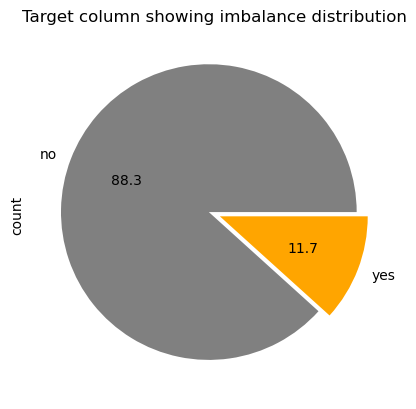

In [20]:
# step 7 : checking target column 
'''  
Type of analysis : classification multi variate analysis.
In above dataset, the target column is imbalance in nature , so hence use imbalance technique to 
balance the target column  

'''
df['y'].value_counts().plot(kind ='pie',autopct='%1.1f',colors= ['grey','orange'],explode = [0.04,0.04]) # there is imballance data ..1st we balance the data
plt.title('Target column showing imbalance distribution') # explode = [0.02,0.02] for partition
plt.show() # also imp to bivariate data distribution



In [ ]:
# Use Imbalance Technique : over sampling 

